# MultiOmics RNA + ATAC for Chao dataset emphasis on OL population (MORNAATACCOL) technical documentation
## Multiomics RNAseq & ATACseq on EAE model

<hr>

**This notebook is the following of MORNAATACCOL 4 notebook**

<hr>

Related paper : [Mimitou et al. (2020)](https://www.biorxiv.org/content/10.1101/2020.09.08.286914v1)

Data used in this notebook :

In [ ]:
#/Castelo_Branco/NGSDATA/EAE_multiomics_EAMM_250521/Processed_data/ARC2
#/Castelo_Branco/NGSDATA/EAE_late_multiomics_CZ_030721/Processed_data
#only the filtered_feature_bc_matrix repositories, atac_fragments.tsv.gz and atac_fragments.tsv.gz.tbi

#/Castelo_Branco/NGSDATA/Datasets_from_literature

#Memory needed for a full run : 120Gb

In [ ]:
#Early1          = P21208_1003_EAE_ARC
#PeakCtrl2       = P21208_1004_EAE_ARC
#Peak2           = P21208_1005_EAE_ARC
#Late1           = MORNAATACC_1003
#EarlyCtrl2      = P23605_1002
#Peak3           = P23605_1003
#PeakCtrl3       = P23605_1004
#EarlyCtrl3      = P24115_1001
#EarlyFemale3    = P24115_1002
#EarlyMale3      = P24115_1003
#Late2           = P25316_1001
#LateCtrl2       = P25316_1002
#Late3           = P25316_1003
#LateCtrl3       = P25316_1004
#PeakMale4        = P27208_1001
#PeakFemale4      = P27208_1002
#LateMale4        = P27208_1003
#LateFemale4      = P27208_1004

## 0. Environment status

In [5]:
%use

Subkernel,Kernel Name,Language,Language Module,Interpreter
Bash,bash,bash,sos_bash,/usr/bin/python3
Bash,calysto_bash,bash,sos_bash,python
Python3,python3,python,sos_python,python
R,ir,R,sos_r,/usr/lib/R/bin/R
SoS,sos,sos,,/usr/bin/python3


In [3]:
lsb_release -a

No LSB modules are available.
Distributor ID:	Ubuntu
Description:	Ubuntu 20.04 LTS
Release:	20.04
Codename:	focal


In [4]:
lscpu

Architecture:        x86_64
CPU op-mode(s):      32-bit, 64-bit
Byte Order:          Little Endian
Address sizes:       46 bits physical, 48 bits virtual
CPU(s):              20
On-line CPU(s) list: 0-19
Thread(s) per core:  1
Core(s) per socket:  10
Socket(s):           2
NUMA node(s):        2
Vendor ID:           GenuineIntel
CPU family:          6
Model:               79
Model name:          Intel(R) Xeon(R) CPU E5-2630 v4 @ 2.20GHz
Stepping:            1
CPU MHz:             2735.498
CPU max MHz:         3100.0000
CPU min MHz:         1200.0000
BogoMIPS:            4390.12
Virtualization:      VT-x
L1d cache:           640 KiB
L1i cache:           640 KiB
L2 cache:            5 MiB
L3 cache:            50 MiB
NUMA node0 CPU(s):   0-9
NUMA node1 CPU(s):   10-19
Flags:               fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cm
                     ov pat pse36 clflush dts acpi mmx fxsr sse sse2 ss ht tm pb
                     e syscall nx pdpe1gb rdtscp lm constant_t

In [5]:
grep MemTotal /proc/meminfo | awk '{print $2 / 1024}'

128374


In [ ]:
apt list --installed

In [ ]:
pip list

In [9]:
jupyter --version

Selected Jupyter core packages...
IPython          : 7.30.1
ipykernel        : 6.6.0
ipywidgets       : 7.6.5
jupyter_client   : 7.1.0
jupyter_core     : 4.9.1
jupyter_server   : 1.13.1
jupyterlab       : 3.1.17
nbclient         : 0.5.9
nbconvert        : 6.2.0
nbformat         : 5.1.3
notebook         : 6.4.6
qtconsole        : 5.2.2
traitlets        : 5.1.0


In [1]:
#conda env export -n jupyter

## 1. Loading environments

### 1.1 R Packages

In [1]:
library(Seurat)
library(Signac)
library(EnsDb.Mmusculus.v79)
library(BSgenome.Mmusculus.UCSC.mm10)
library(dplyr)
library(stringr)
library(harmony)
library(clustree)
library(data.table)
library(biomaRt)
library(cowplot)
library(randomForest)
library(ggplot2)
library(caret)
library(tidyverse)
library(pheatmap)
library(grid)
library(gridExtra)
library(biovizBase)
library(ggrepel)
library(viridis)
library(reshape2)
library(hues)
library(clusterProfiler)
library(org.Mm.eg.db)
library(ggnewscale)
library(scales)

#conda dependencies trouble
library(enrichplot)
library(ReactomePA)

#Doublet determination
#Cannot be installed through conda
library(DoubletFinder)

library(textclean)
library(mclust)

#ArchR
library(ArchR)
library(TxDb.Mmusculus.UCSC.mm10.knownGene)

library(muscat)
library(SingleCellExperiment)
library(scater)
library(cowplot)
library(UpSetR)
library(limma)
library(Matrix.utils)
library(purrr)
library(DESeq2)
library(EnhancedVolcano)

Attaching SeuratObject

Loading required package: ensembldb

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    Filter, Find, Map, Position, Reduce, anyDuplicated, aperm, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, setdiff, sort, table,
    tapply, union, unique, unsplit, which.max, which.min


Loading required package: GenomicRanges

Loading required package: stats4

Loading required package: S4Vectors


Attaching package: ‘S4Vectors’


The following objects are masked from ‘package:base’:

    I, expand.grid, unname


Loading required package: IRanges

Loading required package: GenomeInfoDb

Loading requir

In [2]:
sessionInfo()

R version 4.2.3 (2023-03-15)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 20.04.4 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/blas/libblas.so.3.9.0
LAPACK: /usr/lib/x86_64-linux-gnu/lapack/liblapack.so.3.9.0

locale:
 [1] LC_CTYPE=C.UTF-8    LC_NUMERIC=C        LC_TIME=C          
 [4] LC_COLLATE=C        LC_MONETARY=C       LC_MESSAGES=C      
 [7] LC_PAPER=C          LC_NAME=C           LC_ADDRESS=C       
[10] LC_TELEPHONE=C      LC_MEASUREMENT=C    LC_IDENTIFICATION=C

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] EnhancedVolcano_1.16.0                   
 [2] DESeq2_1.38.3                            
 [3] Matrix.utils_0.9.8                       
 [4] limma_3.54.2                             
 [5] UpSetR_1.4.0                             
 [6] scater_1.26.1                            
 [7] scuttle_1.8.4                            
 [8] Sing

### 1.2 Functions

In [3]:
PrctCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        prct = unlist(lapply(genes,calc_helper, object=object))
        result = data.frame(Markers = genes, Cell_proportion = prct)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, PrctCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper <- function(object,genes){
    counts = object[['RNA']]@counts
    ncells = ncol(counts)
    if(genes %in% row.names(counts)){
    sum(counts[genes,]>0)/ncells
    }else{return(NA)}
}

NbCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        nb = unlist(lapply(genes,calc_helper_nb, object=object))
        result = data.frame(Markers = genes, Cell_nb = nb)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, NbCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper_nb <- function(object,genes){
    counts = object[['RNA']]@counts
    if(genes %in% row.names(counts)){
    length(counts[genes,][counts[genes,] > 0])
    }else{return(NA)}
}

DoMultiBarHeatmap <- function (object, features = NULL, cells = NULL, group.by = "ident", additional.group.by = NULL, additional.group.sort.by = NULL,  cols.use = NULL, group.bar = TRUE, disp.min = -2.5, disp.max = NULL, slot = "scale.data", assay = NULL, label = TRUE, size = 5.5, hjust = 0, angle = 45, raster = TRUE, draw.lines = TRUE, lines.width = NULL, group.bar.height = 0.02, combine = TRUE){

  cells <- cells %||% colnames(x = object)
  if (is.numeric(x = cells)) {
    cells <- colnames(x = object)[cells]
  }
  assay <- assay %||% DefaultAssay(object = object)
  DefaultAssay(object = object) <- assay
  features <- features %||% VariableFeatures(object = object)
  ## Why reverse???
  features <- rev(x = unique(x = features))
  disp.max <- disp.max %||% ifelse(test = slot == "scale.data", yes = 2.5, no = 6)
  possible.features <- rownames(x = GetAssayData(object = object, slot = slot))
  if (any(!features %in% possible.features)) {
    bad.features <- features[!features %in% possible.features]
    features <- features[features %in% possible.features]
    if (length(x = features) == 0) {
      stop("No requested features found in the ", slot,
      " slot for the ", assay, " assay.")
    }
    warning("The following features were omitted as they were not found in the ", slot, " slot for the ", assay, " assay: ", paste(bad.features, collapse = ", "))
  }

  if (!is.null(additional.group.sort.by)) {
    if (any(!additional.group.sort.by %in% additional.group.by)) {
      bad.sorts <- additional.group.sort.by[!additional.group.sort.by %in% additional.group.by]
      additional.group.sort.by <- additional.group.sort.by[additional.group.sort.by %in% additional.group.by]
      if (length(x = bad.sorts) > 0) {
        warning("The following additional sorts were omitted as they were not a subset of additional.group.by : ",
        paste(bad.sorts, collapse = ", "))
      }
    }
  }

  data <- as.data.frame(x = as.matrix(x = t(x = GetAssayData(object = object, slot = slot)[features, cells, drop = FALSE])))

  object <- suppressMessages(expr = StashIdent(object = object, save.name = "ident"))
  group.by <- group.by %||% "ident"
  groups.use <- object[[c(group.by, additional.group.by[!additional.group.by %in% group.by])]][cells, , drop = FALSE]
  plots <- list()
  for (i in group.by) {
    data.group <- data
    if (!is.null(additional.group.by)) {
      additional.group.use <- additional.group.by[additional.group.by!=i]
      if (!is.null(additional.group.sort.by)){
        additional.sort.use = additional.group.sort.by[additional.group.sort.by != i]
      } else {
        additional.sort.use = NULL
      }
    } else {
      additional.group.use = NULL
      additional.sort.use = NULL
    }

    group.use <- groups.use[, c(i, additional.group.use), drop = FALSE]

    for(colname in colnames(group.use)){
      if (!is.factor(x = group.use[[colname]])) {
        group.use[[colname]] <- factor(x = group.use[[colname]])
      }
    }

    if (draw.lines) {
      lines.width <- lines.width %||% ceiling(x = nrow(x = data.group) * 0.0025)
      placeholder.cells <- sapply(X = 1:(length(x = levels(x = group.use[[i]])) * lines.width), FUN = function(x) {
        return(Seurat:::RandomName(length = 20))
      })
      placeholder.groups <- data.frame(rep(x = levels(x = group.use[[i]]), times = lines.width))
      group.levels <- list()
      group.levels[[i]] = levels(x = group.use[[i]])
      for (j in additional.group.use) {
        group.levels[[j]] <- levels(x = group.use[[j]])
        placeholder.groups[[j]] = NA
      }

      colnames(placeholder.groups) <- colnames(group.use)
      rownames(placeholder.groups) <- placeholder.cells

      group.use <- sapply(group.use, as.vector)
      rownames(x = group.use) <- cells

      group.use <- rbind(group.use, placeholder.groups)

      for (j in names(group.levels)) {
        group.use[[j]] <- factor(x = group.use[[j]], levels = group.levels[[j]])
      }

      na.data.group <- matrix(data = NA, nrow = length(x = placeholder.cells), ncol = ncol(x = data.group), dimnames = list(placeholder.cells, colnames(x = data.group)))
      data.group <- rbind(data.group, na.data.group)
    }

    order_expr <- paste0('order(', paste(c(i, additional.sort.use), collapse=','), ')')
    group.use = with(group.use, group.use[eval(parse(text=order_expr)), , drop=F])

    plot <- Seurat:::SingleRasterMap(data = data.group, raster = raster, disp.min = disp.min, disp.max = disp.max, feature.order = features, cell.order = rownames(x = group.use), group.by = group.use[[i]])

    if (group.bar) {
      pbuild <- ggplot_build(plot = plot)
      group.use2 <- group.use
      cols <- list()
      na.group <- Seurat:::RandomName(length = 20)
      for (colname in rev(x = colnames(group.use2))) {
        if (colname == i) {
          colid = paste0('Identity (', colname, ')')
        } else {
          colid = colname
        }

        # Default
        cols[[colname]] <- c(scales::hue_pal()(length(x = levels(x = group.use[[colname]]))))

        #Overwrite if better value is provided
        if (!is.null(cols.use[[colname]])) {
          req_length = length(x = levels(group.use))
          if (length(cols.use[[colname]]) < req_length){
            warning("Cannot use provided colors for ", colname, " since there aren't enough colors.")
          } else {
            if (!is.null(names(cols.use[[colname]]))) {
              if (all(levels(group.use[[colname]]) %in% names(cols.use[[colname]]))) {
                cols[[colname]] <- as.vector(cols.use[[colname]][levels(group.use[[colname]])])
              } else {
                warning("Cannot use provided colors for ", colname, " since all levels (", paste(levels(group.use[[colname]]), collapse=","), ") are not represented.")
              }
            } else {
              cols[[colname]] <- as.vector(cols.use[[colname]])[c(1:length(x = levels(x = group.use[[colname]])))]
            }
          }
        }

        # Add white if there's lines
        if (draw.lines) {
          levels(x = group.use2[[colname]]) <- c(levels(x = group.use2[[colname]]), na.group)
          group.use2[placeholder.cells, colname] <- na.group
          cols[[colname]] <- c(cols[[colname]], "#FFFFFF")
        }
        names(x = cols[[colname]]) <- levels(x = group.use2[[colname]])

        y.range <- diff(x = pbuild$layout$panel_params[[1]]$y.range)
        y.pos <- max(pbuild$layout$panel_params[[1]]$y.range) + y.range * 0.015
        y.max <- y.pos + group.bar.height * y.range
        pbuild$layout$panel_params[[1]]$y.range <- c(pbuild$layout$panel_params[[1]]$y.range[1], y.max)

        plot <- suppressMessages(plot +
          annotation_raster(raster = t(x = cols[[colname]][group.use2[[colname]]]),  xmin = -Inf, xmax = Inf, ymin = y.pos, ymax = y.max) +
          annotation_custom(grob = grid::textGrob(label = colid, hjust = 0, gp = gpar(cex = 0.75)), ymin = mean(c(y.pos, y.max)), ymax = mean(c(y.pos, y.max)), xmin = Inf, xmax = Inf) +
          coord_cartesian(ylim = c(0, y.max), clip = "off")
        )


        if ((colname == i) && label) {
          x.max <- max(pbuild$layout$panel_params[[1]]$x.range)
          x.divs <- pbuild$layout$panel_params[[1]]$x.major %||% pbuild$layout$panel_params[[1]]$x$break_positions()
          group.use$x <- x.divs

          label.x.pos <- tapply(X = group.use$x, INDEX = group.use[[colname]], FUN = median) * x.max
          label.x.pos <- data.frame(group = names(x = label.x.pos), label.x.pos)
          plot <- plot + geom_text(stat = "identity", data = label.x.pos, aes_string(label = "group", x = "label.x.pos"), y = y.max + y.max *  0.03 * 0.5, angle = angle, hjust = hjust, size = size)
          plot <- suppressMessages(plot + coord_cartesian(ylim = c(0, y.max + y.max * 0.002 * max(nchar(x = levels(x = group.use[[colname]]))) * size), clip = "off"))
        }
      }
    }
    plot <- plot + theme(line = element_blank())
    plots[[i]] <- plot
  }
  if (combine) {
    plots <- CombinePlots(plots = plots)
  }
  return(plots)
}


#####################################################
# Function for getting the marker peaks from the Seurat
# object, based on the current ident
#####################################################
getMarkerPeaks <- function(obj, doublets, n_peaks = 100, min_cells = 200){

  n_clusters = length(unique(as.vector(Idents(obj))))
  
  cells <- Cells(obj)
  
  # remove the doublet cells for better marker peaks
  obj <- subset(obj, cells = cells[!cells %in% doublets])
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  # default preporcessing o Signac applied
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the marker peaks between all clusters
  da_peaks <- FindAllMarkers(
    object = obj,
    slot = "data",
    min.pct = 0.1,
    only.pos = TRUE,
    test.use = 'LR',
    min.cells.group = min_cells,
    verbose = F
  )
  
  # only keep the significant peaks
  metadata = lapply(unique(da_peaks$cluster), function(x){
    return(data.frame(da_peaks[da_peaks$p_val_adj < 0.05 & da_peaks$cluster == x,]))
  })
  
  names(metadata) <- paste0("Cluster_", unique(da_peaks$cluster))
  
  rm(da_peaks)
  
  meta_peaks = data.frame()
  
  for (i in names(metadata)) {
    
    cur_meta = data.frame(metadata[[i]])
    cur_meta$peaks = row.names(metadata[[i]])
    cur_meta$cluster = i
    row.names(cur_meta) = c()
    
    meta_peaks = rbind(meta_peaks, cur_meta)
    
    rm(cur_meta)
    
  }
  
  # sort the peaks based on the fold changes and signifigance, choose ones with high FC first
  meta_peaks = meta_peaks[order(meta_peaks$avg_logFC, -meta_peaks$p_val_adj, decreasing = T),]
  
  marker_peaks_set = data.frame(matrix(ncol=2,nrow=0, dimnames=list(NULL, c("gene", "cluster"))))
  
  # extract 100 marker peaks for each cluster
  while(nrow(marker_peaks_set) < n_peaks*n_clusters) {
    
    temp = meta_peaks[1, c("gene", "cluster")]
    
    marker_peaks_set = rbind(marker_peaks_set, temp)
    
    meta_peaks = meta_peaks[which(meta_peaks$gene != temp$gene),]
    
    if(length(which(marker_peaks_set$cluster == temp$cluster)) == n_peaks){
      meta_peaks = meta_peaks[which(meta_peaks$cluster != temp$cluster),]
    }
    
    rm(temp)
  }
  
  marker_peaks_set = marker_peaks_set[!is.na(marker_peaks_set$gene),]
  
  marker_peaks_set$cluster= factor(marker_peaks_set$cluster, levels = str_sort(unique(marker_peaks_set$cluster), numeric = T))
  marker_peaks_set = marker_peaks_set[order(marker_peaks_set$cluster),]
  
  rm(meta_peaks)
  
  colnames(marker_peaks_set)[1]<- "peaks"
  
  return(marker_peaks_set)
}

############################################
# get the readcount distribution profile for
# the singlet cells of every cluster
############################################
annotateDoublets <- function(obj, marker_peaks, doublets, k = 15){

  # get the read count distributions on the cluster specific marker peaks for all of the cells
  cell.values <- getCellValues(obj, cells = Cells(obj), marker_peaks_set = marker_peaks, doublets = doublets, k = k)
  
  #get the profile for the singlet cells of each cluster
  singlet.profile <- getProfiles(cell.values)
 
  # just annotate the doublets
  doublets <- cell.values %>% 
    subset(doublet == "doublet")
  
  clusters <- doublets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # look at every cluster in the data
  a.class <- lapply(clusters, function(clus){
    
    # just select the doublets that have the current cluster
    # as its most dominant cluster
    t.doublets <- doublets %>%
      subset(a.homotypic == clus, select = clusters)
    
    # get the profile of the current cluster
    t.profile <- singlet.profile[,clus]
    
    # calculate the distance of doublet cell distributions to
    # the profile of the current cluster
    t.dist <- apply(t.doublets, 1, function(cell){
      return(dist(rbind(cell, t.profile)))
    })
    
    # fit a GMM using the mclust package with no class limitations
    fit <- Mclust(t.dist, verbose = F)
    t.class <- fit$classification
    
    t.doublets$dist <- t.dist[rownames(t.doublets)]
    t.doublets$class <- t.class[rownames(t.doublets)]
    t.doublets$max.class <- names(which.max(fit[["parameters"]][["mean"]]))
    t.doublets$num.class <- length(unique(fit$classification))
    return(t.doublets[,c("dist", "class", "max.class", "num.class")])
  }) %>% bind_rows()
  
  doublets$class <- a.class[rownames(doublets),"class"]
  doublets$max.class <- a.class[rownames(doublets),"max.class"]
  doublets$num.class <- a.class[rownames(doublets),"num.class"]
  
  doublets <- lapply(rownames(doublets), function(cell){
    probs <- doublets[cell, clusters]
    
    # only classify the doublets that belong to the final class 
    # doublets[cell,"type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"], "heterotypic", "homotypic")
    doublets[cell,"d.type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"] & doublets[cell,"num.class"] > 1,
                                    "heterotypic", "homotypic")
    
    # report the top clusters based on type of the doublet; if homotypic just one, if heterotypic top 2 clusters
    doublets[cell, "d.annotation"] <- ifelse(doublets[cell,"d.type"] == "homotypic",
                                             names(probs)[order(probs, decreasing = T)[1]],
                                             paste(sort(names(probs)[order(probs, decreasing = T)[1:2]]), collapse = ".")) 
    
    return(doublets[cell,!(colnames(doublets) %in% c("a.heterotypic", "a.homotypic", "ident", "class", "max.class","num.class")), drop = FALSE])
  }) %>% bind_rows()

  return(doublets)
}

#####################################################
# Function to get the ditsribution of read counts on
# the marker peaks of clusters
#####################################################
getReadCountDistributions <- function(marker_peaks, read_counts){
  
  t_read_counts = data.frame(merge(marker_peaks, 100*read_counts, by.x = "peaks", by.y = 0, sort = F))
  names(t_read_counts) <- sub("^X", "", names(t_read_counts))
  t_read_counts$ids = unclass(t_read_counts$cluster)
  
  probs = matrix(nrow = ncol(read_counts), ncol = length(unique(t_read_counts$cluster)))
  
  row.names(probs) <- colnames(read_counts)
  colnames(probs) <- unique(t_read_counts$cluster)
  
  for (i in 1:nrow(probs)) {
    density_data = vector()
    
    for(j in 1:nrow(t_read_counts))
      density_data = c(density_data, rep(t_read_counts$ids[j], t_read_counts[j,row.names(probs)[i]]))
    
    for(j in 1:ncol(probs)){
      if(j==1)
        probs[i,j] = ecdf(density_data)(j)
      else
        probs[i,j] = (ecdf(density_data)(j) - ecdf(density_data)((j-1)))
    }
    
  }
  
  return(data.frame(probs))
}

#####################################################
# Function to plot the read count distributions of
# the given cells
#####################################################
plotReadCountDistributions <- function(probs, folder_path){
  
  if(!dir.exists(folder_path))
    dir.create(folder_path)
  
  sapply(rownames(probs), function(x){long_probs = gather(as.data.frame(bind_rows(probs[x,])), cell_type, probability, factor_key = TRUE)
  ggplot(data=long_probs, aes(x=cell_type, y=probability)) +
    geom_col() +
    theme(axis.text.x = element_text(angle = 90)) +
    ggtitle(x) + xlab("Cluster") + ylab("Score") + ylim(0,1) +
    ggsave(filename = paste0(folder_path, "/Probs_", x, ".pdf"))})
  
}

#####################################################
# Function to add read count distributions for the 
# cells in the provided in te Seurat object with the
# provided marker peaks
#####################################################
getCellValues <- function(obj, cells, marker_peaks_set, doublets, k = 15){
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the neighbor graph of the cells for aggregation
  obj <- FindNeighbors(obj, reduction = "svd", dims = 1:50, k.param = k+1, verbose = F)
  
  cell_annotations <- lapply(cells, function(cell){
    
    # extract the k neighbors of the current cell
    neighbors <- names(obj@graphs$ATAC_nn[cell, obj@graphs$ATAC_nn[cell,] > 0])
    
    # extract the reads for the cell and its k-nearest neighbors
    reads <- Matrix::as.matrix(subset(obj, cells = neighbors, features = marker_peaks_set$peaks)@assays[["ATAC"]]@counts)
    
    no_clusters <- length(unique(marker_peaks_set$cluster))
    
    results = data.frame(matrix(nrow = 0, ncol = no_clusters+1)) %>%
      `colnames<-`(value = c("cell_id", as.character(unique(marker_peaks_set$cluster))))
    
    results[cell,"cell_id"] = cell
    
    # aggregate the reads for the cell by taking the mean with k-nn
    reads <- data.frame(apply(reads, 1, mean)) %>%
      `colnames<-`(value = cell)
    
    if(colSums(reads) == 0){
      results[,-1] <- 0
      
      results[cell, "a.heterotypic"] <- NA
      results[cell, "a.homotypic"] <- NA
        
      return(results)
    }
    
    # calculate the read count distribution of the cell on the marker peaks
    doublet_probs <- reads %>%
      getReadCountDistributions(marker_peaks_set,.) %>% data.frame()
    
    results[cell, colnames(doublet_probs)] <- doublet_probs
    
    # report the 2 clusters that have the highest score
    results[cell, "a.heterotypic"] <- paste(names(doublet_probs)[order(doublet_probs, decreasing = T)[1:2]], collapse = ".")
    
    #report the cluster with highest score
    results[cell, "a.homotypic"] <- names(which.max(doublet_probs))
    
    return(results)
  }) %>% do.call(rbind, .)
  
  # append the type of the cells
  cell_annotations <- mutate(cell_annotations, doublet = ifelse(cell_id %in% doublets, "doublet", "singlet"))
  row.names(cell_annotations) <- cell_annotations$cell_id
  
  cell_annotations[, "ident"] <- Idents(obj)[rownames(cell_annotations)]
  
  return(cell_annotations)
}

#####################################################
# get the read count distribution profile for the
# singlet cells of every cluster
#####################################################
getProfiles <- function(cell.values){

  # get the singlet cells
  singlets <- cell.values %>%
    subset(doublet == "singlet")
  
  clusters <- singlets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # for each cluster in the data find the average profile from singlets
  t.profile <- sapply(clusters, function(clus){
    t.singlets <- singlets %>%
      subset(a.homotypic == clus & paste0("Cluster_", ident) == clus, select = clusters)
    
    t.profile <- apply(t.singlets,2,mean)
    return(t.profile)
  })
  
  return(t.profile)
  
}

save_pheatmap_pdf <- function(x, filename, width=7, height=7) {
    stopifnot(!missing(x))
    stopifnot(!missing(filename))
    pdf(filename, width=width, height=height)
    grid::grid.newpage()
    grid::grid.draw(x$gtable)
    dev.off()
}


filterCells <- function(object,fragments,nbcells){
    # Make fragments per cell table
    fragments.summary <- sort(table(c(fragments$name,colnames(object))),decreasing = TRUE) - 1
    
    # Split cells by cluster - return fraction of cells per cluster
    fragments.summary.ls <-  lapply(levels(object@active.ident),function(x){
      object.x <- object[,object@active.ident == x]
      barcodes <- colnames(object.x)
      fragments.summary.x <- fragments.summary[names(fragments.summary) %in% barcodes]
      fragments.summary.x <- sort(fragments.summary.x,decreasing = TRUE)
      head(x = fragments.summary.x, n = nbcells)
      #head(x = fragments.summary.x, n = dim(object.x)[2] * fraction)
    })
    
    # unlist and merge cell names
    cells <- unlist(lapply(fragments.summary.ls,names))
    return(cells)
}

fragmentsToMatrix <- function(fragments,window){
    bins <- tile(range(fragments),width=window)[[1]]
    
    fragments.ls <- split(fragments,as.factor(fragments$name))
    seqlevels(bins,pruning.mode = "coarse") <- names(coverage(fragments.ls[[1]]))

    fragments.ls.coverage <- lapply(fragments.ls,function(x){
        x <- coverage(x)
        x.bins <- binnedAverage(bins = bins,numvar = x, "coverage")
        as.numeric(x.bins$coverage)
    })
    
    fragments.matrix <- t(do.call("rbind",fragments.ls.coverage))
    rownames(fragments.matrix) <- start(bins)
    
    return(fragments.matrix)
}

plotHeatmapBW <- function(object,
                       fragmentsGrange,
                       interestingRegion,
                       window = 5000,
                       annotFilter,
                       nbcells = 50,
                       clusters_order = NULL,
                       cells = NULL,...
                       ) {
  
if(is.null(clusters_order)){clusters_order  <- levels(object@active.ident)}
if(is.null(cells)){cells.to.plot            <- sample(colnames(object),nbcells)}
#if(is.null(cells)){cells.to.plot            <- sample(colnames(object),fraction * dim(object)[2])}

fragments.interesting <- fragmentsGrange  

fragments.interesting <- fragments.interesting[fragments.interesting$name %in% cells.to.plot]

fragments.interesting.matrix <- fragmentsToMatrix(fragments    = fragments.interesting,
                                                  window       = window)

dummy.mat <- matrix(data = 0, nrow = dim(fragments.interesting.matrix)[1],ncol = length(cells.to.plot[!cells.to.plot %in% colnames(fragments.interesting.matrix)]))
colnames(dummy.mat) <- cells.to.plot[!cells.to.plot %in% colnames(fragments.interesting.matrix)]
rownames(dummy.mat) <- rownames(fragments.interesting.matrix)

fragments.interesting.matrix <- cbind(fragments.interesting.matrix,dummy.mat)
                                                  
fragments.interesting.matrix.binary <- apply(fragments.interesting.matrix,2,as.logical)
fragments.interesting.matrix.binary <- Matrix::Matrix(apply(fragments.interesting.matrix.binary,2,as.numeric),sparse = TRUE)

rownames(fragments.interesting.matrix) <- as.numeric(rownames(fragments.interesting.matrix))
rownames(fragments.interesting.matrix.binary) <- as.numeric(rownames(fragments.interesting.matrix))

round_coordinates = 250000

clusters_annotations <- sample(factor(object@active.ident[colnames(fragments.interesting.matrix.binary)],levels = clusters_order))

annotation_row       <- data.frame(clusters_annotations[order(clusters_annotations)])
colnames(annotation_row) <- "Cluster"

xlabels  <- as.numeric(rownames(fragments.interesting.matrix))
xlabels[xlabels %% round_coordinates != 0] <- ""

p1 <- pheatmap(t(fragments.interesting.matrix.binary)[rownames(annotation_row),],
         cluster_rows=FALSE,
         cluster_cols=FALSE,
         show_rownames=FALSE,
         show_colnames=TRUE,
         labels_col = xlabels,
         annotation_row = annotation_row,
         annotation_legend= TRUE,
         annotation_names_row = FALSE,
         color = colorRampPalette(c("white","black"))(2),
         gaps_row= cumsum(table(annotation_row$Cluster)[clusters_order]),
         border_color = NA,...
         )

return(p1)
}

### 1.3 Set up R parameters

In [4]:
#Set up global parameters
OS_path <- "/sing_data/"
macs2_path = "/usr/local/bin/macs2"
amulet_path = "/AMULET"
#Conda Monod
#OS_path <- "/datb/gcb/gcb_bh/"
#macs2_path = "/home/bastien/miniconda3/envs/jupyter_MORNAATACC/bin/macs2"
#amulet_path = "/home/bastien/AMULET"

OS_path_datasets <- paste0(OS_path, "Data/MORNAATACC/Alignment/")
OS_path_outputs <- paste0(OS_path, "Data/MORNAATACC/Outputs/")
OS_path_inputs <- paste0(OS_path, "Data/MORNAATACC/Inputs/")
datasets_path <- paste0(OS_path,"Data/Others/Datasets/")

seed <- 424242
options(repr.plot.width=16, repr.plot.height=12)
options(future.globals.maxSize = 8000 * 1024^2)

options(repr.matrix.max.rows=100, repr.matrix.max.cols=100)

In [5]:
#Blue
#DDEAF8
#BBD4F1
#88B4E7
#5695DC
#2A75CB
#1F5898
#153B66

#Green
#E9EDE9
#D2DAD2
#B0BFB0
#8FA38F
#6E876E
#536553
#374337

#Gold
#FFF3D6
#FFE7AD
#FFD470
#FFC233
#F5AB00
#B88100
#7A5600

#Orange
#FDDDD8
#FBBAB1
#F88877
#F5563D
#E92A0C
#AE1F09
#741506

#Brown
#EFE7E6
#E0CECD
#C8A9A7
#B08482
#97615E
#714947
#4B312F

#Purple
#F6EEFC
#ECDCF9
#E2CBF6
#D8B9F3
#CEA8F0
#C596ED
#BB85EA
#B173E7
#A862E4
#9E51E1
#943FDE
#8A2EDC
#8023D1
#7621C0
#6B1EAE
#601B9D
#55188C
#4B157A
#401269
#350F57
#2A0C45
#1F0934
#150623
#0B0312

#Honey
#FFF9EB
#FFF3D6
#FFEDC2
#FFE7AD
#FFE099
#FFDA85
#FFD470
#FFCE5C
#FFC847
#FFC233
#FFBC1F
#FFB60A
#F5AB00
#E09D00
#CC8F00
#B88100
#A37200
#8F6400
#7A5600
#664700
#523900
#3D2B00
#291D00
#140E00

In [6]:
names_Ctrl <- c("EarlyCtrl2", "EarlyCtrl3", "PeakCtrl2", "PeakCtrl3", "LateCtrl1", "LateCtrl2", "LateCtrl3")
names_Early <- c("Early1", "EarlyMale3", "EarlyFemale3")
names_Peak <- c("Peak2", "Peak3", "PeakMale4", "PeakFemale4")
names_Late <- c("Late1", "Late2","Late3", "LateMale4", "LateFemale4")

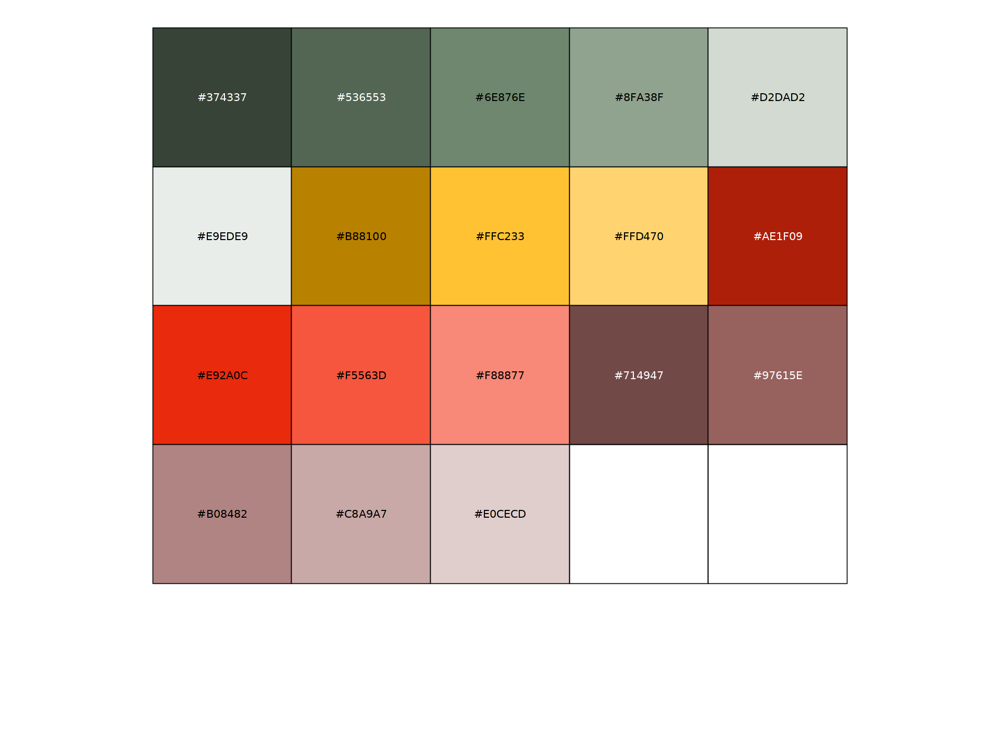

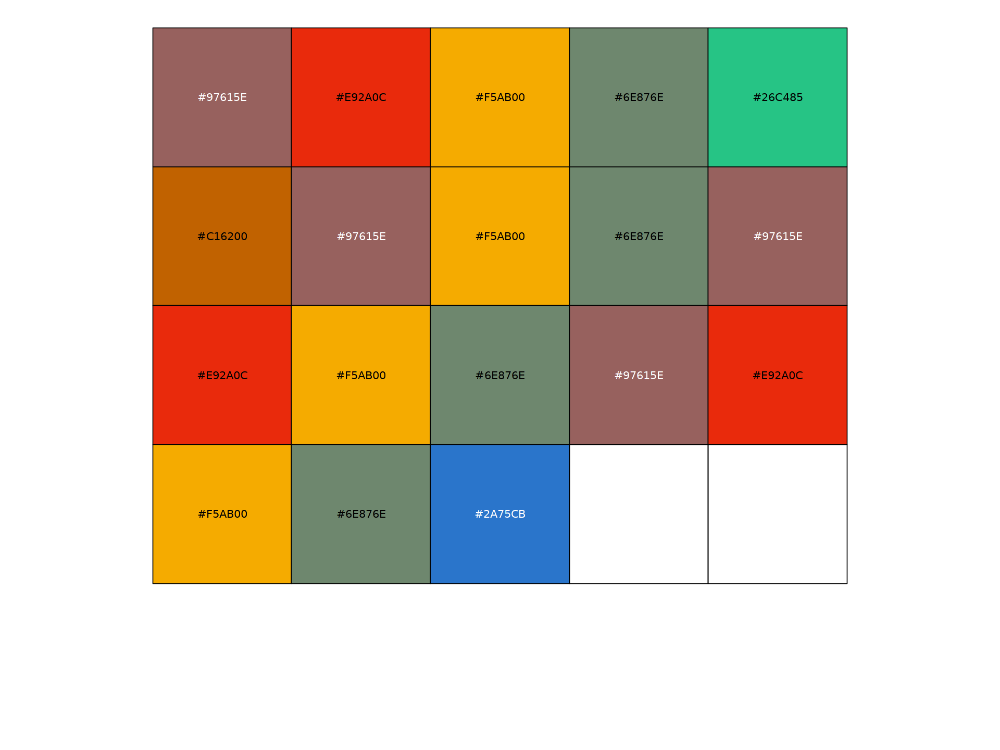

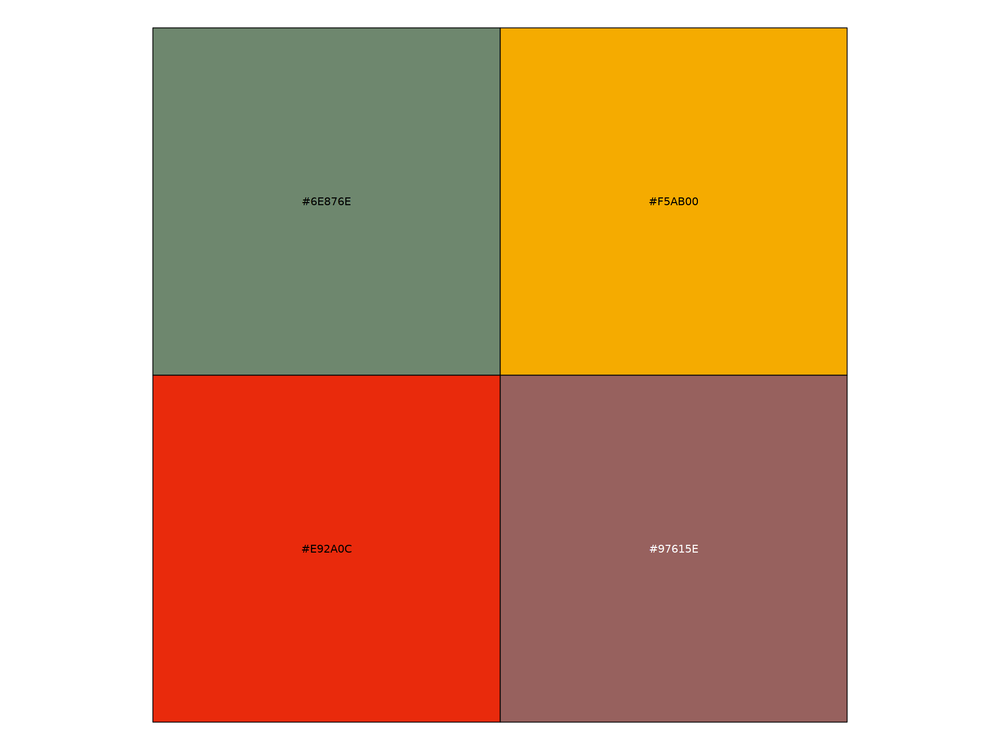

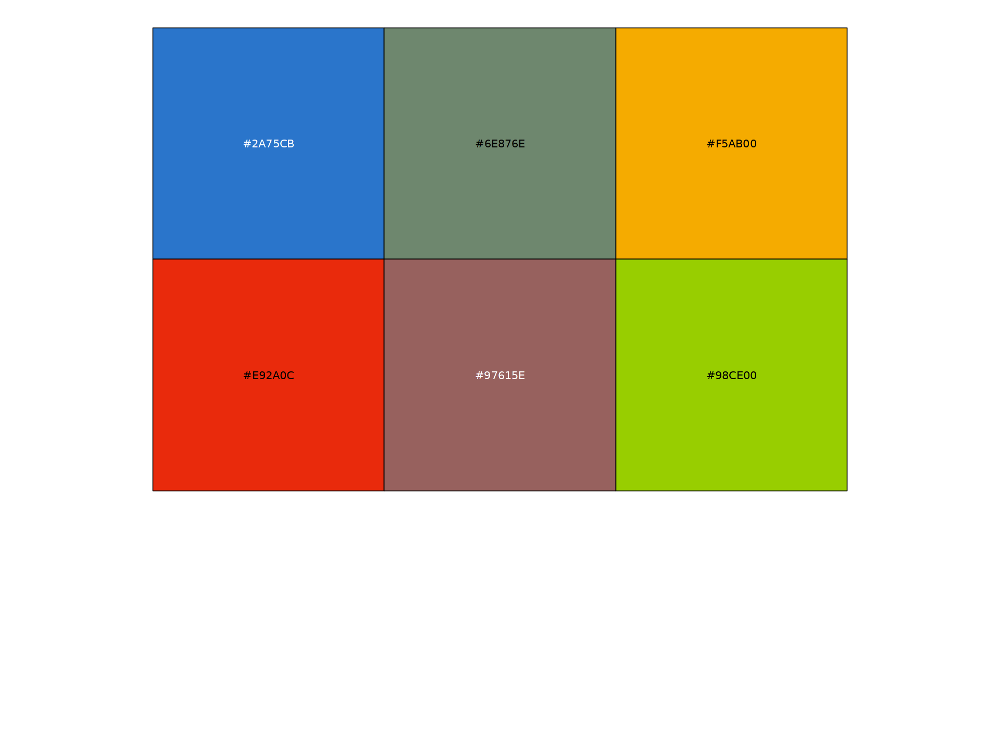

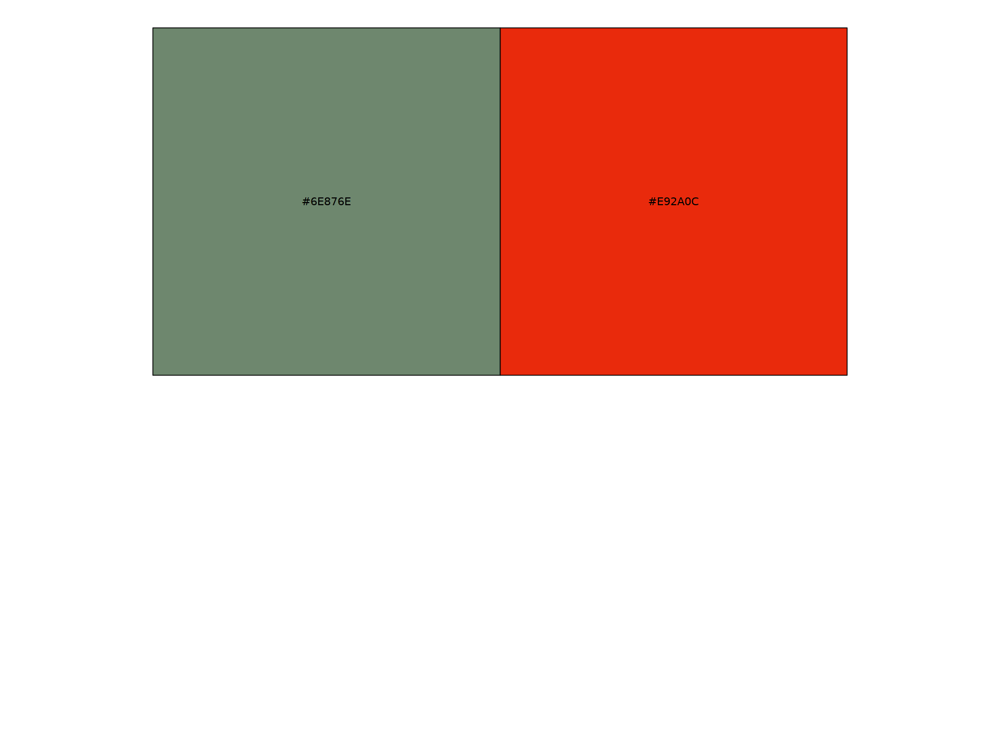

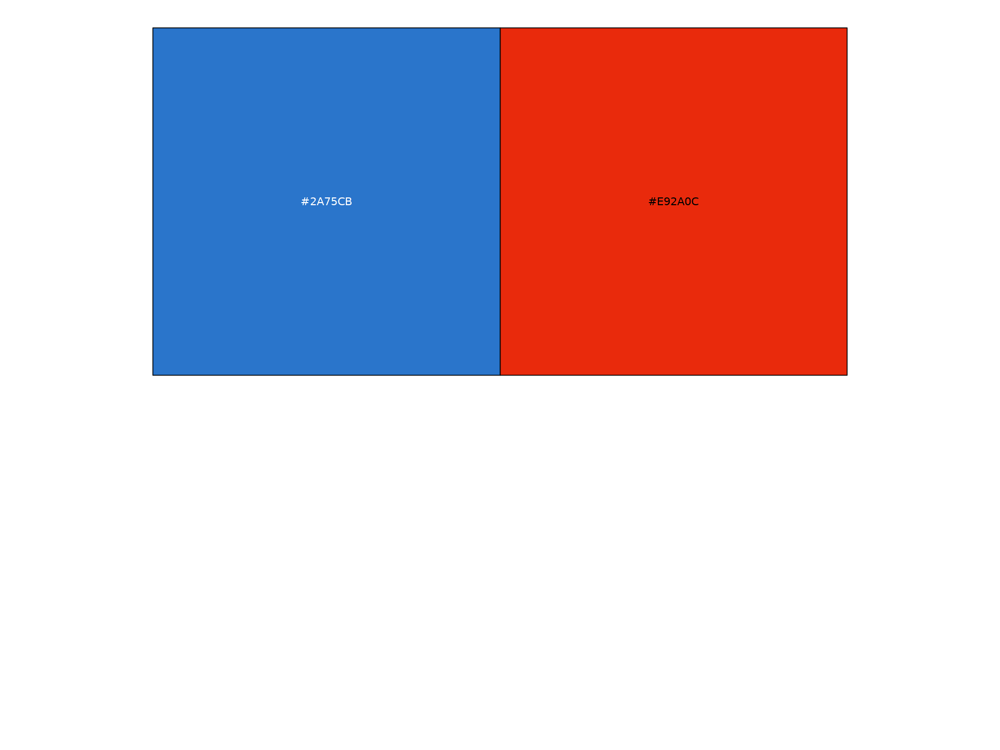

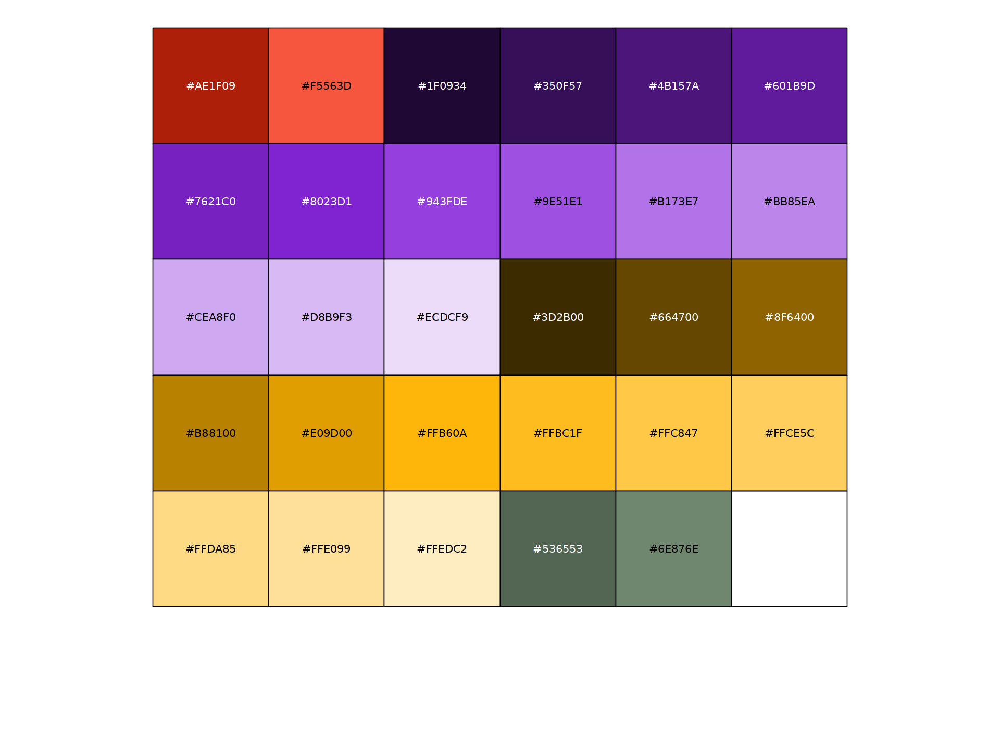

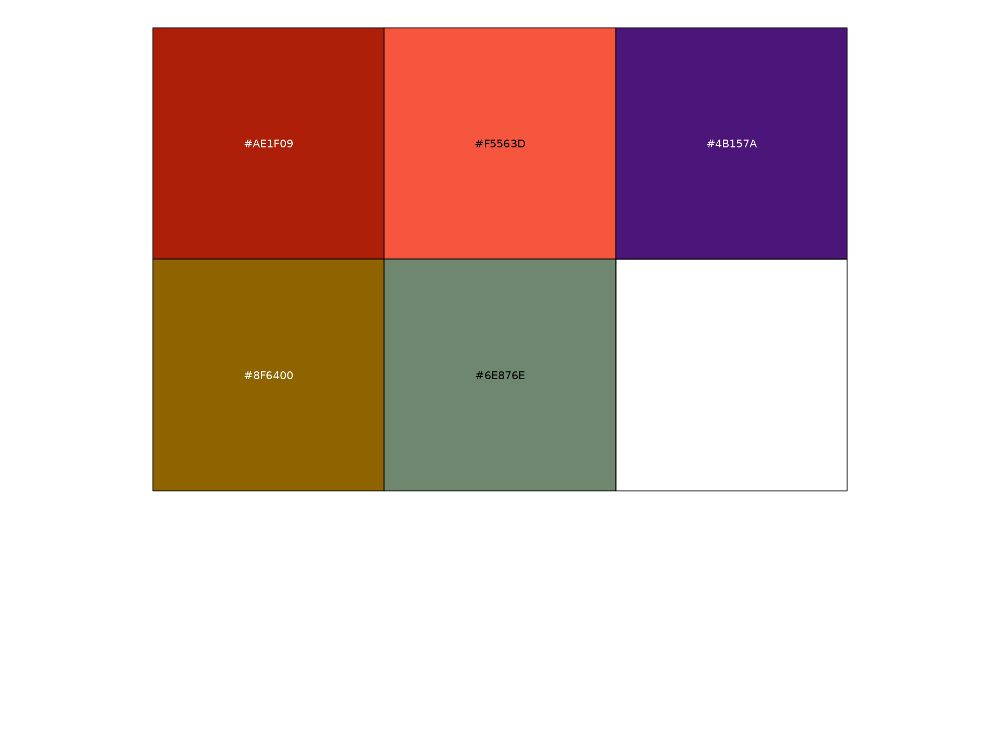

In [7]:
orig.ident_colors <- c("#374337", "#536553", "#6E876E", "#8FA38F", "#D2DAD2", "#E9EDE9", "#B88100", "#FFC233", "#FFD470", "#AE1F09", "#E92A0C", "#F5563D", "#F88877", "#714947", "#97615E", "#B08482", "#C8A9A7", "#E0CECD")
names(orig.ident_colors) <- c("EarlyCtrl2", "EarlyCtrl3", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3", "Early1", "EarlyMale3", "EarlyFemale3", "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Late1", "Late2","Late3", "LateMale4", "LateFemale4")
show_col(orig.ident_colors)
orig.ident_colors_contrast <- c("#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#97615E", "#F5AB00", "#6E876E", "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#2A75CB")
names(orig.ident_colors_contrast) <- c("EarlyCtrl2", "EarlyCtrl3", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3", "Early1", "EarlyMale3", "EarlyFemale3", "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Late1", "Late2","Late3", "LateMale4", "LateFemale4")
show_col(orig.ident_colors_contrast)

orig.ident_merge_colors <- c("#6E876E", "#F5AB00", "#E92A0C", "#97615E")
names(orig.ident_merge_colors) <- c("Ctrl", "Early", "Peak", "Late")
show_col(orig.ident_merge_colors)

batch_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E", "#98CE00")
names(batch_colors) <- c("B1", "B2", "B3", "B4", "B5", "B6")
show_col(batch_colors)

model_colors <- c("#6E876E", "#E92A0C")
names(model_colors) <- c("Ctrl", "EAE")
show_col(model_colors)

duo_colors <- c("#2A75CB", "#E92A0C")
show_col(duo_colors)

sex_colors <- duo_colors
names(sex_colors) <- c("M", "F")

immune_colors <- c("#A9DFBF", "#FF000080")
names(immune_colors) <- c("NonImmune", "Immune")
#show_col(immune_colors)

doublets_colors <- c("#A9DFBF", "#FF000080")
names(doublets_colors) <- c("Singlet", "Doublet")
#show_col(doublets_colors)

cellType_OL_colors <- c("#AE1F09","#F5563D", "#1F0934", "#350F57", "#4B157A", "#601B9D", "#7621C0", "#8023D1", "#943FDE", "#9E51E1", "#B173E7", "#BB85EA", "#CEA8F0", "#D8B9F3", "#ECDCF9","#3D2B00", "#664700", "#8F6400", "#B88100", "#E09D00", "#FFB60A", "#FFBC1F", "#FFC847", "#FFCE5C", "#FFDA85", "#FFE099", "#FFEDC2"
,"#536553", "#6E876E")
names(cellType_OL_colors) <- c("OPC", "COP", "MOL56-α","MOL56-β","MOL56-γ","MOL56-δ","MOL56-ε","MOL56-ζ","MOL56-η","MOL56-θ","MOL56-ι","MOL56-κ","MOL56-λ","MOL56-μ","MOL56-ν","MOL2-α","MOL2-β","MOL2-γ","MOL2-δ","MOL2-ε","MOL2-ζ","MOL2-η","MOL2-θ","MOL2-ι","MOL2-κ","MOL2-λ","MOL2-μ",
 "MOL1-α", "MOL1-β")
show_col(cellType_OL_colors)

cellType_OL_merge_colors <- c("#AE1F09","#F5563D","#4B157A","#8F6400", "#6E876E")
names(cellType_OL_merge_colors) <- c("OPC", "COP", "MOL56", "MOL2", "MOL1")
show_col(cellType_OL_merge_colors)

In [8]:
%put OS_path_datasets OS_path_outputs OS_path_inputs

In [9]:
#Set up ATAC annotation
annotations <- GetGRangesFromEnsDb(ensdb = EnsDb.Mmusculus.v79, verbose =FALSE)
ucsc.levels <- str_replace(string=paste("chr",seqlevels(annotations),sep=""), pattern="chrMT", replacement="chrM")
seqlevels(annotations) <- ucsc.levels
genome(annotations) <- "mm10"

Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warn

## 2. Loading datasets

In [10]:
MORNAATACCOL <- readRDS(paste0(OS_path_outputs, "MORNAATACCOL.rds"))

In [11]:
MORNAATACCOL@meta.data <- readRDS(paste0(OS_path_outputs, "MORNAATACCOL_annot_CHAO.rds"))

## 3. OL dynamics

### 3.2 Gene ontology (DGA)

In [37]:
DefaultAssay(MORNAATACCOL) <- "GenePromAcc"

In [38]:
ensembl = useMart("ensembl",dataset="mmusculus_gene_ensembl")
attributes = listAttributes(ensembl)
Biomart_gencode_ensembl84_biotypes <- getBM(attributes=c("mgi_symbol","ensembl_gene_id","entrezgene_id","gene_biotype"), filters = "", values = "", ensembl)
Biomart_gencode_ensembl84_biotypes[, 'gene_biotype'] <- as.factor(Biomart_gencode_ensembl84_biotypes[,'gene_biotype'])

In [39]:
#Filter for only our genes
Biotype_All_dataset <- subset(Biomart_gencode_ensembl84_biotypes, mgi_symbol %in% rownames(MORNAATACCOL))
entrezID <- subset(Biotype_All_dataset, Biotype_All_dataset$mgi_symbol %in% rownames(MORNAATACCOL))

In [40]:
threshold_nb_genes <- 50

#### 3.2.1 MOL56

In [42]:
df_dynamics <- readRDS(paste0(OS_path_outputs, "Dynamics_DGA_RNA_MOL56.rds"))

##### 3.2.1.1 Category 1

In [43]:
gene_list <- c("Slc13a1","Glp1r","Mmrn1","4933430M04Rik","Gm12707","Gm16019","Gm12714","4921508D12Rik","Gm15839","Smco2","Gm12505","Vwc2l","1700007J10Rik","Sycp1","Gm14321","Htr3b","1700061I17Rik","Spink14","Gm26832","Gm11548","Lyzl1","Gm21905","Olfr649","Gm4792","Slc18a3","Pldi","Gm26744","Eef1a2","Slc22a12","A530058N18Rik","Cntnap3","Ceacam3","Tigit","Zbbx","Papss2","Skint6","Gm10964","4930445B16Rik","Aass","Slc36a3","Hist1h2bf","H2-Q6","Tnfsf11","Fgl2","Corin","Erp27","Gm28694","Klk6","Amotl1","C4b","Oas1c","Ddx60","Fosl2","Arhgef38","Sirpb1b","Gm3604","Mill2","Serpina3n","Fam13a","Hcn1","Hspb8","Fxyd3","Crmp1","I830012O16Rik","Gm14446","Crlf2","Vmn2r79","Cd200r4","Plvap","Gm7030","H2-Q7","Tex16","H2-Q4","H2-M3","Gbp5","Gm19684","Slfn3","Hist1h4n","n-R5s213","Gm340","Olfr648","Hist1h4b","Tgtp2","Klk7","Gbp4","Olfr56","Gm4951","Gbp8","Trim12a","Gbp9","Ptchd1","4930468A15Rik","Gm11986","Tgtp1","Tlr1","Gm5570","1700029J03Rik","9930038B18Rik","Htr5a","Il18bp","Gm12296","4930435H24Rik","Ifi27l2a","Serpina3i","Zbp1","Napsa","Gm12185","Tmco5b","Gm16976","Gm27198","Cyb561","Cd300lf","Gm16758","Ms4a4d","Tnfrsf14","Cdh22","Ggta1","Trim12c","Iigp1","Gm6034","Trim34a","Lgals3bp","Slc10a6","Oasl2","Psmb9","H2-T23","Serping1","Plin4","Ace3","BC048679","H2-T24","Trim30d","Oas1a","Psmb11","Tmem28","Chp2","Cryba1","Fsd2","Olfm3","Gm7976","A530058N18Rik.1","Zfp872","Ifit3","Irf8","Gbp6","Gm9930","Epha8","Mmp20","Trim21","Irgm1","Ifit1","Parp14","Serpina3f","Usp18","Igtp","Parp9","Gbp7","Wbscr17","Gm29643","9330175E14Rik","Samd9l","Irf9","Gbp3","Irf7","C1ra","Tap1","Slfn9","Rtp4","Psmb8","Irgm2","Bst2","Irf1","4632428C04Rik","Cmpk2","2010002M12Rik","RP24-571H12.4","RP24-539A2.1","Isg15","Cd274","Sult1a1","Ms4a4c","4930558J22Rik","Herc6","Mgst2","Socs3","Dtx3l","Rnf213","Eif2ak2","Gm28417","Gm13003","4930518I15Rik","Eid2","Dio2","Ccr5","Far2","St8sia4","Hnf4g","Gm26512","Gpr21","4930594M22Rik","Ceacam20","Magee2","Gm26760","Gm10392","Etnppl","Hist1h2ad","Vwa5a","Lrfn3","Scnn1a","Zfp937","Sytl5","Gm29185","Ttr","T","Avpr1b","Eltd1","Pde1a","Gm5860","Trim34b","Gm11840","Gm28905","1200007C13Rik","Gm29125")

In [44]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [45]:
length(gene_list)

[1] 195

In [46]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [47]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [48]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [49]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [50]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [51]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [52]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [53]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:50] "15040" "60440" "16145" "12268" "15944" "16913" "240327" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...103 enriched terms found
'data.frame':	103 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-983169" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Class I MHC mediated antigen processing & presentation" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "6/20" "8/20" "4/20" "4/20" ...
 $ BgRatio    : chr  "92/8501" "343/8501" "34/8501" "41/8501" ...
 $ pvalue     : num  4.68e-08 5.33e-07 9.88e-07 2.13e-06 1.38e-05 ...
 $ p.adjust   : num  7.62e-06 4.35e-05 5.37e-05 8.70e-05 4.49e-04 ...
 $ qvalue     : num  2.36e-06 1.35e-05 1.66e-05 2.70e-05 1.39e-04 ...
 $ geneID     : chr  "H2-T23/Psmb8/Tap1/Psmb9/H2-Q7/H2-

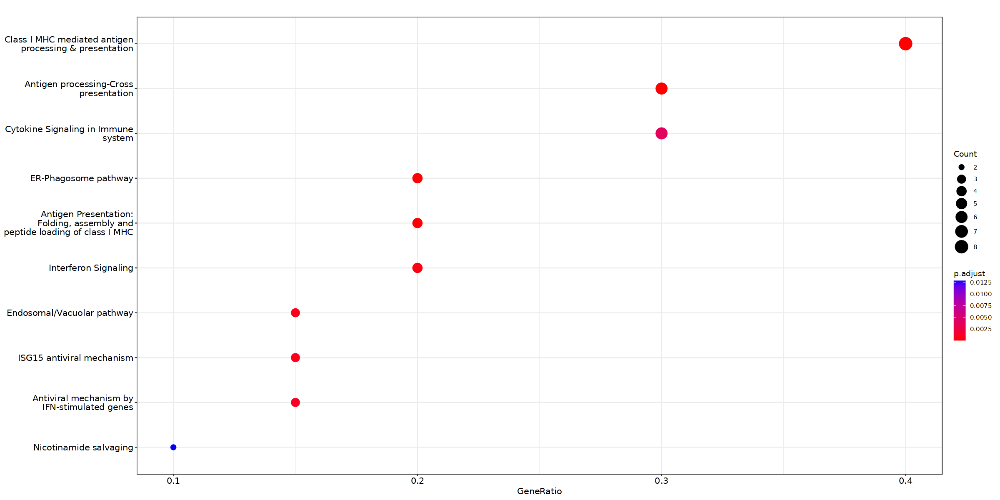

In [54]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [55]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 14 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


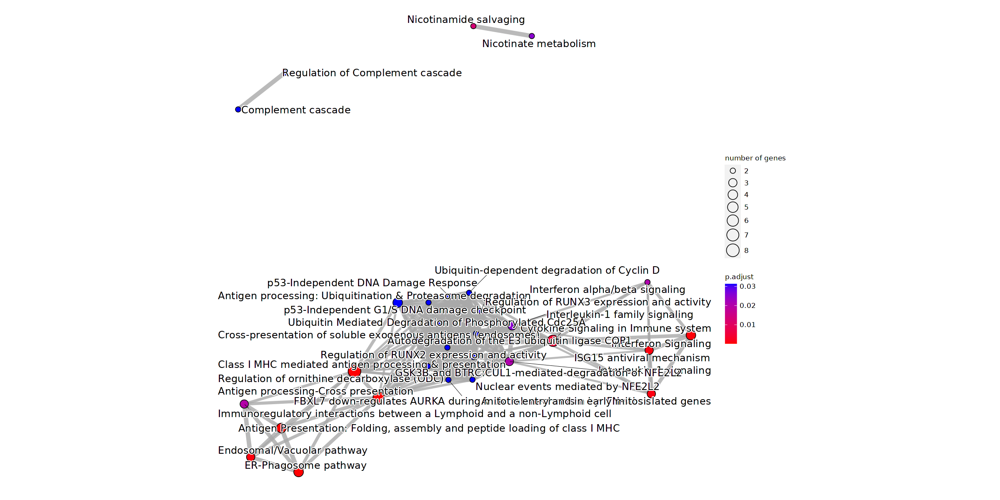

In [56]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [57]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [58]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:50] "15040" "60440" "16145" "12268" "15944" "16913" "240327" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...163 enriched terms found
'data.frame':	163 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-983169" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Class I MHC mediated antigen processing & presentation" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "6/20" "8/20" "4/20" "4/20" ...
 $ BgRatio    : chr  "92/8501" "343/8501" "34/8501" "41/8501" ...
 $ pvalue     : num  4.68e-08 5.33e-07 9.88e-07 2.13e-06 1.38e-05 ...
 $ p.adjust   : num  7.62e-06 4.35e-05 5.37e-05 8.70e-05 4.49e-04 ...
 $ qvalue     : num  2.36e-06 1.35e-05 1.66e-05 2.70e-05 1.39e-04 ...
 $ geneID     : chr  "H2-T23/Psmb8/Tap1/Psmb9/H2-Q7/H2-Q4"

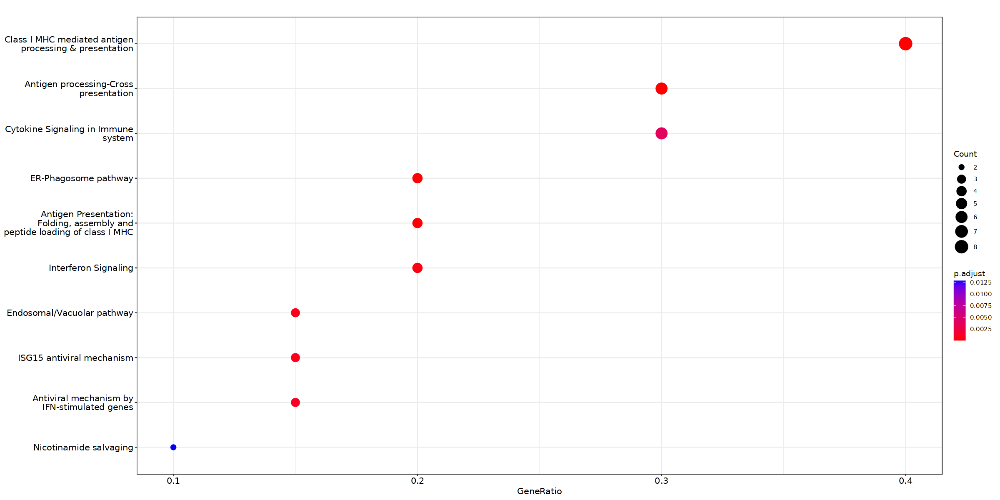

In [59]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [60]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 16 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


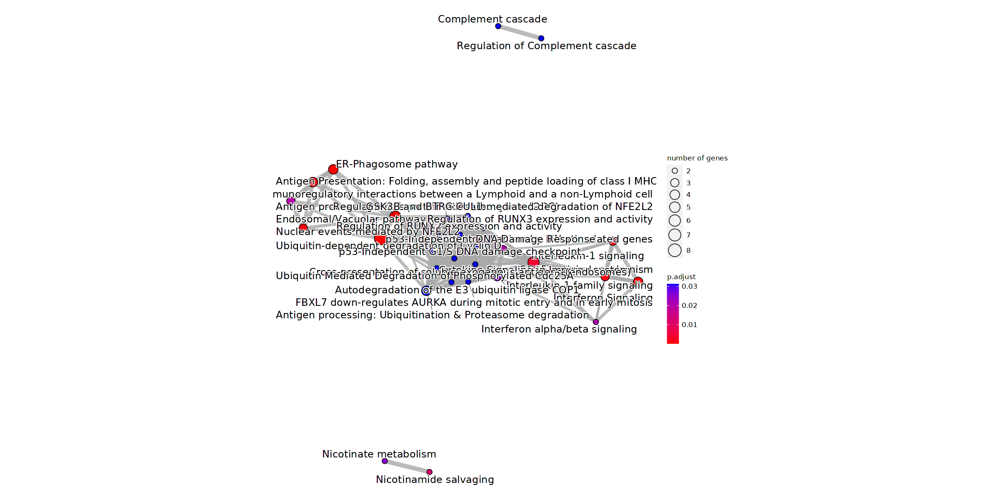

In [61]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.1.2 Category 2

In [62]:
gene_list <- c("Pla2g4f","Clcnka","Gm14207","Lrrc52","9230009I02Rik","Gm11690","Bpifa5","Bcl2l10","Gm26735","Kcns2","Il21","Hist1h2bk","Slc10a1","Hoxb2","Tpo","Hoxb7","Ddit4l","Btbd17","C1qtnf7","Lhx3","Lhfpl5","Musk","Dhrs3","Prtn3","6530403H02Rik","Gm4841","Serpina3c","Ifi47","Itgb2","Gbp2","Cd68","Rbp1","Gm17334","Bpifa3","Hoxb6","Crb2","Lrrn4cl","Hoxc9","Asmt","Dbx2","Cd200r2","Tnfrsf1a","Irf4","Hpgd","Slc25a24","Klk9","Emp3","Klk8","Tnfsf10","Glis3","Sdc1","D030068K23Rik","B530045E10Rik","D930032P07Rik","St6gal2","RP24-72B22.1","Cbln4","Npl","Tmem176b","Tagln2","Il3ra","Anxa7","Apoe","C1s2","Hoxb4","Ndst3","Palmd","Rab42","Gm14120","Gm5444","A230065N10Rik","Pilrb1","Plekhg6","Ces1a","Gm20429","Gm28548","Olfr1331","C230024C17Rik","Col6a1","Col6a2","Casp12","Col13a1","Spp2","Gm12951","Slc22a21","A330102I10Rik","Sema4f","G630018N14Rik","Piezo2","Rgs16","A930033H14Rik","Tmem176a","Hist1h2ah","Stra6l","Tnfrsf1b","Kcna4","Ddx4","Panx1","Sox11","RP23-333I7.1","Itpripl2","Ucn2","En1","Cd200r1","Igfbpl1","Runx1","Col7a1","Vav3","Steap3")

In [63]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [64]:
length(gene_list)

[1] 98

In [65]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [66]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [67]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [68]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [69]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [70]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [71]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [72]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "11816" "667742" "15953" "14469" "21346" "12834" "259277" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...17 enriched terms found
'data.frame':	17 obs. of  9 variables:
 $ ID         : chr  "R-MMU-216083" "R-MMU-8948216" "R-MMU-1442490" "R-MMU-1650814" ...
 $ Description: chr  "Integrin cell surface interactions" "Collagen chain trimerization" "Collagen degradation" "Collagen biosynthesis and modifying enzymes" ...
 $ GeneRatio  : chr  "5/27" "4/27" "4/27" "4/27" ...
 $ BgRatio    : chr  "66/8501" "35/8501" "55/8501" "60/8501" ...
 $ pvalue     : num  1.71e-06 3.95e-06 2.46e-05 3.49e-05 6.92e-05 ...
 $ p.adjust   : num  0.000222 0.000257 0.001068 0.001133 0.001639 ...
 $ qvalue     : num  0.000157 0.000181 0.000752 0.000798 0.001154 ...
 $ geneID     : chr  "Col6a2/Col13a1/Col6a1/Itgb2/Col7a1" "Col6a2/Col13a1/Col6a1/Col7a1" "Col6a2/Col13a1/Col6a1/Col7

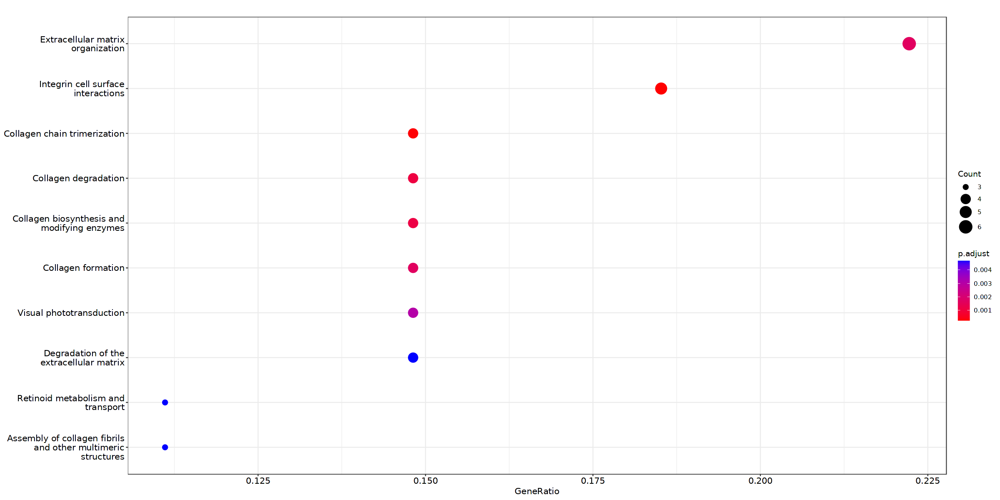

In [73]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [74]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

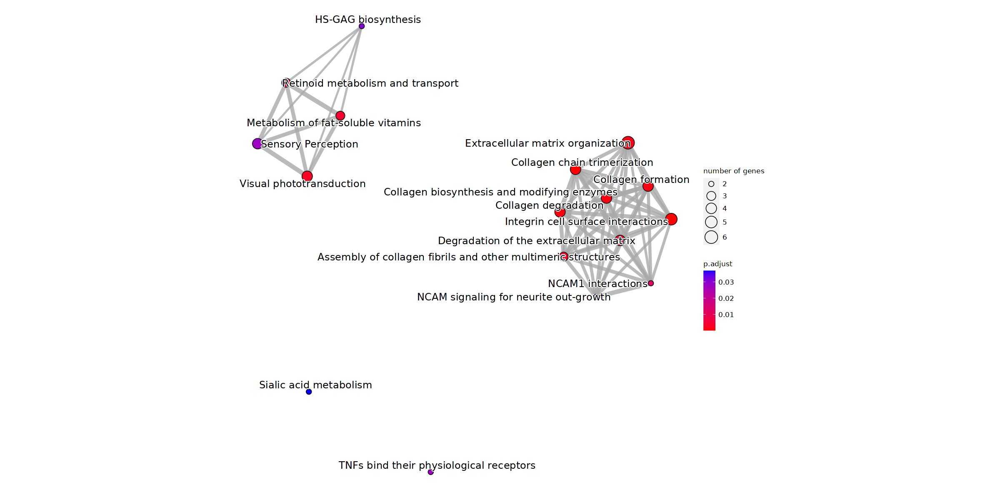

In [75]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [76]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [77]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "11816" "667742" "15953" "14469" "21346" "12834" "259277" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...130 enriched terms found
'data.frame':	130 obs. of  9 variables:
 $ ID         : chr  "R-MMU-216083" "R-MMU-8948216" "R-MMU-1442490" "R-MMU-1650814" ...
 $ Description: chr  "Integrin cell surface interactions" "Collagen chain trimerization" "Collagen degradation" "Collagen biosynthesis and modifying enzymes" ...
 $ GeneRatio  : chr  "5/27" "4/27" "4/27" "4/27" ...
 $ BgRatio    : chr  "66/8501" "35/8501" "55/8501" "60/8501" ...
 $ pvalue     : num  1.71e-06 3.95e-06 2.46e-05 3.49e-05 6.92e-05 ...
 $ p.adjust   : num  0.000222 0.000257 0.001068 0.001133 0.001639 ...
 $ qvalue     : num  0.000157 0.000181 0.000752 0.000798 0.001154 ...
 $ geneID     : chr  "Col6a2/Col13a1/Col6a1/Itgb2/Col7a1" "Col6a2/Col13a1/Col6a1/Col7a1" "Col6a2/Col13a1/Col6a1/Col7a

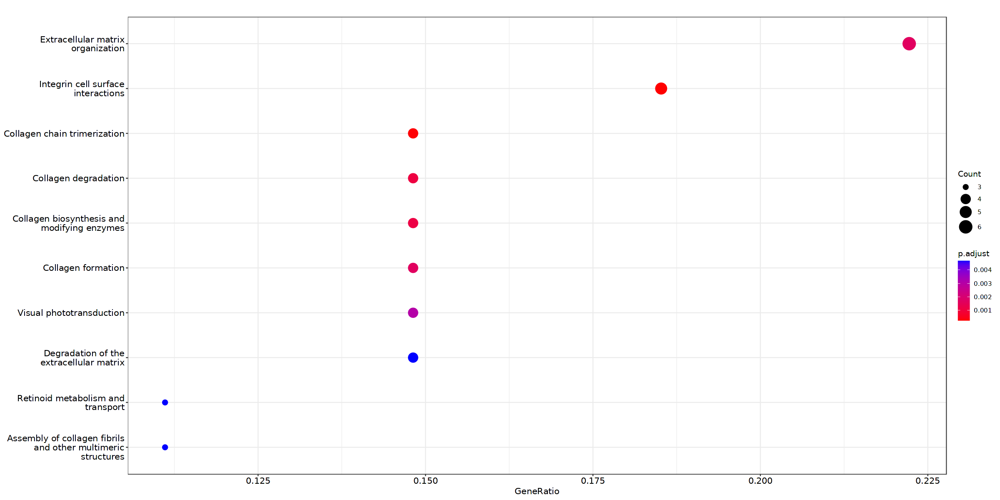

In [78]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [79]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

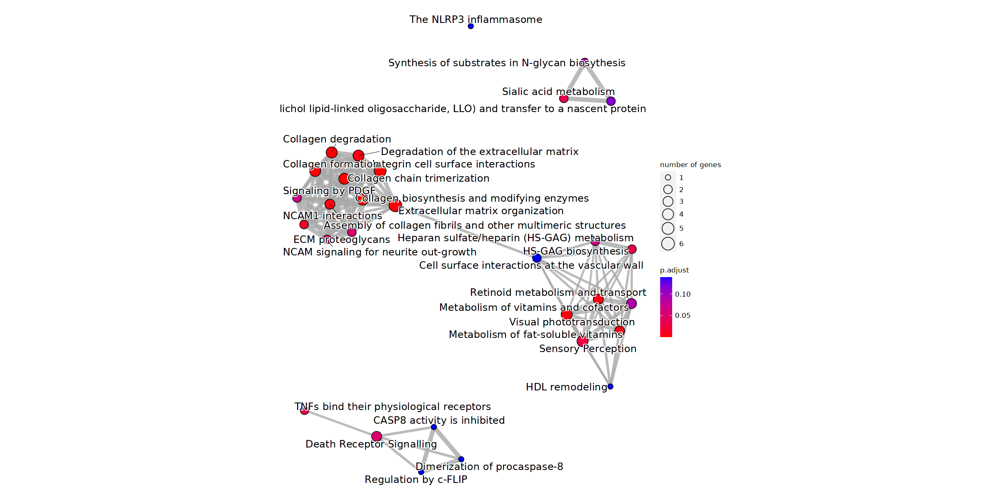

In [80]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.1.3 Sub category 1

In [81]:
gene_list <- c("Slc13a1","Glp1r","Mmrn1","4933430M04Rik","Gm12707","Gm16019","Gm12714","4921508D12Rik","Gm15839","Smco2","Gm12505","Vwc2l","1700007J10Rik","Sycp1")

In [82]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [83]:
length(gene_list)

[1] 13

In [84]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [85]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [86]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [87]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [88]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [89]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [90]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [91]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:10] "55961" "69320" "320460" "20957" "70945" "14652" "69371" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [94]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [95]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:10] "55961" "69320" "320460" "20957" "70945" "14652" "69371" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...13 enriched terms found
'data.frame':	13 obs. of  9 variables:
 $ ID         : chr  "R-MMU-381676" "R-MMU-420092" "R-MMU-373080" "R-MMU-422356" ...
 $ Description: chr  "Glucagon-like Peptide-1 (GLP1) regulates insulin secretion" "Glucagon-type ligand receptors" "Class B/2 (Secretin family receptors)" "Regulation of insulin secretion" ...
 $ GeneRatio  : chr  "1/3" "1/3" "1/3" "1/3" ...
 $ BgRatio    : chr  "31/8501" "32/8501" "55/8501" "60/8501" ...
 $ pvalue     : num  0.0109 0.0113 0.0193 0.021 0.0249 ...
 $ p.adjust   : num  0.0576 0.0576 0.0576 0.0576 0.0576 ...
 $ qvalue     : num  0.0187 0.0187 0.0187 0.0187 0.0187 ...
 $ geneID     : chr  "Glp1r" "Glp1r" "Glp1r" "Glp1r" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuan

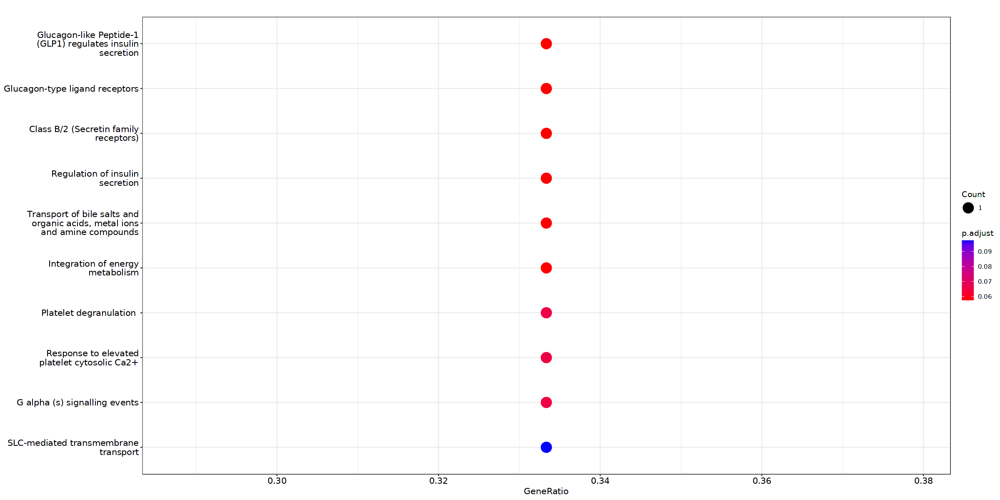

In [96]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [97]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

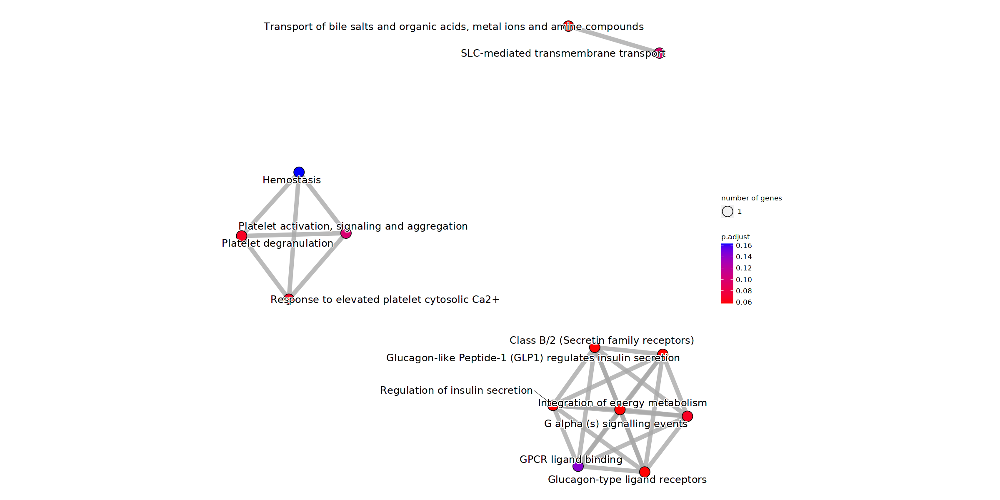

In [98]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.1.4 Sub category 2

In [99]:
gene_list <- c("Gm14321","Htr3b","1700061I17Rik","Spink14","Gm26832","Gm11548","Lyzl1","Gm21905","Olfr649","Gm4792","Slc18a3","Pldi","Gm26744","Eef1a2","Slc22a12","A530058N18Rik","Cntnap3","Ceacam3","Tigit","Zbbx","Papss2","Skint6","Gm10964","4930445B16Rik","Aass","Slc36a3","Hist1h2bf")

In [100]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [101]:
length(gene_list)

[1] 26

In [102]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [103]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [104]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [105]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [106]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [107]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [108]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [109]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:18] "23972" "13628" "230622" "238680" "30956" "100043314" "215332" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...3 enriched terms found
'data.frame':	3 obs. of  9 variables:
 $ ID         : chr  "R-MMU-549132" "R-MMU-71064" "R-MMU-156584"
 $ Description: chr  "Organic cation/anion/zwitterion transport" "Lysine catabolism" "Cytosolic sulfonation of small molecules"
 $ GeneRatio  : chr  "1/4" "1/4" "1/4"
 $ BgRatio    : chr  "12/8501" "12/8501" "15/8501"
 $ pvalue     : num  0.00564 0.00564 0.00704
 $ p.adjust   : num  0.0305 0.0305 0.0305
 $ qvalue     : num  0.0198 0.0198 0.0198
 $ geneID     : chr  "Slc22a12" "Aass" "Papss2"
 $ Count      : int  1 1 1
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


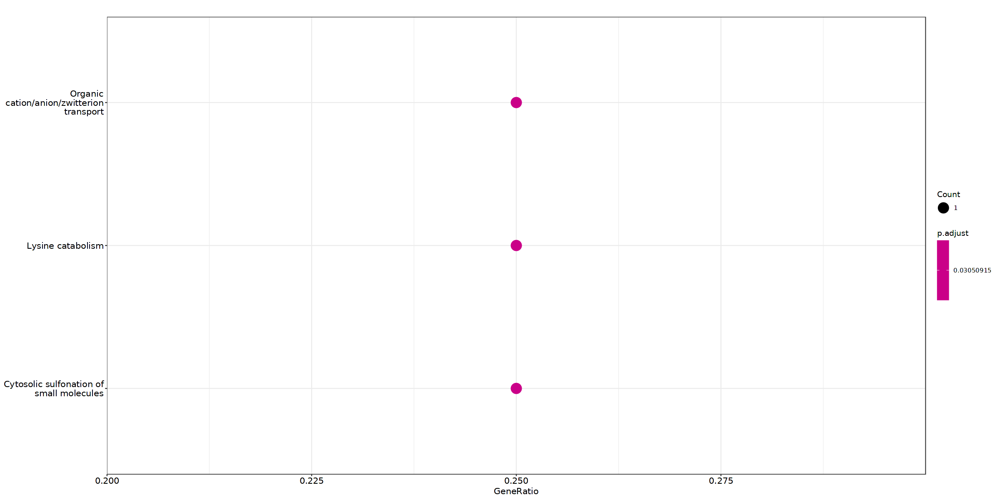

In [110]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [111]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

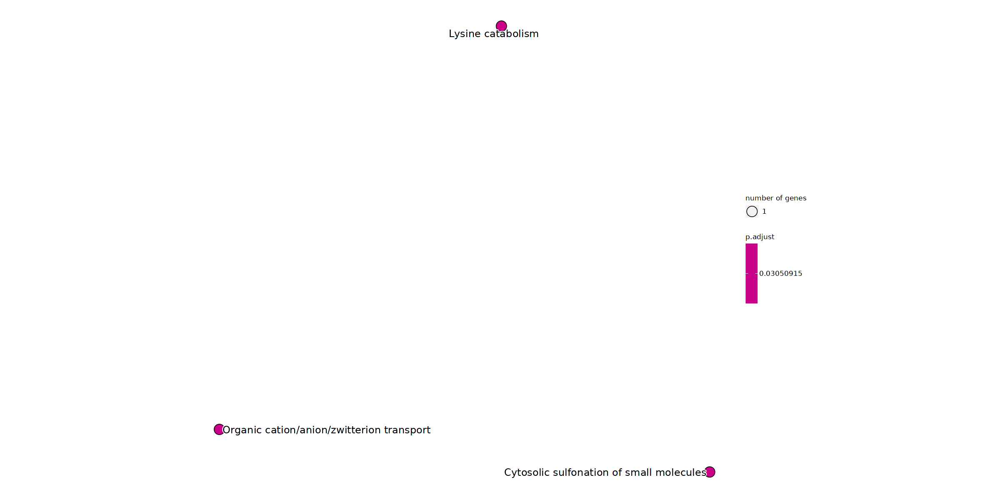

In [112]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [113]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [114]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:18] "23972" "13628" "230622" "238680" "30956" "100043314" "215332" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...13 enriched terms found
'data.frame':	13 obs. of  9 variables:
 $ ID         : chr  "R-MMU-549132" "R-MMU-71064" "R-MMU-156584" "R-MMU-425366" ...
 $ Description: chr  "Organic cation/anion/zwitterion transport" "Lysine catabolism" "Cytosolic sulfonation of small molecules" "Transport of bile salts and organic acids, metal ions and amine compounds" ...
 $ GeneRatio  : chr  "1/4" "1/4" "1/4" "1/4" ...
 $ BgRatio    : chr  "12/8501" "12/8501" "15/8501" "71/8501" ...
 $ pvalue     : num  0.00564 0.00564 0.00704 0.033 0.04396 ...
 $ p.adjust   : num  0.0305 0.0305 0.0305 0.1072 0.1143 ...
 $ qvalue     : num  0.0198 0.0198 0.0198 0.0695 0.074 ...
 $ geneID     : chr  "Slc22a12" "Aass" "Papss2" "Slc22a12" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 

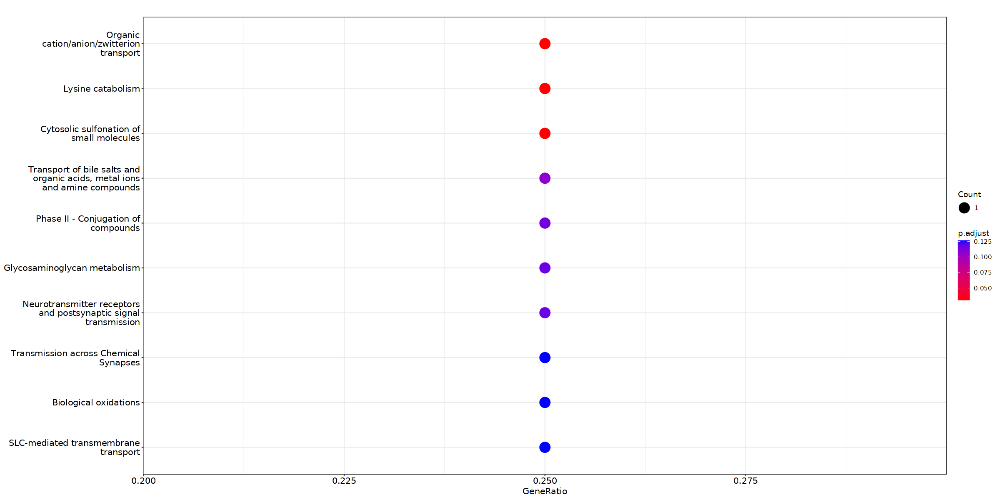

In [115]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [116]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

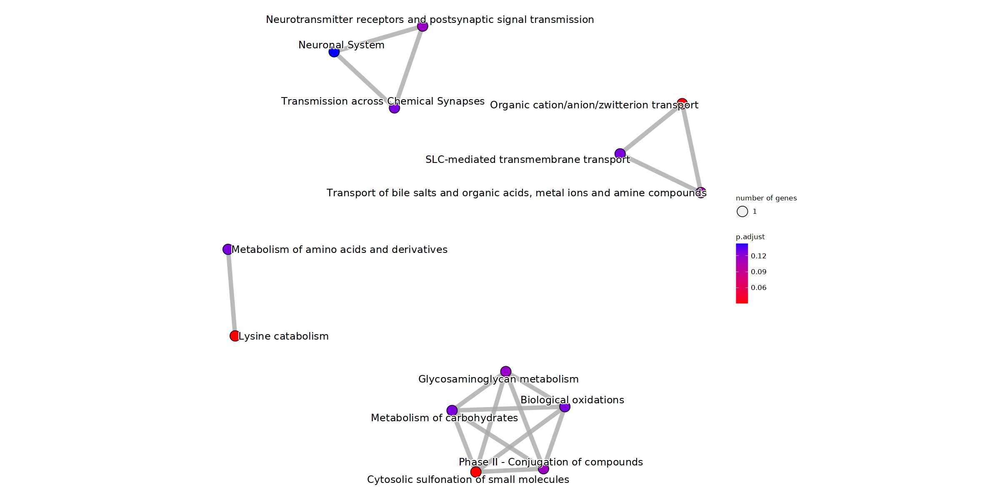

In [117]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.1.5 Sub category 3

In [118]:
gene_list <- c("H2-Q6","Tnfsf11","Fgl2","Corin","Erp27","Gm28694","Klk6","Amotl1","C4b","Oas1c","Ddx60","Fosl2","Arhgef38","Sirpb1b","Gm3604","Mill2","Serpina3n","Fam13a","Hcn1","Hspb8","Fxyd3","Crmp1","I830012O16Rik","Gm14446","Crlf2","Vmn2r79","Cd200r4","Plvap","Gm7030","H2-Q7","Tex16","H2-Q4","H2-M3","Gbp5","Gm19684","Slfn3","Hist1h4n","n-R5s213","Gm340","Olfr648","Hist1h4b","Tgtp2","Klk7","Gbp4","Olfr56","Gm4951","Gbp8","Trim12a","Gbp9","Ptchd1","4930468A15Rik","Gm11986","Tgtp1","Tlr1","Gm5570","1700029J03Rik","9930038B18Rik","Htr5a","Il18bp","Gm12296","4930435H24Rik","Ifi27l2a","Serpina3i","Zbp1","Napsa","Gm12185","Tmco5b","Gm16976","Gm27198","Cyb561","Cd300lf","Gm16758","Ms4a4d","Tnfrsf14","Cdh22","Ggta1","Trim12c","Iigp1","Gm6034","Trim34a","Lgals3bp","Slc10a6","Oasl2","Psmb9","H2-T23","Serping1","Plin4","Ace3","BC048679","H2-T24","Trim30d","Oas1a","Psmb11","Tmem28","Chp2","Cryba1","Fsd2","Olfm3","Gm7976","A530058N18Rik.1","Zfp872","Ifit3","Irf8","Gbp6","Gm9930","Epha8","Mmp20","Trim21","Irgm1","Ifit1","Parp14","Serpina3f","Usp18","Igtp","Parp9","Gbp7","Wbscr17","Gm29643","9330175E14Rik","Samd9l","Irf9","Gbp3","Irf7","C1ra","Tap1","Slfn9","Rtp4","Psmb8","Irgm2","Bst2","Irf1","4632428C04Rik","Cmpk2","2010002M12Rik","RP24-571H12.4","RP24-539A2.1","Isg15","Cd274","Sult1a1","Ms4a4c","4930558J22Rik","Herc6","Mgst2","Socs3","Dtx3l","Rnf213","Eif2ak2","Gm28417","Gm13003","4930518I15Rik","Eid2","Dio2","Ccr5","Far2","St8sia4","Hnf4g","Gm26512","Gpr21","4930594M22Rik","Ceacam20","Magee2","Gm26760","Gm10392","Etnppl","Hist1h2ad","Vwa5a","Lrfn3","Scnn1a","Zfp937")

In [119]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [120]:
length(gene_list)

[1] 145

In [121]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [122]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [123]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [124]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [125]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [126]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [127]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [128]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:50] "15040" "60440" "16145" "12268" "15944" "16913" "240327" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...103 enriched terms found
'data.frame':	103 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-983169" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Class I MHC mediated antigen processing & presentation" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "6/20" "8/20" "4/20" "4/20" ...
 $ BgRatio    : chr  "92/8501" "343/8501" "34/8501" "41/8501" ...
 $ pvalue     : num  4.68e-08 5.33e-07 9.88e-07 2.13e-06 1.38e-05 ...
 $ p.adjust   : num  7.62e-06 4.35e-05 5.37e-05 8.70e-05 4.49e-04 ...
 $ qvalue     : num  2.36e-06 1.35e-05 1.66e-05 2.70e-05 1.39e-04 ...
 $ geneID     : chr  "H2-T23/Psmb8/Tap1/Psmb9/H2-Q7/H2-

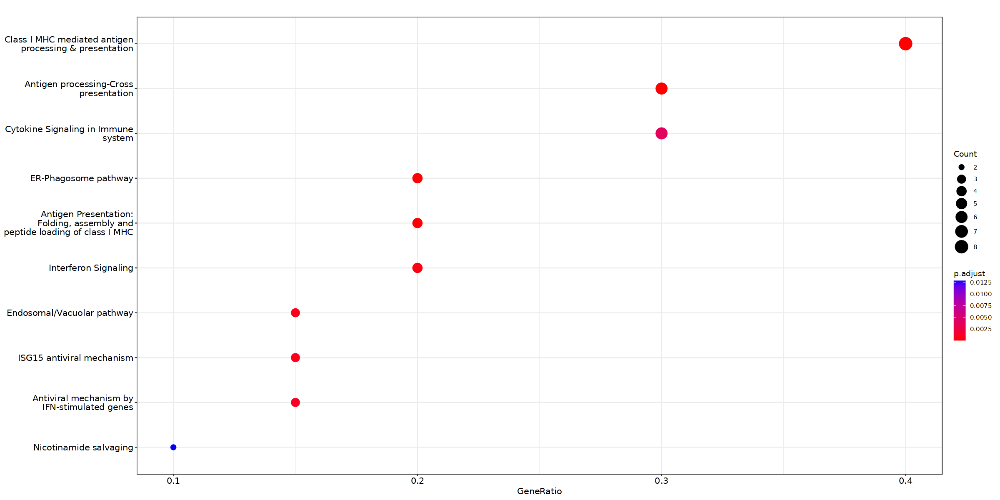

In [129]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [130]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 10 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


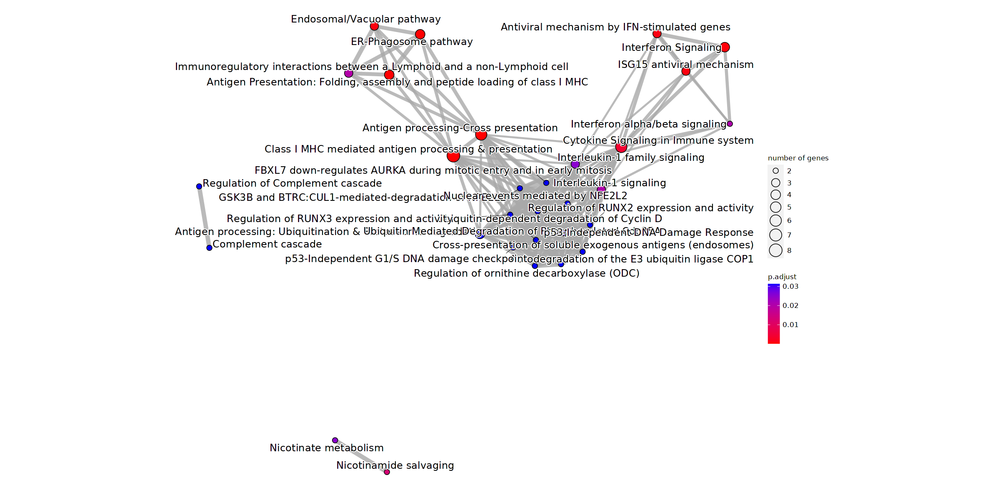

In [131]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [132]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [133]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:50] "15040" "60440" "16145" "12268" "15944" "16913" "240327" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...163 enriched terms found
'data.frame':	163 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-983169" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Class I MHC mediated antigen processing & presentation" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "6/20" "8/20" "4/20" "4/20" ...
 $ BgRatio    : chr  "92/8501" "343/8501" "34/8501" "41/8501" ...
 $ pvalue     : num  4.68e-08 5.33e-07 9.88e-07 2.13e-06 1.38e-05 ...
 $ p.adjust   : num  7.62e-06 4.35e-05 5.37e-05 8.70e-05 4.49e-04 ...
 $ qvalue     : num  2.36e-06 1.35e-05 1.66e-05 2.70e-05 1.39e-04 ...
 $ geneID     : chr  "H2-T23/Psmb8/Tap1/Psmb9/H2-Q7/H2-Q4"

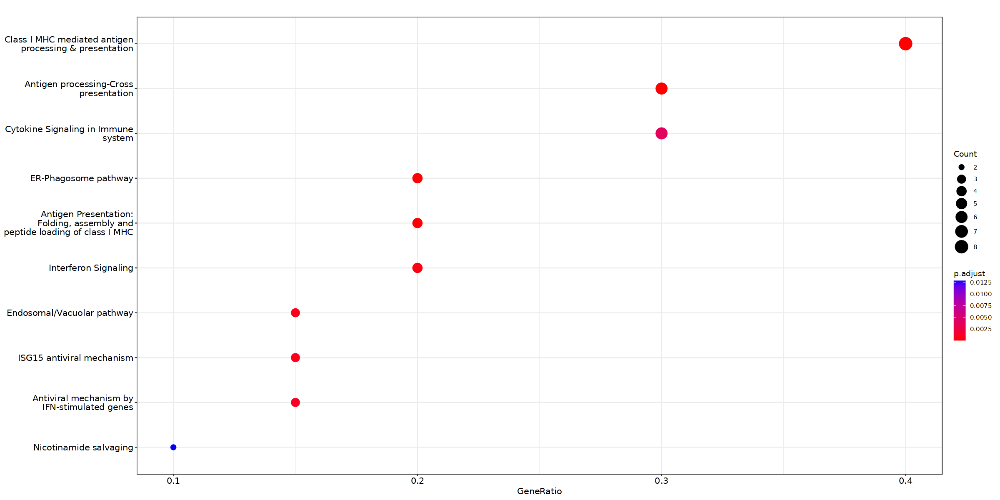

In [134]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [135]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 11 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


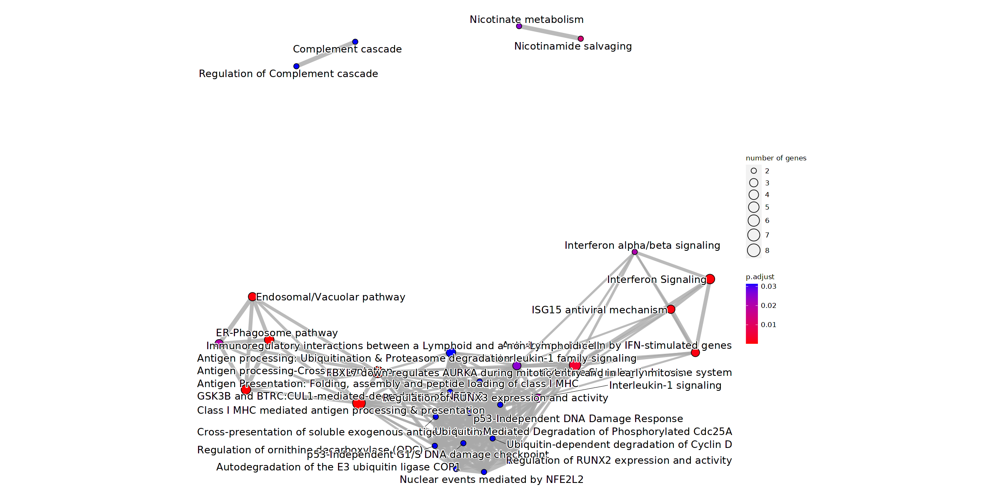

In [136]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.1.6 Sub category 4

In [137]:
gene_list <- c("Sytl5","Gm29185","Ttr","T","Avpr1b","Eltd1","Pde1a","Gm5860","Trim34b","Gm11840","Gm28905","1200007C13Rik","Gm29125")

In [138]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [139]:
length(gene_list)

[1] 11

In [140]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [141]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [142]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [143]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [144]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [145]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [146]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [147]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:6] "236643" "18573" "20997" "22139" "545641" "434218"
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...16 enriched terms found
'data.frame':	16 obs. of  9 variables:
 $ ID         : chr  "R-MMU-418457" "R-MMU-392154" "R-MMU-2453902" "R-MMU-111933" ...
 $ Description: chr  "cGMP effects" "Nitric oxide stimulates guanylate cyclase" "The canonical retinoid cycle in rods (twilight vision)" "Calmodulin induced events" ...
 $ GeneRatio  : chr  "1/2" "1/2" "1/2" "1/2" ...
 $ BgRatio    : chr  "10/8501" "13/8501" "20/8501" "25/8501" ...
 $ pvalue     : num  0.00235 0.00306 0.0047 0.00587 0.00587 ...
 $ p.adjust   : num  0.0181 0.0181 0.0181 0.0181 0.0181 ...
 $ qvalue     : num  0.00286 0.00286 0.00286 0.00286 0.00286 ...
 $ geneID     : chr  "Pde1a" "Pde1a" "Ttr" "Pde1a" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. React

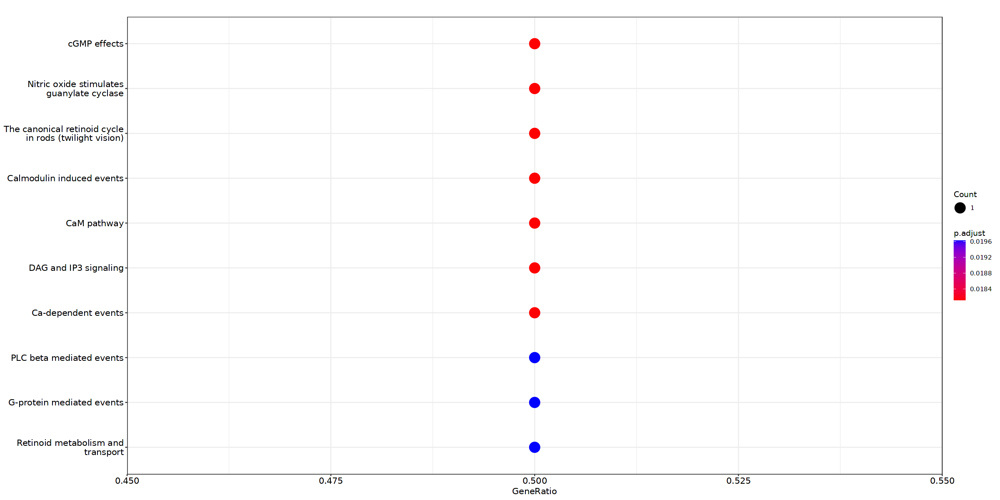

In [148]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [149]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

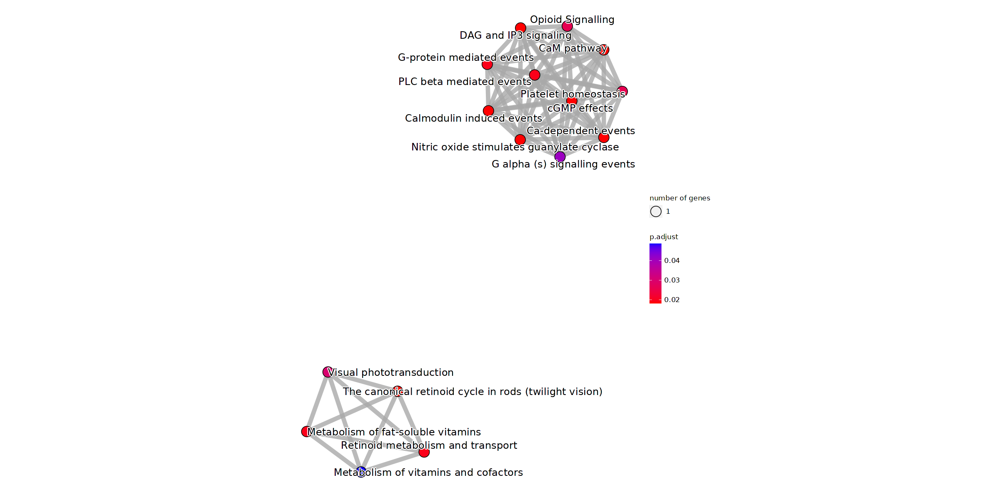

In [150]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [151]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [152]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:6] "236643" "18573" "20997" "22139" "545641" "434218"
#...pvalues adjusted by 'fdr' with cutoff <1 
#...20 enriched terms found
'data.frame':	20 obs. of  9 variables:
 $ ID         : chr  "R-MMU-418457" "R-MMU-392154" "R-MMU-2453902" "R-MMU-111933" ...
 $ Description: chr  "cGMP effects" "Nitric oxide stimulates guanylate cyclase" "The canonical retinoid cycle in rods (twilight vision)" "Calmodulin induced events" ...
 $ GeneRatio  : chr  "1/2" "1/2" "1/2" "1/2" ...
 $ BgRatio    : chr  "10/8501" "13/8501" "20/8501" "25/8501" ...
 $ pvalue     : num  0.00235 0.00306 0.0047 0.00587 0.00587 ...
 $ p.adjust   : num  0.0181 0.0181 0.0181 0.0181 0.0181 ...
 $ qvalue     : num  0.00286 0.00286 0.00286 0.00286 0.00286 ...
 $ geneID     : chr  "Pde1a" "Pde1a" "Ttr" "Pde1a" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. Reactome

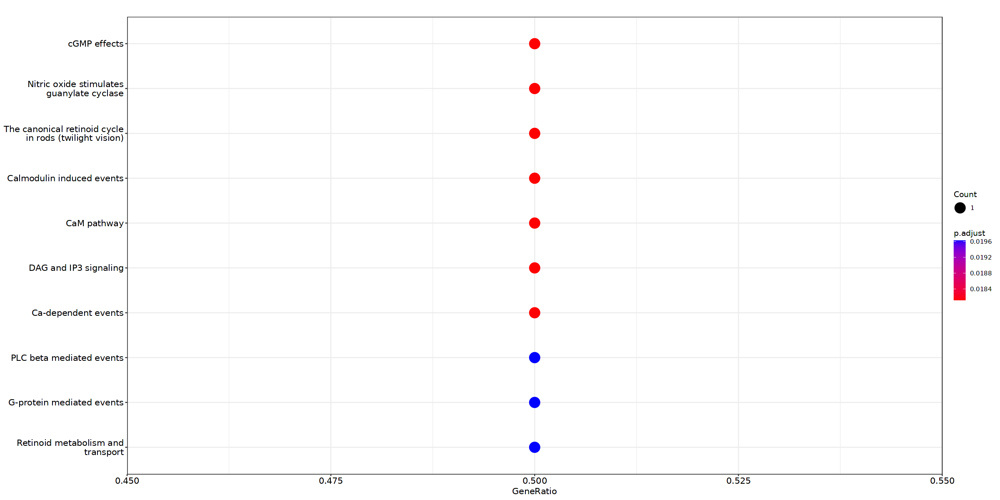

In [153]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [154]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

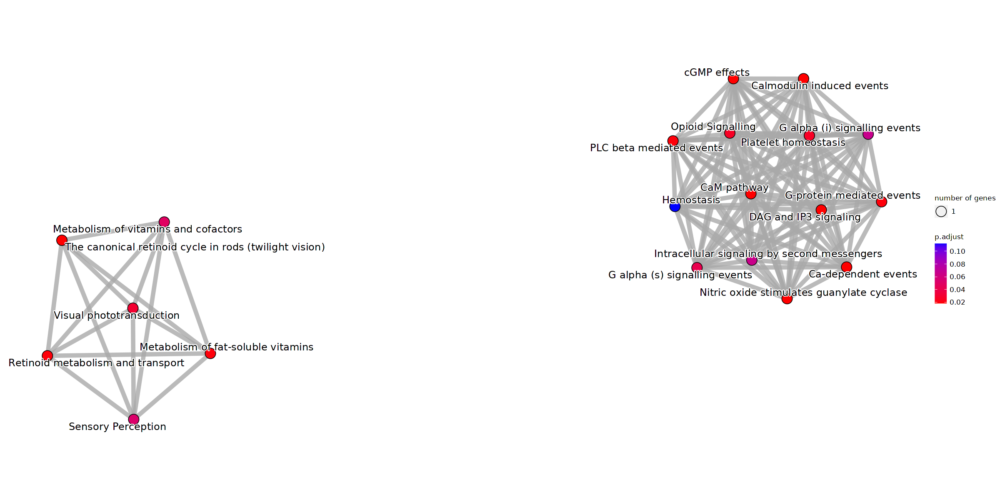

In [155]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.1.7 Sub category 5

In [156]:
gene_list <- c("Pla2g4f","Clcnka","Gm14207","Lrrc52","9230009I02Rik","Gm11690","Bpifa5","Bcl2l10","Gm26735","Kcns2","Il21","Hist1h2bk","Slc10a1","Hoxb2","Tpo","Hoxb7","Ddit4l","Btbd17","C1qtnf7","Lhx3","Lhfpl5")

In [157]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [158]:
length(gene_list)

[1] 19

In [159]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [160]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [161]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [162]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [163]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [164]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [165]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [166]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:17] "72014" "20493" "73284" "103889" "15415" "100043609" "328789" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...9 enriched terms found
'data.frame':	9 obs. of  9 variables:
 $ ID         : chr  "R-MMU-209776" "R-MMU-1482922" "R-MMU-159418" "R-MMU-1482925" ...
 $ Description: chr  "Metabolism of amine-derived hormones" "Acyl chain remodelling of PI" "Recycling of bile acids and salts" "Acyl chain remodelling of PG" ...
 $ GeneRatio  : chr  "1/5" "1/5" "1/5" "1/5" ...
 $ BgRatio    : chr  "16/8501" "17/8501" "17/8501" "18/8501" ...
 $ pvalue     : num  0.00938 0.00996 0.00996 0.01054 0.01288 ...
 $ p.adjust   : num  0.0383 0.0383 0.0383 0.0383 0.0383 ...
 $ qvalue     : num  0.019 0.019 0.019 0.019 0.019 ...
 $ geneID     : chr  "Tpo" "Pla2g4f" "Slc10a1" "Pla2g4f" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1
#...Citation
  Guangchuang Yu, Qing-Yu He. Reacto

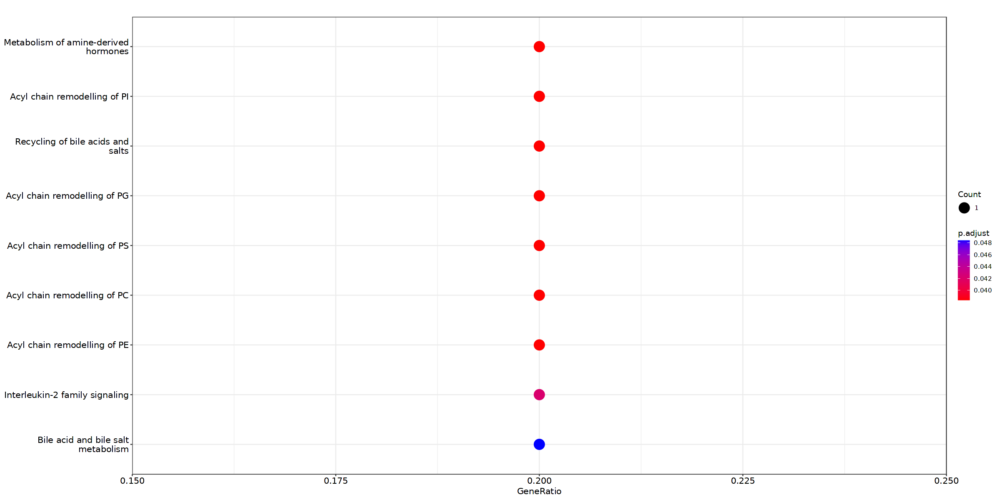

In [167]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [168]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

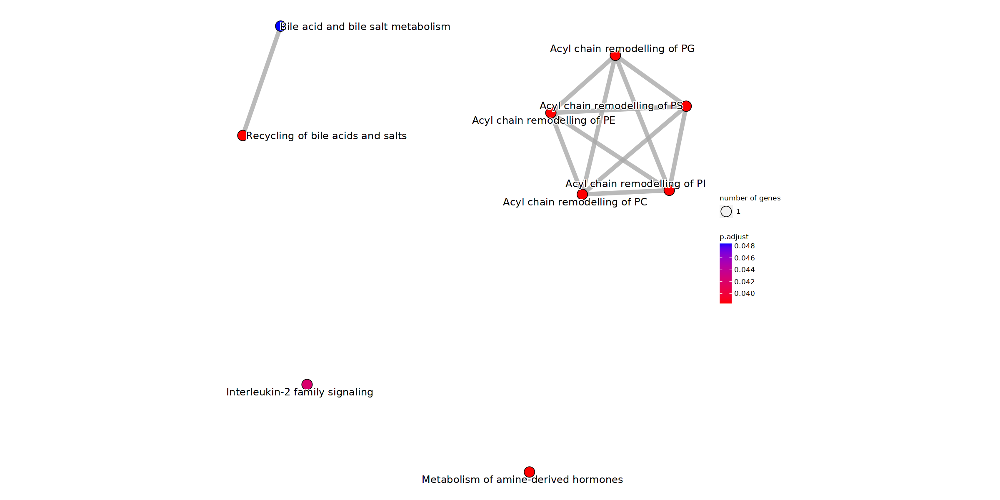

In [169]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [170]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [171]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:17] "72014" "20493" "73284" "103889" "15415" "100043609" "328789" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...17 enriched terms found
'data.frame':	17 obs. of  9 variables:
 $ ID         : chr  "R-MMU-209776" "R-MMU-1482922" "R-MMU-159418" "R-MMU-1482925" ...
 $ Description: chr  "Metabolism of amine-derived hormones" "Acyl chain remodelling of PI" "Recycling of bile acids and salts" "Acyl chain remodelling of PG" ...
 $ GeneRatio  : chr  "1/5" "1/5" "1/5" "1/5" ...
 $ BgRatio    : chr  "16/8501" "17/8501" "17/8501" "18/8501" ...
 $ pvalue     : num  0.00938 0.00996 0.00996 0.01054 0.01288 ...
 $ p.adjust   : num  0.0383 0.0383 0.0383 0.0383 0.0383 ...
 $ qvalue     : num  0.019 0.019 0.019 0.019 0.019 ...
 $ geneID     : chr  "Tpo" "Pla2g4f" "Slc10a1" "Pla2g4f" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. R

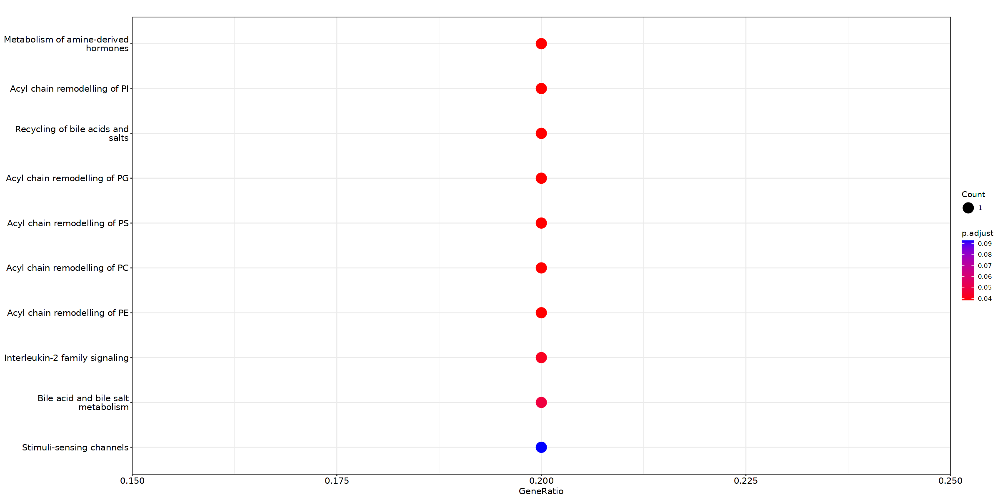

In [172]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [173]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

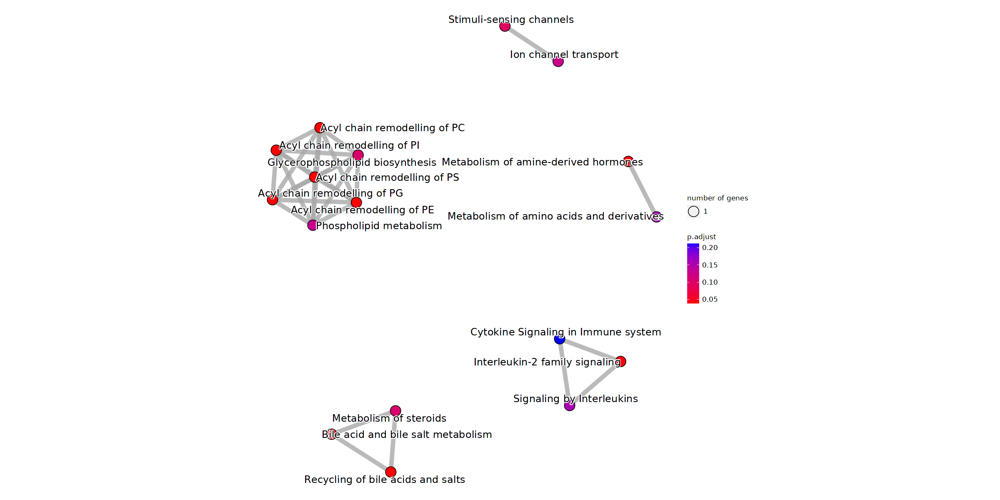

In [174]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.1.8 Sub category 6

In [175]:
gene_list <- c("Musk","Dhrs3","Prtn3","6530403H02Rik","Gm4841","Serpina3c","Ifi47","Itgb2","Gbp2","Cd68","Rbp1","Gm17334","Bpifa3","Hoxb6","Crb2","Lrrn4cl","Hoxc9","Asmt","Dbx2","Cd200r2")

In [176]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [177]:
length(gene_list)

[1] 18

In [178]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [179]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [180]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [181]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [182]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [183]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [184]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [185]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:17] "15953" "14469" "19659" "12514" "225594" "16414" "223843" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...2 enriched terms found
'data.frame':	2 obs. of  9 variables:
 $ ID         : chr  "R-MMU-2187338" "R-MMU-198933"
 $ Description: chr  "Visual phototransduction" "Immunoregulatory interactions between a Lymphoid and a non-Lymphoid cell"
 $ GeneRatio  : chr  "2/7" "2/7"
 $ BgRatio    : chr  "89/8501" "95/8501"
 $ pvalue     : num  0.0022 0.0025
 $ p.adjust   : num  0.0263 0.0263
 $ qvalue     : num  0.0132 0.0132
 $ geneID     : chr  "Rbp1/Dhrs3" "Itgb2/Cd200r2"
 $ Count      : int  2 2
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


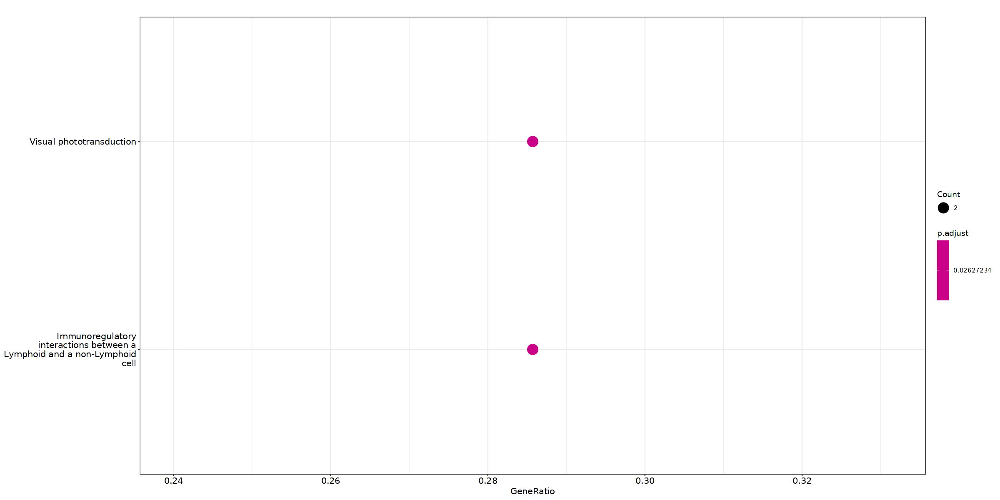

In [186]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [187]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

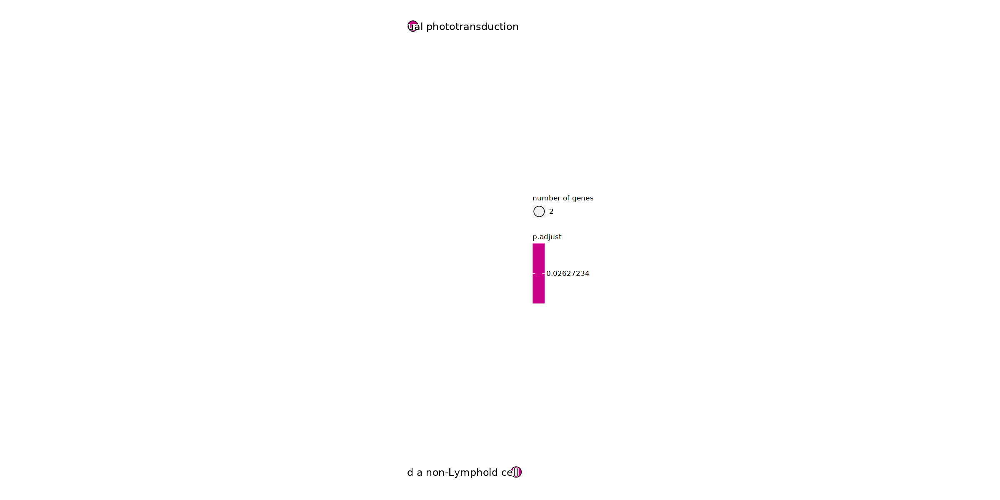

In [188]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [189]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [190]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:17] "15953" "14469" "19659" "12514" "225594" "16414" "223843" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...21 enriched terms found
'data.frame':	21 obs. of  9 variables:
 $ ID         : chr  "R-MMU-2187338" "R-MMU-198933" "R-MMU-9709957" "R-MMU-209776" ...
 $ Description: chr  "Visual phototransduction" "Immunoregulatory interactions between a Lymphoid and a non-Lymphoid cell" "Sensory Perception" "Metabolism of amine-derived hormones" ...
 $ GeneRatio  : chr  "2/7" "2/7" "2/7" "1/7" ...
 $ BgRatio    : chr  "89/8501" "95/8501" "192/8501" "16/8501" ...
 $ pvalue     : num  0.0022 0.0025 0.00989 0.01311 0.01636 ...
 $ p.adjust   : num  0.0263 0.0263 0.0515 0.0515 0.0515 ...
 $ qvalue     : num  0.0132 0.0132 0.0258 0.0258 0.0258 ...
 $ geneID     : chr  "Rbp1/Dhrs3" "Itgb2/Cd200r2" "Rbp1/Dhrs3" "Asmt" ...
 $ Count      : int  2 2 2 1 1 1 1 1 1 1 ...
#...Ci

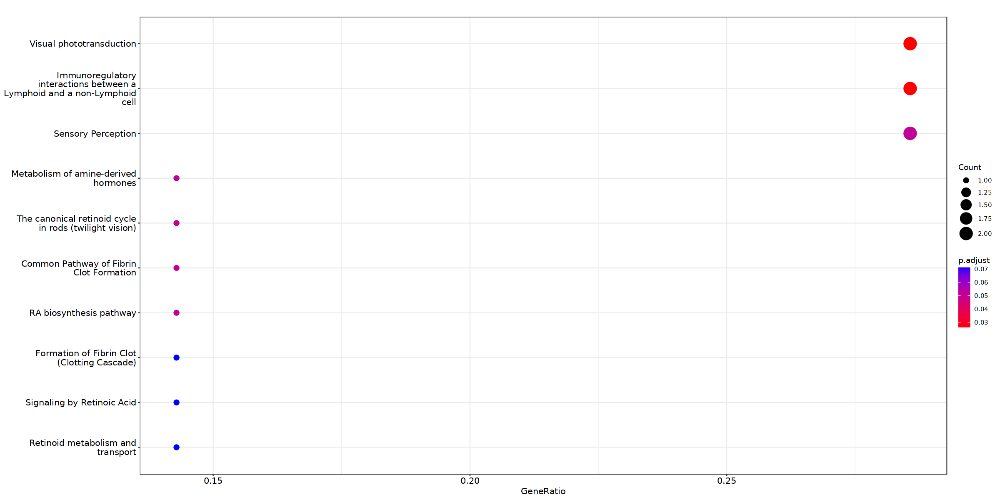

In [191]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [192]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

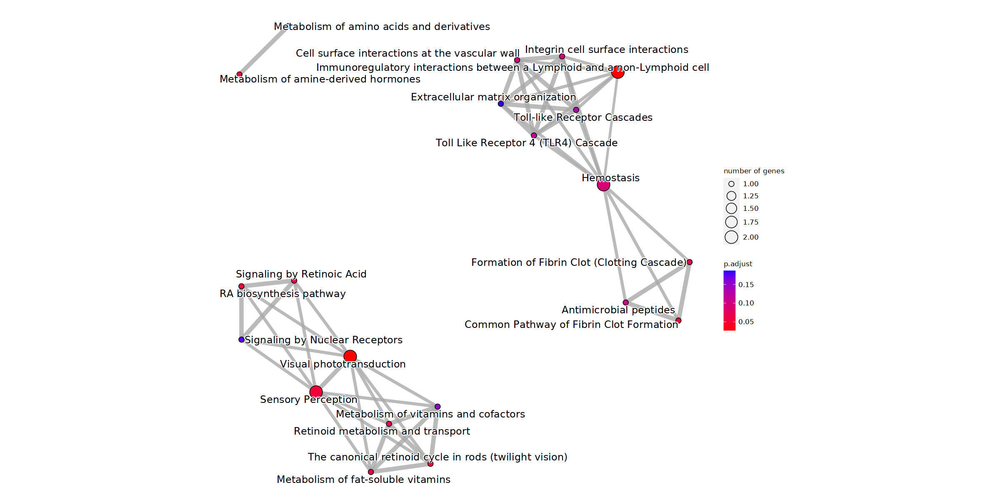

In [193]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.1.9 Sub category 7

In [194]:
gene_list <- c("Tnfrsf1a","Irf4","Hpgd","Slc25a24","Klk9","Emp3","Klk8","Tnfsf10","Glis3","Sdc1","D030068K23Rik","B530045E10Rik","D930032P07Rik","St6gal2","RP24-72B22.1","Cbln4","Npl","Tmem176b","Tagln2","Il3ra","Anxa7","Apoe","C1s2","Hoxb4","Ndst3","Palmd","Rab42","Gm14120","Gm5444","A230065N10Rik","Pilrb1","Plekhg6","Ces1a","Gm20429","Gm28548","Olfr1331","C230024C17Rik","Col6a1","Col6a2","Casp12","Col13a1","Spp2","Gm12951","Slc22a21","A330102I10Rik","Sema4f","G630018N14Rik","Piezo2","Rgs16","A930033H14Rik","Tmem176a","Hist1h2ah","Stra6l","Tnfrsf1b","Kcna4","Ddx4","Panx1","Sox11","RP23-333I7.1","Itpripl2","Ucn2","En1","Cd200r1","Igfbpl1","Runx1","Col7a1","Vav3","Steap3")

In [195]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [196]:
length(gene_list)

[1] 61

In [197]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [198]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [199]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [200]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [201]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [202]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [203]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [204]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "11816" "667742" "21346" "12834" "259277" "12394" "20355" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...16 enriched terms found
'data.frame':	16 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8948216" "R-MMU-1442490" "R-MMU-1650814" "R-MMU-216083" ...
 $ Description: chr  "Collagen chain trimerization" "Collagen degradation" "Collagen biosynthesis and modifying enzymes" "Integrin cell surface interactions" ...
 $ GeneRatio  : chr  "4/24" "4/24" "4/24" "4/24" ...
 $ BgRatio    : chr  "35/8501" "55/8501" "60/8501" "66/8501" ...
 $ pvalue     : num  2.41e-06 1.51e-05 2.14e-05 3.13e-05 4.67e-05 ...
 $ p.adjust   : num  0.000302 0.000893 0.000893 0.000979 0.001167 ...
 $ qvalue     : num  0.000191 0.000564 0.000564 0.000618 0.000737 ...
 $ geneID     : chr  "Col6a2/Col13a1/Col6a1/Col7a1" "Col6a2/Col13a1/Col6a1/Col7a1" "Col6a2/Col13a1/Col6a1/Col7a1" "C

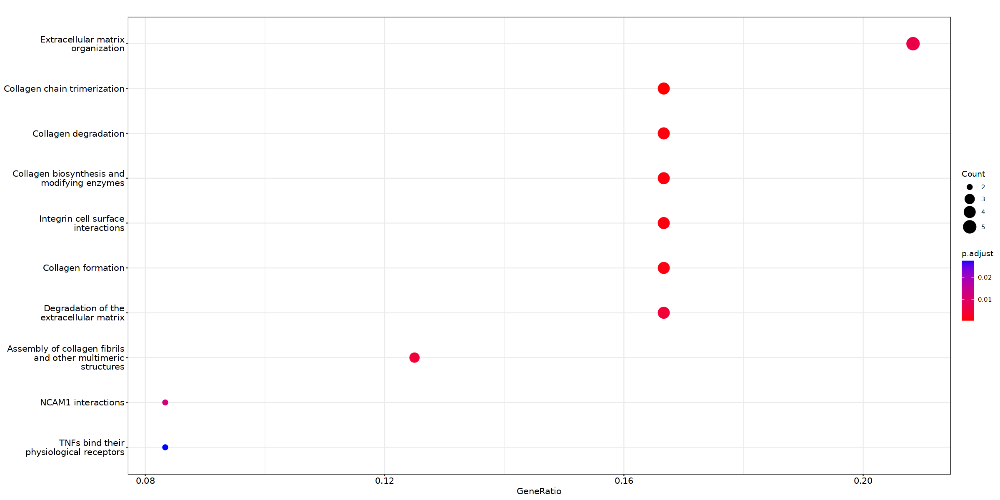

In [205]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [206]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

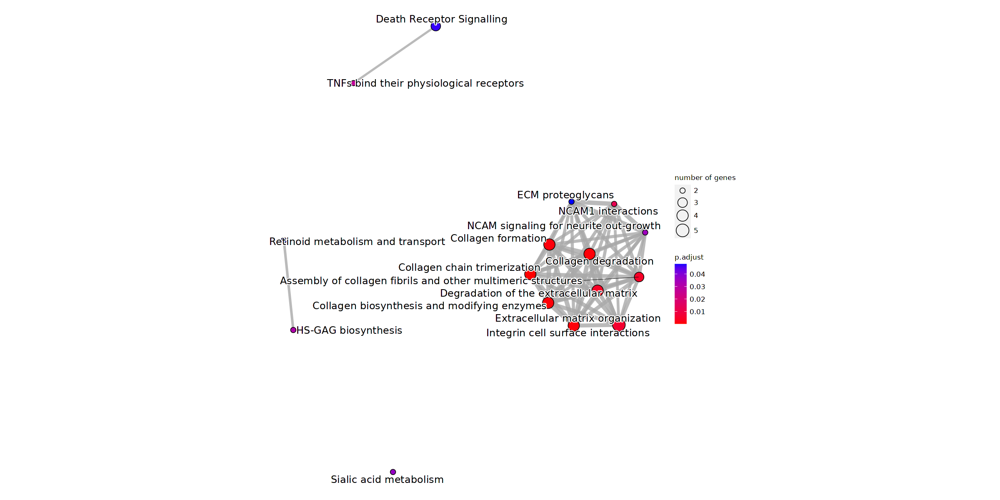

In [207]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [208]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [209]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "11816" "667742" "21346" "12834" "259277" "12394" "20355" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...125 enriched terms found
'data.frame':	125 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8948216" "R-MMU-1442490" "R-MMU-1650814" "R-MMU-216083" ...
 $ Description: chr  "Collagen chain trimerization" "Collagen degradation" "Collagen biosynthesis and modifying enzymes" "Integrin cell surface interactions" ...
 $ GeneRatio  : chr  "4/24" "4/24" "4/24" "4/24" ...
 $ BgRatio    : chr  "35/8501" "55/8501" "60/8501" "66/8501" ...
 $ pvalue     : num  2.41e-06 1.51e-05 2.14e-05 3.13e-05 4.67e-05 ...
 $ p.adjust   : num  0.000302 0.000893 0.000893 0.000979 0.001167 ...
 $ qvalue     : num  0.000191 0.000564 0.000564 0.000618 0.000737 ...
 $ geneID     : chr  "Col6a2/Col13a1/Col6a1/Col7a1" "Col6a2/Col13a1/Col6a1/Col7a1" "Col6a2/Col13a1/Col6a1/Col7a1" "Co

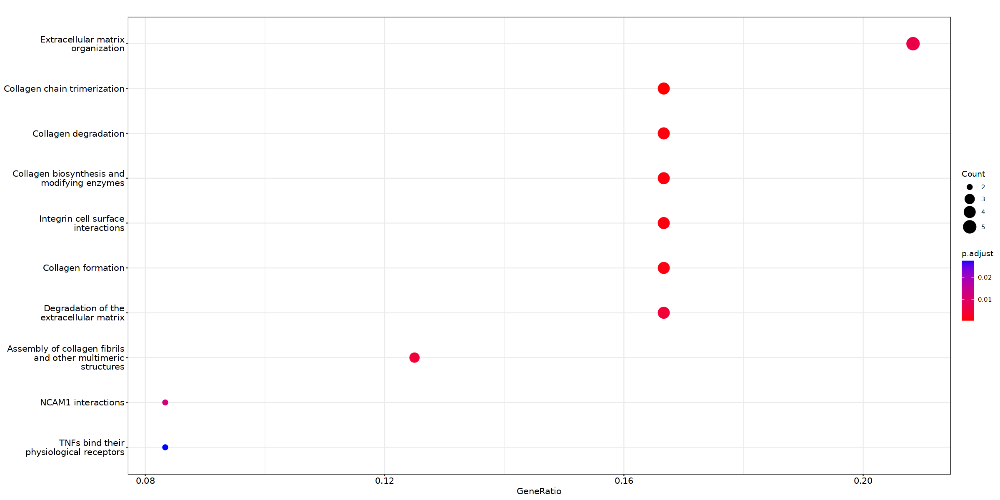

In [210]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [211]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

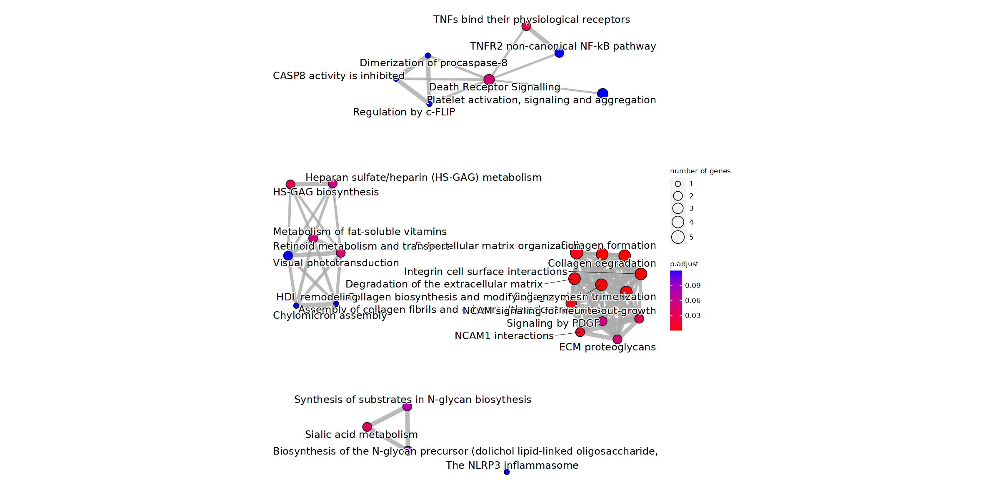

In [212]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

#### 3.2.2 MOL2

In [214]:
df_dynamics <- readRDS(paste0(OS_path_outputs, "Dynamics_DGA_RNA_MOL2.rds"))

##### 3.2.2.1 Category 1

In [215]:
gene_list <- c("Veph1","Clrn1","Slc27a6","Sall4","Rs1","Emc9","Ppp1r17","G0s2","Zik1","Galnt3","Gm27207","Gm17182","Tmem211","Slc22a4","Cables1","Btbd17","Gpat2","Mlc1","Angpt2","Il4","2310016G11Rik","Hist1h3d","Ociad2","1700026J12Rik","Gm14261","Hfm1","Gm15680","Tctex1d4","Pde5a","Fibin","Ano1","Bmpr1b","Sept3","Flrt2","Cyct","Car15","Fstl1","Ikzf3","Eva1b","2310043M15Rik","Them7","Gm29185","Dgkk","Msc","4930504O13Rik","RP24-295G1.1","Aqp6","Trim15","Npas1","Gm16933","Cgnl1","Col14a1","Ctsc","Ifitm3","Bex2","Anxa13","Slc39a12","Frem1","6330403K07Rik","Fam149a","Ckmt2","Col28a1","Avil","C030034L19Rik","Slc9a3","Gng10","Slc34a1","Foxl2os","Smpd4","Rabl2","0610040J01Rik","Gm28307","Inhba","Tll1","Trim61","Gm14228","Nox3","Gm2061","9230009I02Rik","Gm26870","5031414D18Rik","Gp5","Amer3","Gm11587","Gm13429","Cldn3","Tbx18","Wnt8a","Ssxb10","Serpinb2","Sept12","Gprc5c","Gpr126","Foxd2","Cldn26","Krt23","Cks1brt","4930438E09Rik","Fam167a","Gpr68","Gm16702","BC021891","4930478K11Rik","Dhrs2","Col5a2","4930557F10Rik","Bpifa2","Lama1","Gm10801","Krt222","Ccdc144b","Calcb","Lpar3","Gm29260","Cracr2a","Gm15942","1810020O05Rik","Arhgef16","Nkpd1","Irx3","Cryba4","Apoa4","Gm10860","Defb43","4922502D21Rik","Zdbf2","Gm28494","Fam129a","Gm20514","Neurog1","Prlr","Gm26614","Myh15","Fsbp","Islr","Gas2l3","Fam217b","Apoc1","Gm1673","Ifnlr1","Gm10113","Cilp2","Apoa5","Lhx1","1700129C05Rik","Gm11377","Colec10","Cela3b","C530025M09Rik","Pax1","Cd6","Pitpnm3","Prf1","Prickle3","Ppp1r14d","Tmigd1","Chrne","Ppm1n","Arx","RP23-349L18.1","Ebf2","Mesp1","Foxl2","Fam198a","Bmp4","F730016J06Rik","Foxd2os","Emid1","Ajap1","Cct8l1","4930554G24Rik","Odf3l2","4931403M11Rik","RP24-568B16.1","Slc34a2","Rasd2","Ehhadh","Sirpa","Syde2","Fam83b","Ptk2b","Gpr158")

In [216]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [217]:
length(gene_list)

[1] 153

In [218]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [219]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [220]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [221]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [222]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [223]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [224]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [225]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "241263" "66141" "65086" "208994" "230959" "67606" "85308" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...1 enriched terms found
'data.frame':	1 obs. of  9 variables:
 $ ID         : chr "R-MMU-391160"
 $ Description: chr "Signal regulatory protein family interactions"
 $ GeneRatio  : chr "2/23"
 $ BgRatio    : chr "10/8501"
 $ pvalue     : num 0.000311
 $ p.adjust   : num 0.0373
 $ qvalue     : num 0.0321
 $ geneID     : chr "Ptk2b/Sirpa"
 $ Count      : int 2
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


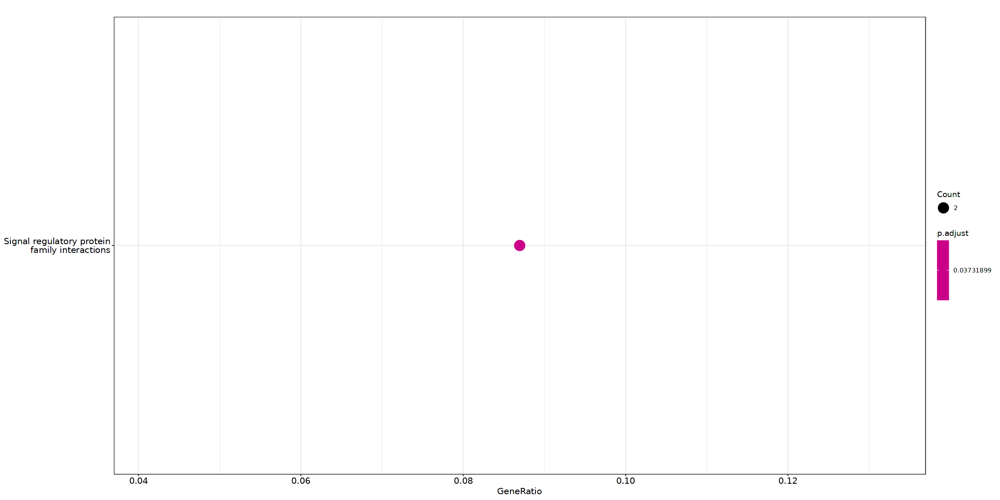

In [226]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [227]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

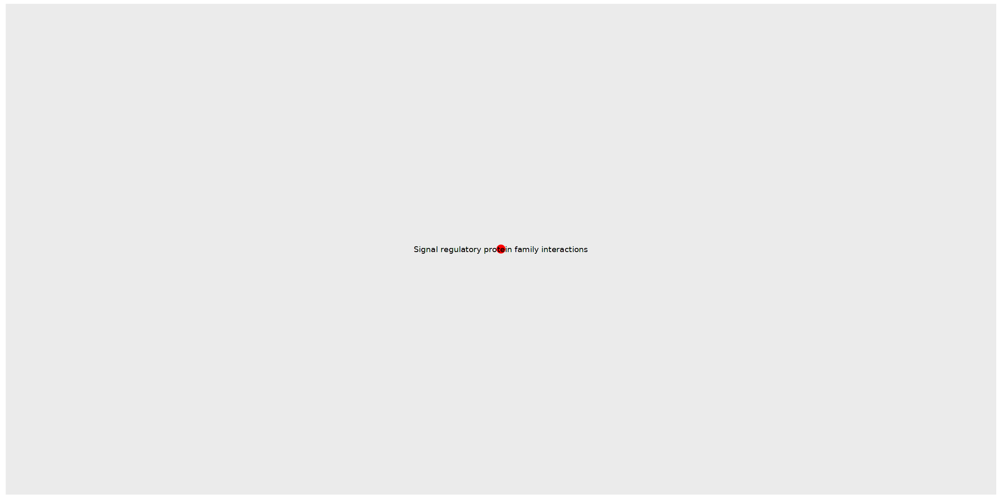

In [228]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [229]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [230]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "241263" "66141" "65086" "208994" "230959" "67606" "85308" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...120 enriched terms found
'data.frame':	120 obs. of  9 variables:
 $ ID         : chr  "R-MMU-391160" "R-MMU-418346" "R-MMU-9012999" "R-MMU-425407" ...
 $ Description: chr  "Signal regulatory protein family interactions" "Platelet homeostasis" "RHO GTPase cycle" "SLC-mediated transmembrane transport" ...
 $ GeneRatio  : chr  "2/23" "2/23" "4/23" "3/23" ...
 $ BgRatio    : chr  "10/8501" "72/8501" "392/8501" "218/8501" ...
 $ pvalue     : num  0.000311 0.015956 0.019652 0.020179 0.020865 ...
 $ p.adjust   : num  0.0373 0.1871 0.1871 0.1871 0.1871 ...
 $ qvalue     : num  0.0321 0.1609 0.1609 0.1609 0.1609 ...
 $ geneID     : chr  "Ptk2b/Sirpa" "Pde5a/Gng10" "Fam83b/Syde2/Pde5a/Ptk2b" "Slc27a6/Slc22a4/Slc9a3" ...
 $ Count      : int  2 2 4 3 2 2 1 1 2 

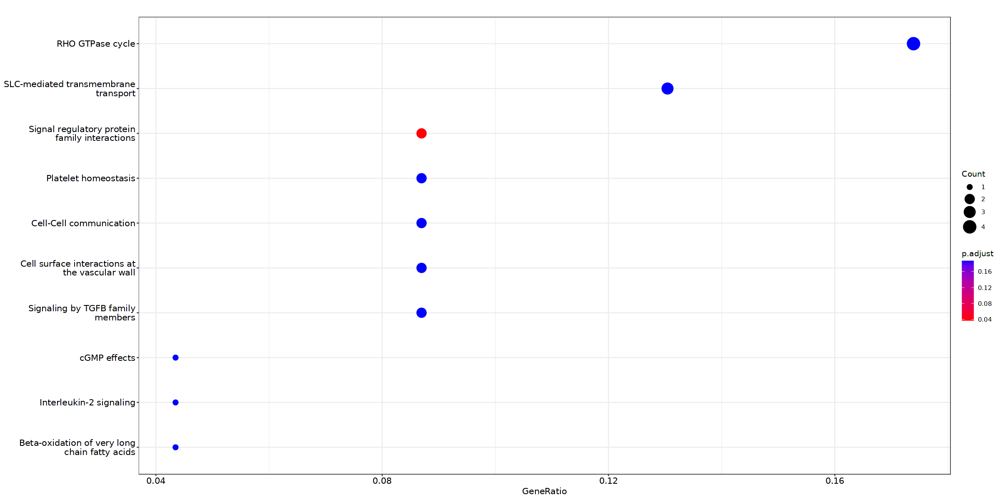

In [231]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [232]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

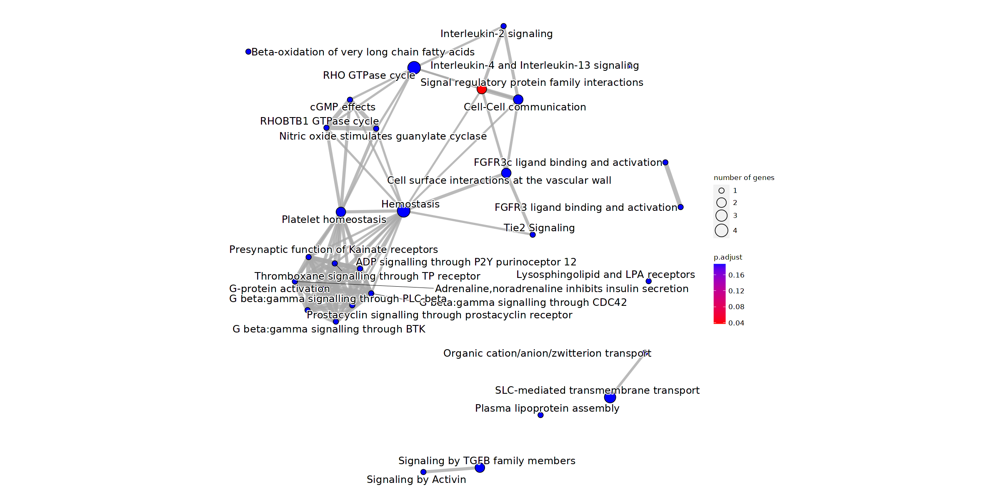

In [233]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.2 Category 2

In [234]:
gene_list <- c("P2ry6","B230312C02Rik","9530026P05Rik","Gm12526","Gm16153","Kctd12","Ofcc1","Sis","Cntd1","Fchsd2","Brinp1","Kcnk10","RP23-377G8.1","Lyg1","Synpr","Ldha","Kit","Cacng5","Galnt15","Cers6","Nrcam","4933406I18Rik","Ptpn5","Folr2","Fam196a","Pde3b","Gm281","Gm26778","1700011E24Rik","Gm15668","Sphk1","Tubb6","Sv2c","Nab2","Tmem88","Jsrp1","Lrrc25","Gm26658","Ccno","Ido2","Rnf125","Ric3","Rgs20","Irf1","Syt4","Chl1","Ier5l","Slfn9","Col7a1","Gsap","Amotl1","Gm26511","Slc9a3r2","Mvp","Trim25","Gm16223","Scg3","Becn1","Gm20497","Cntn1","Map1s","2310014L17Rik","Igf2bp2","Kcnj3","4632428C04Rik","Lrtm2","Vmp1","Kank1","Elf4","Rnf213","Tnfrsf1a","9530036O11Rik","Lsp1","St8sia4","Cacna1h","Prkg2","Layn","4930555F03Rik","Sdc3","H2-T24","Gm5108","Mpeg1","Gjc1","Clvs1","Iglon5","Gm26894","Ccdc79","Slc15a5","Hoxc13","1700025O08Rik","Plekhs1","Clrn3","E030018B13Rik","Gad2","Agbl1","Spata16","Gys2","Gm28578","Cubn")

In [235]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [236]:
length(gene_list)

[1] 90

In [237]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [238]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [239]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [240]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [241]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [242]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [244]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:47] "58175" "16362" "672511" "319504" "78388" "72003" "67664" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [248]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [249]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:47] "58175" "16362" "672511" "319504" "78388" "72003" "67664" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...148 enriched terms found
'data.frame':	148 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1660661" "R-MMU-9006934" "R-MMU-428157" "R-MMU-390471" ...
 $ Description: chr  "Sphingolipid de novo biosynthesis" "Signaling by Receptor Tyrosine Kinases" "Sphingolipid metabolism" "Association of TriC/CCT with target proteins during biosynthesis" ...
 $ GeneRatio  : chr  "2/19" "4/19" "2/19" "1/19" ...
 $ BgRatio    : chr  "37/8501" "395/8501" "75/8501" "10/8501" ...
 $ pvalue     : num  0.00301 0.01021 0.01192 0.02214 0.02433 ...
 $ p.adjust   : num  0.24 0.24 0.24 0.24 0.24 ...
 $ qvalue     : num  0.22 0.22 0.22 0.22 0.22 ...
 $ geneID     : chr  "Sphk1/Cers6" "Kit/Pde3b/Sphk1/Nab2" "Sphk1/Cers6" "Sphk1" ...
 $ Count      : int  2 4 2 1 1 1 1 1 2 2 ...


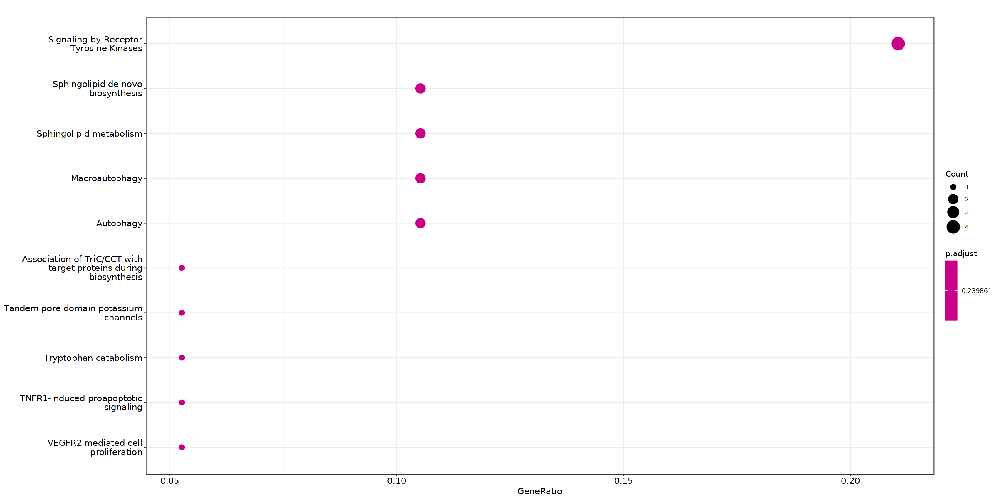

In [250]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [251]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

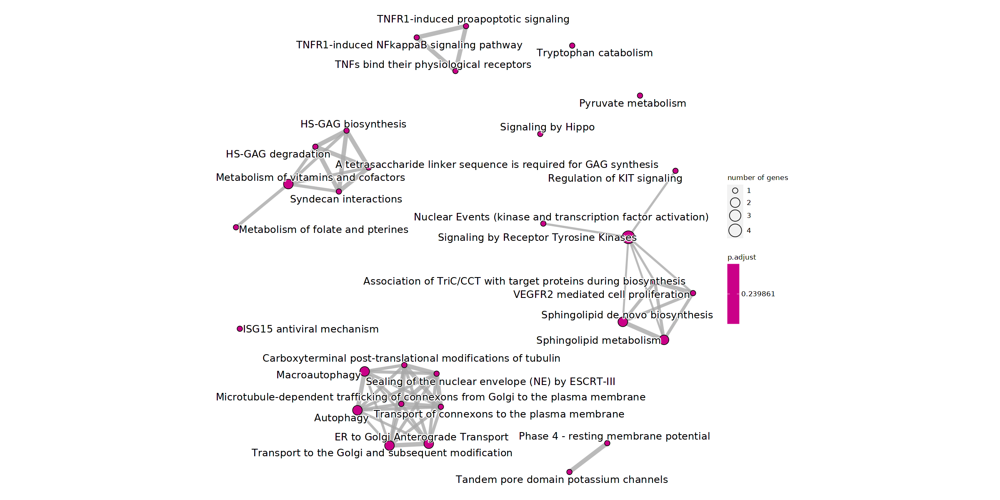

In [252]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.3 Category 3

In [253]:
gene_list <- c("Slc13a1","Chst9","Fras1","Sntb1","Sh2d4b","BC016548","Maf","Gm28417","Gm9934","Gjb2","Cd300lf","Aass","Nebl","Uchl1","Ceacam2","Basp1","Tox","Grm4","Pqlc3","Fam135b","Ror1","Rgs16","Zfp385b","Gm14095","1700030L20Rik","Lrrn2","Mkx","Tiam2","Lmo7","Greb1l","Eid2","P2ry14","Lrrc14b","Lhfp","2410080I02Rik","Khdrbs3","Zfp423","Isg20","Rnase1","Gm10964","E130006D01Rik","Gm28100","Zbtb8b","5330429C05Rik","Gm12898","Isg15","C130050O18Rik","Lrrc2","Gria1","Art5","Gm11548","Pik3r5","Alpk1","Gbp5","Irx2","Gbp2","Igtp","Psmb8","Parp14","Fabp1","Serpina3f","Pde3a","Pou4f1","Usp18","Clca1","Gpr133","Irf8","Trim21","Gm12216","Ifit1","Hspb1","Cmpk2","Tspan4","Ifit3","Ndrg2","Patl2","1700007J10Rik","Gbp7","Psmb9","Irgm1","Tesc","Tap1","Irgm2","H2-Q4","B530045E10Rik","Herc6","Irf9","Zc3hav1","Gm26760","Gm16046","Cacna1e","Sfxn1","H2-D1","B2m","Il18bp","Gbp8","Zbp1","Tgtp2","Tgm2","Trim34a","Oas1a","E230001N04Rik","Gm12185","Apol9b","4732465J04Rik","Mgst2","Pcsk1","Chac1","Gm28694","Ifi47","4930518I15Rik","I830012O16Rik","4921508D12Rik","Trim30a","Gm15821","Serping1","Zbbx","Ly6e","Slco5a1","Apobec1","Tdrd12","Rin3","Ccdc141","9330175E14Rik","Iigp1","Gbp9","Gjb5","Atf7ip2","Gm14216","Dlk1","Gm7976","A330094K24Rik","Angpt4","2310081O03Rik","H2-Q6","Trpc4","A4galt","Gm5468","Bpifa3","Serpina12","Gm11690","Cdsn","Htr3a","Kcnv2","Ptgs2os","A230065N10Rik","Gm26776","Ubd","Pla2g4f","Gm20109","Htr5a","Plin4","Gbp4","2610035F20Rik","Igsf21","Vwc2l","Trim5","Mdfic","RP23-333I7.1","Sh2b2","Gm19684","Gm7030","Etnppl","Tmem232","Ifi27l2a","Lppr5","Mx1","Ly6a","Tgtp1","Serpina3i","Cyb561","Ms4a4d","RP23-387L22.3","Gm16019","1700025C18Rik","Sphkap","Gm8369","Ms4a6b","Apol9a","Arhgdib","Olfr56","S100a4","Pdzrn4","Barx2","Crtam","Rgs7","Gm830","4930568A12Rik","Gm12505","Gm13446","H2-Q7","S100a3","E330017L17Rik","Dhrs3","Gata6","Mtl5","3100002H09Rik","Gm6169","Gm13844","Lrrc37a","Tigit","Gpr165","Hspb7","Gm29507","1200007C13Rik","Crmp1","Ccdc3","Hspb8","Arhgap44","Gm28068","Slc25a24","Cd200r2","Gm12299","Gm29458","Gm14249","1700096J18Rik","4921507L20Rik","Gja5","Ren1","Ikzf1","Eva1a","Slc24a4","Gm16758","RP23-187M7.3","Card11","Hist1h2af","Tcl1","BC067074","Zp3r","Slc6a7","Gulp1","Amigo2","Spata31d1d")

In [254]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [255]:
length(gene_list)

[1] 212

In [256]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [257]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [258]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [259]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [260]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [261]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [262]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [263]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:50] "60440" "12010" "14964" "16145" "15944" "16913" "14469" "15959" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...96 enriched terms found
'data.frame':	96 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-983169" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Class I MHC mediated antigen processing & presentation" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "6/18" "8/18" "4/18" "4/18" ...
 $ BgRatio    : chr  "92/8501" "343/8501" "34/8501" "41/8501" ...
 $ pvalue     : num  2.28e-08 1.99e-07 6.27e-07 1.36e-06 1.78e-05 ...
 $ p.adjust   : num  3.83e-06 1.67e-05 3.51e-05 5.70e-05 5.98e-04 ...
 $ qvalue     : num  1.46e-06 6.39e-06 1.34e-05 2.18e-05 2.29e-04 ...
 $ geneID     : chr  "B2m/Psmb8/Tap1/Psmb9/H2-Q4/H

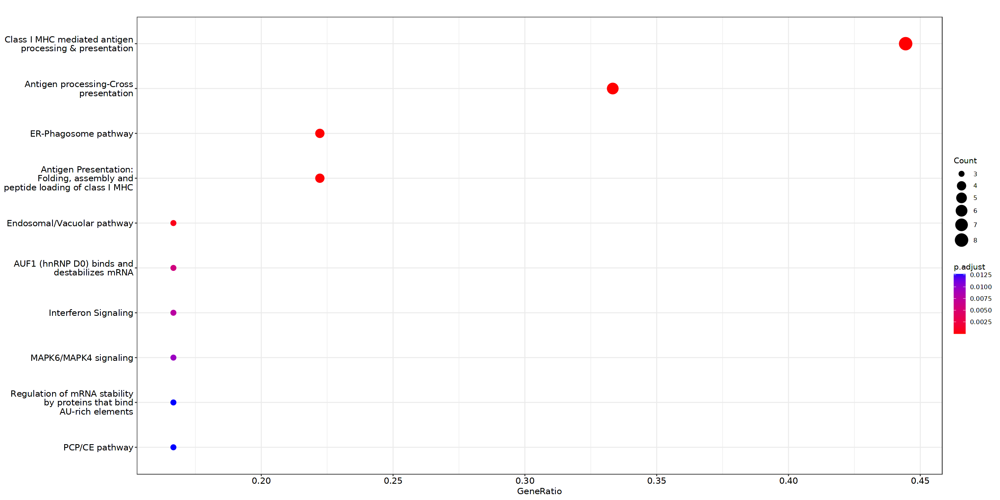

In [264]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [265]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


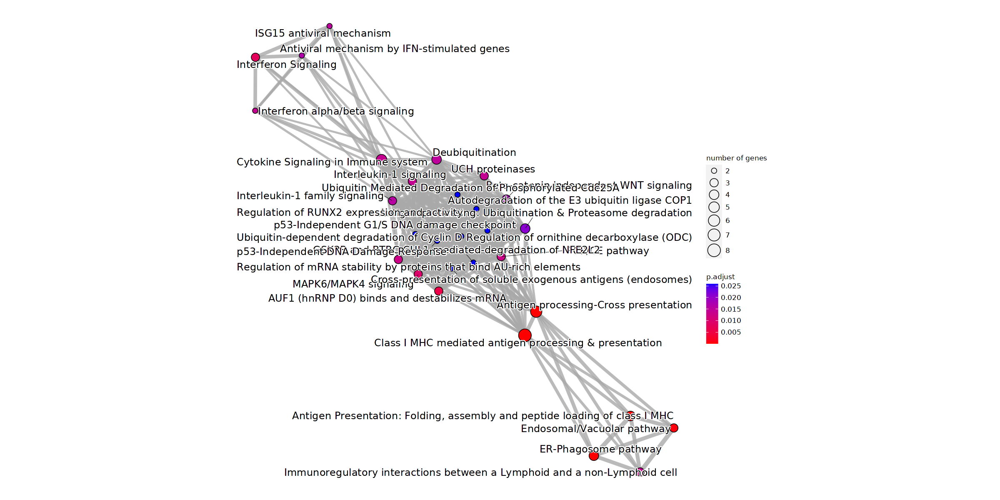

In [266]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [267]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [268]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:50] "60440" "12010" "14964" "16145" "15944" "16913" "14469" "15959" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...168 enriched terms found
'data.frame':	168 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-983169" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Class I MHC mediated antigen processing & presentation" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "6/18" "8/18" "4/18" "4/18" ...
 $ BgRatio    : chr  "92/8501" "343/8501" "34/8501" "41/8501" ...
 $ pvalue     : num  2.28e-08 1.99e-07 6.27e-07 1.36e-06 1.78e-05 ...
 $ p.adjust   : num  3.83e-06 1.67e-05 3.51e-05 5.70e-05 5.98e-04 ...
 $ qvalue     : num  1.46e-06 6.39e-06 1.34e-05 2.18e-05 2.29e-04 ...
 $ geneID     : chr  "B2m/Psmb8/Tap1/Psmb9/H2-Q4/H2

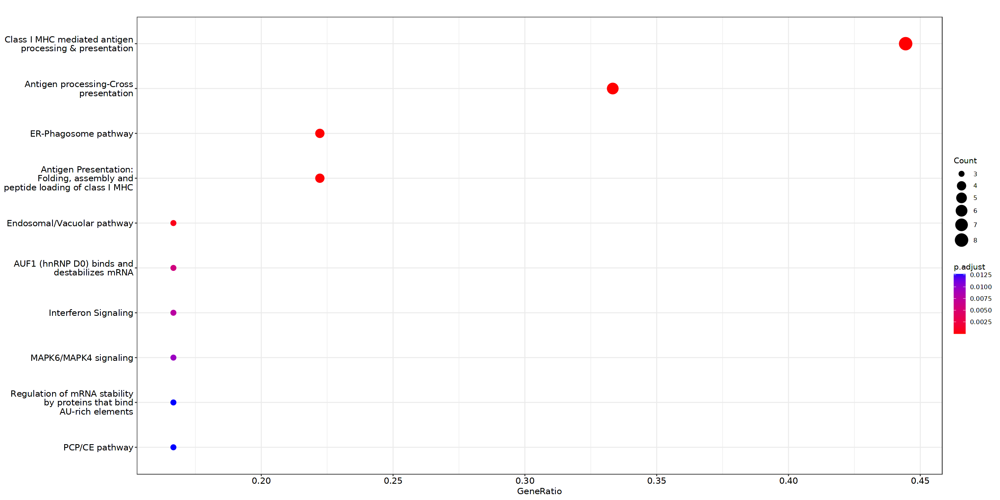

In [269]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [270]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 17 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


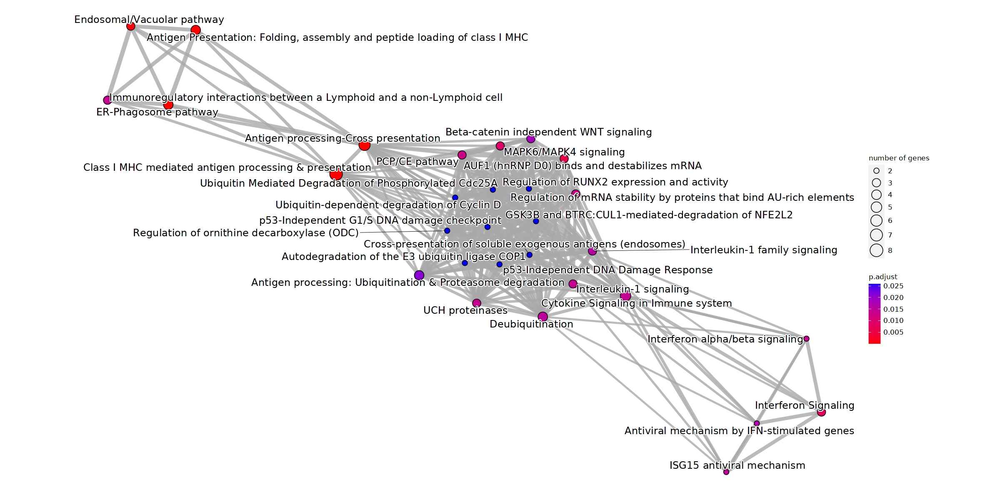

In [271]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.4 Category 4

In [272]:
gene_list <- c("Tgfb2","Efhd2","Suclg2","Gpr137b","Cdhr2","Smim5","Prox2","Slc44a2","Tiam1","Filip1","Spint2","Acsf3","Epha10","Slc9b2","A330008L17Rik","Mef2c","Gm11042","Mmp15","Adamtsl2","Frzb","Kif26b","6330409D20Rik","Plg","Crip1","Tubb2b","Lix1","Zfp57","A930006I01Rik","Mroh5","Ddah1","Cd80","Syt13","Tnfrsf1b","Fzd10","Chst5","Lbp","Fam180a","Tmem8c","Gm9047","Rph3al","Lst1","Mocos","Sh3d21","Tmem176a","Tmem176b","Gm13889","Gm11731","Gucy1a3","B130046B21Rik","Gjb4","Runx3","3110079O15Rik","RP23-226J18.4","RP24-72B22.1","Hmx1","Fam92b","D430041D05Rik","Itgb2","Fxyd5","C230024C17Rik","Cftr","Lgals3","Sh3bgr","E130018N17Rik","Bmp7","5930412G12Rik","Gdf6","Cpz","Lmx1a","Esyt3","Col1a2","RP23-333L19.2","Fam65b","AI427809","Dmbt1","4930412L05Rik","Cldn23","Irf4","Bmper","Drp2","Itpripl2","Ebf3","6030407O03Rik","Bik","Col6a2","Pkia","Apoe","N4bp2l1","Piezo2","Fxyd1","Fxyd7","Gm11750","Chrna5","Lrrn4","Lama5","Ly6g6c","Eln","Flrt1","Arhgef6","Edar","Bpi","D10Bwg1379e","Irx3os","Gm5860","Mrgprd","Sp8","Gm6569","Chit1","Lyzl4","Gm29183","Prss33","Capn8","Lonrf2","Myzap","Col13a1","A830019P07Rik","Megf6")

In [273]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [274]:
length(gene_list)

[1] 105

In [275]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [276]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [277]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [278]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [279]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [280]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [281]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [282]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "11816" "73710" "667742" "56188" "57780" "16854" "12925" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...7 enriched terms found
'data.frame':	7 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1442490" "R-MMU-8948216" "R-MMU-1474228" "R-MMU-1650814" ...
 $ Description: chr  "Collagen degradation" "Collagen chain trimerization" "Degradation of the extracellular matrix" "Collagen biosynthesis and modifying enzymes" ...
 $ GeneRatio  : chr  "4/22" "3/22" "4/22" "3/22" ...
 $ BgRatio    : chr  "55/8501" "35/8501" "107/8501" "60/8501" ...
 $ pvalue     : num  1.05e-05 9.33e-05 1.46e-04 4.68e-04 6.19e-04 ...
 $ p.adjust   : num  0.00139 0.00616 0.00641 0.01544 0.01635 ...
 $ qvalue     : num  0.00101 0.00447 0.00465 0.01121 0.01187 ...
 $ geneID     : chr  "Col1a2/Col13a1/Mmp15/Col6a2" "Col1a2/Col13a1/Col6a2" "Col1a2/Col13a1/Mmp15/Col6a2" "Col1a2/Col13a1/C

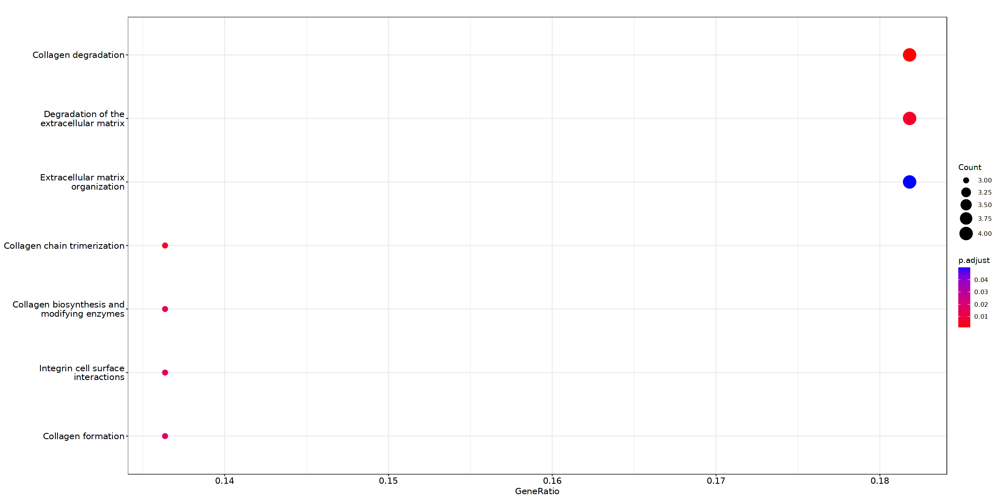

In [283]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [284]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

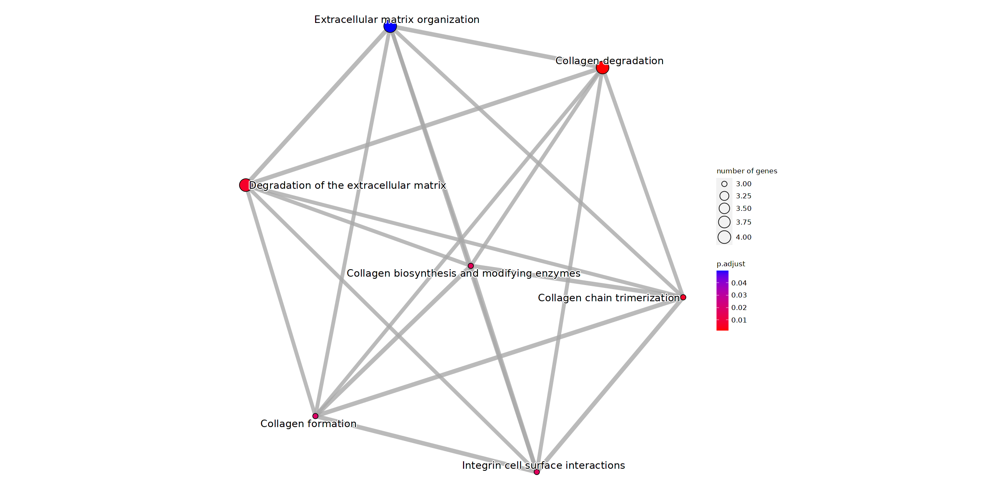

In [285]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [286]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [287]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "11816" "73710" "667742" "56188" "57780" "16854" "12925" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...132 enriched terms found
'data.frame':	132 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1442490" "R-MMU-8948216" "R-MMU-1474228" "R-MMU-1650814" ...
 $ Description: chr  "Collagen degradation" "Collagen chain trimerization" "Degradation of the extracellular matrix" "Collagen biosynthesis and modifying enzymes" ...
 $ GeneRatio  : chr  "4/22" "3/22" "4/22" "3/22" ...
 $ BgRatio    : chr  "55/8501" "35/8501" "107/8501" "60/8501" ...
 $ pvalue     : num  1.05e-05 9.33e-05 1.46e-04 4.68e-04 6.19e-04 ...
 $ p.adjust   : num  0.00139 0.00616 0.00641 0.01544 0.01635 ...
 $ qvalue     : num  0.00101 0.00447 0.00465 0.01121 0.01187 ...
 $ geneID     : chr  "Col1a2/Col13a1/Mmp15/Col6a2" "Col1a2/Col13a1/Col6a2" "Col1a2/Col13a1/Mmp15/Col6a2" "Col1a2/Col13a1/

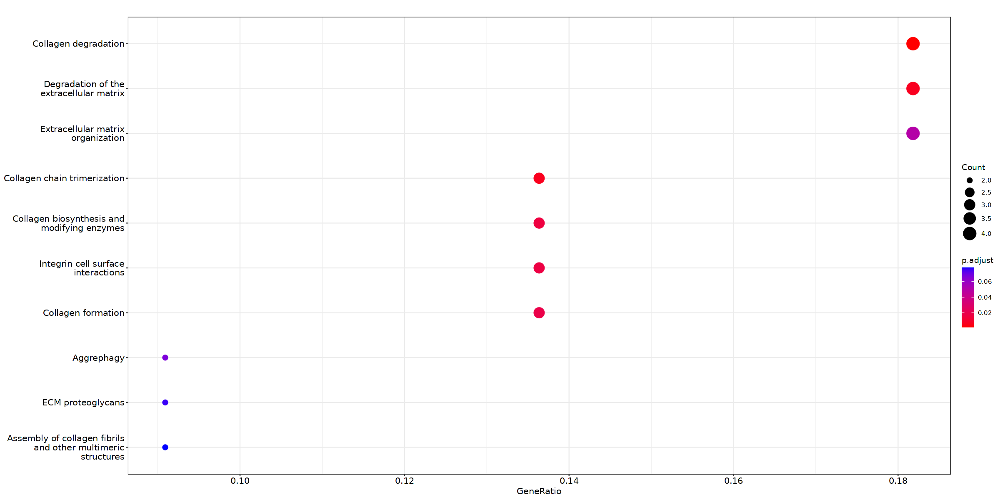

In [288]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [289]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


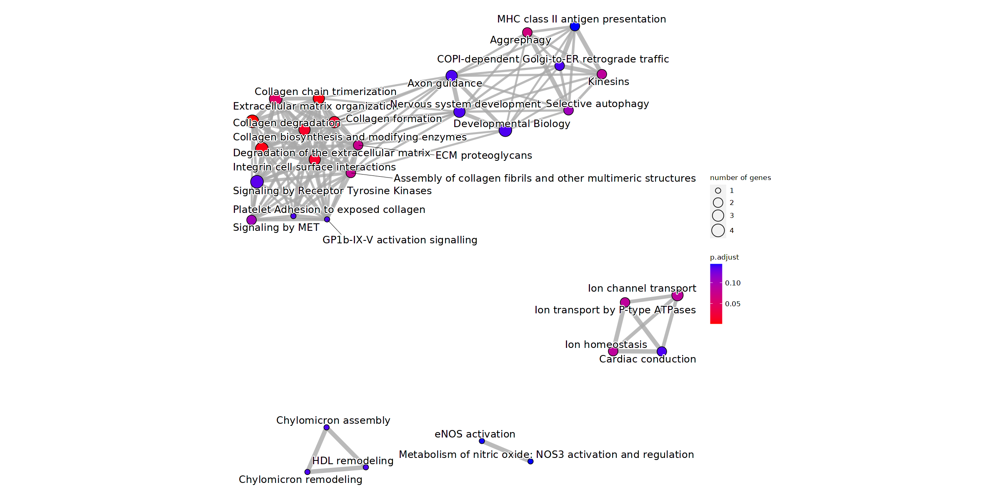

In [290]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.5 Sub category 1

In [291]:
gene_list <- c("Veph1","Clrn1","Slc27a6","Sall4","Rs1","Emc9","Ppp1r17","G0s2","Zik1","Galnt3","Gm27207","Gm17182","Tmem211","Slc22a4","Cables1","Btbd17","Gpat2","Mlc1","Angpt2","Il4","2310016G11Rik","Hist1h3d","Ociad2","1700026J12Rik","Gm14261","Hfm1","Gm15680","Tctex1d4","Pde5a","Fibin","Ano1","Bmpr1b","Sept3")

In [292]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [293]:
length(gene_list)

[1] 30

In [294]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [295]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [296]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [297]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [298]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [299]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [300]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [301]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:26] "67606" "85308" "14373" "242202" "16189" "11601" "22775" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [307]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [308]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:26] "67606" "85308" "14373" "242202" "16189" "11601" "22775" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...44 enriched terms found
'data.frame':	44 obs. of  9 variables:
 $ ID         : chr  "R-MMU-418457" "R-MMU-190239" "R-MMU-190372" "R-MMU-549132" ...
 $ Description: chr  "cGMP effects" "FGFR3 ligand binding and activation" "FGFR3c ligand binding and activation" "Organic cation/anion/zwitterion transport" ...
 $ GeneRatio  : chr  "1/12" "1/12" "1/12" "1/12" ...
 $ BgRatio    : chr  "10/8501" "12/8501" "12/8501" "12/8501" ...
 $ pvalue     : num  0.014 0.0168 0.0168 0.0168 0.0168 ...
 $ p.adjust   : num  0.114 0.114 0.114 0.114 0.114 ...
 $ qvalue     : num  0.0821 0.0821 0.0821 0.0821 0.0821 ...
 $ geneID     : chr  "Pde5a" "Galnt3" "Galnt3" "Slc22a4" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA:

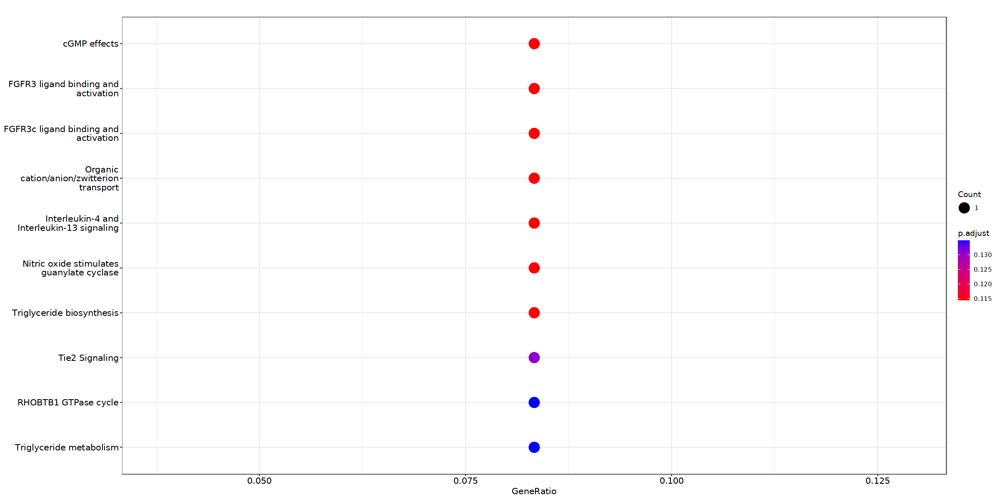

In [309]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [310]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

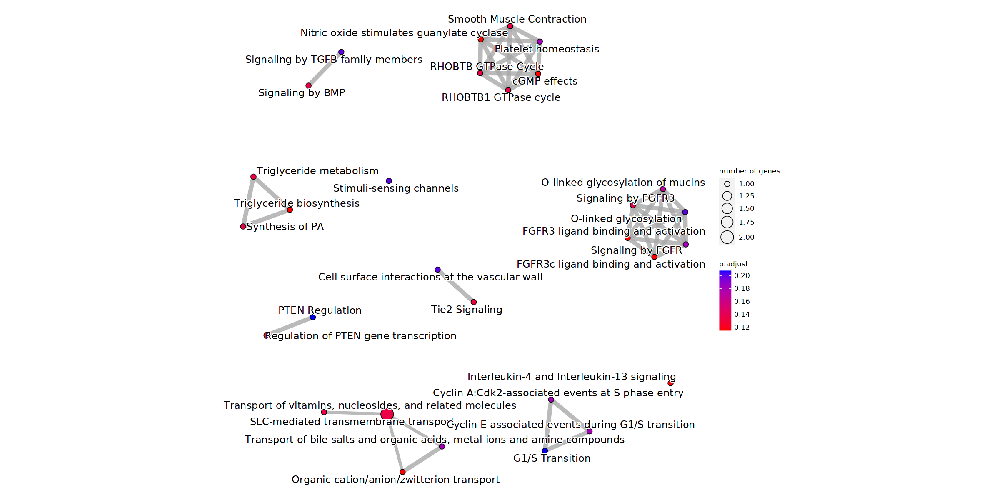

In [311]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.6 Sub category 2

In [312]:
gene_list <- c("Flrt2","Cyct","Car15","Fstl1","Ikzf3","Eva1b","2310043M15Rik","Them7","Gm29185","Dgkk","Msc","4930504O13Rik","RP24-295G1.1","Aqp6","Trim15","Npas1","Gm16933","Cgnl1","Col14a1","Ctsc","Ifitm3","Bex2","Anxa13","Slc39a12","Frem1")

In [313]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [314]:
length(gene_list)

[1] 22

In [315]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [316]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [317]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [318]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [319]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [320]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [321]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [322]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:20] "66141" "12069" "13032" "277468" "102633000" "12818" "68178" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [326]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [327]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:20] "66141" "12069" "13032" "277468" "102633000" "12818" "68178" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...20 enriched terms found
'data.frame':	20 obs. of  9 variables:
 $ ID         : chr  "R-MMU-201451" "R-MMU-5654687" "R-MMU-5694530" "R-MMU-8948216" ...
 $ Description: chr  "Signaling by BMP" "Downstream signaling of activated FGFR1" "Cargo concentration in the ER" "Collagen chain trimerization" ...
 $ GeneRatio  : chr  "1/5" "1/5" "1/5" "1/5" ...
 $ BgRatio    : chr  "27/8501" "29/8501" "32/8501" "35/8501" ...
 $ pvalue     : num  0.0158 0.0169 0.0187 0.0204 0.0262 ...
 $ p.adjust   : num  0.0844 0.0844 0.0844 0.0844 0.0844 ...
 $ qvalue     : num  0.0444 0.0444 0.0444 0.0444 0.0444 ...
 $ geneID     : chr  "Fstl1" "Flrt2" "Ctsc" "Col14a1" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/

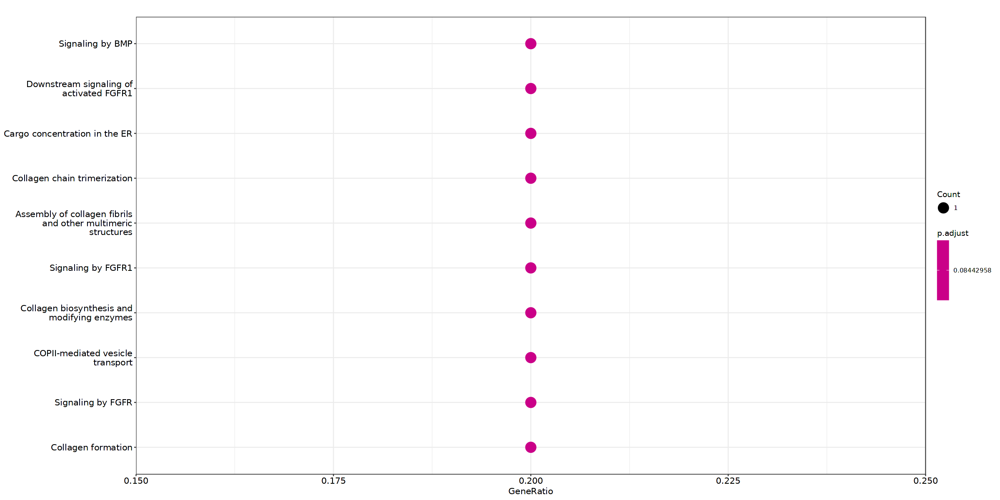

In [328]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [329]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

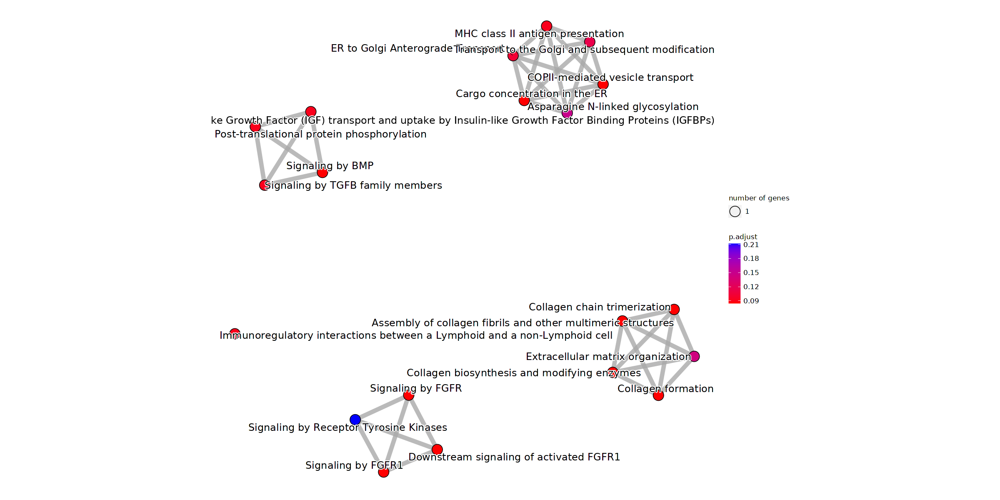

In [330]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.7 Sub category 3

In [331]:
gene_list <- c("6330403K07Rik","Fam149a","Ckmt2","Col28a1","Avil","C030034L19Rik","Slc9a3","Gng10","Slc34a1","Foxl2os","Smpd4","Rabl2","0610040J01Rik","Gm28307","Inhba","Tll1","Trim61","Gm14228","Nox3","Gm2061","9230009I02Rik","Gm26870","5031414D18Rik","Gp5","Amer3","Gm11587","Gm13429","Cldn3","Tbx18","Wnt8a","Ssxb10","Serpinb2","Sept12","Gprc5c","Gpr126","Foxd2","Cldn26","Krt23","Cks1brt","4930438E09Rik","Fam167a","Gpr68","Gm16702","BC021891","4930478K11Rik","Dhrs2","Col5a2","4930557F10Rik","Bpifa2","Lama1","Gm10801","Krt222","Ccdc144b","Calcb","Lpar3","Gm29260","Cracr2a","Gm15942","1810020O05Rik","Arhgef16","Nkpd1","Irx3","Cryba4","Apoa4","Gm10860","Defb43","4922502D21Rik","Zdbf2","Gm28494","Fam129a","Gm20514","Neurog1","Prlr","Gm26614","Myh15")

In [332]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [333]:
length(gene_list)

[1] 60

In [334]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [335]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [336]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [337]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [338]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [339]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [340]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [341]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:40] "65086" "14700" "77626" "68708" "103712" "320088" "212326" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [344]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [345]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:40] "65086" "14700" "77626" "68708" "103712" "320088" "212326" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...101 enriched terms found
'data.frame':	101 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8948216" "R-MMU-416476" "R-MMU-1650814" "R-MMU-416482" ...
 $ Description: chr  "Collagen chain trimerization" "G alpha (q) signalling events" "Collagen biosynthesis and modifying enzymes" "G alpha (12/13) signalling events" ...
 $ GeneRatio  : chr  "2/15" "3/15" "2/15" "2/15" ...
 $ BgRatio    : chr  "35/8501" "198/8501" "60/8501" "70/8501" ...
 $ pvalue     : num  0.00167 0.0046 0.00485 0.00655 0.0071 ...
 $ p.adjust   : num  0.133 0.133 0.133 0.133 0.133 ...
 $ qvalue     : num  0.0987 0.0987 0.0987 0.0987 0.0987 ...
 $ geneID     : chr  "Col5a2/Col28a1" "Lpar3/Gng10/Gpr68" "Col5a2/Col28a1" "Gng10/Arhgef16" ...
 $ Count      : int  2 3 2 2 2 1 1 1 1 1 ...

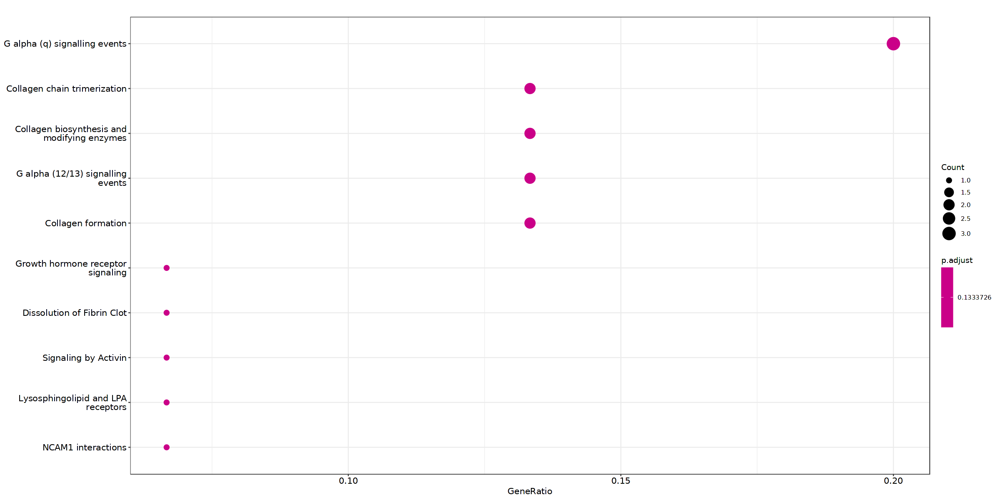

In [346]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [347]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 15 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


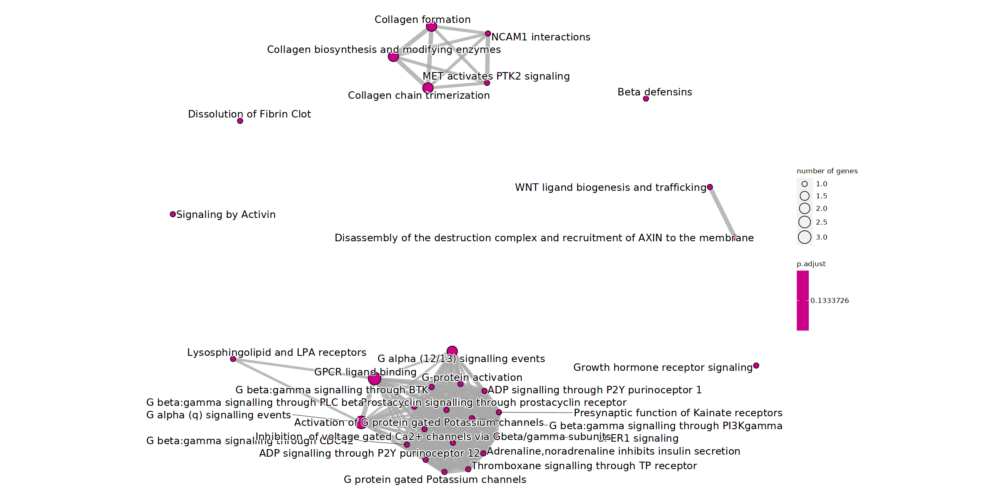

In [348]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.8 Sub category 4

In [349]:
gene_list <- c("Fsbp","Islr","Gas2l3","Fam217b","Apoc1","Gm1673","Ifnlr1","Gm10113","Cilp2","Apoa5","Lhx1","1700129C05Rik","Gm11377","Colec10","Cela3b","C530025M09Rik","Pax1","Cd6","Pitpnm3","Prf1","Prickle3","Ppp1r14d","Tmigd1","Chrne","Ppm1n","Arx","RP23-349L18.1","Ebf2","Mesp1","Foxl2","Fam198a","Bmp4","F730016J06Rik","Foxd2os","Emid1","Ajap1","Cct8l1","4930554G24Rik","Odf3l2","4931403M11Rik","RP24-568B16.1","Slc34a2","Rasd2","Ehhadh","Sirpa","Syde2","Fam83b","Ptk2b","Gpr158")

In [350]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [351]:
length(gene_list)

[1] 41

In [352]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [353]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [354]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [355]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [356]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [357]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [358]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [359]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:37] "241263" "208994" "230959" "214804" "74147" "54630" "19229" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...1 enriched terms found
'data.frame':	1 obs. of  9 variables:
 $ ID         : chr "R-MMU-391160"
 $ Description: chr "Signal regulatory protein family interactions"
 $ GeneRatio  : chr "2/14"
 $ BgRatio    : chr "10/8501"
 $ pvalue     : num 0.000112
 $ p.adjust   : num 0.00574
 $ qvalue     : num 0.00379
 $ geneID     : chr "Ptk2b/Sirpa"
 $ Count      : int 2
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


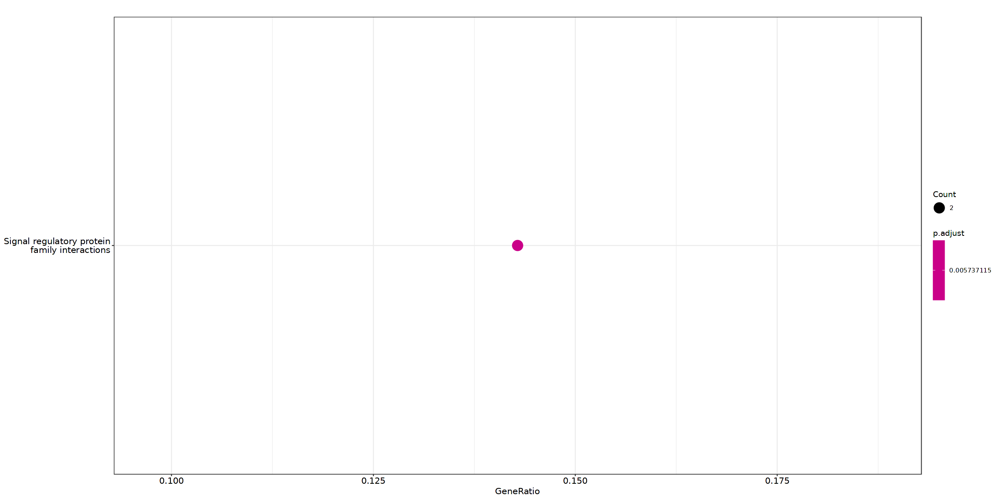

In [360]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [361]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

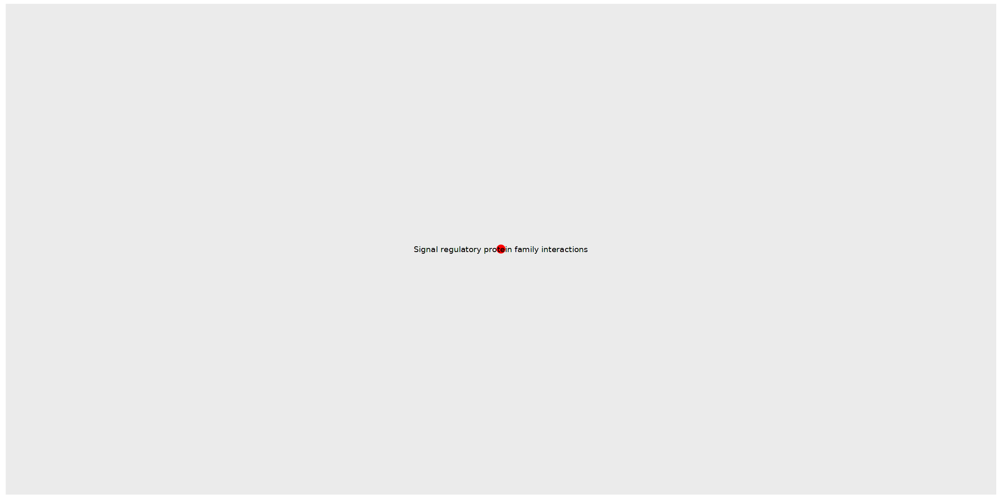

In [362]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [363]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [364]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:37] "241263" "208994" "230959" "214804" "74147" "54630" "19229" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...51 enriched terms found
'data.frame':	51 obs. of  9 variables:
 $ ID         : chr  "R-MMU-391160" "R-MMU-174824" "R-MMU-1500931" "R-MMU-8957275" ...
 $ Description: chr  "Signal regulatory protein family interactions" "Plasma lipoprotein assembly, remodeling, and clearance" "Cell-Cell communication" "Post-translational protein phosphorylation" ...
 $ GeneRatio  : chr  "2/14" "2/14" "2/14" "2/14" ...
 $ BgRatio    : chr  "10/8501" "64/8501" "83/8501" "114/8501" ...
 $ pvalue     : num  0.000112 0.00479 0.007943 0.014602 0.016096 ...
 $ p.adjust   : num  0.00574 0.08829 0.08829 0.08829 0.08829 ...
 $ qvalue     : num  0.00379 0.05831 0.05831 0.05831 0.05831 ...
 $ geneID     : chr  "Ptk2b/Sirpa" "Apoc1/Apoa5" "Ptk2b/Sirpa" "Bmp4/Apoa5" ...
 $ Count 

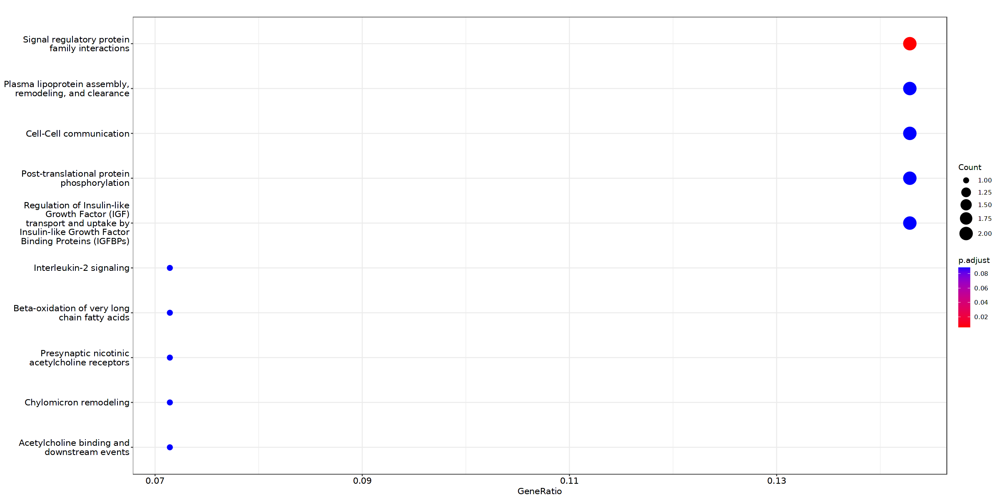

In [365]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [366]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

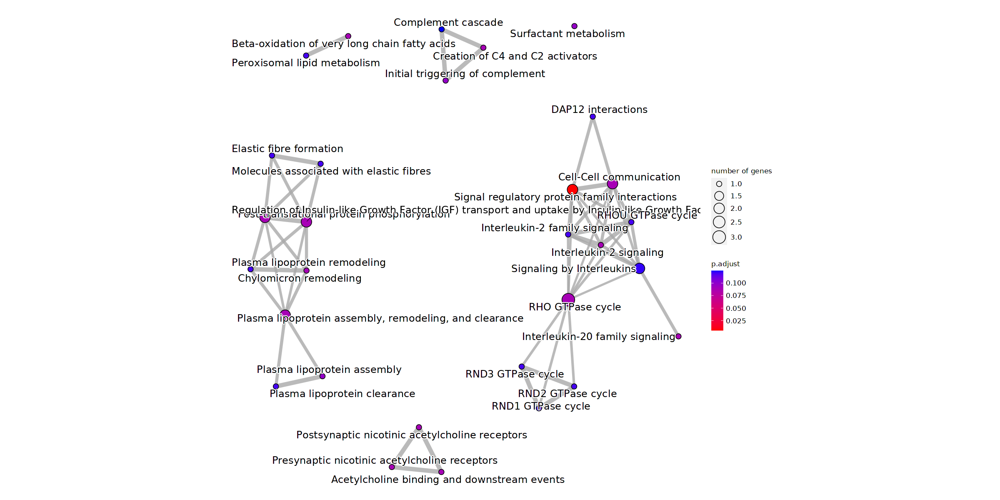

In [367]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.9 Sub category 5

In [368]:
gene_list <- c("P2ry6","B230312C02Rik","9530026P05Rik","Gm12526","Gm16153","Kctd12","Ofcc1","Sis","Cntd1","Fchsd2","Brinp1","Kcnk10","RP23-377G8.1","Lyg1","Synpr","Ldha","Kit","Cacng5","Galnt15","Cers6","Nrcam","4933406I18Rik","Ptpn5","Folr2","Fam196a","Pde3b","Gm281","Gm26778","1700011E24Rik","Gm15668","Sphk1","Tubb6","Sv2c","Nab2","Tmem88","Jsrp1","Lrrc25","Gm26658","Ccno","Ido2","Rnf125","Ric3","Rgs20","Irf1","Syt4","Chl1","Ier5l","Slfn9","Col7a1","Gsap","Amotl1","Gm26511","Slc9a3r2","Mvp","Trim25","Gm16223","Scg3","Becn1","Gm20497","Cntn1","Map1s","2310014L17Rik","Igf2bp2","Kcnj3","4632428C04Rik","Lrtm2","Vmp1","Kank1","Elf4","Rnf213","Tnfrsf1a","9530036O11Rik")

In [369]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [370]:
length(gene_list)

[1] 65

In [371]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [372]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [373]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [374]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [375]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [376]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [377]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [378]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:46] "58175" "16362" "672511" "319504" "78388" "72003" "67664" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [379]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [380]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:46] "58175" "16362" "672511" "319504" "78388" "72003" "67664" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...139 enriched terms found
'data.frame':	139 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1660661" "R-MMU-9006934" "R-MMU-428157" "R-MMU-390471" ...
 $ Description: chr  "Sphingolipid de novo biosynthesis" "Signaling by Receptor Tyrosine Kinases" "Sphingolipid metabolism" "Association of TriC/CCT with target proteins during biosynthesis" ...
 $ GeneRatio  : chr  "2/19" "4/19" "2/19" "1/19" ...
 $ BgRatio    : chr  "37/8501" "395/8501" "75/8501" "10/8501" ...
 $ pvalue     : num  0.00301 0.01021 0.01192 0.02214 0.02433 ...
 $ p.adjust   : num  0.263 0.263 0.263 0.263 0.263 ...
 $ qvalue     : num  0.239 0.239 0.239 0.239 0.239 ...
 $ geneID     : chr  "Sphk1/Cers6" "Kit/Pde3b/Sphk1/Nab2" "Sphk1/Cers6" "Sphk1" ...
 $ Count      : int  2 4 2 1 1 1 1 

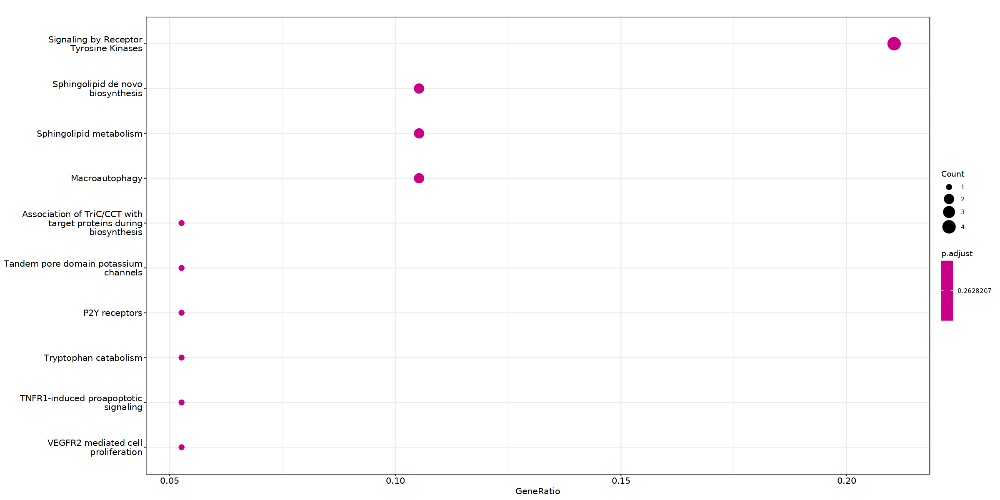

In [381]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [382]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

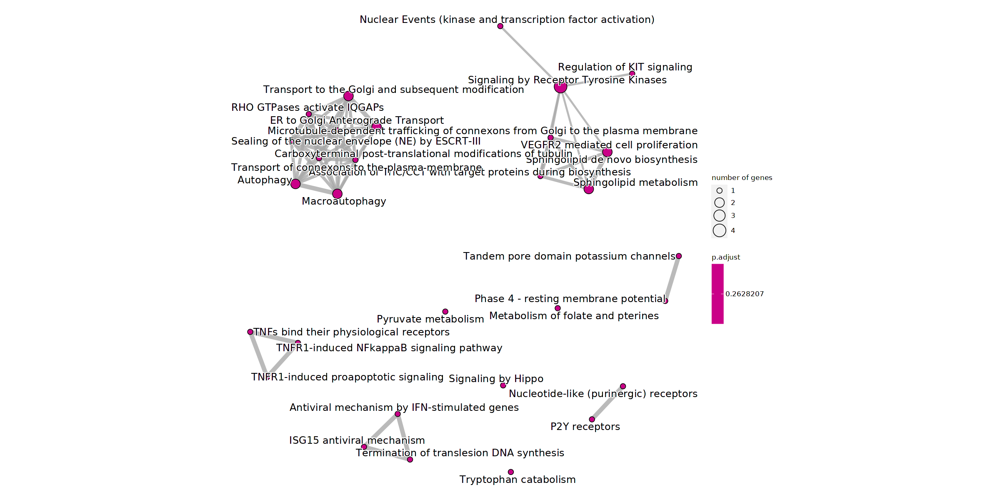

In [383]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.10 Sub category 6

In [384]:
gene_list <- c("Lsp1","St8sia4","Cacna1h","Prkg2","Layn","4930555F03Rik","Sdc3","H2-T24","Gm5108","Mpeg1","Gjc1","Clvs1","Iglon5","Gm26894","Ccdc79","Slc15a5","Hoxc13","1700025O08Rik","Plekhs1","Clrn3","E030018B13Rik","Gad2","Agbl1","Spata16","Gys2","Gm28578","Cubn")

In [385]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [386]:
length(gene_list)

[1] 25

In [387]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [388]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [389]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [390]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [391]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [392]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [393]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [394]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:25] "58226" "15042" "20970" "17476" "381994" "74438" "244071" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [398]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [399]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:25] "58226" "15042" "20970" "17476" "381994" "74438" "244071" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...35 enriched terms found
'data.frame':	35 obs. of  9 variables:
 $ ID         : chr  "R-MMU-3000170" "R-MMU-419037" "R-MMU-888590" "R-MMU-2024096" ...
 $ Description: chr  "Syndecan interactions" "NCAM1 interactions" "GABA synthesis, release, reuptake and degradation" "HS-GAG degradation" ...
 $ GeneRatio  : chr  "1/5" "1/5" "1/5" "1/5" ...
 $ BgRatio    : chr  "16/8501" "16/8501" "18/8501" "19/8501" ...
 $ pvalue     : num  0.00938 0.00938 0.01054 0.01113 0.01318 ...
 $ p.adjust   : num  0.0536 0.0536 0.0536 0.0536 0.0536 ...
 $ qvalue     : num  0.0209 0.0209 0.0209 0.0209 0.0209 ...
 $ geneID     : chr  "Sdc3" "St8sia4" "Gad2" "Sdc3" ...
 $ Count      : int  1 1 1 1 2 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Biocond

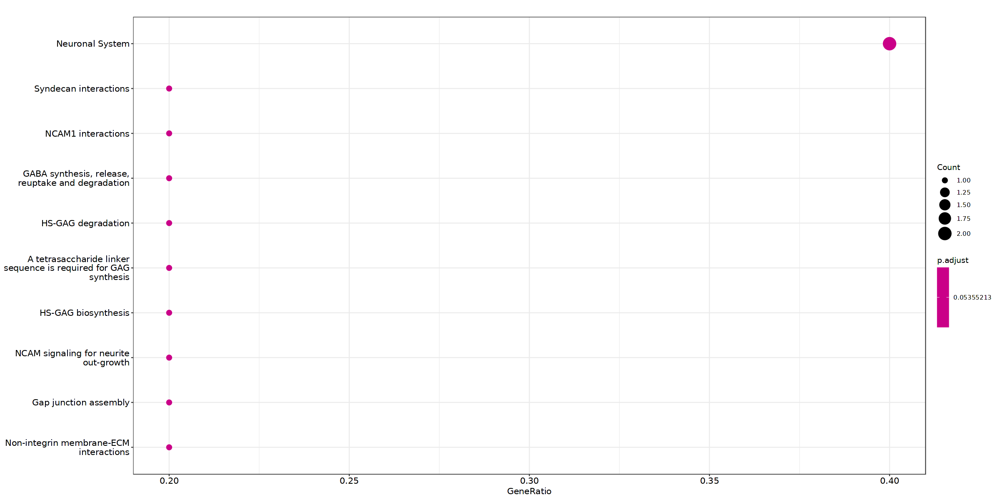

In [400]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [401]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

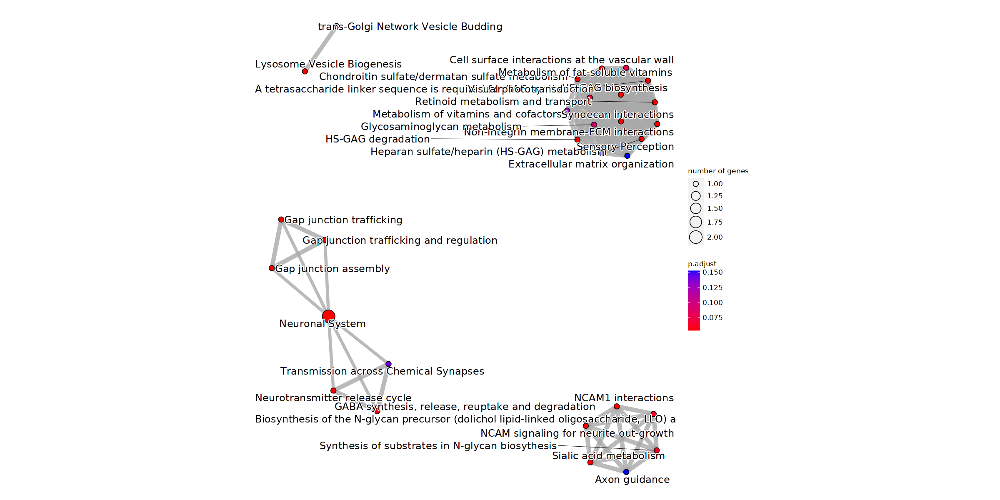

In [402]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.11 Sub category 7

In [403]:
gene_list <- c("Slc13a1","Chst9","Fras1","Sntb1","Sh2d4b","BC016548","Maf","Gm28417","Gm9934","Gjb2","Cd300lf","Aass","Nebl","Uchl1","Ceacam2","Basp1","Tox","Grm4","Pqlc3","Fam135b","Ror1","Rgs16","Zfp385b","Gm14095","1700030L20Rik","Lrrn2","Mkx","Tiam2","Lmo7","Greb1l","Eid2","P2ry14","Lrrc14b","Lhfp","2410080I02Rik","Khdrbs3","Zfp423")

In [404]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [405]:
length(gene_list)

[1] 35

In [406]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [407]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [408]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [409]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [410]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [411]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [412]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [413]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:32] "22223" "381157" "252838" "380928" "26563" "70363" "74103" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [414]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [415]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:32] "22223" "381157" "252838" "380928" "26563" "70363" "74103" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...42 enriched terms found
'data.frame':	42 obs. of  9 variables:
 $ ID         : chr  "R-MMU-418594" "R-MMU-417957" "R-MMU-5140745" "R-MMU-71064" ...
 $ Description: chr  "G alpha (i) signalling events" "P2Y receptors" "WNT5A-dependent internalization of FZD2, FZD5 and ROR2" "Lysine catabolism" ...
 $ GeneRatio  : chr  "3/14" "1/14" "1/14" "1/14" ...
 $ BgRatio    : chr  "273/8501" "11/8501" "11/8501" "12/8501" ...
 $ pvalue     : num  0.00917 0.01798 0.01798 0.0196 0.02283 ...
 $ p.adjust   : num  0.185 0.185 0.185 0.185 0.185 ...
 $ qvalue     : num  0.153 0.153 0.153 0.153 0.153 ...
 $ geneID     : chr  "P2ry14/Rgs16/Grm4" "P2ry14" "Ror1" "Aass" ...
 $ Count      : int  3 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: 

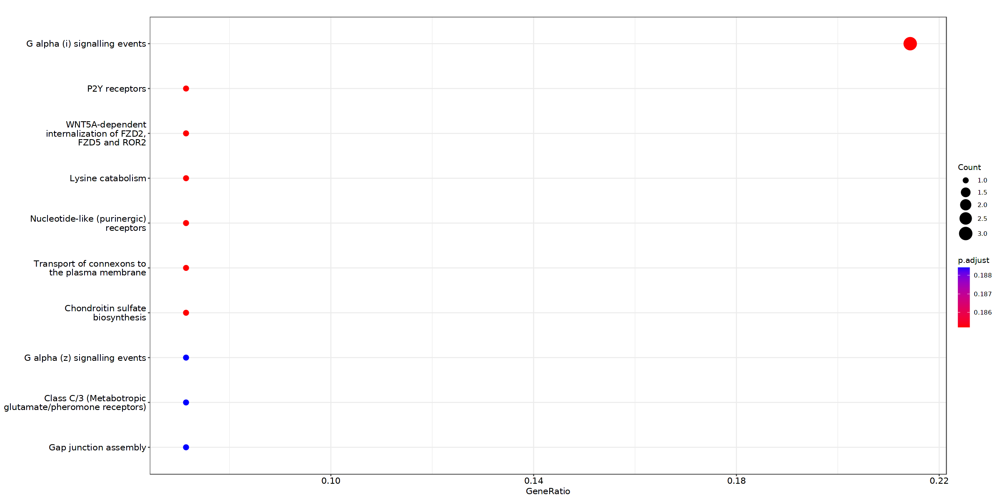

In [416]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [417]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

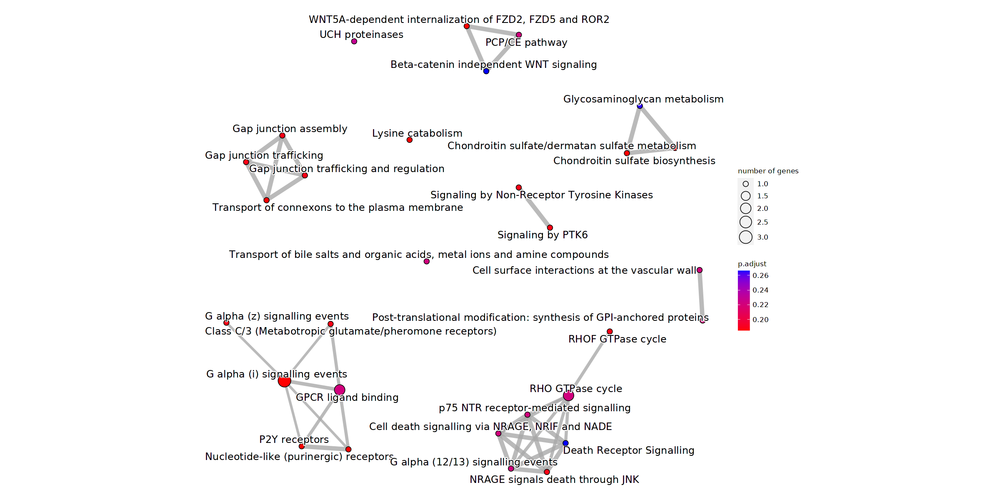

In [418]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.12 Sub category 8

In [419]:
gene_list <- c("Isg20","Rnase1","Gm10964","E130006D01Rik","Gm28100","Zbtb8b","5330429C05Rik","Gm12898","Isg15","C130050O18Rik","Lrrc2","Gria1","Art5","Gm11548","Pik3r5","Alpk1","Gbp5","Irx2","Gbp2","Igtp","Psmb8","Parp14","Fabp1","Serpina3f","Pde3a","Pou4f1","Usp18","Clca1","Gpr133","Irf8","Trim21","Gm12216","Ifit1","Hspb1","Cmpk2","Tspan4","Ifit3","Ndrg2","Patl2","1700007J10Rik","Gbp7","Psmb9","Irgm1","Tesc","Tap1","Irgm2","H2-Q4","B530045E10Rik","Herc6","Irf9","Zc3hav1")

In [420]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [421]:
length(gene_list)

[1] 49

In [422]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [423]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [424]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [425]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [426]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [427]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [428]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [429]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "16145" "15944" "16913" "14469" "15959" "229900" "21354" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...100 enriched terms found
'data.frame':	100 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-450408" "R-MMU-913531" "R-MMU-983169" ...
 $ Description: chr  "Antigen processing-Cross presentation" "AUF1 (hnRNP D0) binds and destabilizes mRNA" "Interferon Signaling" "Class I MHC mediated antigen processing & presentation" ...
 $ GeneRatio  : chr  "4/15" "3/15" "3/15" "5/15" ...
 $ BgRatio    : chr  "92/8501" "56/8501" "65/8501" "343/8501" ...
 $ pvalue     : num  0.000016 0.000116 0.000182 0.000223 0.000257 ...
 $ p.adjust   : num  0.00296 0.0095 0.0095 0.0095 0.0095 ...
 $ qvalue     : num  0.0011 0.00351 0.00351 0.00351 0.00351 ...
 $ geneID     : chr  "Psmb8/Tap1/Psmb9/H2-Q4" "Psmb8/Psmb9/Hspb1" "Isg15/Usp18/Irf9" "Psmb8/Tap1/Herc6

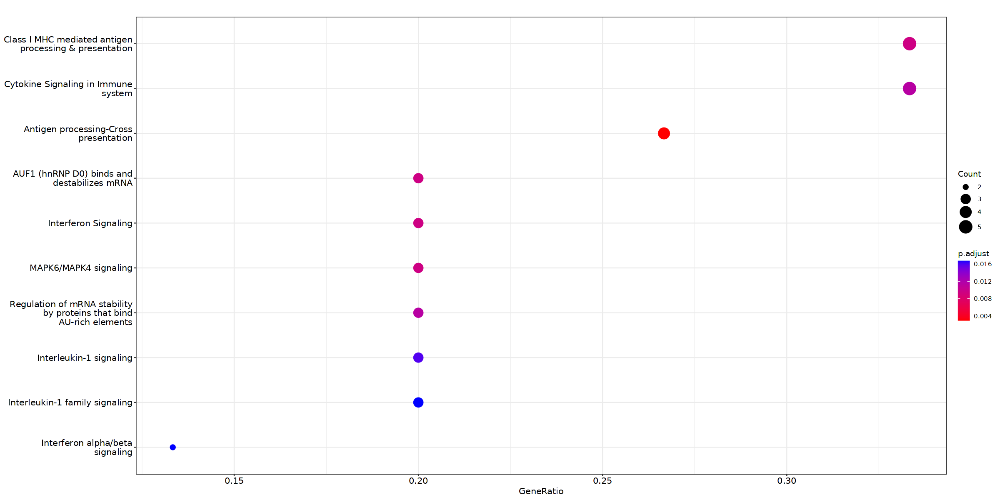

In [430]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [431]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 6 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


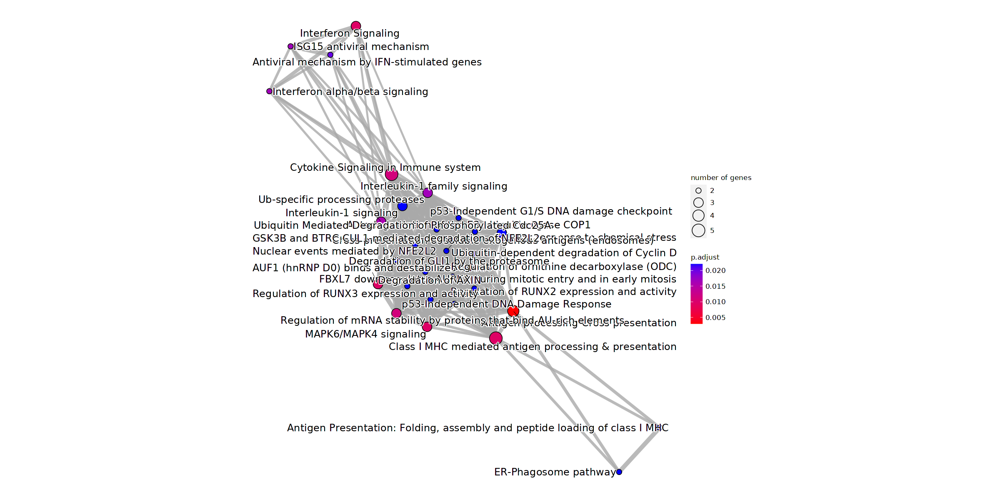

In [432]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [433]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [434]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "16145" "15944" "16913" "14469" "15959" "229900" "21354" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...185 enriched terms found
'data.frame':	185 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-450408" "R-MMU-913531" "R-MMU-983169" ...
 $ Description: chr  "Antigen processing-Cross presentation" "AUF1 (hnRNP D0) binds and destabilizes mRNA" "Interferon Signaling" "Class I MHC mediated antigen processing & presentation" ...
 $ GeneRatio  : chr  "4/15" "3/15" "3/15" "5/15" ...
 $ BgRatio    : chr  "92/8501" "56/8501" "65/8501" "343/8501" ...
 $ pvalue     : num  0.000016 0.000116 0.000182 0.000223 0.000257 ...
 $ p.adjust   : num  0.00296 0.0095 0.0095 0.0095 0.0095 ...
 $ qvalue     : num  0.0011 0.00351 0.00351 0.00351 0.00351 ...
 $ geneID     : chr  "Psmb8/Tap1/Psmb9/H2-Q4" "Psmb8/Psmb9/Hspb1" "Isg15/Usp18/Irf9" "Psmb8/Tap1/Herc6/Ps

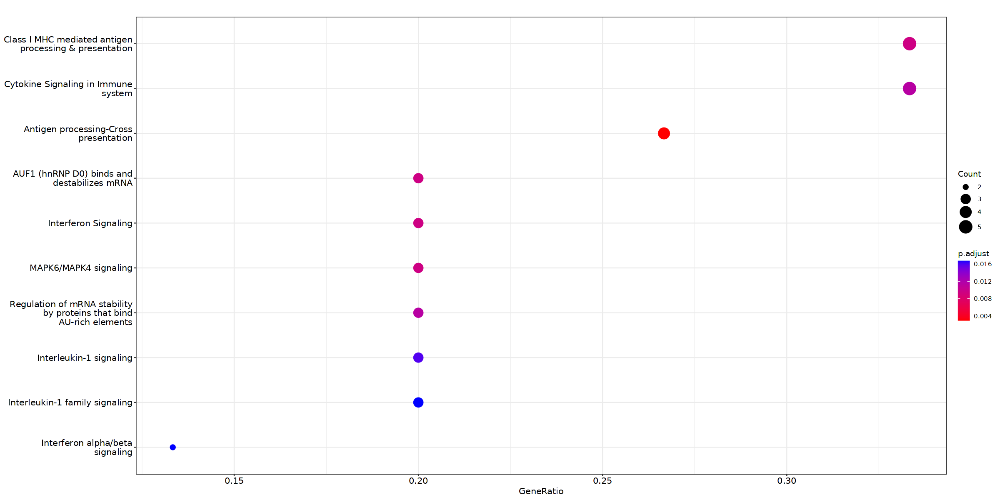

In [435]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [436]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 11 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


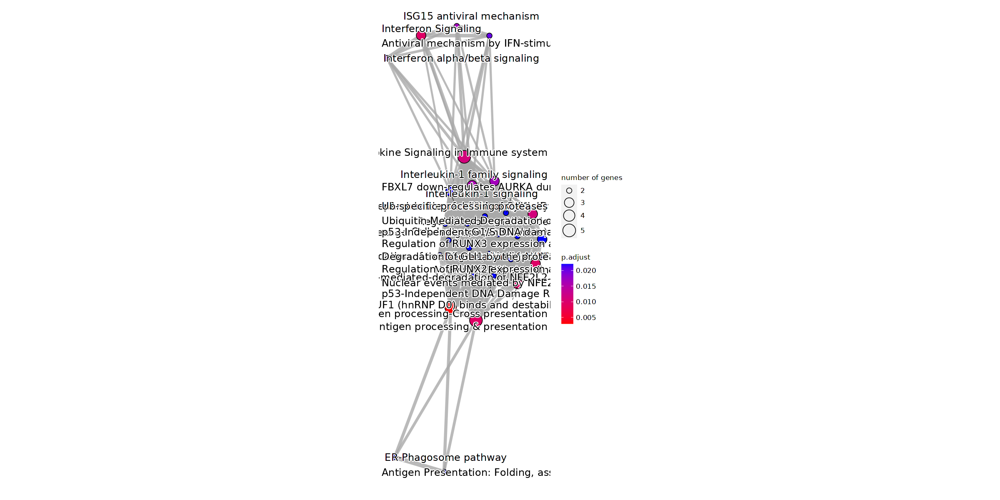

In [437]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.13 Sub category 9

In [438]:
gene_list <- c("Gm26760","Gm16046","Cacna1e","Sfxn1","H2-D1","B2m","Il18bp","Gbp8","Zbp1","Tgtp2","Tgm2","Trim34a","Oas1a","E230001N04Rik","Gm12185","Apol9b","4732465J04Rik","Mgst2","Pcsk1","Chac1","Gm28694","Ifi47","4930518I15Rik","I830012O16Rik","4921508D12Rik","Trim30a","Gm15821","Serping1","Zbbx","Ly6e","Slco5a1","Apobec1","Tdrd12","Rin3","Ccdc141","9330175E14Rik","Iigp1","Gbp9","Gjb5","Atf7ip2","Gm14216","Dlk1","Gm7976","A330094K24Rik","Angpt4","2310081O03Rik","H2-Q6","Trpc4","A4galt","Gm5468","Bpifa3","Serpina12","Gm11690","Cdsn","Htr3a","Kcnv2","Ptgs2os","A230065N10Rik","Gm26776","Ubd","Pla2g4f","Gm20109","Htr5a","Plin4","Gbp4","2610035F20Rik","Igsf21","Vwc2l","Trim5","Mdfic","RP23-333I7.1","Sh2b2","Gm19684","Gm7030","Etnppl","Tmem232","Ifi27l2a","Lppr5","Mx1","Ly6a","Tgtp1","Serpina3i","Cyb561","Ms4a4d","RP23-387L22.3","Gm16019","1700025C18Rik","Sphkap","Gm8369","Ms4a6b","Apol9a","Arhgdib","Olfr56","S100a4","Pdzrn4","Barx2","Crtam","Rgs7","Gm830","4930568A12Rik","Gm12505","Gm13446","H2-Q7","S100a3","E330017L17Rik","Dhrs3","Gata6","Mtl5","3100002H09Rik","Gm6169","Gm13844","Lrrc37a","Tigit","Gpr165","Hspb7","Gm29507","1200007C13Rik","Crmp1","Ccdc3","Hspb8","Arhgap44","Gm28068","Slc25a24")

In [439]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [440]:
length(gene_list)

[1] 108

In [441]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [442]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [443]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [444]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [445]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [446]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [447]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [448]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "60440" "12010" "14964" "76933" "58203" "57435" "239618" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...7 enriched terms found
'data.frame':	7 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236977" "R-MMU-1236974" "R-MMU-983170" "R-MMU-1236975" ...
 $ Description: chr  "Endosomal/Vacuolar pathway" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" "Antigen processing-Cross presentation" ...
 $ GeneRatio  : chr  "3/17" "3/17" "3/17" "3/17" ...
 $ BgRatio    : chr  "25/8501" "34/8501" "41/8501" "92/8501" ...
 $ pvalue     : num  1.49e-05 3.83e-05 6.76e-05 7.47e-04 8.21e-04 ...
 $ p.adjust   : num  0.000848 0.00109 0.001284 0.008069 0.008069 ...
 $ qvalue     : num  0.000548 0.000705 0.00083 0.005215 0.005215 ...
 $ geneID     : chr  "B2m/H2-Q7/H2-Q6" "B2m/H2-Q7/H2-Q6" "B2m/H2-Q7/H2-Q6" "B2m/H2-Q7/H2-

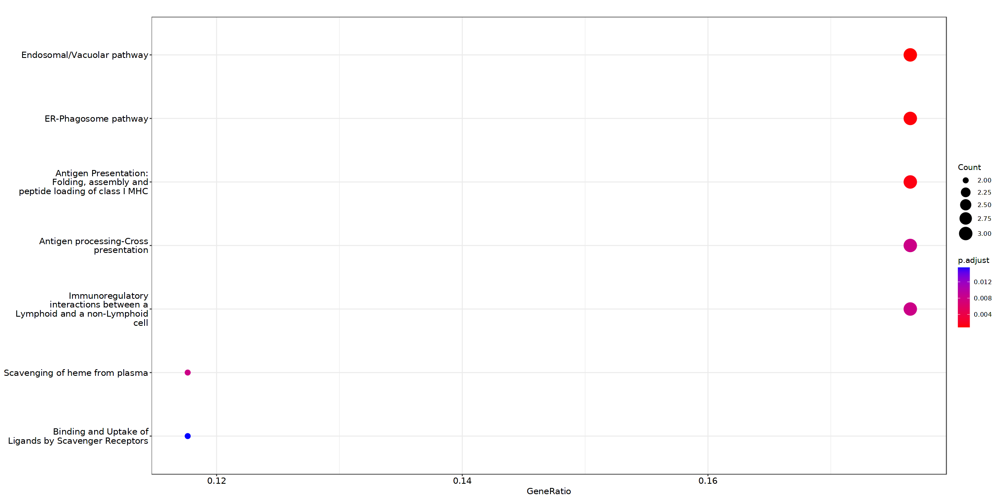

In [449]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [450]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

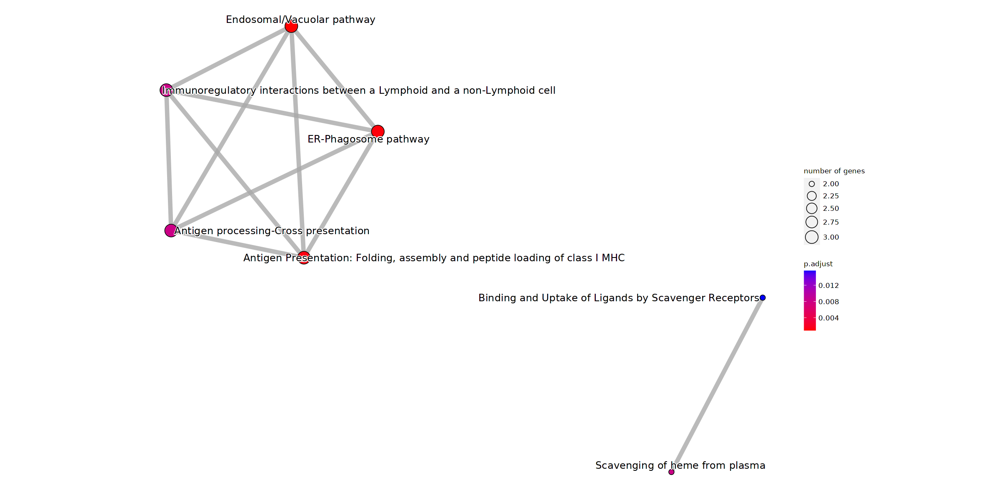

In [451]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [452]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [453]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "60440" "12010" "14964" "76933" "58203" "57435" "239618" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...57 enriched terms found
'data.frame':	57 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236977" "R-MMU-1236974" "R-MMU-983170" "R-MMU-1236975" ...
 $ Description: chr  "Endosomal/Vacuolar pathway" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" "Antigen processing-Cross presentation" ...
 $ GeneRatio  : chr  "3/17" "3/17" "3/17" "3/17" ...
 $ BgRatio    : chr  "25/8501" "34/8501" "41/8501" "92/8501" ...
 $ pvalue     : num  1.49e-05 3.83e-05 6.76e-05 7.47e-04 8.21e-04 ...
 $ p.adjust   : num  0.000848 0.00109 0.001284 0.008069 0.008069 ...
 $ qvalue     : num  0.000548 0.000705 0.00083 0.005215 0.005215 ...
 $ geneID     : chr  "B2m/H2-Q7/H2-Q6" "B2m/H2-Q7/H2-Q6" "B2m/H2-Q7/H2-Q6" "B2m/H2-Q7/H2-Q

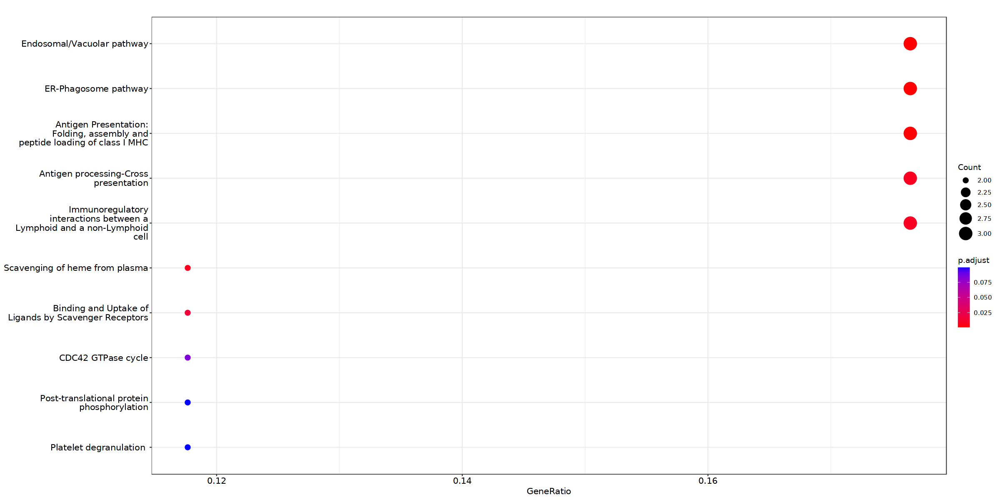

In [454]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [455]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

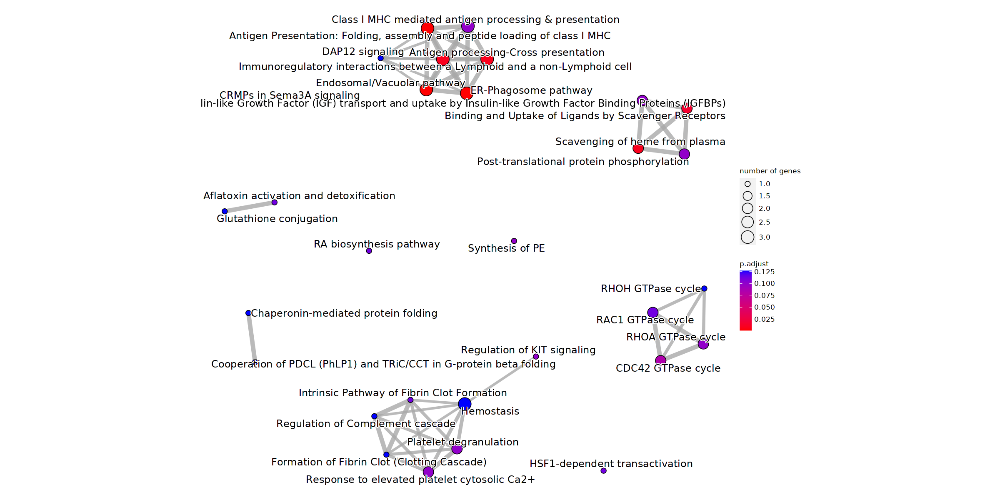

In [456]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.14 Sub category 10

In [457]:
gene_list <- c("Cd200r2","Gm12299","Gm29458","Gm14249","1700096J18Rik","4921507L20Rik","Gja5","Ren1","Ikzf1","Eva1a","Slc24a4","Gm16758","RP23-187M7.3","Card11","Hist1h2af","Tcl1","BC067074","Zp3r","Slc6a7","Gulp1","Amigo2","Spata31d1d")

In [458]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [459]:
length(gene_list)

[1] 20

In [460]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [461]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [462]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [463]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [464]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [465]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [466]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [467]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:14] "70676" "232146" "238384" "22778" "14613" "108723" "19701" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [469]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [470]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:14] "70676" "232146" "238384" "22778" "14613" "108723" "19701" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...26 enriched terms found
'data.frame':	26 obs. of  9 variables:
 $ ID         : chr  "R-MMU-425561" "R-MMU-2022377" "R-MMU-442660" "R-MMU-425407" ...
 $ Description: chr  "Sodium/Calcium exchangers" "Metabolism of Angiotensinogen to Angiotensins" "Na+/Cl- dependent neurotransmitter transporters" "SLC-mediated transmembrane transport" ...
 $ GeneRatio  : chr  "1/8" "1/8" "1/8" "2/8" ...
 $ BgRatio    : chr  "12/8501" "16/8501" "17/8501" "218/8501" ...
 $ pvalue     : num  0.0112 0.015 0.0159 0.0166 0.0297 ...
 $ p.adjust   : num  0.108 0.108 0.108 0.108 0.122 ...
 $ qvalue     : num  0.0828 0.0828 0.0828 0.0828 0.0935 ...
 $ geneID     : chr  "Slc24a4" "Ren1" "Slc6a7" "Slc24a4/Slc6a7" ...
 $ Count      : int  1 1 1 2 1 1 1 1 1 1 ...
#...Citation
  Gua

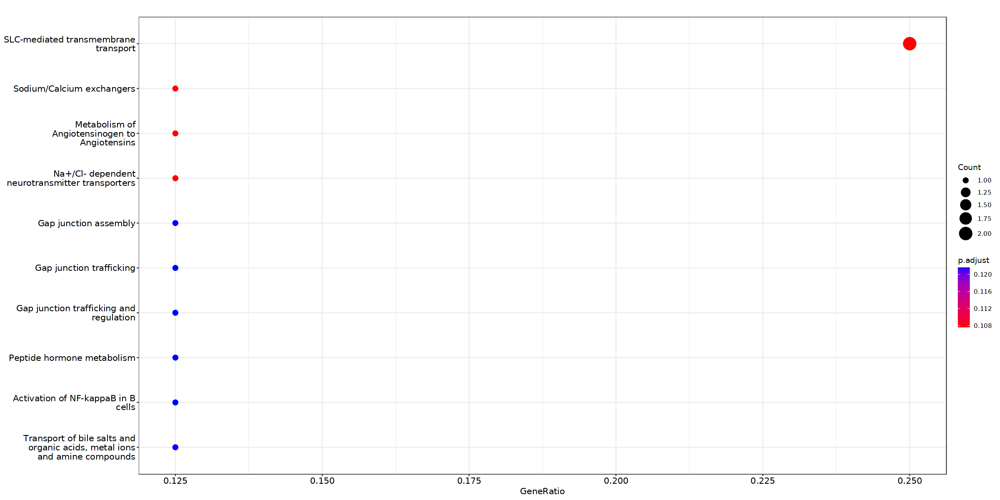

In [471]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [472]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

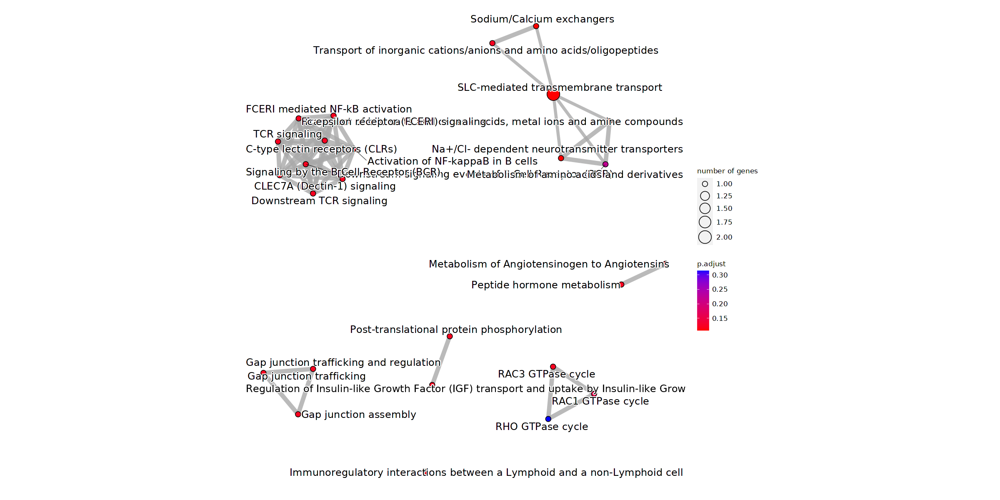

In [473]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.15 Sub category 11

In [474]:
gene_list <- c("Tgfb2","Efhd2","Suclg2","Gpr137b","Cdhr2","Smim5","Prox2","Slc44a2","Tiam1","Filip1","Spint2","Acsf3","Epha10","Slc9b2","A330008L17Rik","Mef2c","Gm11042","Mmp15","Adamtsl2","Frzb","Kif26b","6330409D20Rik","Plg","Crip1","Tubb2b","Lix1","Zfp57","A930006I01Rik")

In [475]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [476]:
length(gene_list)

[1] 27

In [477]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [478]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [479]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [480]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [481]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [482]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [483]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [484]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:26] "73710" "12925" "83924" "230735" "68682" "27984" "97086" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [485]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [486]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:26] "73710" "12925" "83924" "230735" "68682" "27984" "97086" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...89 enriched terms found
'data.frame':	89 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1592389" "R-MMU-983189" "R-MMU-1474244" "R-MMU-109582" ...
 $ Description: chr  "Activation of Matrix Metalloproteinases" "Kinesins" "Extracellular matrix organization" "Hemostasis" ...
 $ GeneRatio  : chr  "2/13" "2/13" "3/13" "4/13" ...
 $ BgRatio    : chr  "33/8501" "52/8501" "231/8501" "490/8501" ...
 $ pvalue     : num  0.00111 0.00274 0.00463 0.00514 0.00819 ...
 $ p.adjust   : num  0.0988 0.1143 0.1143 0.1143 0.1199 ...
 $ qvalue     : num  0.0689 0.0797 0.0797 0.0797 0.0837 ...
 $ geneID     : chr  "Mmp15/Plg" "Tubb2b/Kif26b" "Mmp15/Plg/Tgfb2" "Tubb2b/Kif26b/Plg/Tgfb2" ...
 $ Count      : int  2 2 3 4 2 2 2 2 2 2 ...
#...Citation
  Guangchuang Yu, Qing-Y

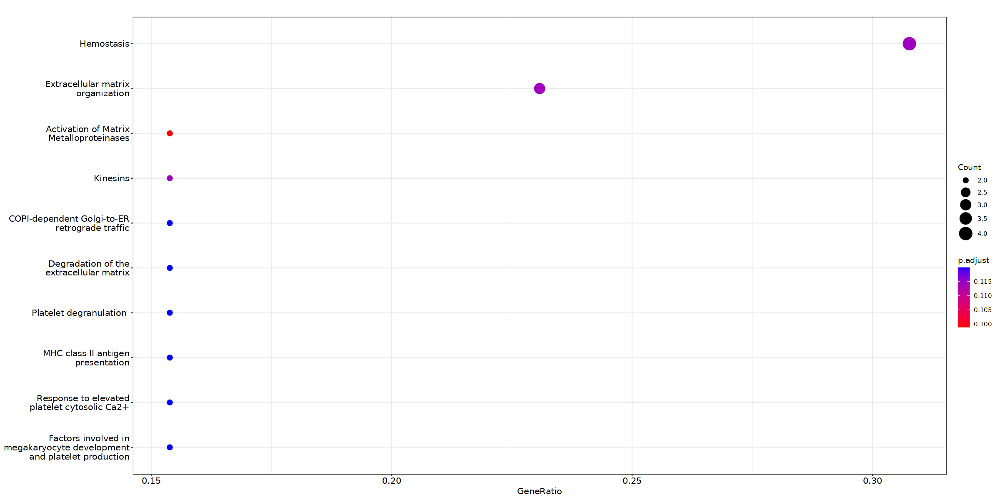

In [487]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [488]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

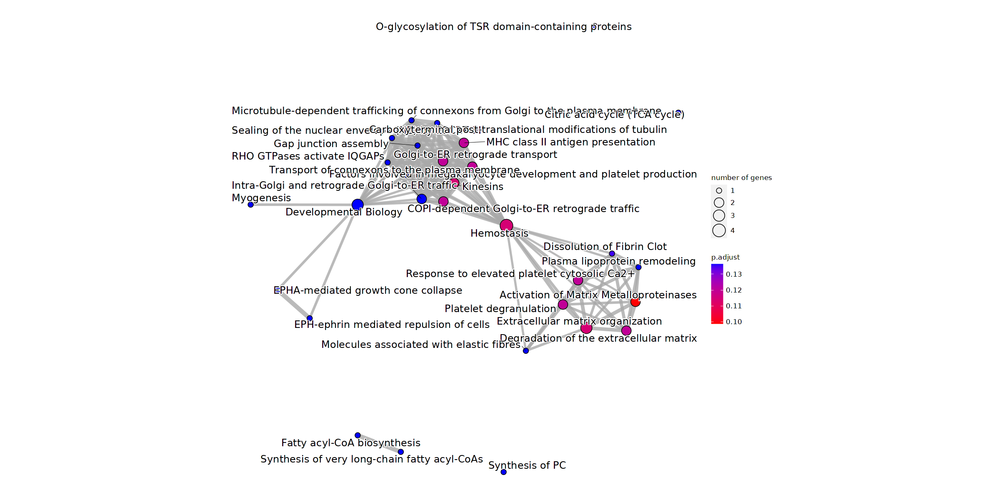

In [489]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.16 Sub category 12

In [490]:
gene_list <- c("Mroh5","Ddah1","Cd80","Syt13","Tnfrsf1b","Fzd10","Chst5","Lbp","Fam180a","Tmem8c","Gm9047","Rph3al","Lst1","Mocos","Sh3d21","Tmem176a","Tmem176b","Gm13889","Gm11731","Gucy1a3","B130046B21Rik","Gjb4","Runx3","3110079O15Rik","RP23-226J18.4","RP24-72B22.1","Hmx1","Fam92b","D430041D05Rik","Itgb2","Fxyd5","C230024C17Rik","Cftr","Lgals3","Sh3bgr","E130018N17Rik","Bmp7","5930412G12Rik","Gdf6","Cpz","Lmx1a","Esyt3","Col1a2","RP23-333L19.2","Fam65b","AI427809","Dmbt1","4930412L05Rik","Cldn23","Irf4","Bmper","Drp2","Itpripl2","Ebf3")

In [491]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [492]:
length(gene_list)

[1] 44

In [493]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [494]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [495]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [496]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [497]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [498]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [499]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [500]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:39] "16854" "12843" "65963" "69219" "66058" "319622" "272636" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [501]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [502]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:39] "16854" "12843" "65963" "69219" "66058" "319622" "272636" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...66 enriched terms found
'data.frame':	66 obs. of  9 variables:
 $ ID         : chr  "R-MMU-216083" "R-MMU-1474244" "R-MMU-202733" "R-MMU-198933" ...
 $ Description: chr  "Integrin cell surface interactions" "Extracellular matrix organization" "Cell surface interactions at the vascular wall" "Immunoregulatory interactions between a Lymphoid and a non-Lymphoid cell" ...
 $ GeneRatio  : chr  "2/13" "3/13" "2/13" "2/13" ...
 $ BgRatio    : chr  "66/8501" "231/8501" "89/8501" "95/8501" ...
 $ pvalue     : num  0.00438 0.00463 0.00784 0.0089 0.012 ...
 $ p.adjust   : num  0.121 0.121 0.121 0.121 0.121 ...
 $ qvalue     : num  0.0792 0.0792 0.0792 0.0792 0.0792 ...
 $ geneID     : chr  "Col1a2/Itgb2" "Col1a2/Itgb2/Bmp7" "Col1a2/Itgb2" "Col1a2/Itgb2" ...
 $ 

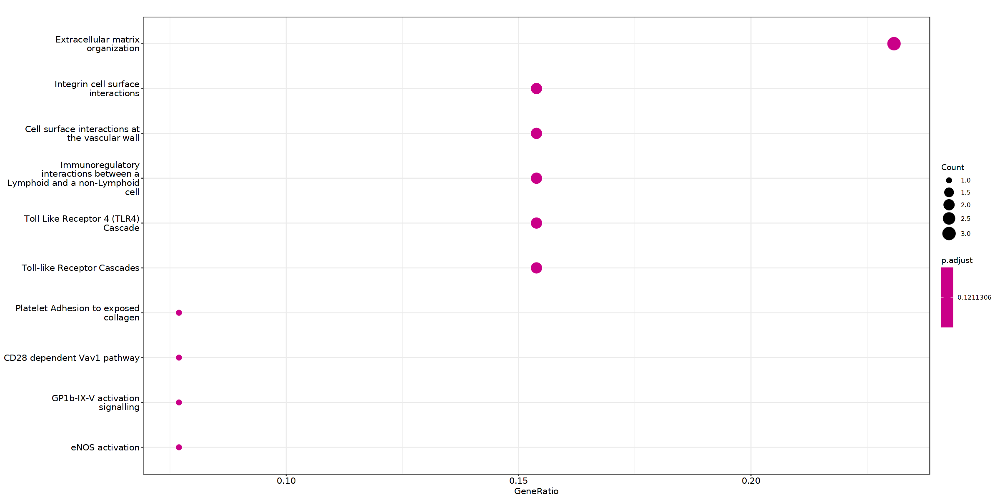

In [503]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [504]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

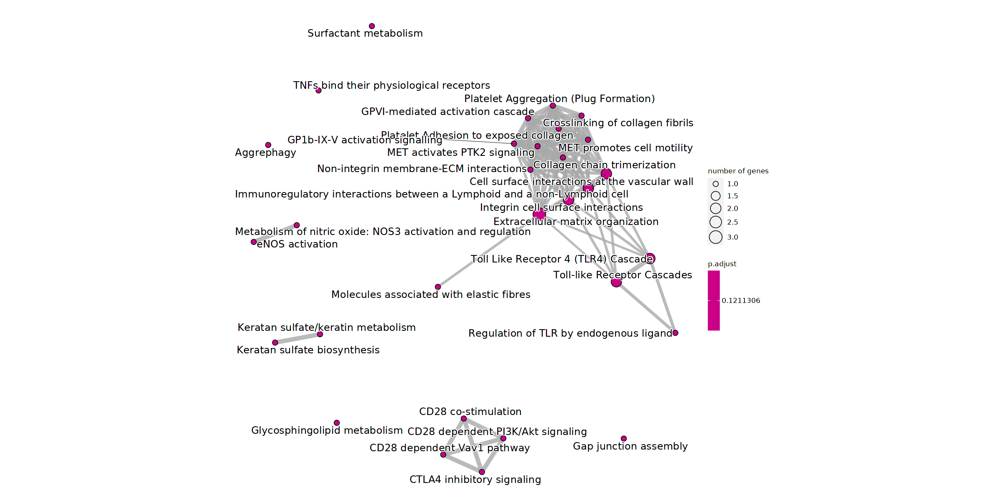

In [505]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### 3.2.2.17 Sub category 13

In [506]:
gene_list <- c("6030407O03Rik","Bik","Col6a2","Pkia","Apoe","N4bp2l1","Piezo2","Fxyd1","Fxyd7","Gm11750","Chrna5","Lrrn4","Lama5","Ly6g6c","Eln","Flrt1","Arhgef6","Edar","Bpi","D10Bwg1379e","Irx3os","Gm5860","Mrgprd","Sp8","Gm6569","Chit1","Lyzl4","Gm29183","Prss33","Capn8","Lonrf2","Myzap","Col13a1","A830019P07Rik","Megf6")

In [507]:
gene_list <- gene_list[gene_list %in% rownames(df_dynamics)]

In [508]:
length(gene_list)

[1] 34

In [509]:
top_DEG <- apply(df_dynamics[gene_list,],1,function(x){max(x)-min(x)})

In [510]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [511]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [512]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [513]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [514]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [515]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [516]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:30] "11816" "667742" "56188" "57780" "18767" "102371" "12817" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...9 enriched terms found
'data.frame':	9 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1474228" "R-MMU-1474244" "R-MMU-8948216" "R-MMU-5578775" ...
 $ Description: chr  "Degradation of the extracellular matrix" "Extracellular matrix organization" "Collagen chain trimerization" "Ion homeostasis" ...
 $ GeneRatio  : chr  "4/14" "4/14" "2/14" "2/14" ...
 $ BgRatio    : chr  "107/8501" "231/8501" "35/8501" "52/8501" ...
 $ pvalue     : num  2.16e-05 4.29e-04 1.45e-03 3.19e-03 3.43e-03 ...
 $ p.adjust   : num  0.00155 0.01545 0.03487 0.0427 0.0427 ...
 $ qvalue     : num  0.00093 0.00926 0.0209 0.0256 0.0256 ...
 $ geneID     : chr  "Col13a1/Col6a2/Eln/Capn8" "Col13a1/Col6a2/Eln/Capn8" "Col13a1/Col6a2" "Fxyd1/Fxyd7" ...
 $ Count      : int  4 4 2 2 2

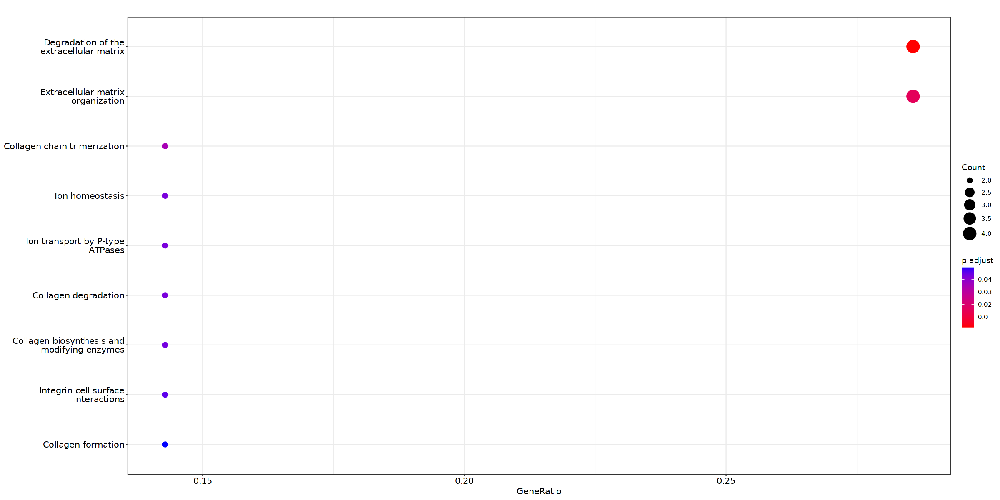

In [517]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [518]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

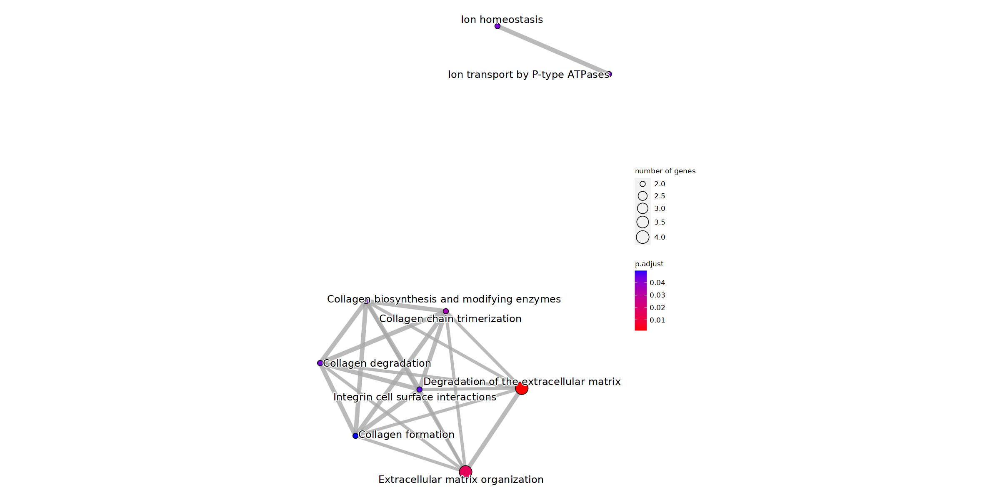

In [519]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [520]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [521]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:30] "11816" "667742" "56188" "57780" "18767" "102371" "12817" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...72 enriched terms found
'data.frame':	72 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1474228" "R-MMU-1474244" "R-MMU-8948216" "R-MMU-5578775" ...
 $ Description: chr  "Degradation of the extracellular matrix" "Extracellular matrix organization" "Collagen chain trimerization" "Ion homeostasis" ...
 $ GeneRatio  : chr  "4/14" "4/14" "2/14" "2/14" ...
 $ BgRatio    : chr  "107/8501" "231/8501" "35/8501" "52/8501" ...
 $ pvalue     : num  2.16e-05 4.29e-04 1.45e-03 3.19e-03 3.43e-03 ...
 $ p.adjust   : num  0.00155 0.01545 0.03487 0.0427 0.0427 ...
 $ qvalue     : num  0.00093 0.00926 0.0209 0.0256 0.0256 ...
 $ geneID     : chr  "Col13a1/Col6a2/Eln/Capn8" "Col13a1/Col6a2/Eln/Capn8" "Col13a1/Col6a2" "Fxyd1/Fxyd7" ...
 $ Count      : int  4 4 2 2 2 

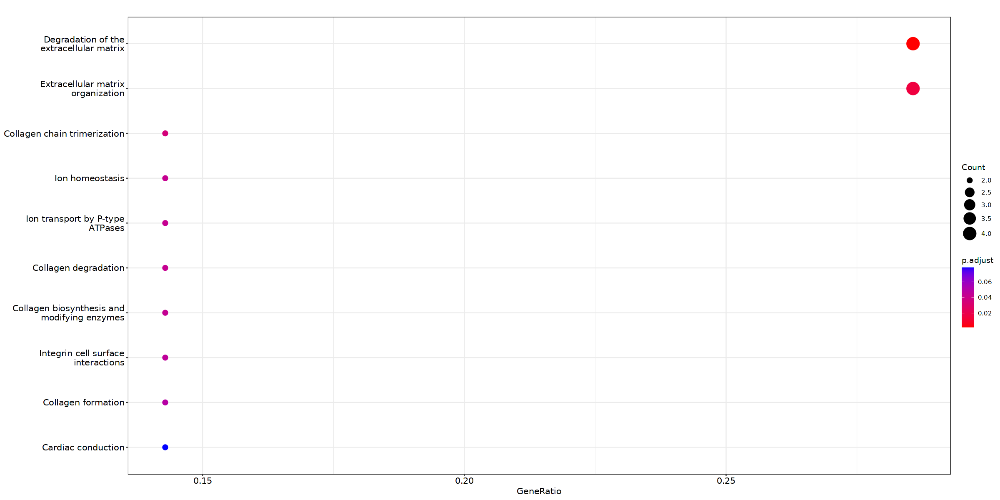

In [522]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [523]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

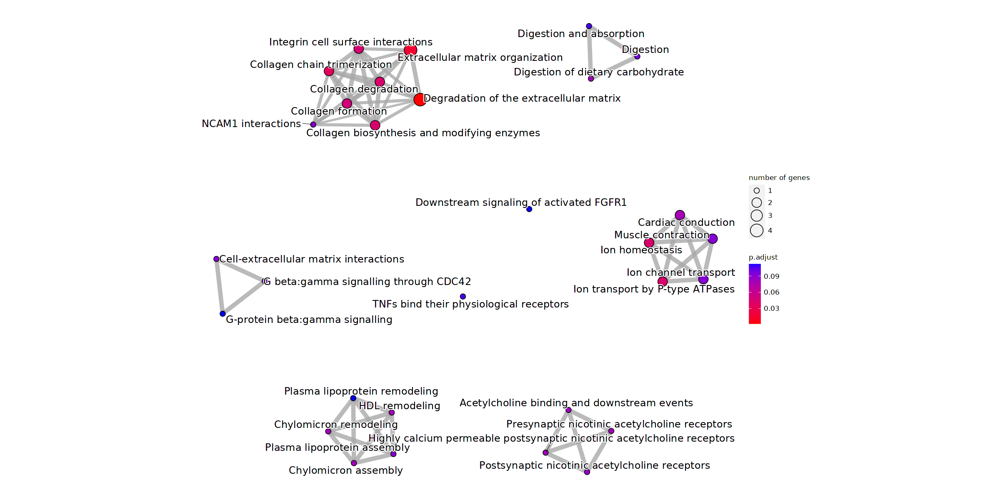

In [524]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

## 4. Close up gene specific

### 4.1 Coverage Plots

#### 4.1.1 MOL56

In [40]:
cluster_choice = "MOL56"

In [41]:
tmp_cluster <- subset(MORNAATACCOL, subset = cellType_OL_merge == cluster_choice)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ol_ to umappeaksol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ol_ to umapbimodol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_generegchrom_ol_ to pcageneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_generegchrom_ol_ to umapgeneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_dorcs_ol_ to pcadorcsol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_dorcs_ol_ to umapdorcsol_"


In [42]:
DefaultAssay(tmp_cluster) <- "peaks"

In [43]:
Idents(tmp_cluster) <- "orig.ident_merge"

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


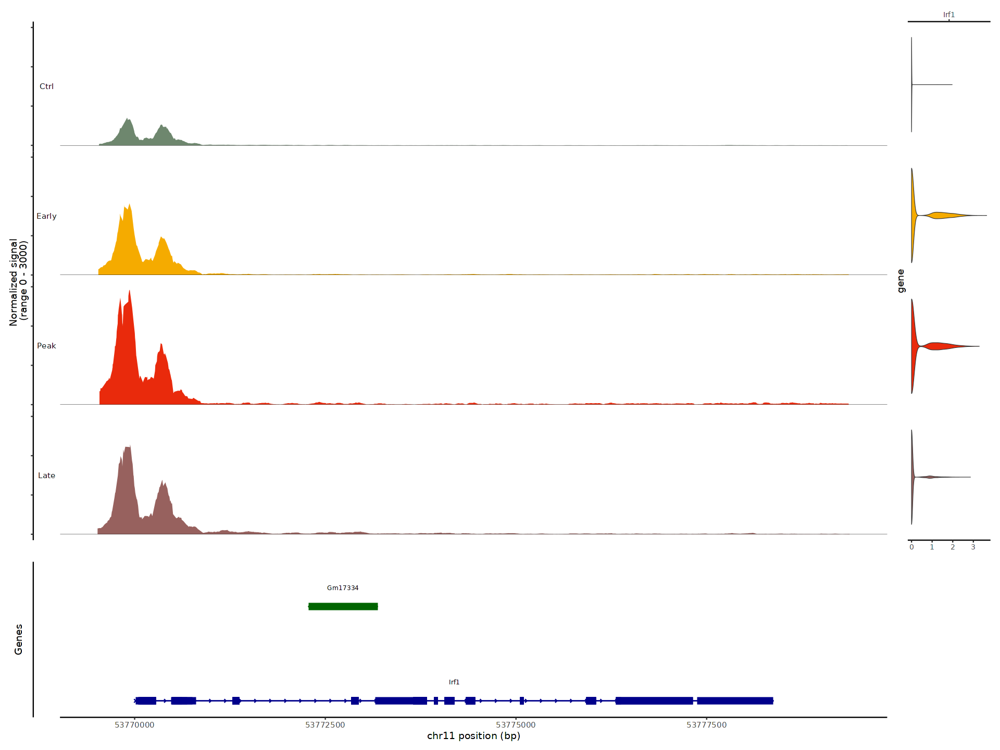

In [17]:
gene_marker <- "Irf1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=3000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


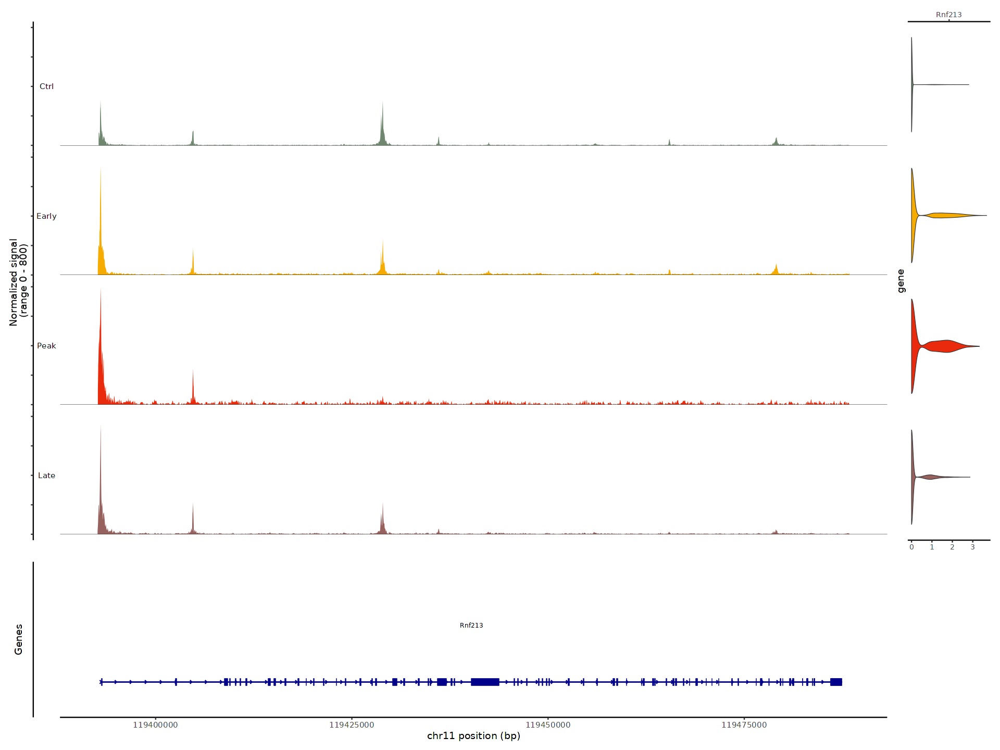

In [19]:
gene_marker <- "Rnf213"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=800, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


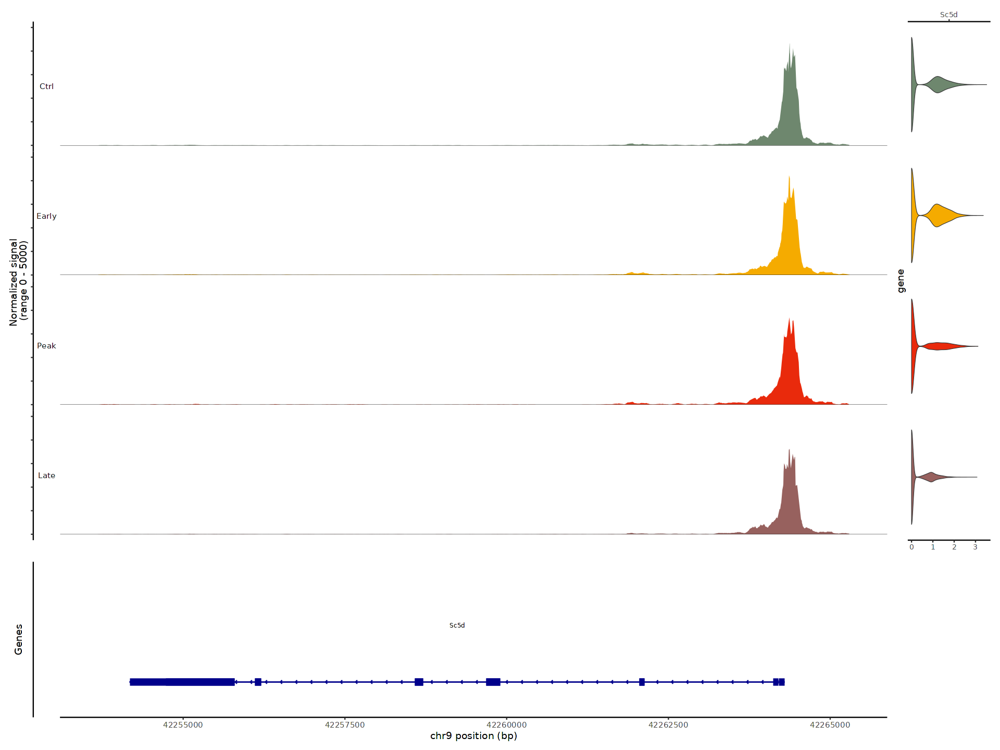

In [22]:
gene_marker <- "Sc5d"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=5000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 5 rows containing missing values (`geom_segment()`)."


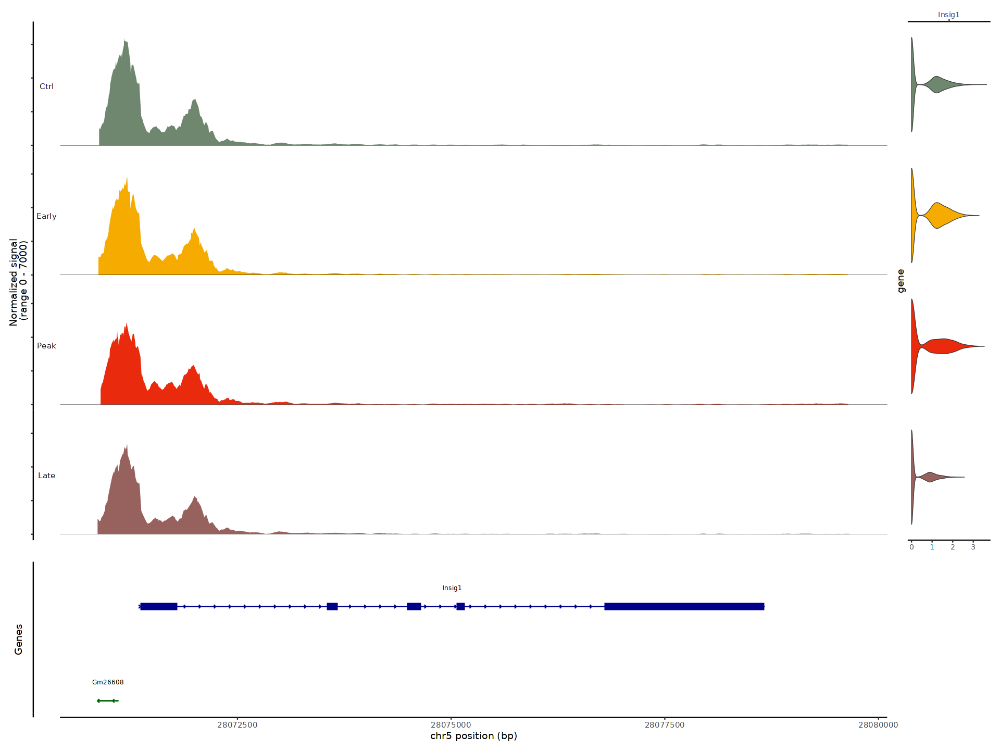

In [25]:
gene_marker <- "Insig1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=7000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


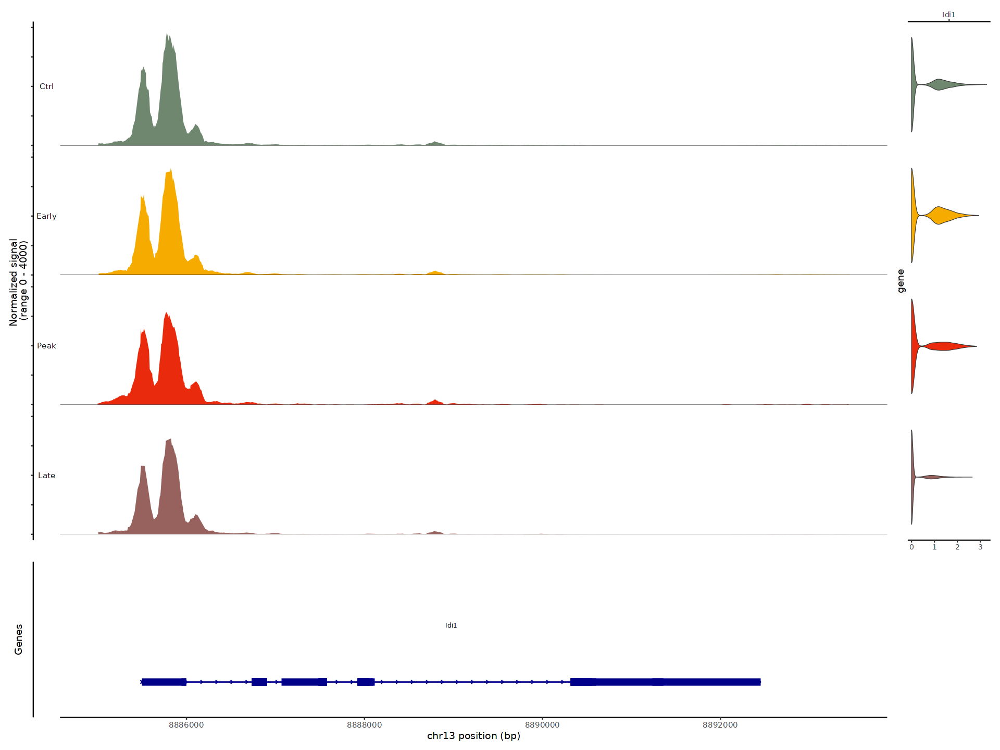

In [27]:
gene_marker <- "Idi1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=4000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


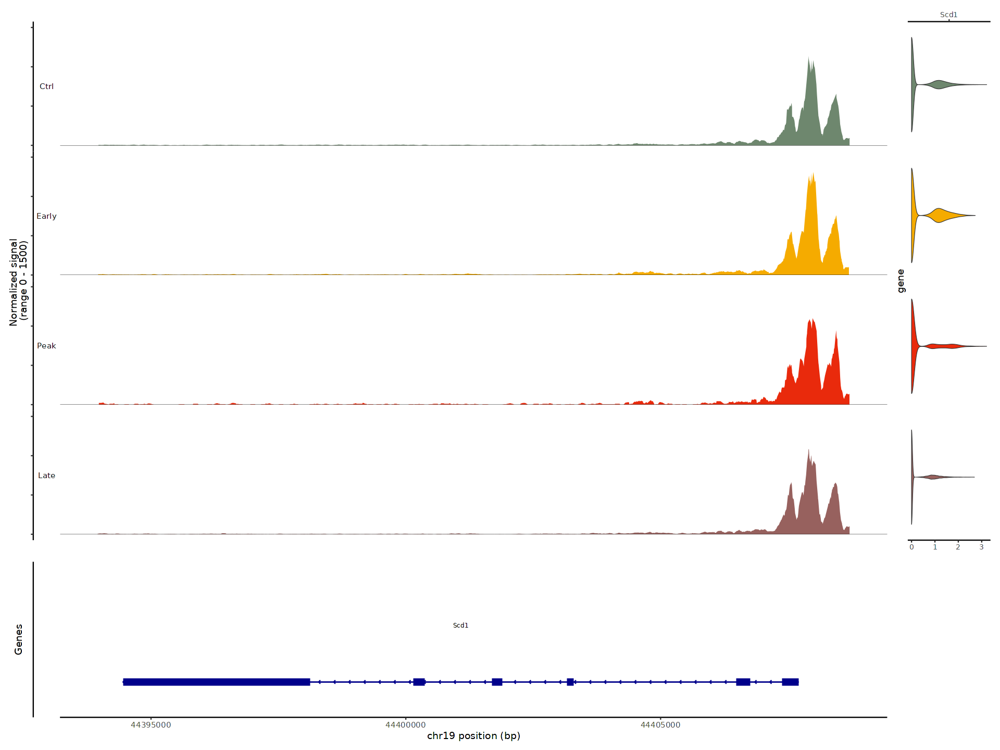

In [30]:
gene_marker <- "Scd1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1500, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


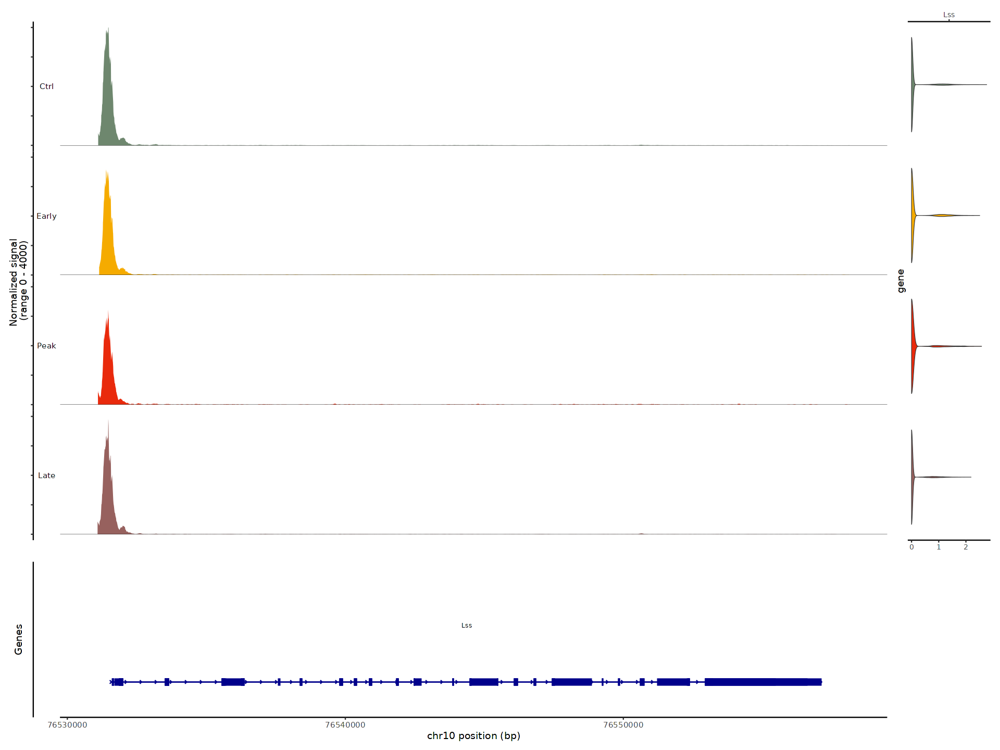

In [32]:
gene_marker <- "Lss"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=4000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 2 rows containing missing values (`geom_segment()`)."


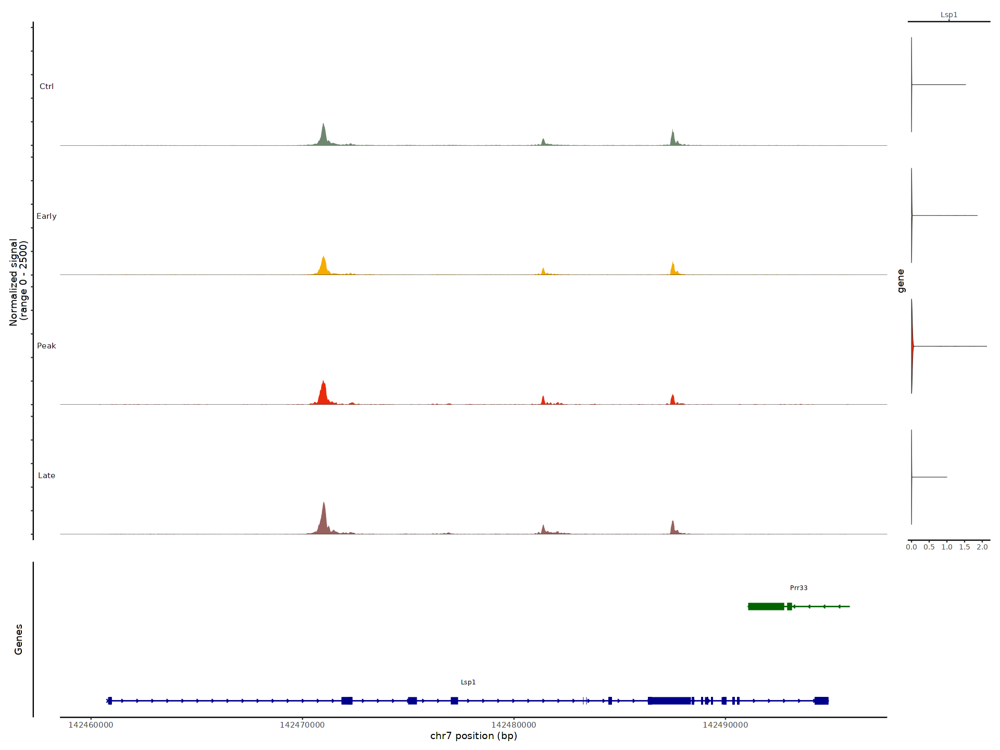

In [86]:
gene_marker <- "Lsp1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=2500, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


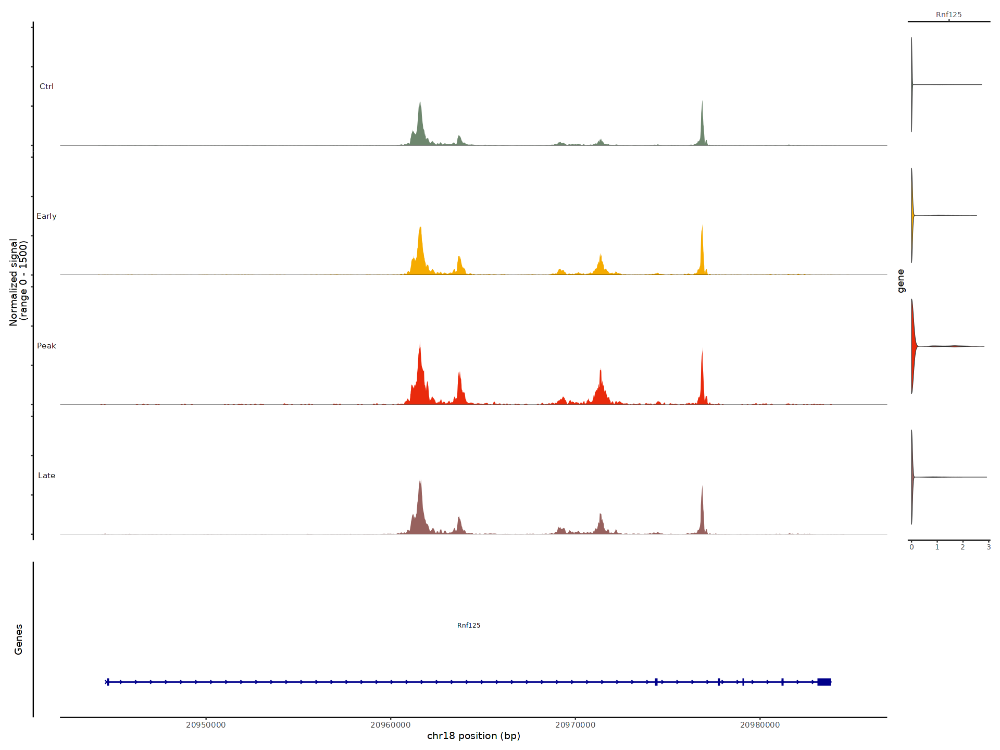

In [87]:
gene_marker <- "Rnf125"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1500, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


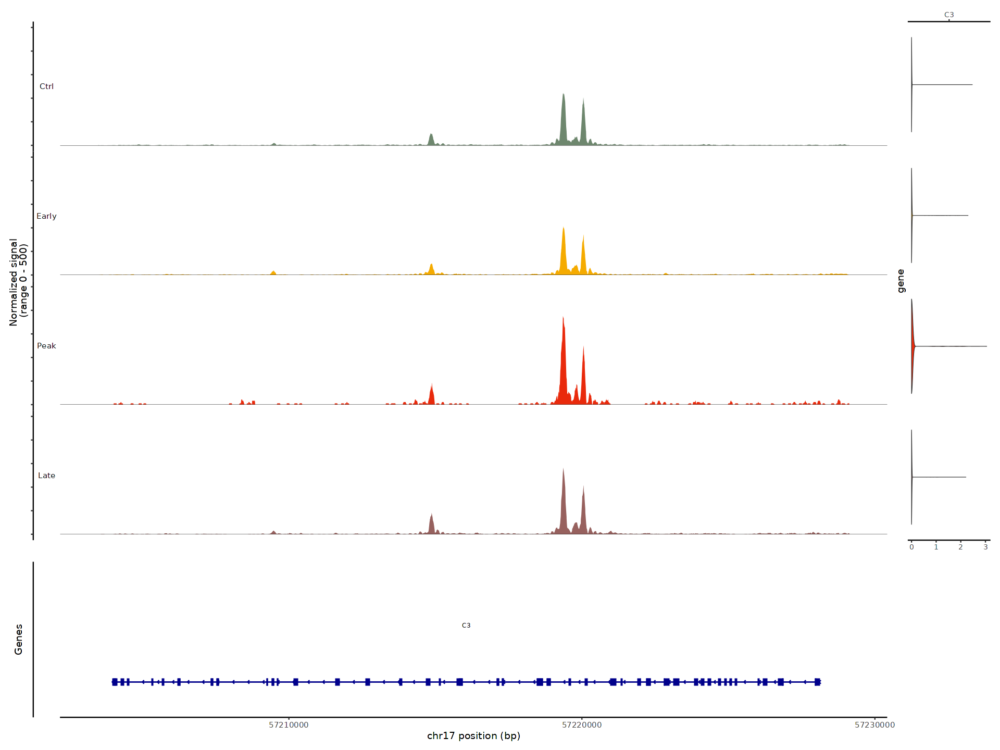

In [88]:
gene_marker <- "C3"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=500, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


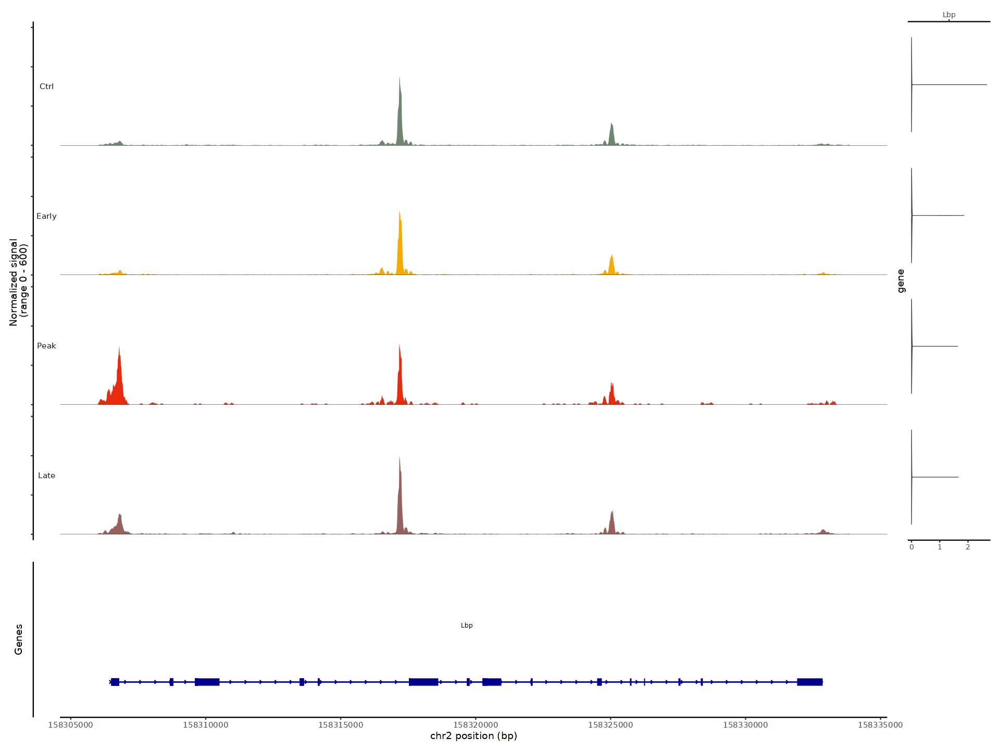

In [89]:
gene_marker <- "Lbp"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=600, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


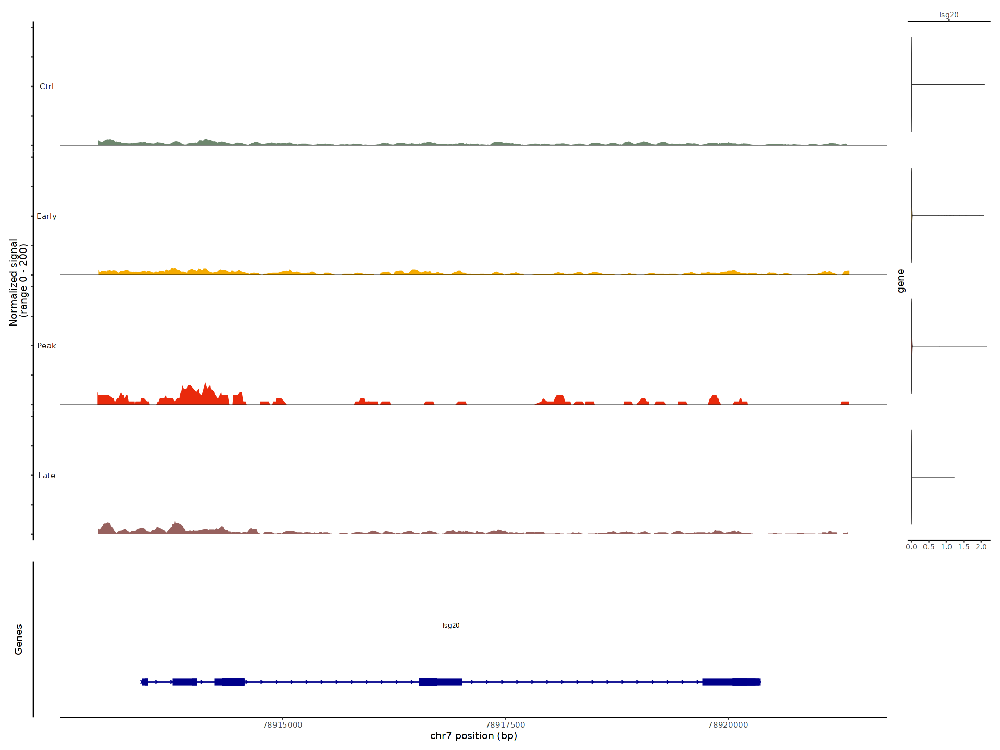

In [90]:
gene_marker <- "Isg20"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=200, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


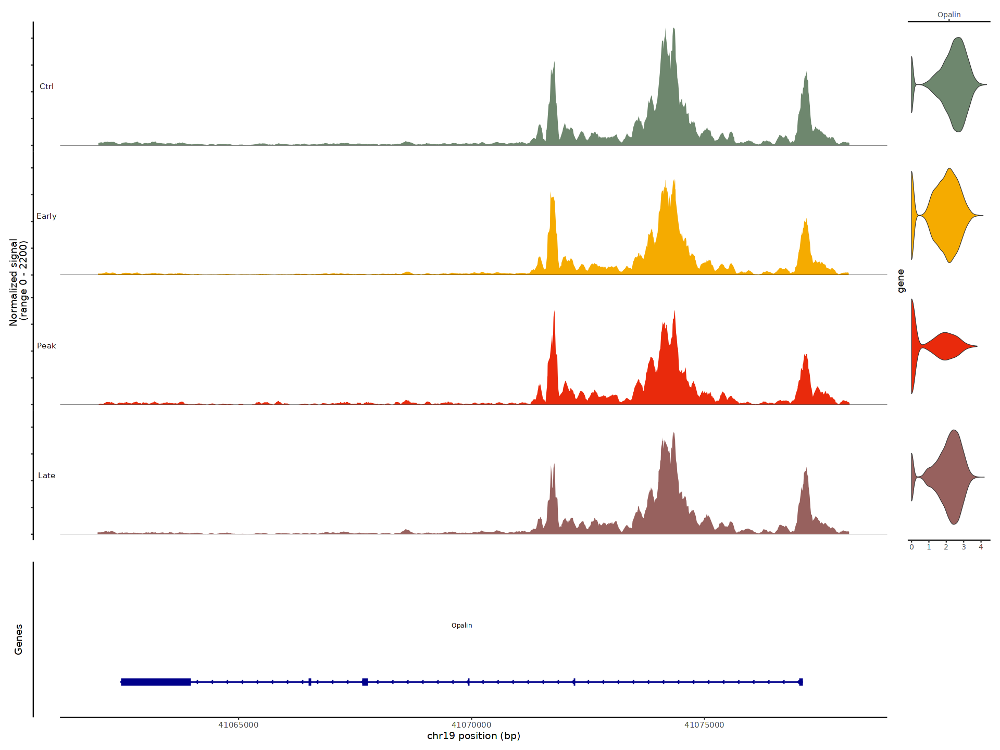

In [34]:
gene_marker <- "Opalin"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=2200, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


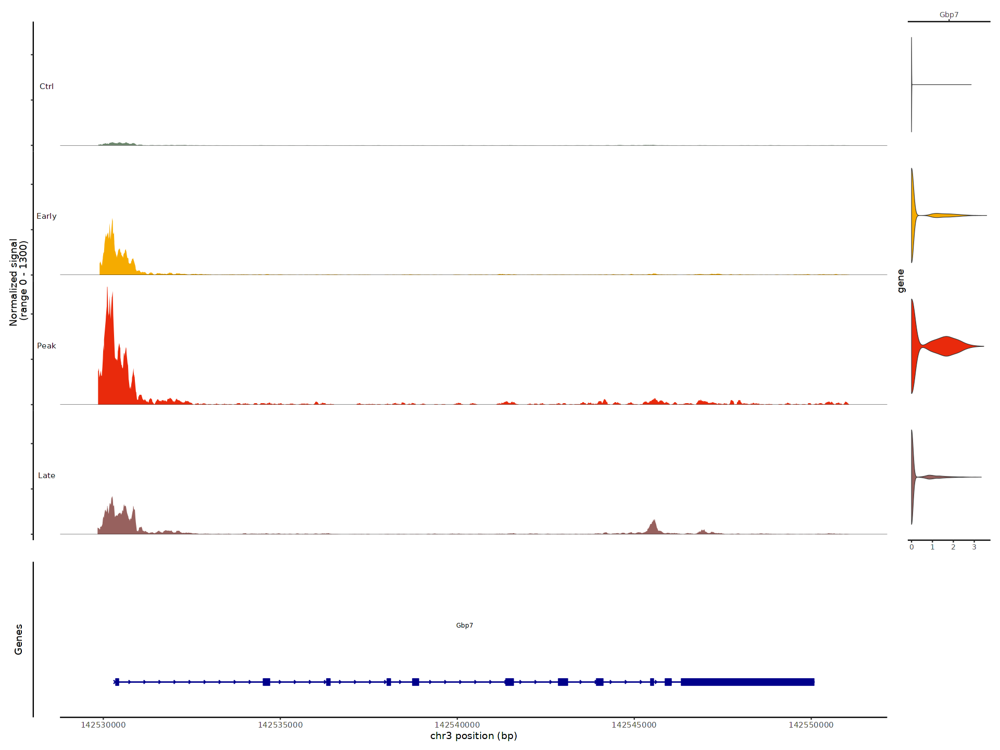

In [35]:
gene_marker <- "Gbp7"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1300, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


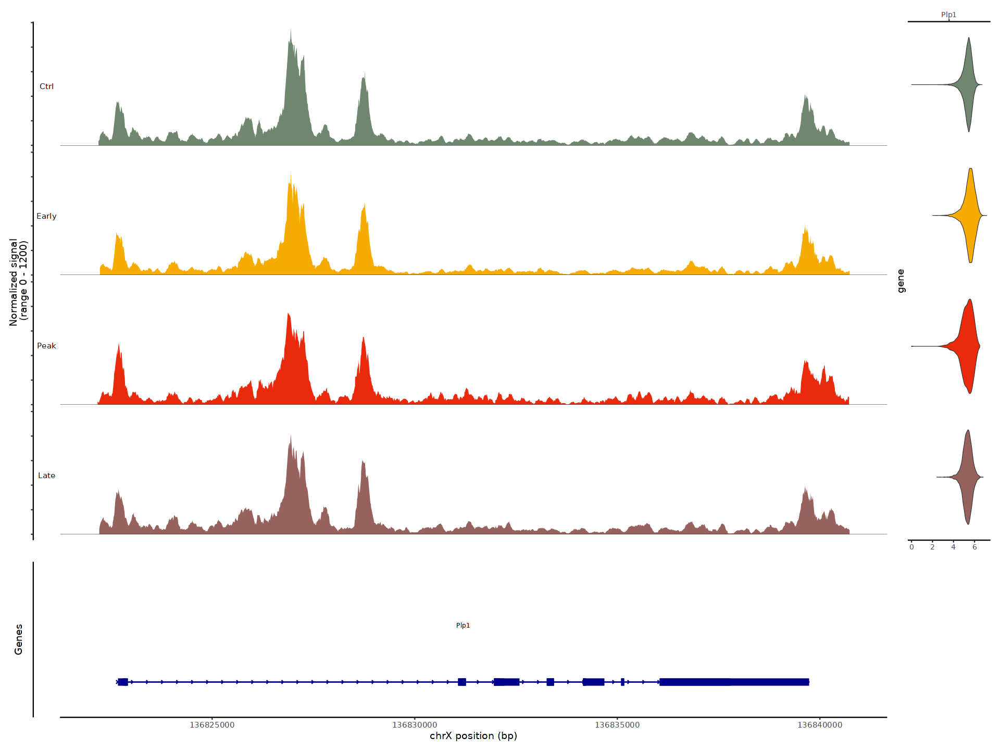

In [22]:
gene_marker <- "Plp1"
CoveragePlot(tmp_cluster, region = gene_marker, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 186 rows containing missing values (`geom_segment()`)."
Warning message:
"Removed 1 rows containing missing values (`geom_segment()`)."


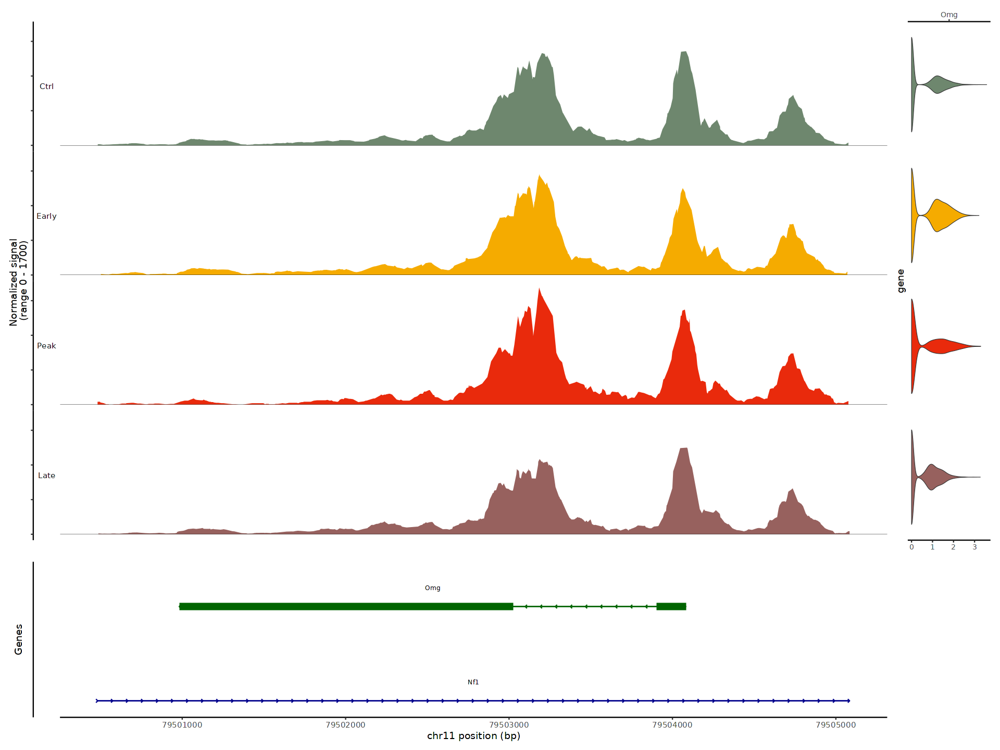

In [23]:
gene_marker <- "Omg"
CoveragePlot(tmp_cluster, region = gene_marker, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


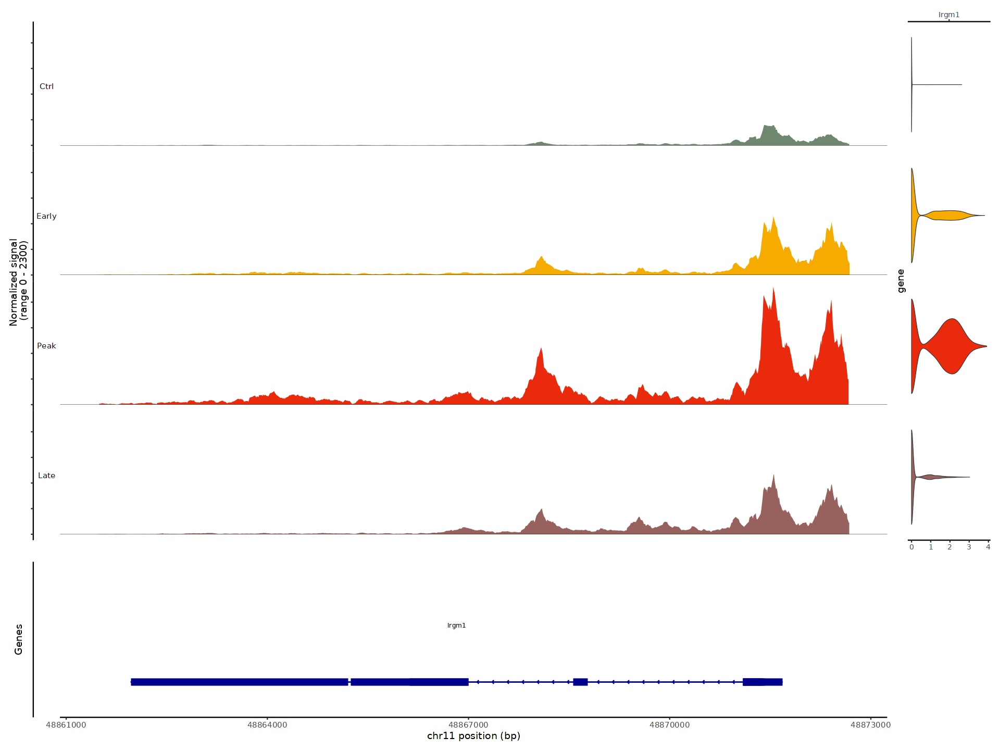

In [36]:
gene_marker <- "Irgm1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=2300, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 3 rows containing missing values (`geom_segment()`)."


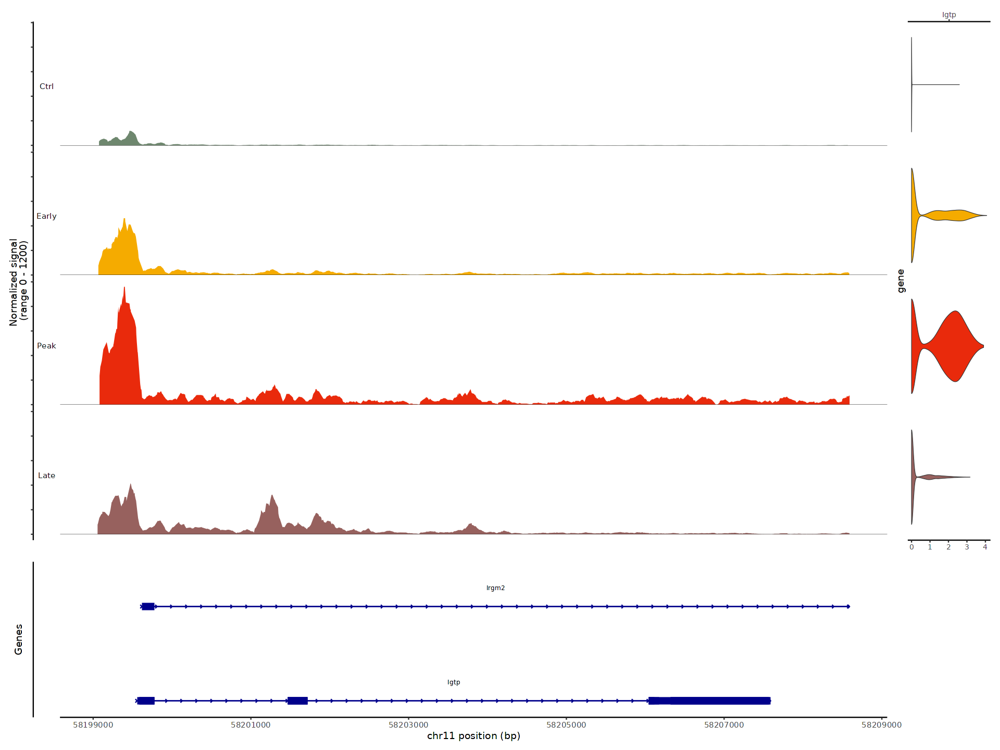

In [37]:
gene_marker <- "Igtp"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1200, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


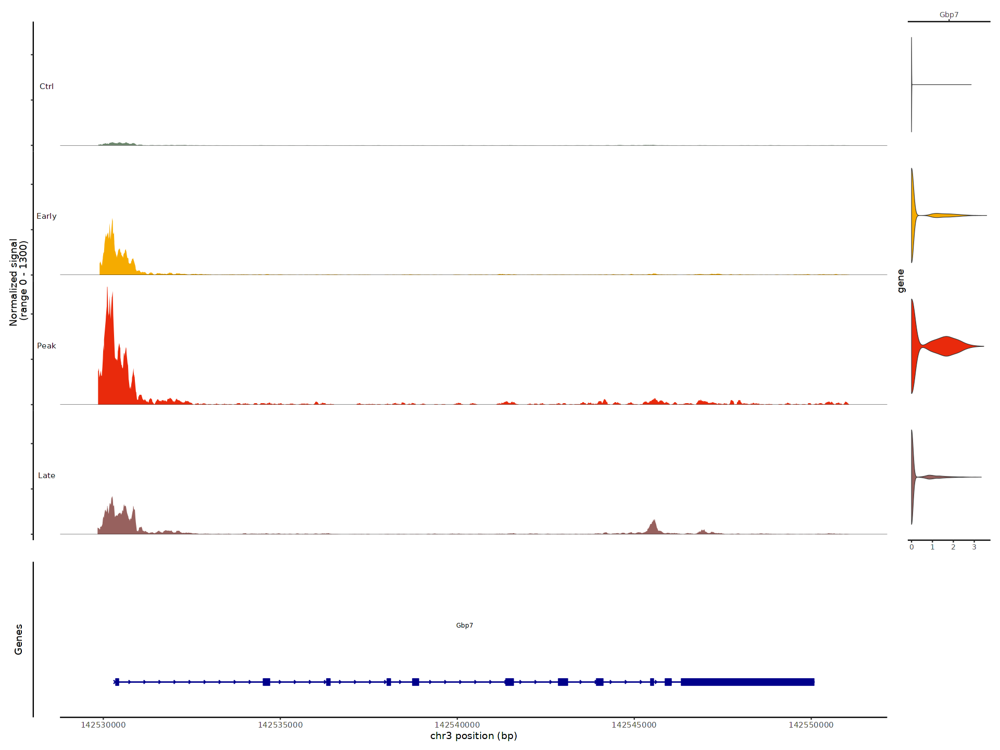

In [38]:
gene_marker <- "Gbp7"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1300, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 36 rows containing missing values (`geom_segment()`)."


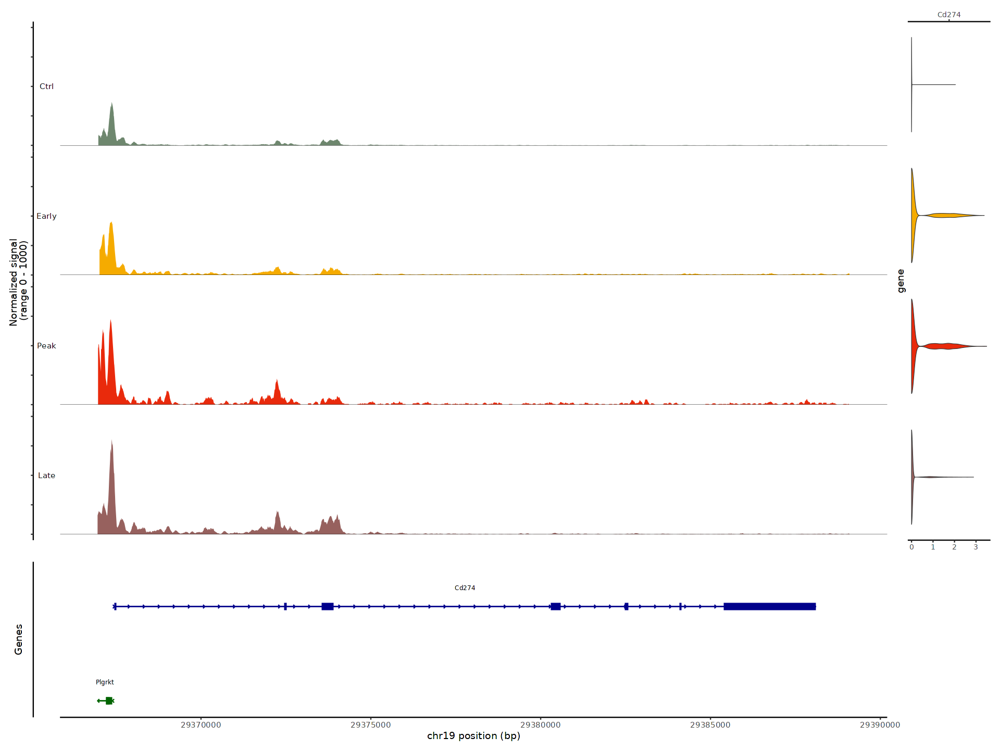

In [39]:
gene_marker <- "Cd274"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


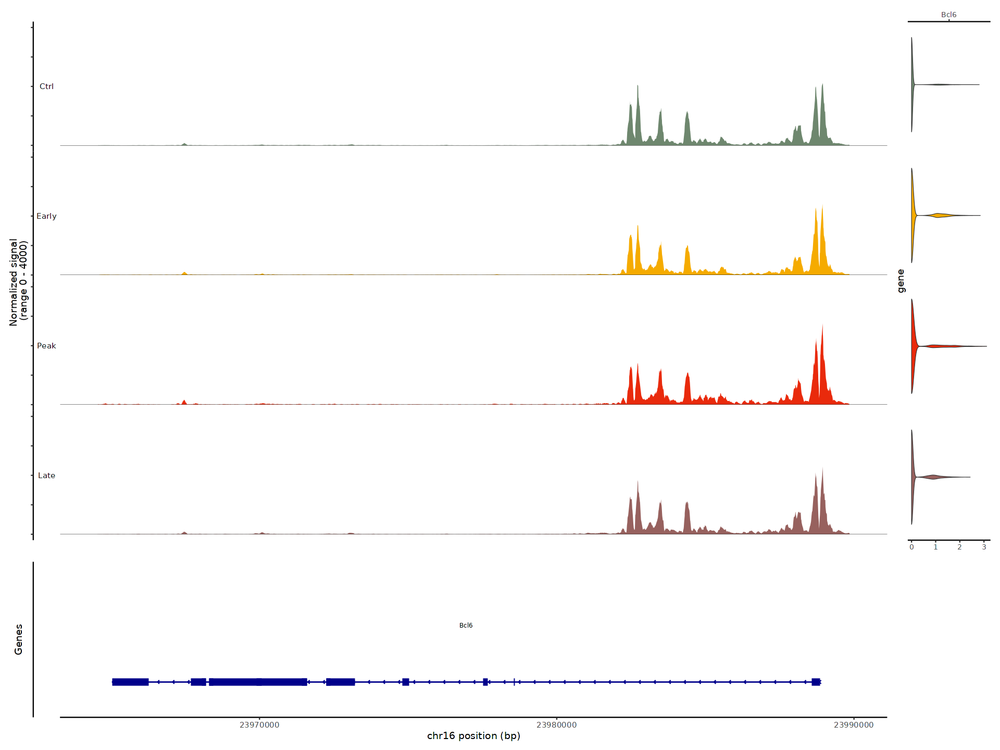

In [44]:
gene_marker <- "Bcl6"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=4000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 73 rows containing missing values (`geom_segment()`)."


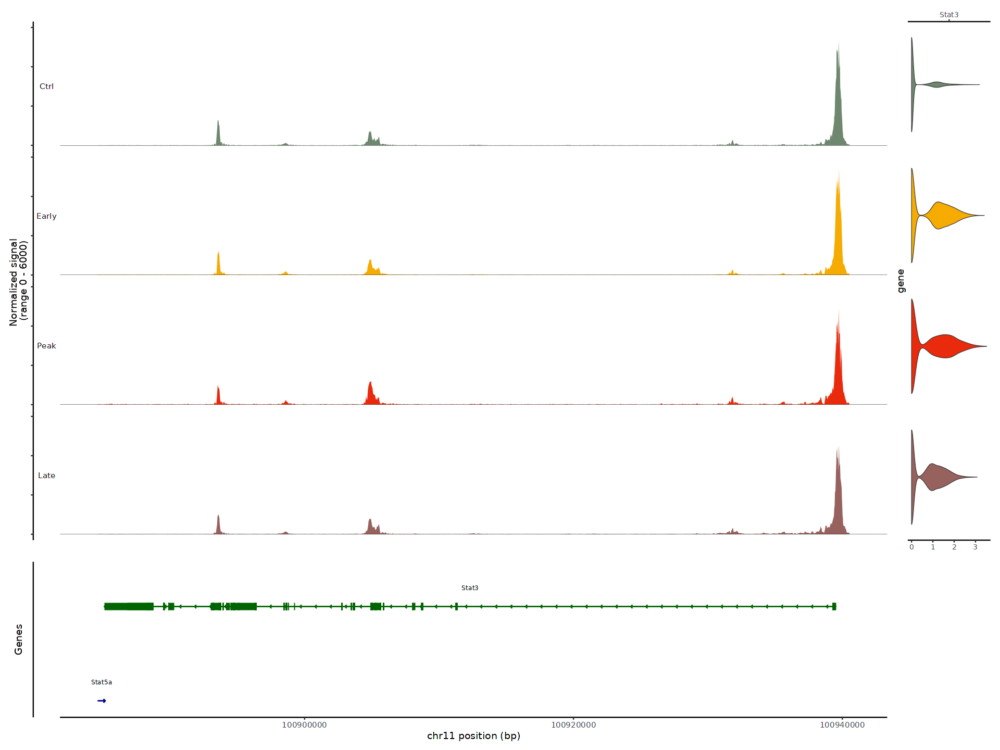

In [45]:
gene_marker <- "Stat3"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=6000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


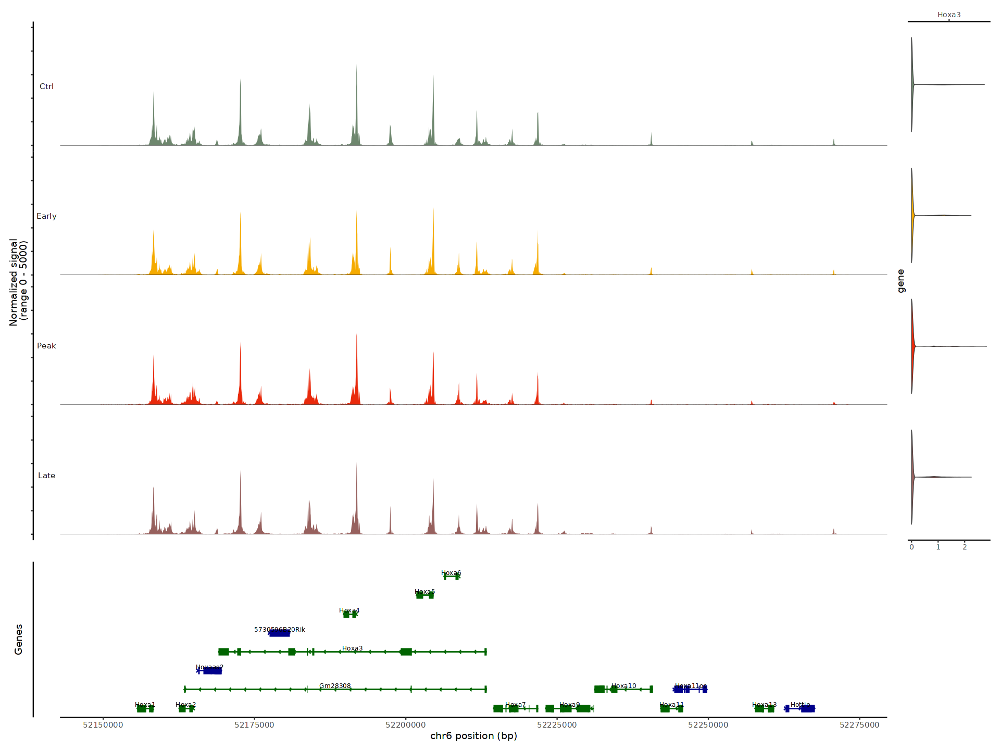

In [20]:
gene_marker <- "Hoxa3"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=5000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 20000, extend.downstream = 60000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 3 rows containing missing values (`geom_segment()`)."


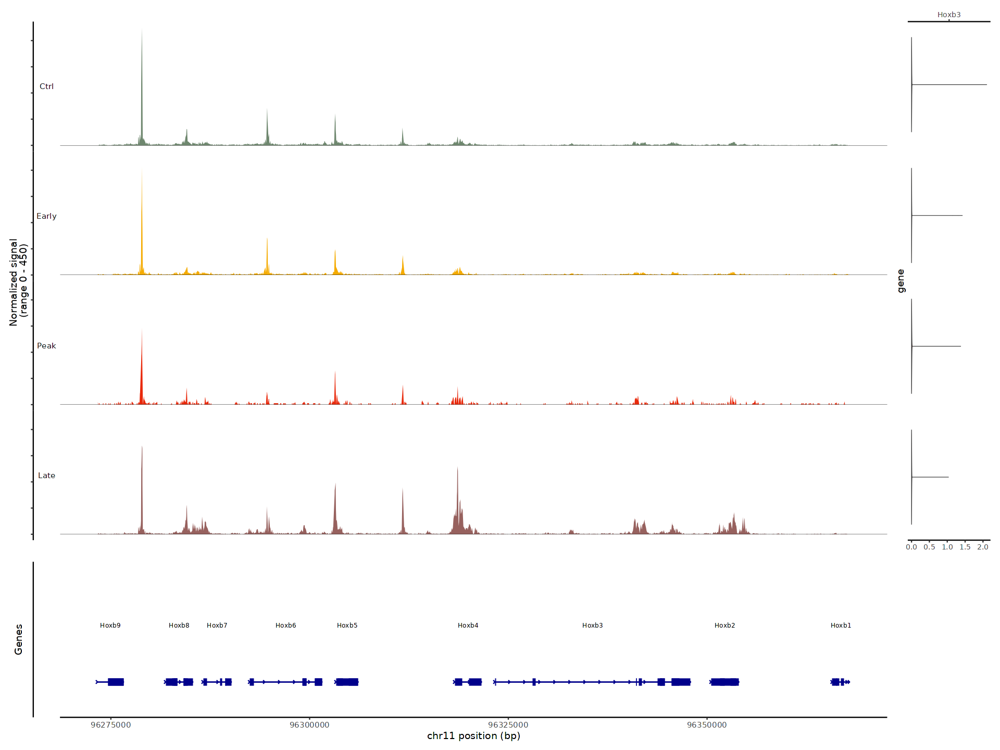

In [39]:
gene_marker <- "Hoxb3"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=450, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 50000, extend.downstream = 20000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


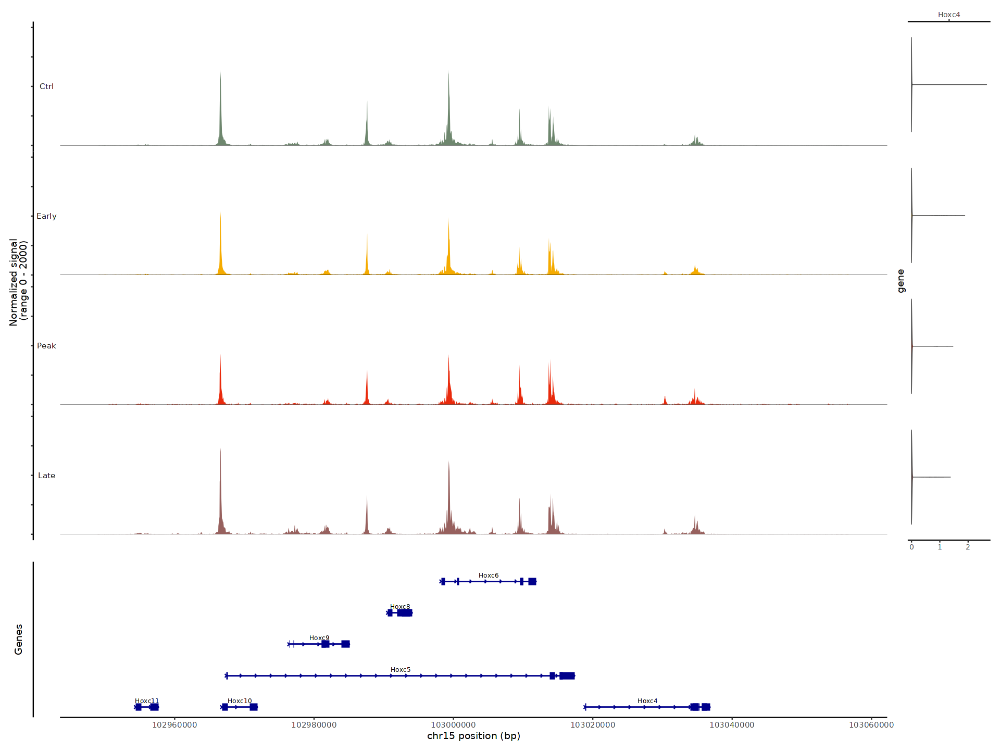

In [24]:
gene_marker <- "Hoxc4"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=2000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 70000, extend.downstream = 20000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


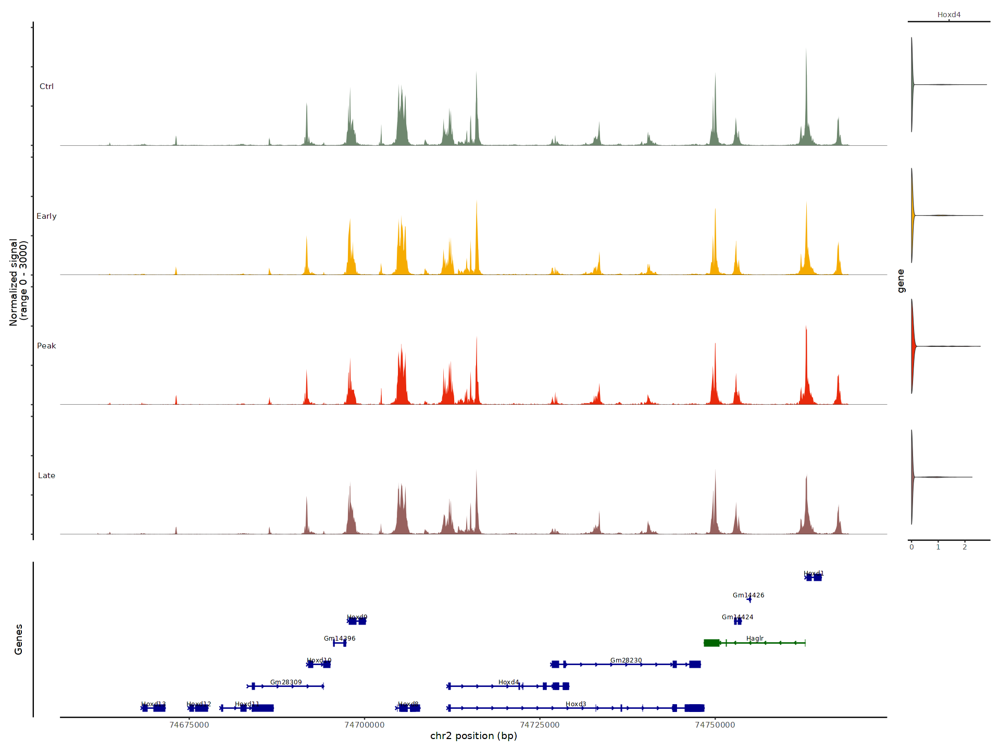

In [26]:
gene_marker <- "Hoxd4"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=3000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 50000, extend.downstream = 40000) & scale_fill_manual(values = orig.ident_merge_colors)

#### 4.1.2 MOL2

In [27]:
cluster_choice = "MOL2"

In [28]:
tmp_cluster <- subset(MORNAATACCOL, subset = cellType_OL_merge == cluster_choice)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ol_ to umappeaksol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ol_ to umapbimodol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_generegchrom_ol_ to pcageneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_generegchrom_ol_ to umapgeneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_dorcs_ol_ to pcadorcsol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_dorcs_ol_ to umapdorcsol_"


In [29]:
DefaultAssay(tmp_cluster) <- "peaks"

In [30]:
Idents(tmp_cluster) <- "orig.ident_merge"

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


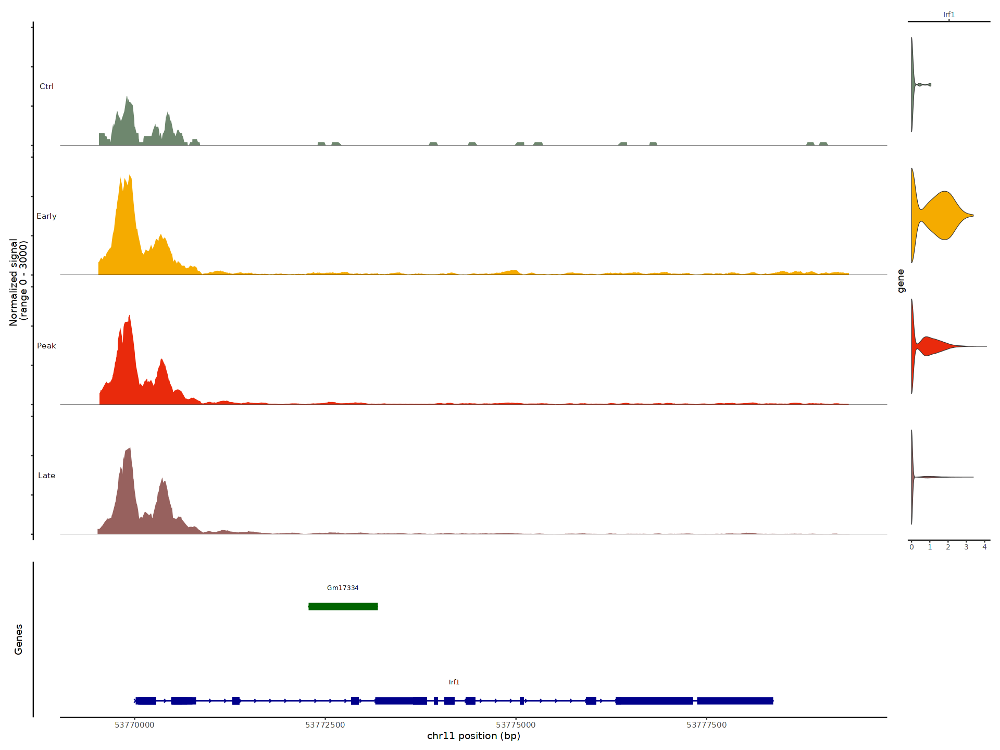

In [24]:
gene_marker <- "Irf1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=3000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


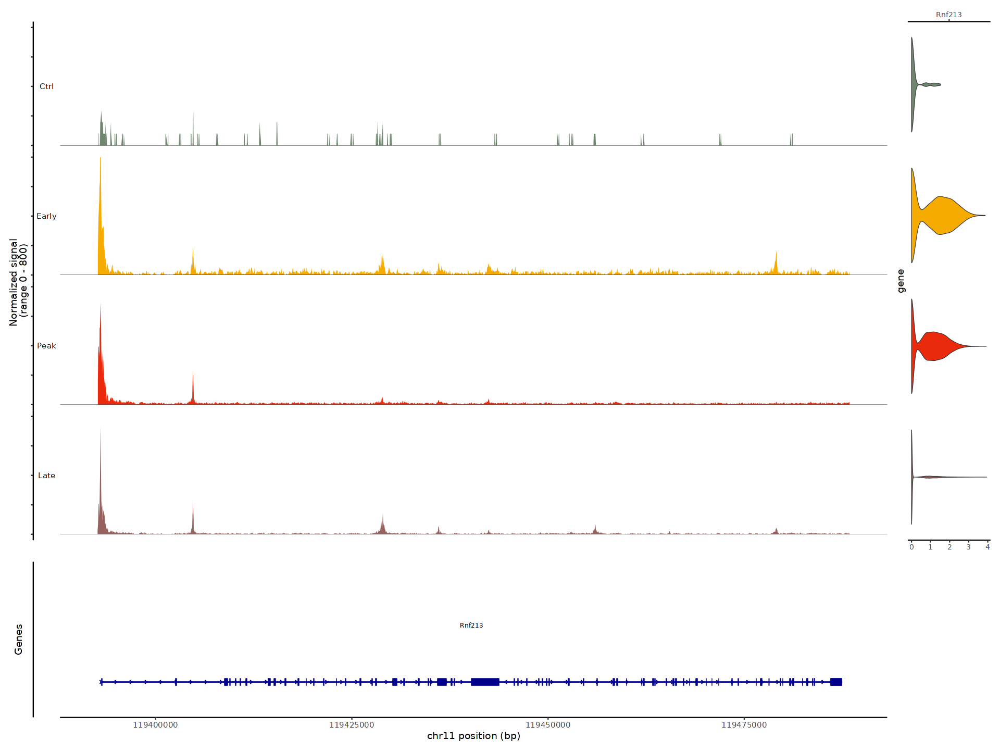

In [25]:
gene_marker <- "Rnf213"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=800, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


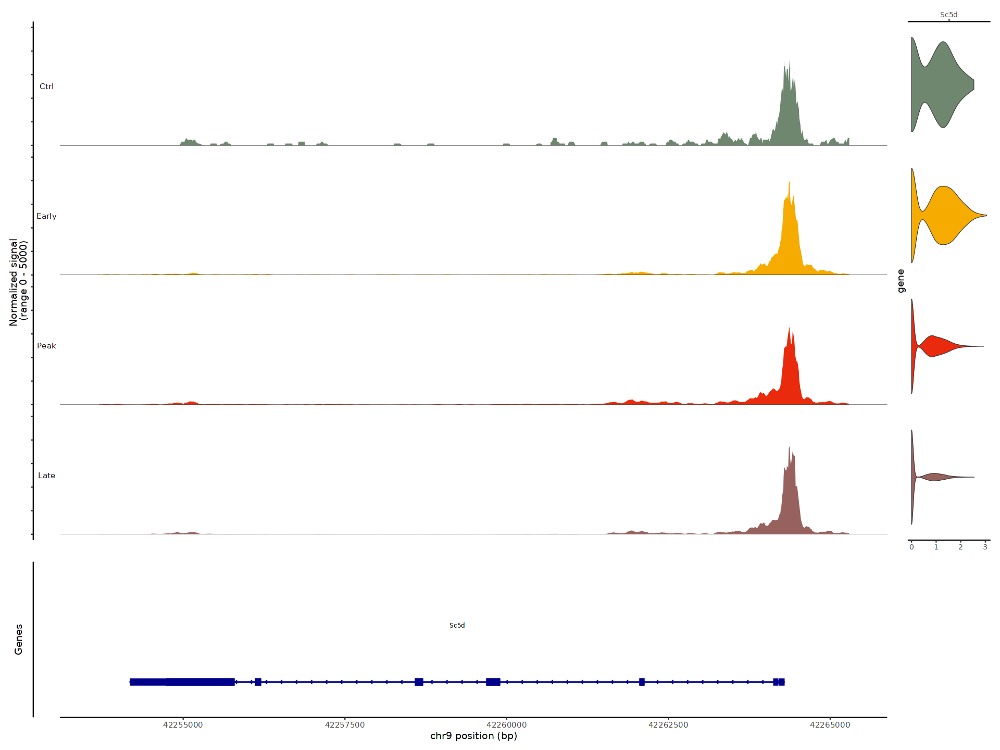

In [37]:
gene_marker <- "Sc5d"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=5000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 5 rows containing missing values (`geom_segment()`)."


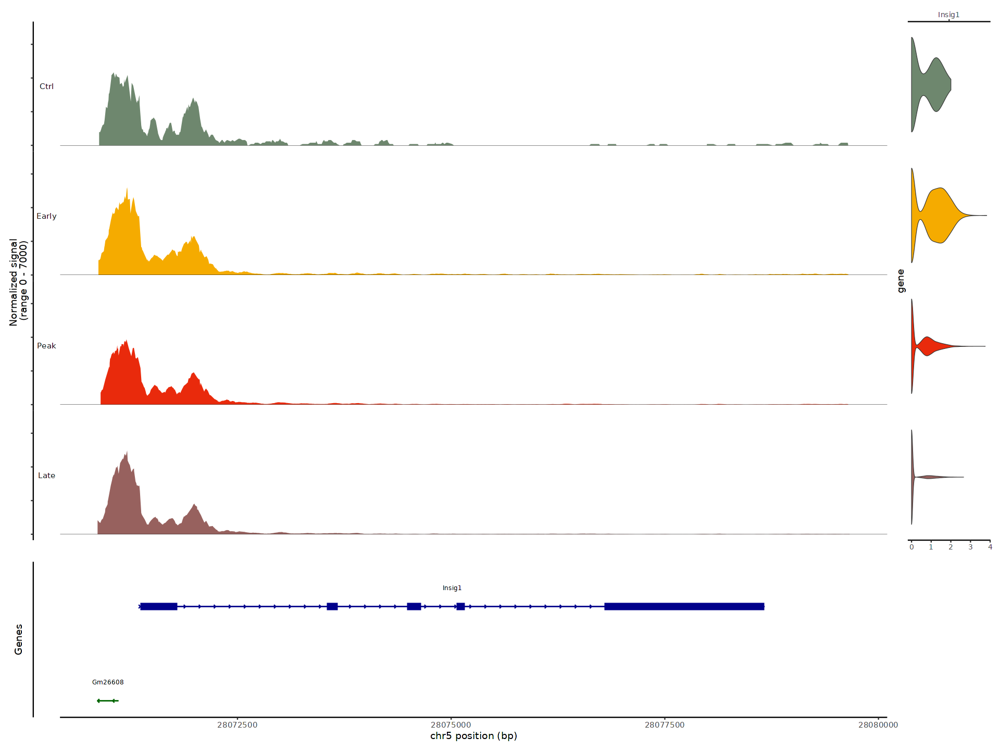

In [38]:
gene_marker <- "Insig1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=7000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


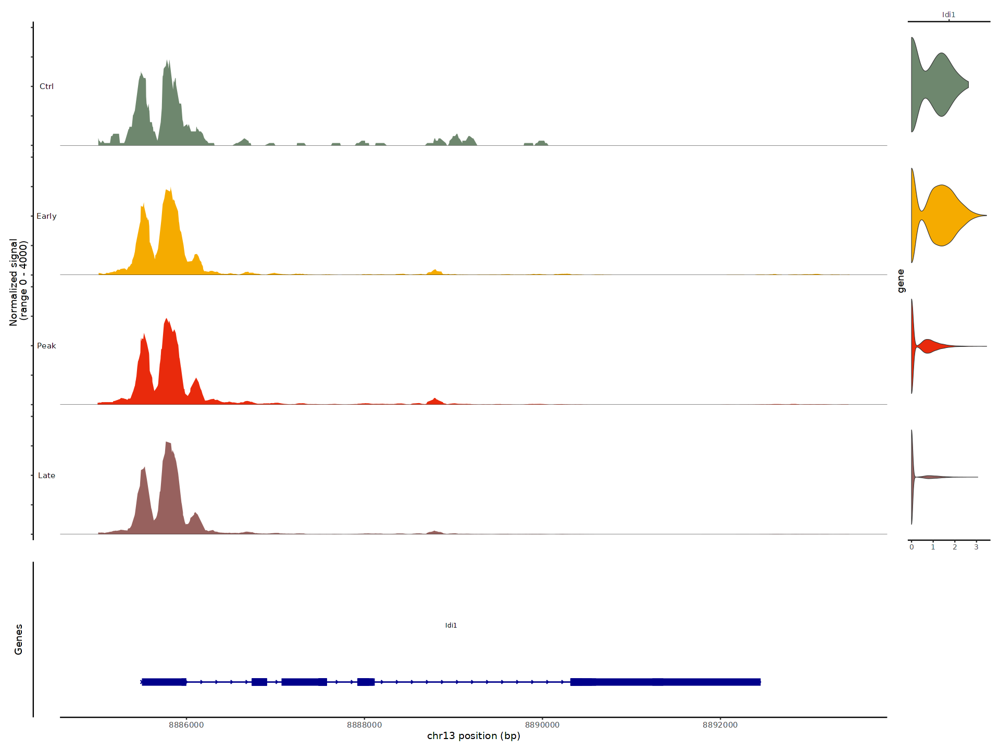

In [39]:
gene_marker <- "Idi1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=4000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


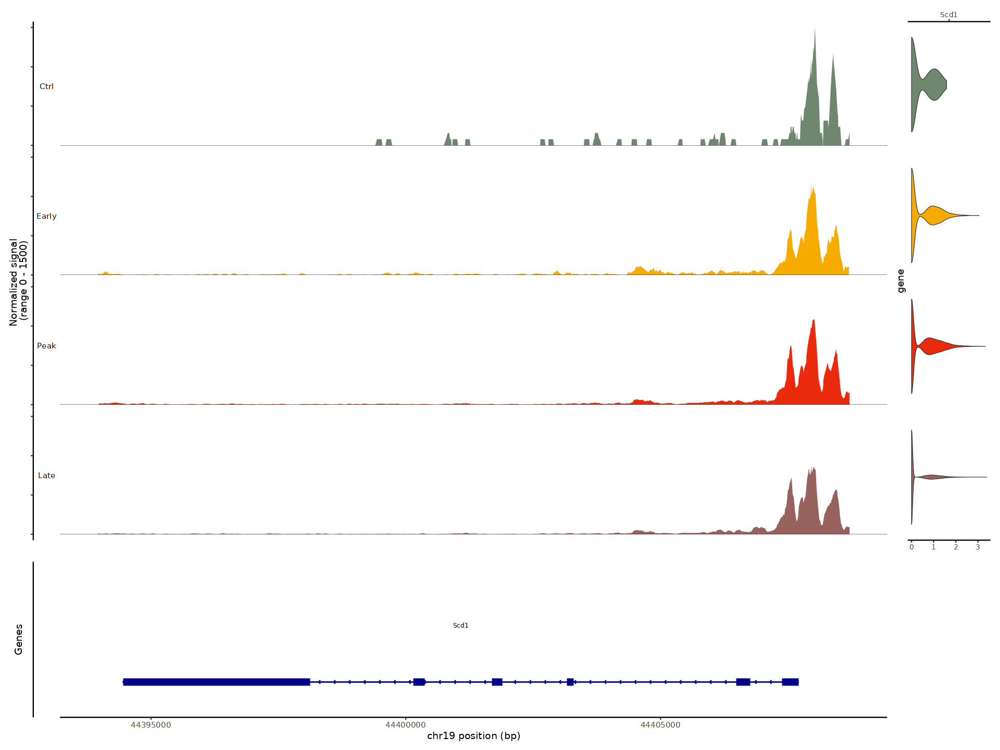

In [40]:
gene_marker <- "Scd1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1500, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


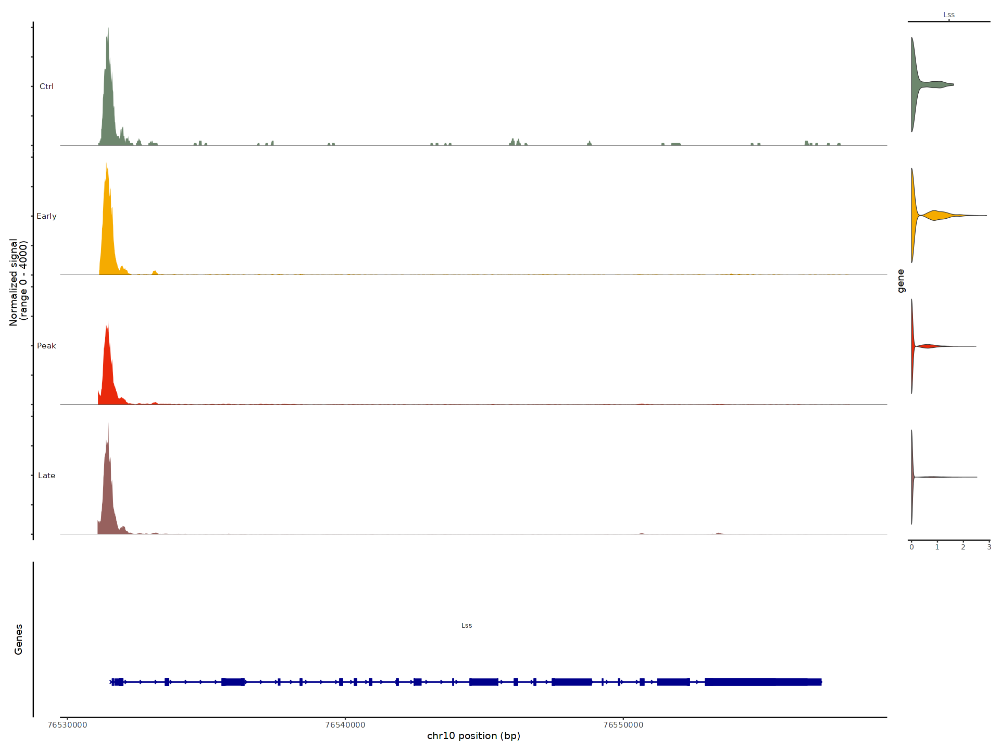

In [41]:
gene_marker <- "Lss"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=4000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


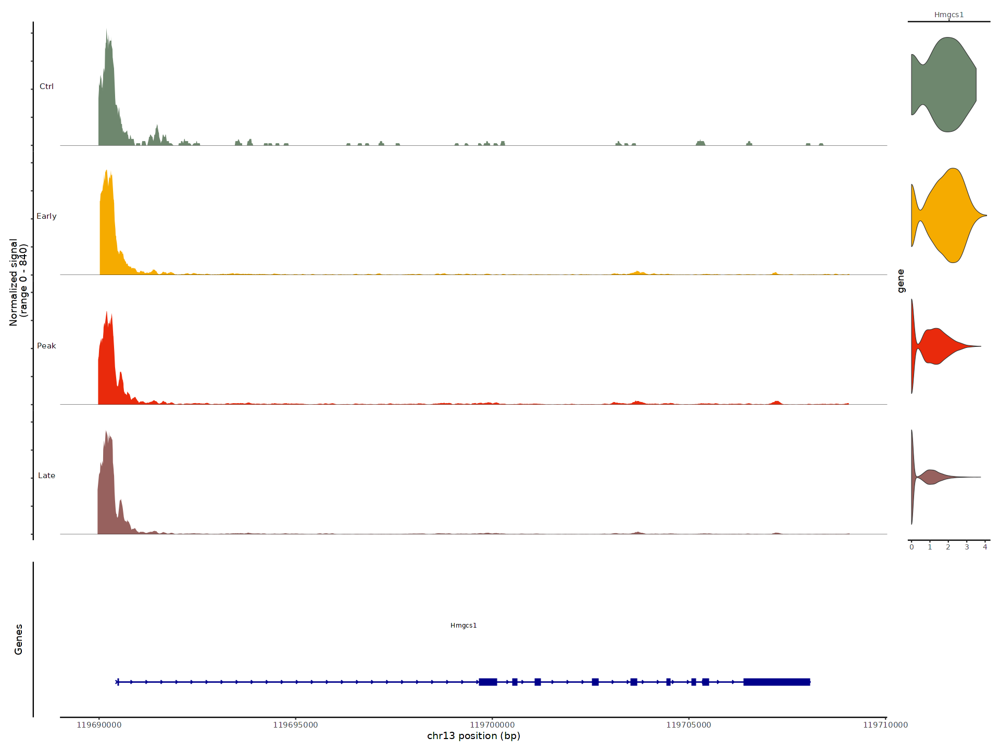

In [44]:
gene_marker <- "Hmgcs1"
CoveragePlot(tmp_cluster, region = gene_marker, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


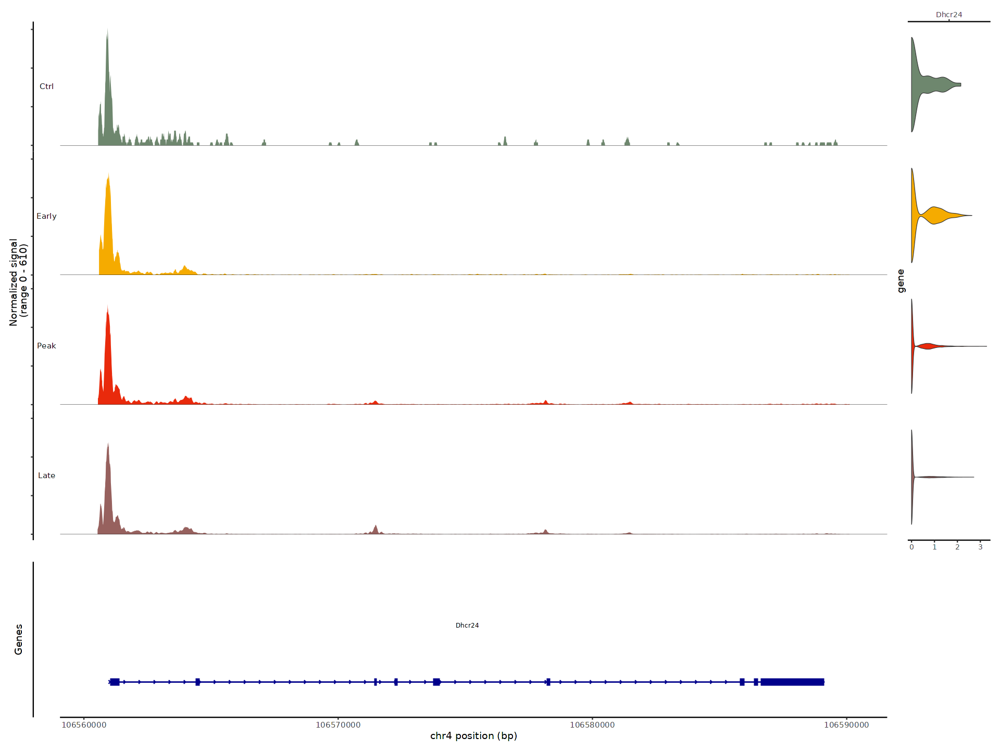

In [45]:
gene_marker <- "Dhcr24"
CoveragePlot(tmp_cluster, region = gene_marker, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 10 rows containing missing values (`geom_segment()`)."


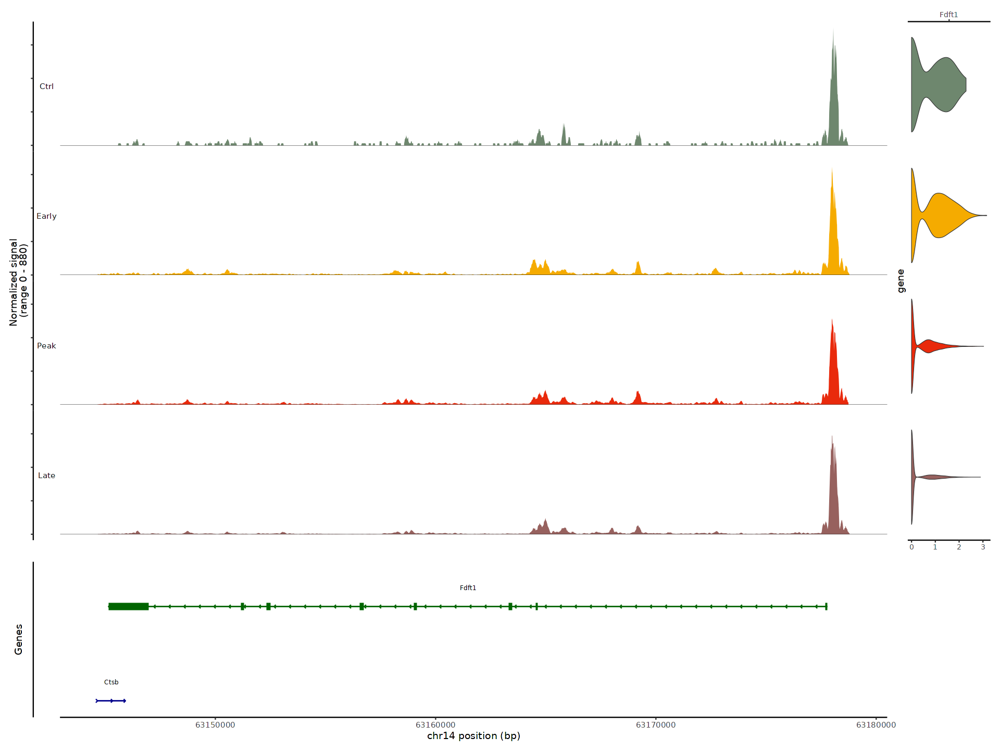

In [46]:
gene_marker <- "Fdft1"
CoveragePlot(tmp_cluster, region = gene_marker, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 2 rows containing missing values (`geom_segment()`)."


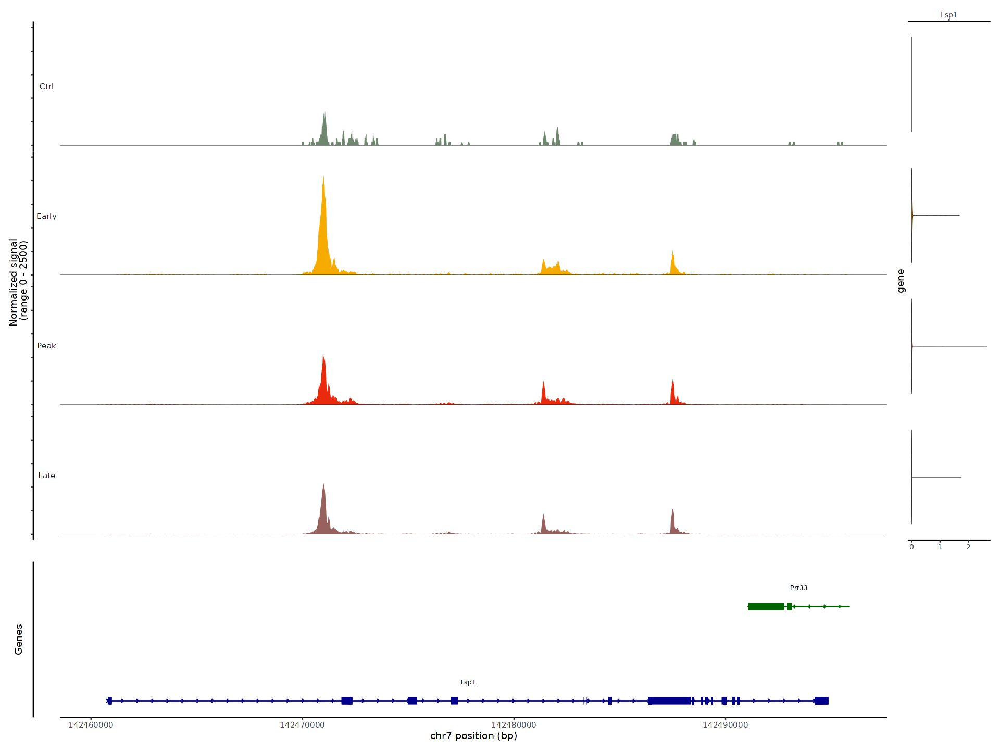

In [81]:
gene_marker <- "Lsp1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=2500, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


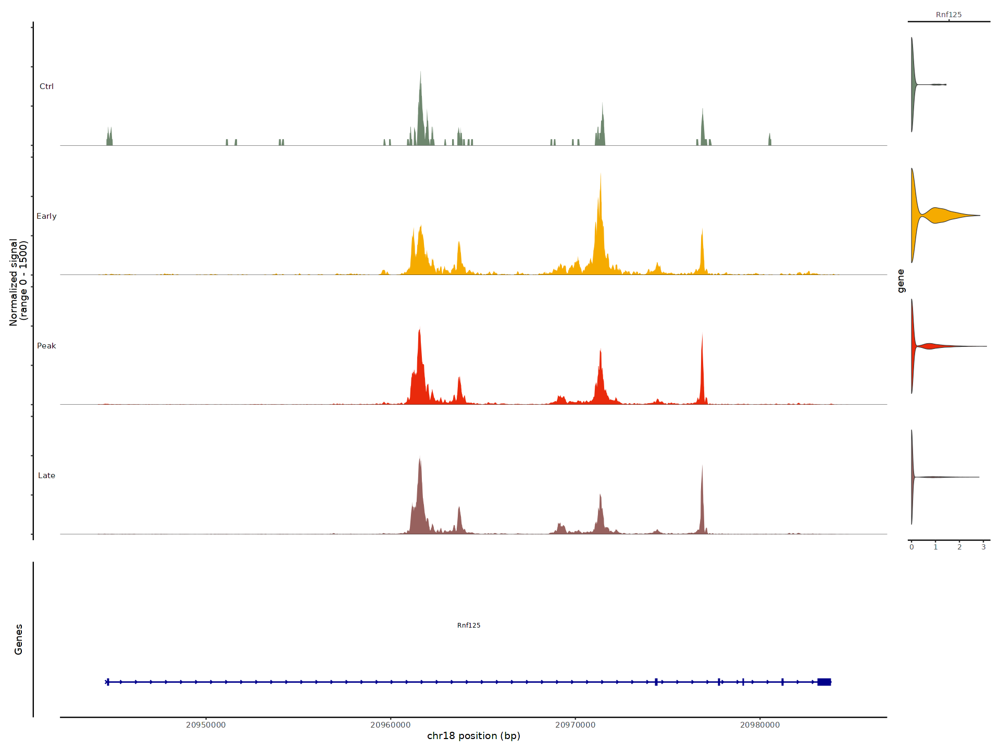

In [78]:
gene_marker <- "Rnf125"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1500, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


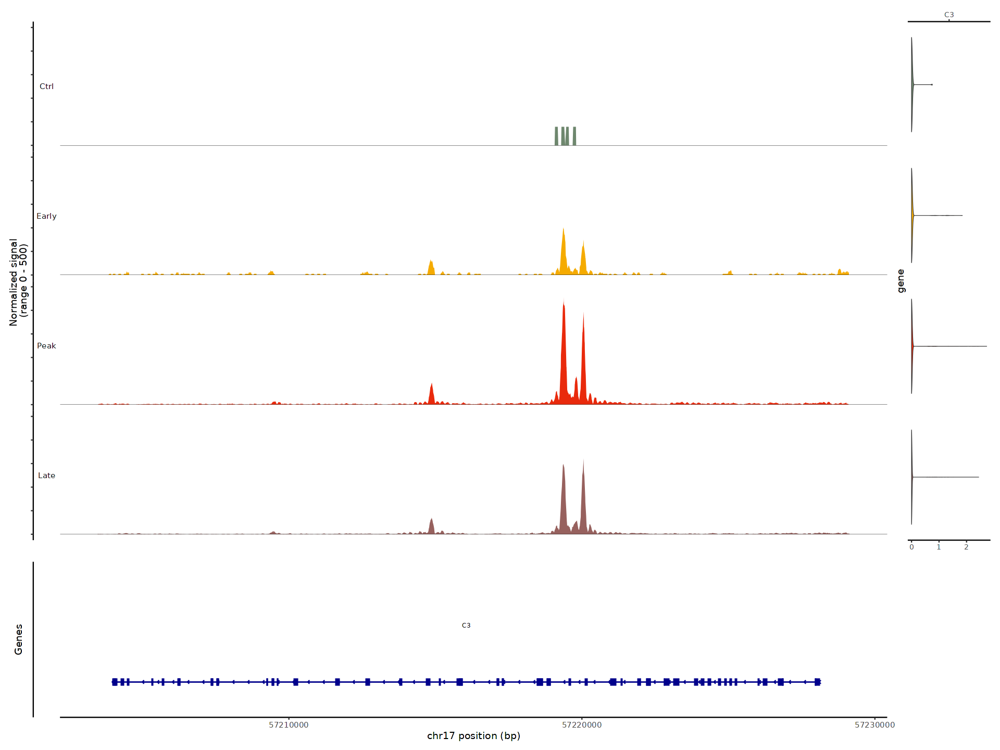

In [72]:
gene_marker <- "C3"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=500, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


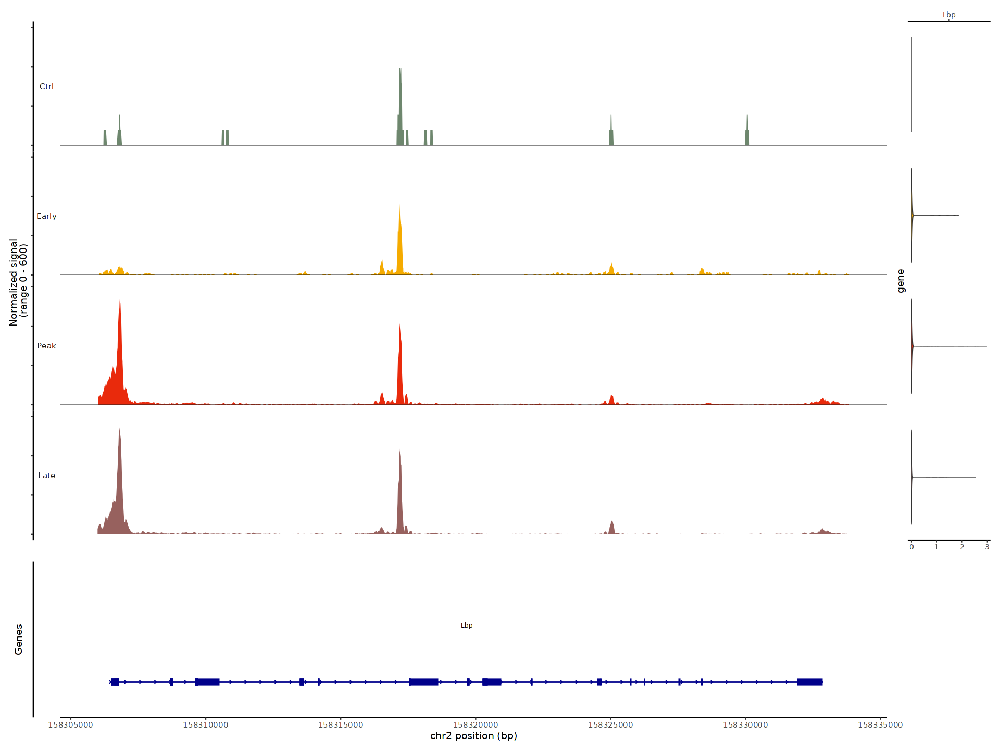

In [70]:
gene_marker <- "Lbp"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=600, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


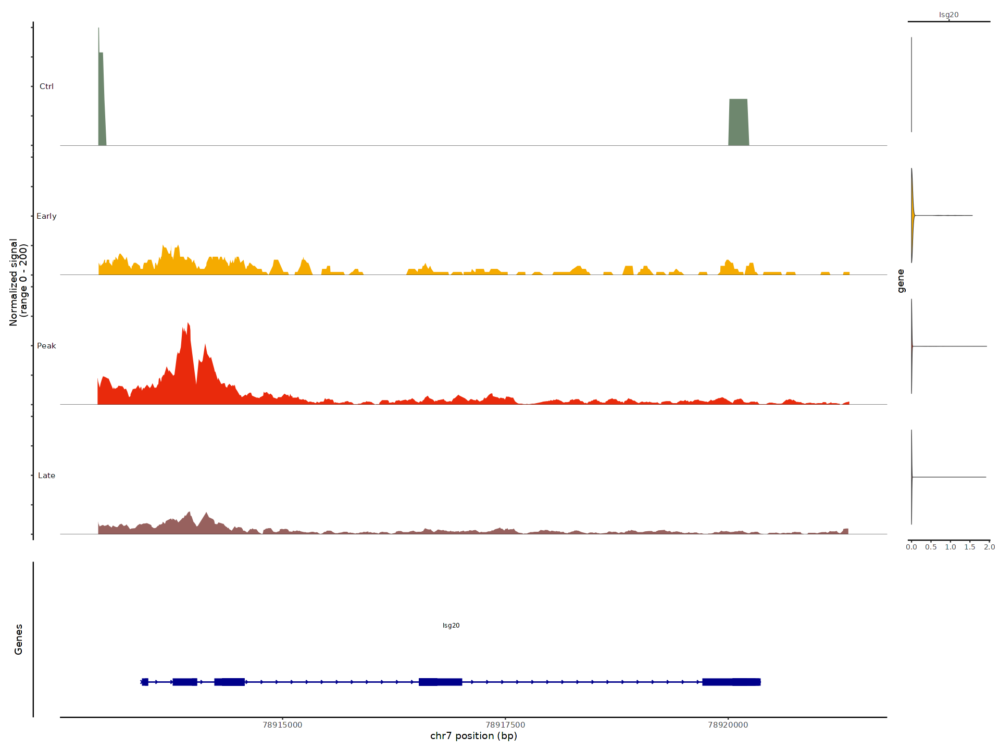

In [68]:
gene_marker <- "Isg20"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=200, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


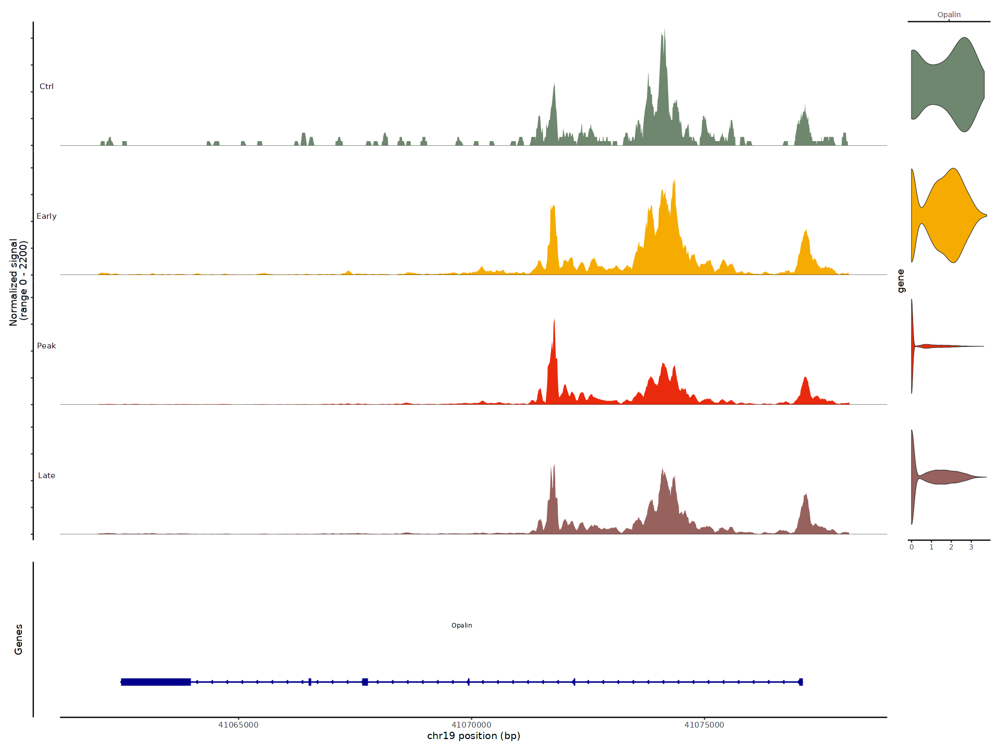

In [53]:
gene_marker <- "Opalin"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=2200, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


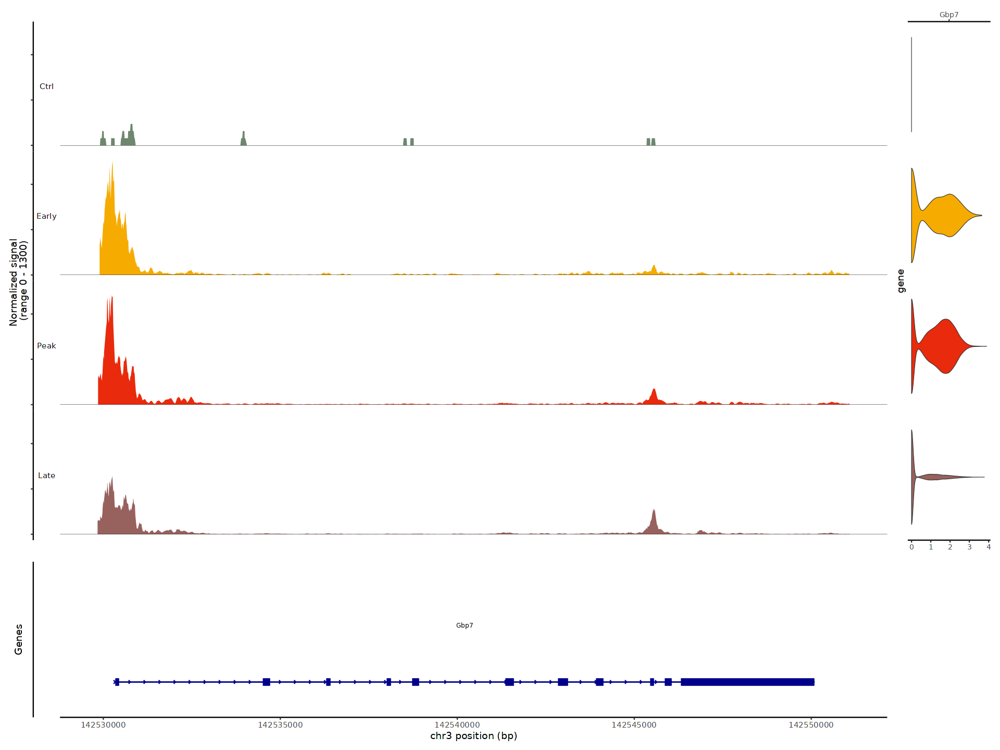

In [54]:
gene_marker <- "Gbp7"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1300, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


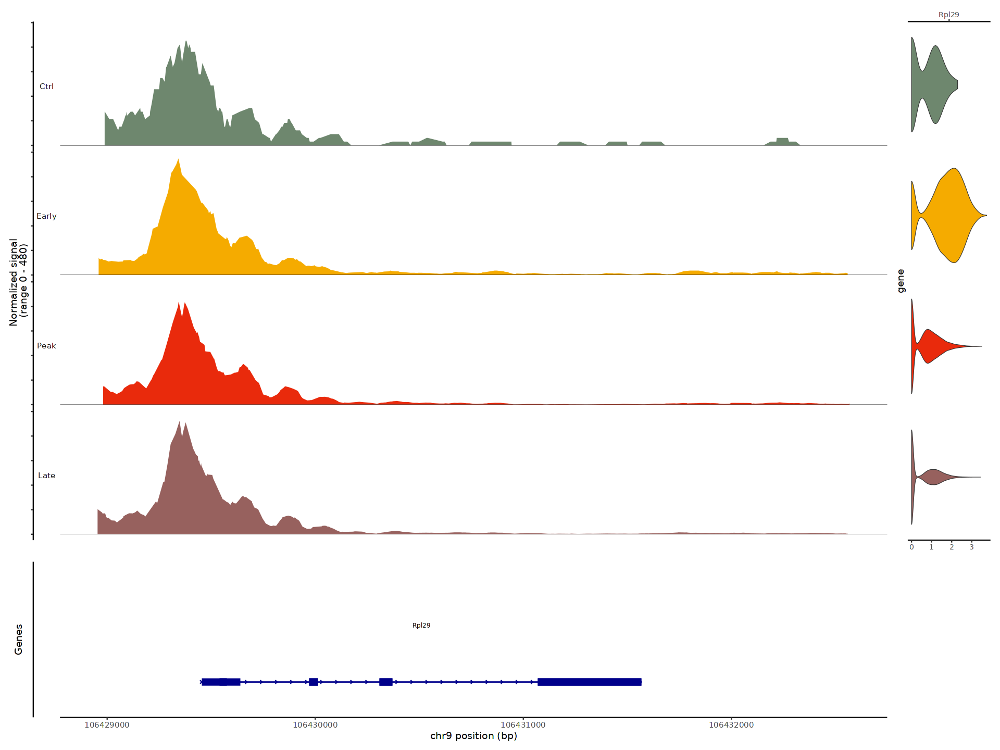

In [55]:
gene_marker <- "Rpl29"
CoveragePlot(tmp_cluster, region = gene_marker, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


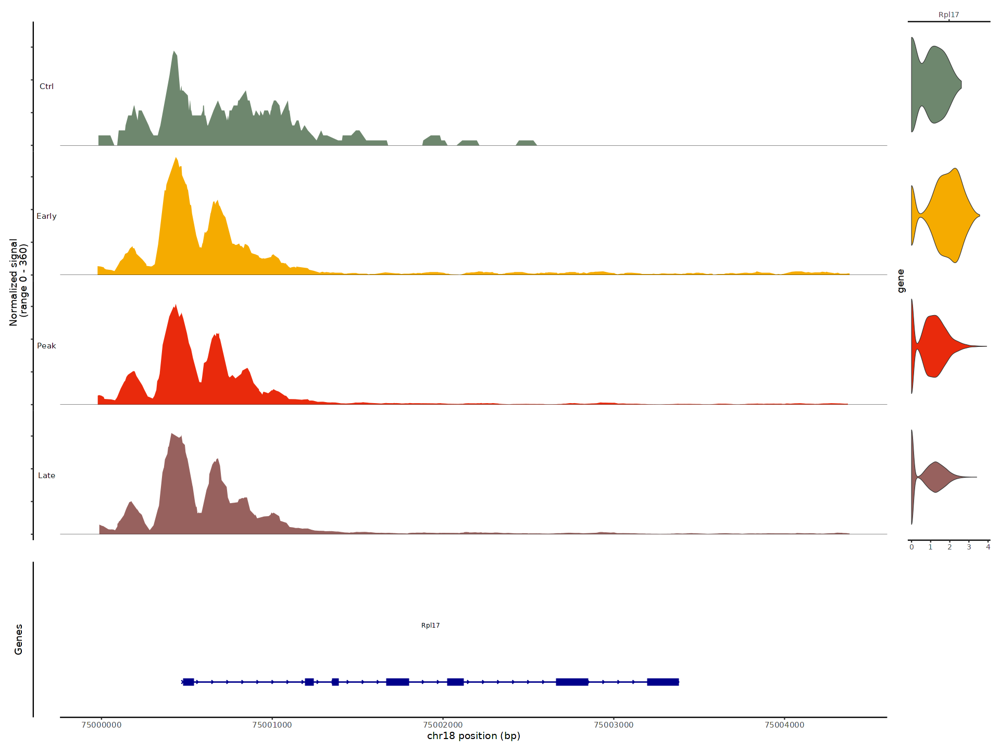

In [56]:
gene_marker <- "Rpl17"
CoveragePlot(tmp_cluster, region = gene_marker, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 2 rows containing missing values (`geom_segment()`)."


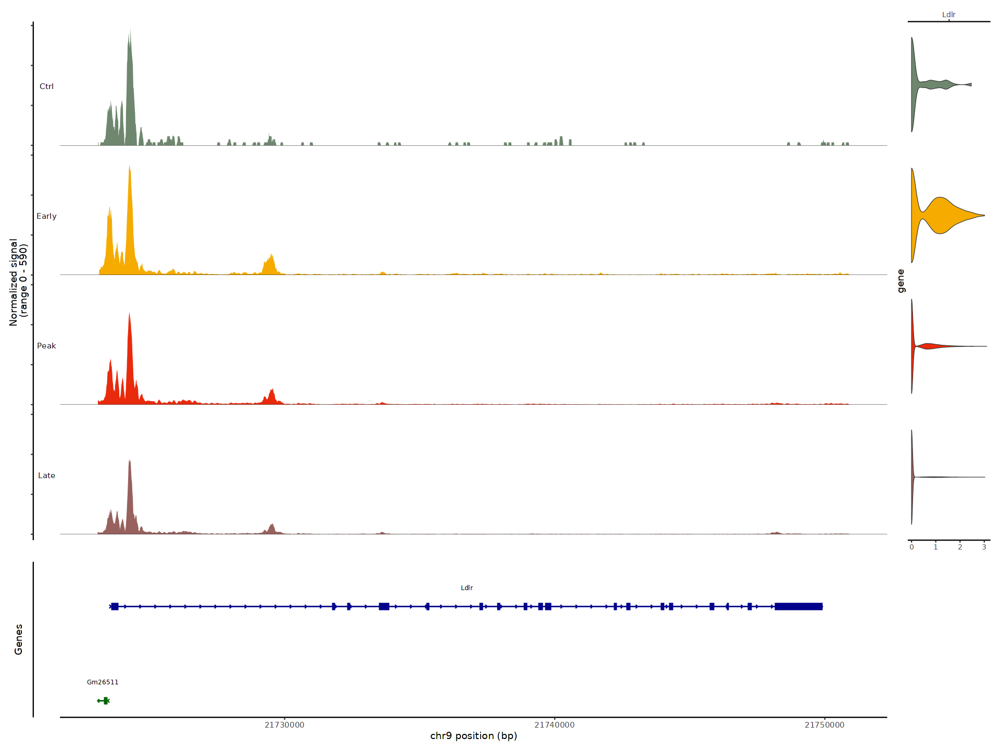

In [57]:
gene_marker <- "Ldlr"
CoveragePlot(tmp_cluster, region = gene_marker, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 9 rows containing missing values (`geom_segment()`)."


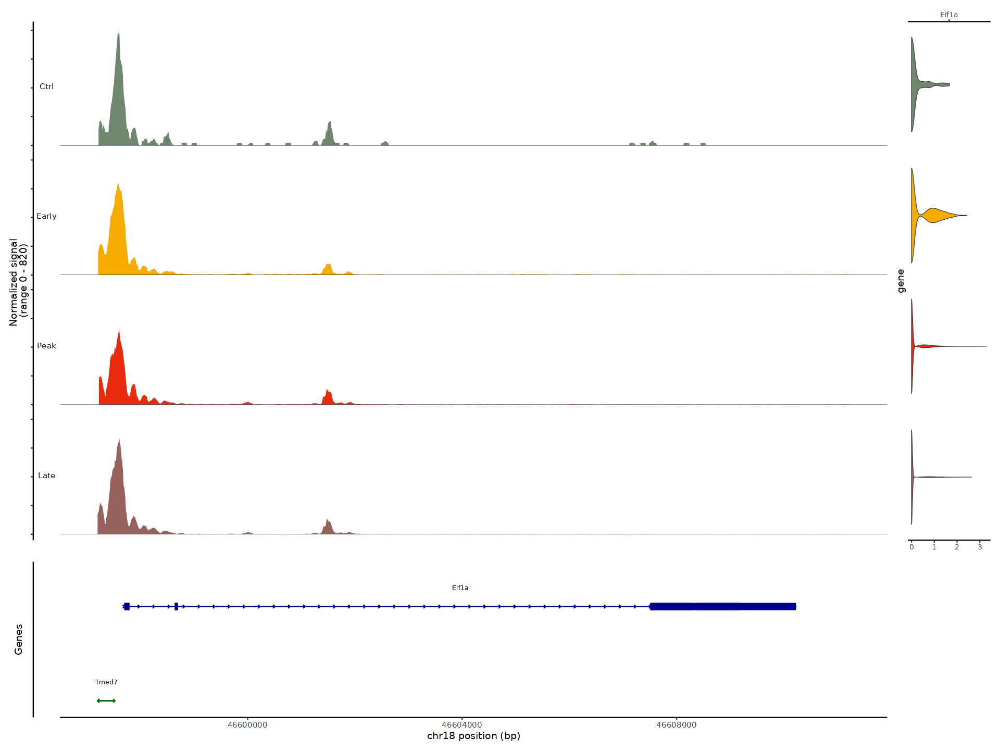

In [58]:
gene_marker <- "Eif1a"
CoveragePlot(tmp_cluster, region = gene_marker, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 36 rows containing missing values (`geom_segment()`)."


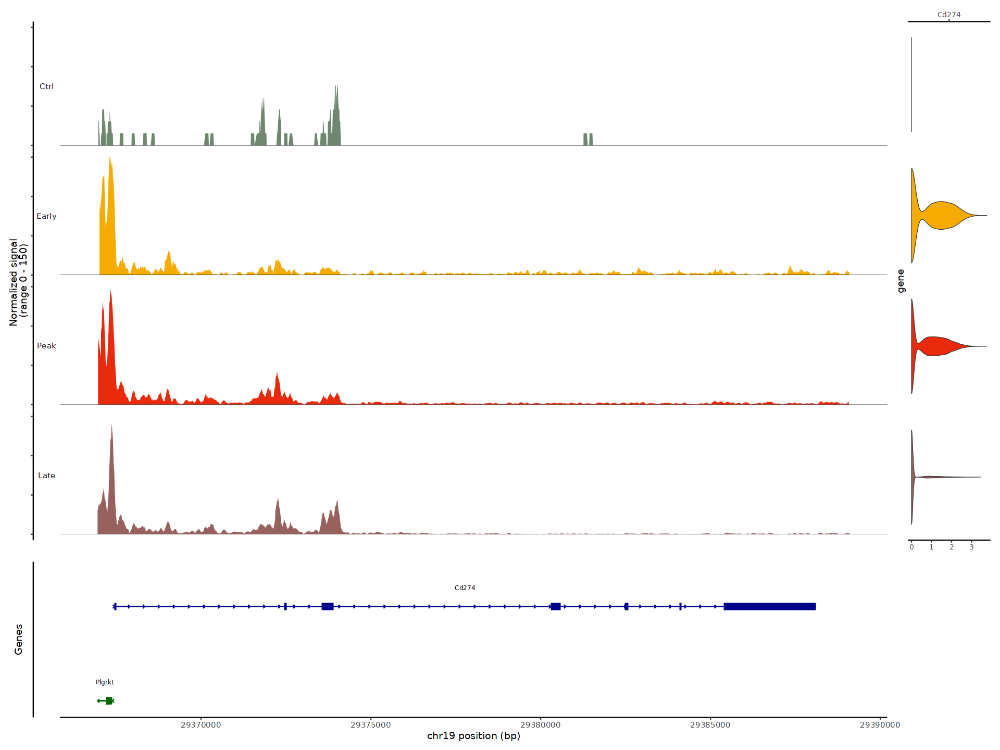

In [59]:
gene_marker <- "Cd274"
CoveragePlot(tmp_cluster, region = gene_marker, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 9 rows containing missing values (`geom_segment()`)."


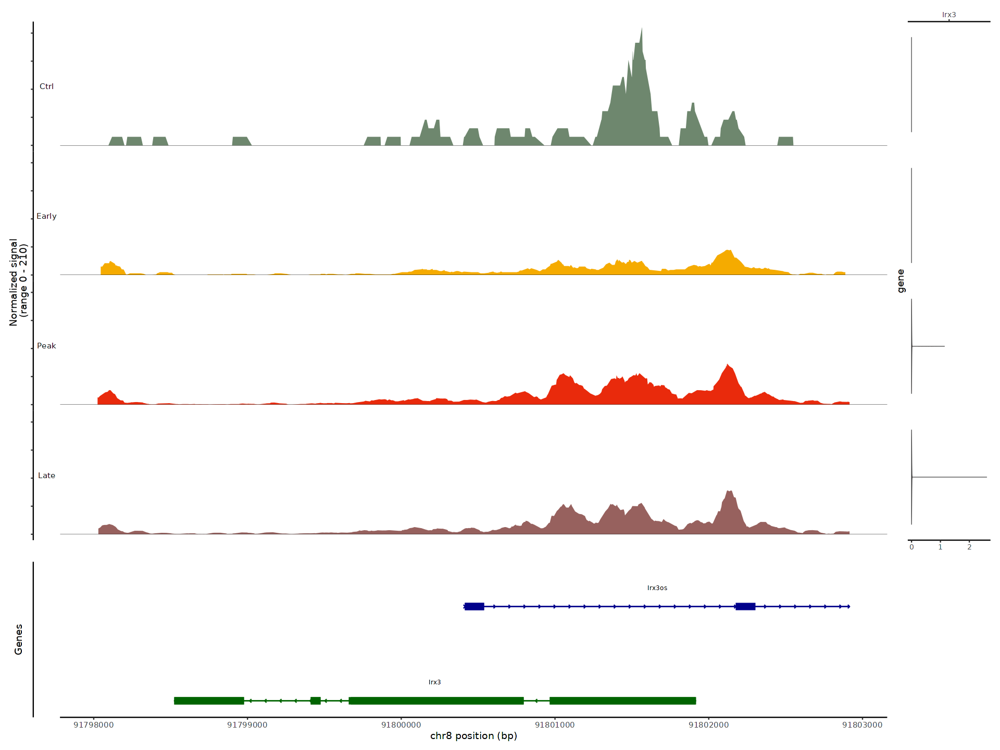

In [60]:
gene_marker <- "Irx3"
CoveragePlot(tmp_cluster, region = gene_marker, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


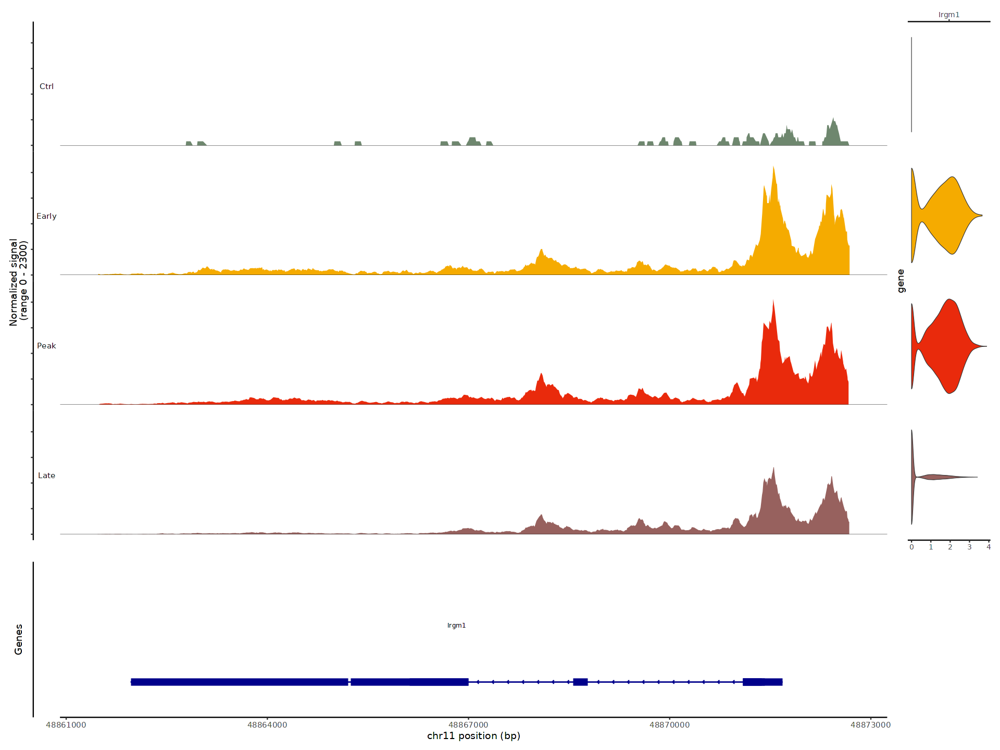

In [61]:
gene_marker <- "Irgm1"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=2300, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 3 rows containing missing values (`geom_segment()`)."


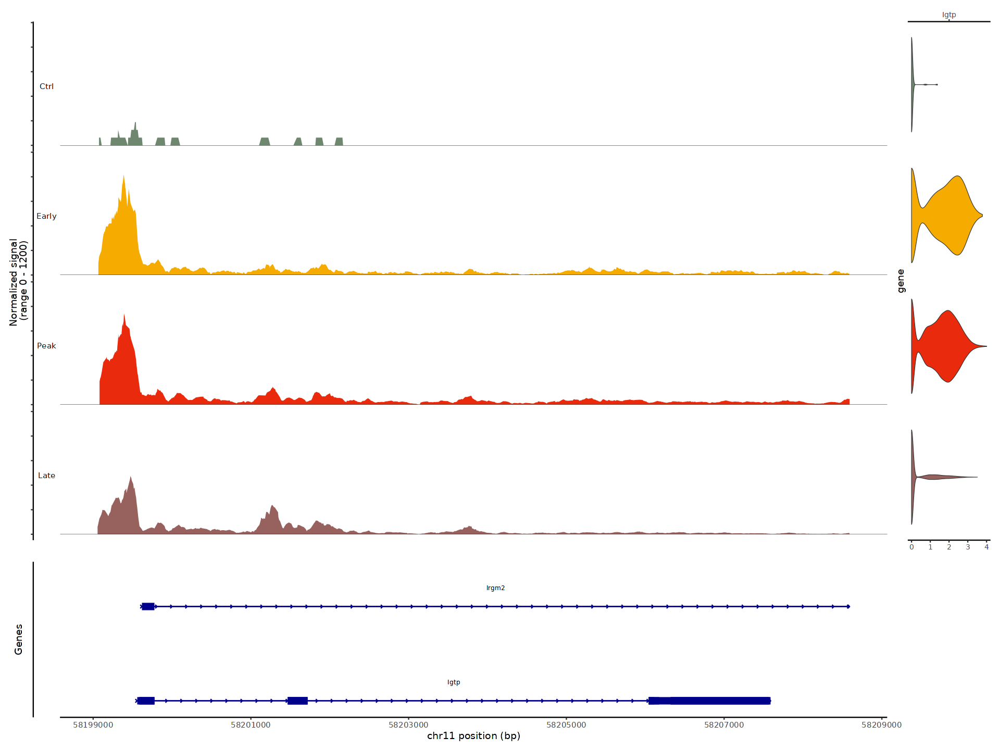

In [62]:
gene_marker <- "Igtp"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1200, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


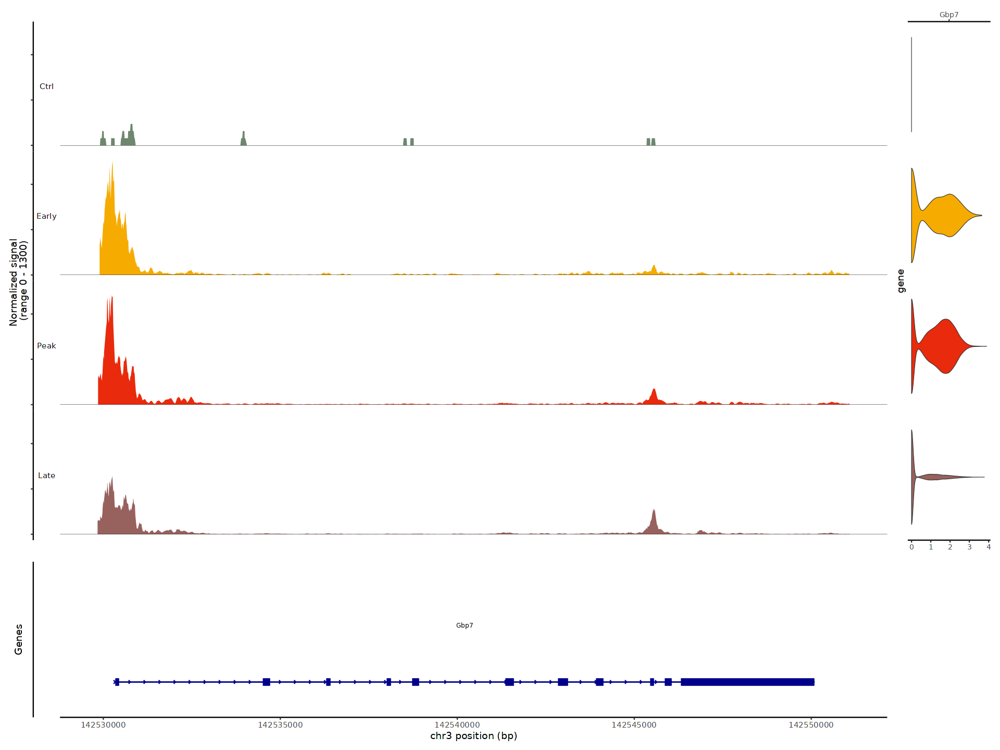

In [63]:
gene_marker <- "Gbp7"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1300, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


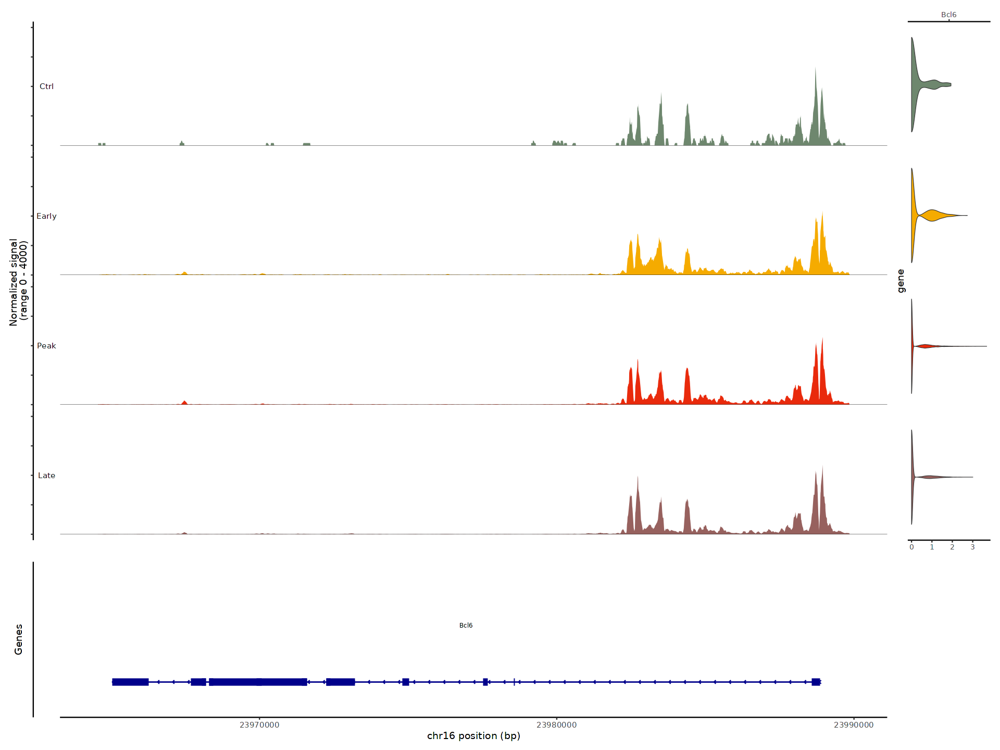

In [38]:
gene_marker <- "Bcl6"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=4000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 73 rows containing missing values (`geom_segment()`)."


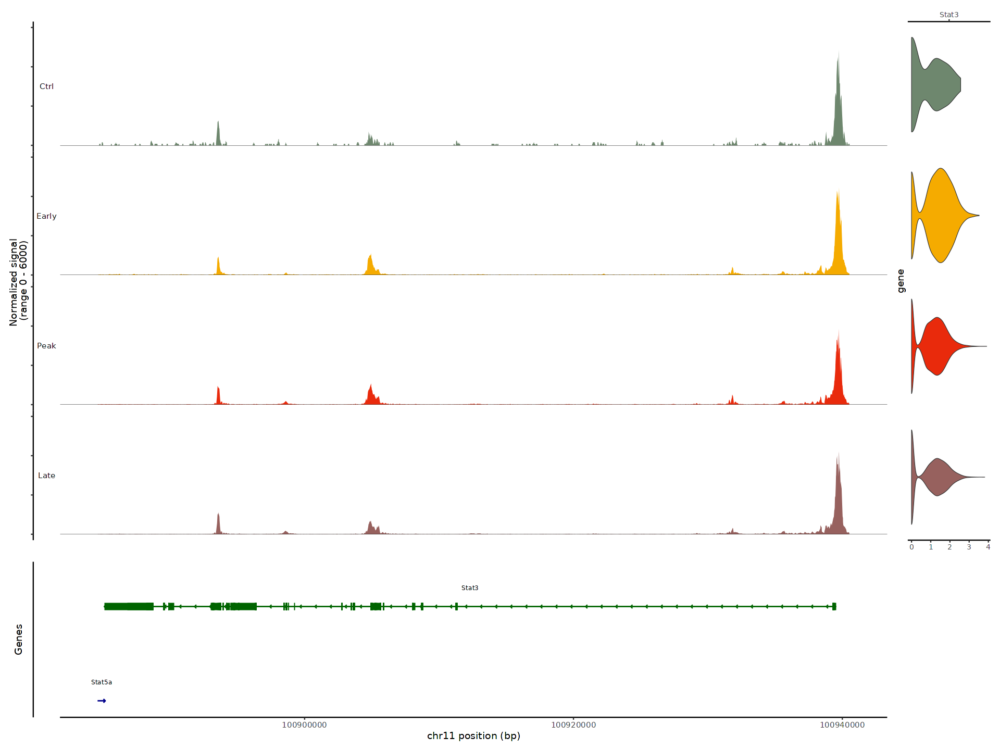

In [39]:
gene_marker <- "Stat3"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=6000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 36 rows containing missing values (`geom_segment()`)."


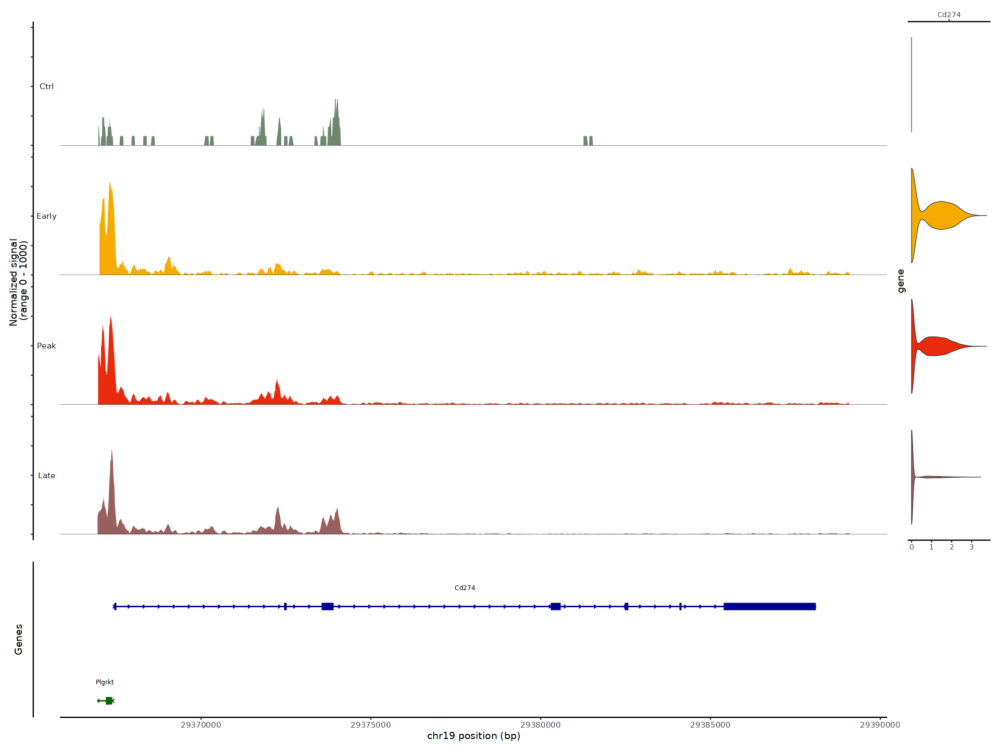

In [27]:
gene_marker <- "Cd274"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


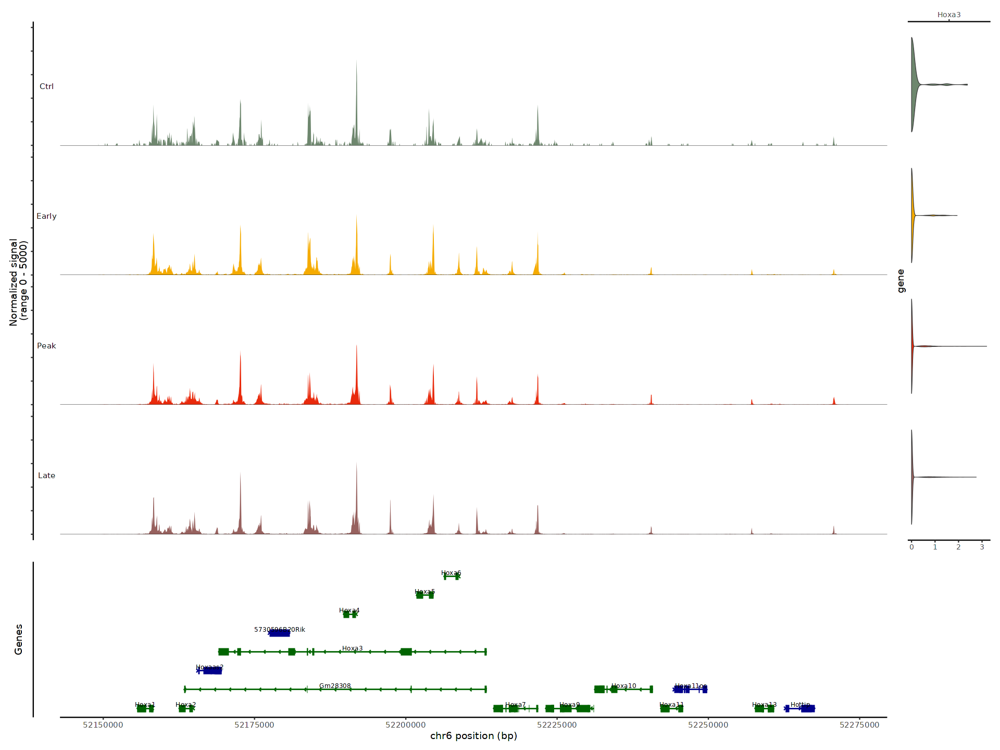

In [31]:
gene_marker <- "Hoxa3"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=5000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 20000, extend.downstream = 60000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 3 rows containing missing values (`geom_segment()`)."


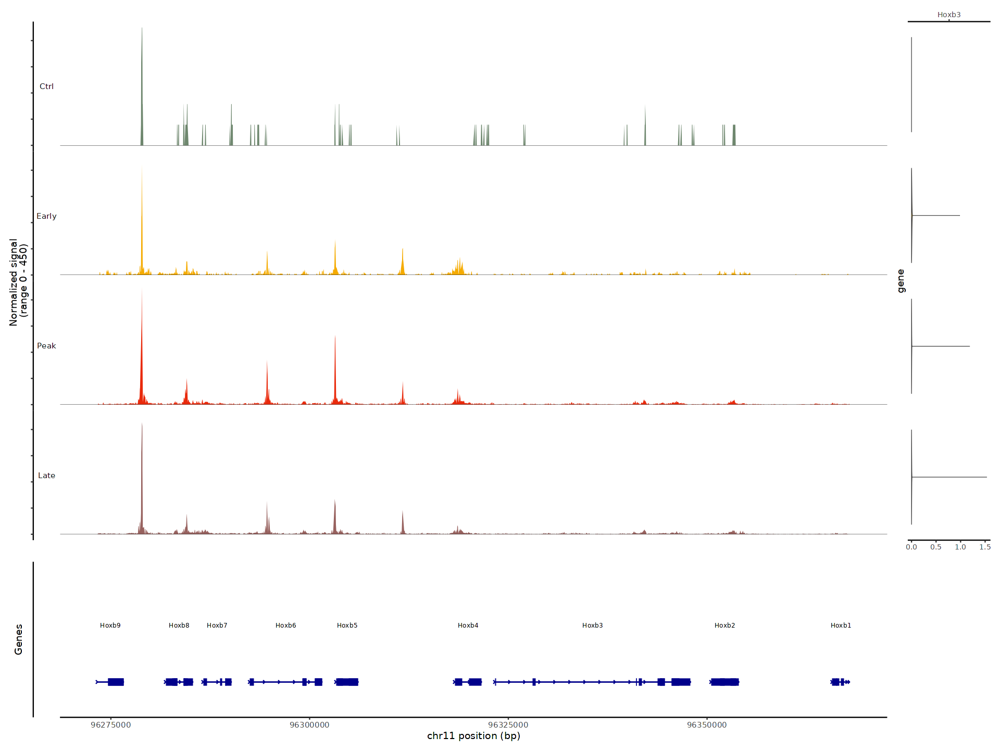

In [64]:
gene_marker <- "Hoxb3"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=450, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 50000, extend.downstream = 20000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


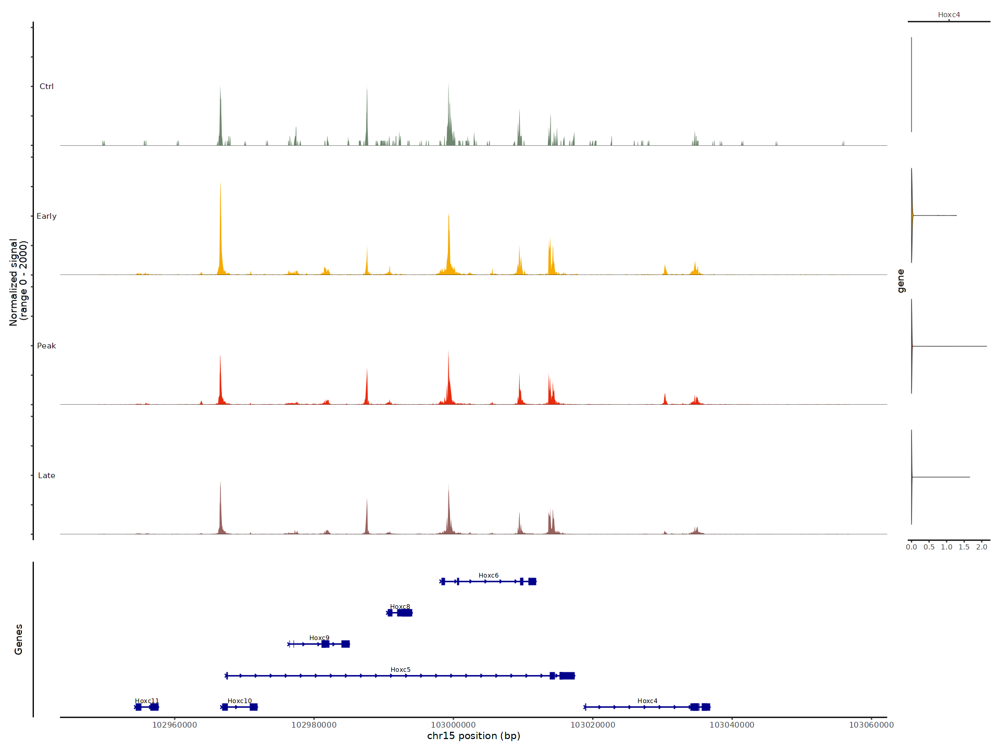

In [32]:
gene_marker <- "Hoxc4"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=2000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 70000, extend.downstream = 20000) & scale_fill_manual(values = orig.ident_merge_colors)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


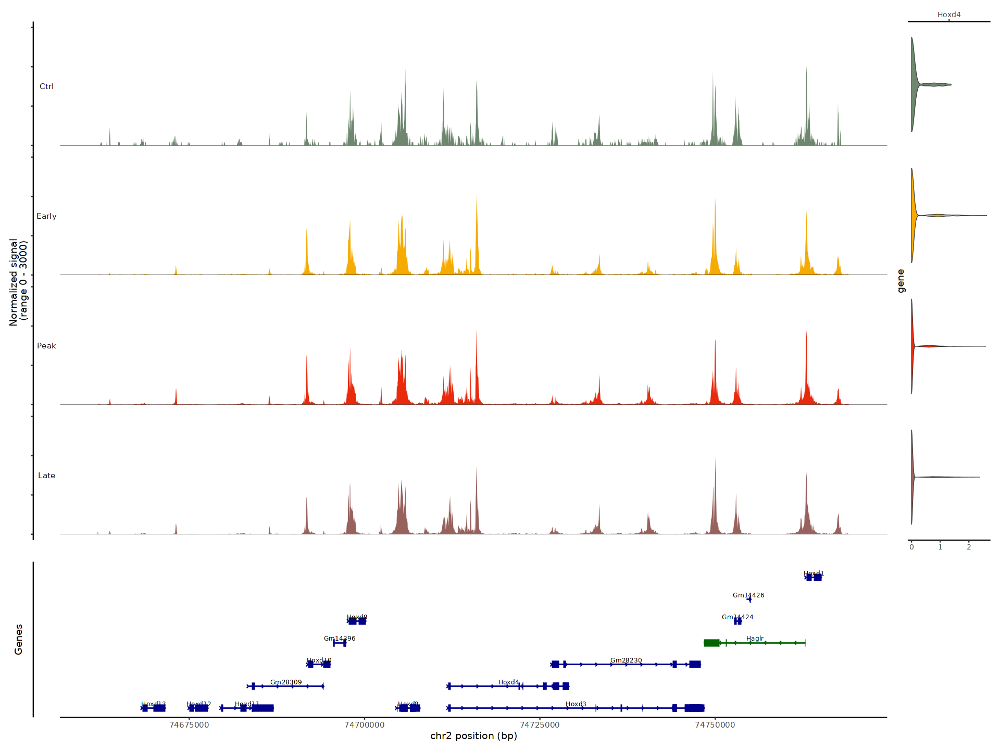

In [33]:
gene_marker <- "Hoxd4"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=3000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 50000, extend.downstream = 40000) & scale_fill_manual(values = orig.ident_merge_colors)

#### 4.1.3 OPC

In [40]:
cluster_choice = "OPC"

In [41]:
tmp_cluster <- subset(MORNAATACCOL, subset = cellType_OL_merge == cluster_choice)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ol_ to umappeaksol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ol_ to umapbimodol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_generegchrom_ol_ to pcageneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_generegchrom_ol_ to umapgeneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_dorcs_ol_ to pcadorcsol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_dorcs_ol_ to umapdorcsol_"


In [30]:
DefaultAssay(tmp_cluster) <- "peaks"

In [31]:
Idents(tmp_cluster) <- "orig.ident_merge"

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Warning message:
"Removed 36 rows containing missing values (`geom_segment()`)."


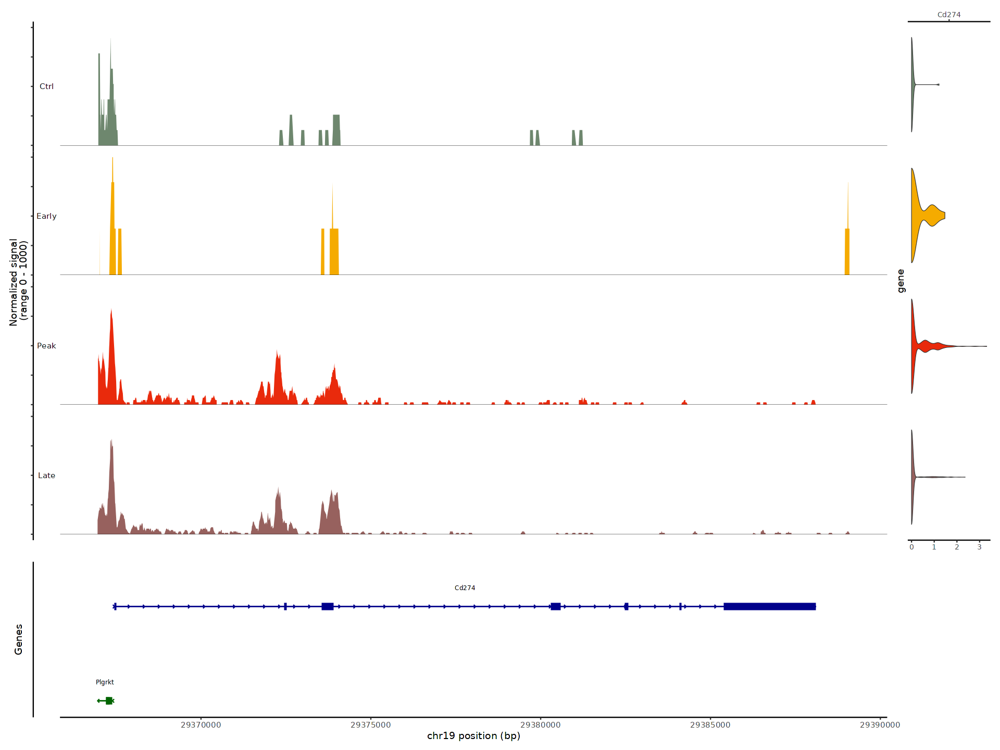

In [32]:
gene_marker <- "Cd274"
CoveragePlot(tmp_cluster, region = gene_marker, scale.factor = 1e8, ymax=1000, features = gene_marker, expression.assay = "RNA", tile = FALSE, peaks=FALSE, extend.upstream = 500, extend.downstream = 1000) & scale_fill_manual(values = orig.ident_merge_colors)

### 4.2 Co-accessibility

#### 4.2.1 MOL2

In [ ]:
cluster_choice = "MOL2"

In [91]:
DefaultAssay(MORNAATACCOL) <- "peaks"

In [92]:
Links(MORNAATACCOL[["peaks"]]) <- readRDS(paste0(OS_path_outputs, "MORNAATACCOL_peaks_links_dorc.rds"))

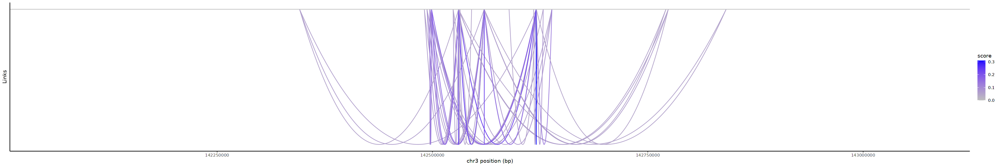

In [93]:
options(repr.plot.width=30, repr.plot.height=5)
LinkPlot(MORNAATACCOL, region="Gbp3", assay = "peaks", min.cutoff = 0.05, sep = c("-", "-"), extend.upstream = 500000, extend.downstream = 500000)

##### 4.2.1.1 Early

In [36]:
timepoint = "Early"

In [37]:
tmp <- subset(tmp_cluster, subset = orig.ident_merge == timepoint)

In [38]:
DefaultAssay(tmp) <- 'peaks'

In [39]:
tmp_links <- readRDS(paste0(OS_path_outputs, "coA_",cluster_choice,"_",timepoint,".rds"))

In [40]:
links <- tmp_links[tmp_links$score > 0.01]

In [41]:
Links(tmp) <- links

In [42]:
Idents(tmp) <- "orig.ident_merge"

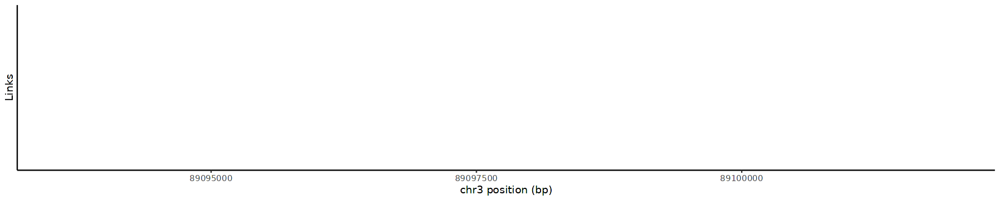

In [43]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Fdps",
  extend.upstream = 0,
  extend.downstream = 0
)

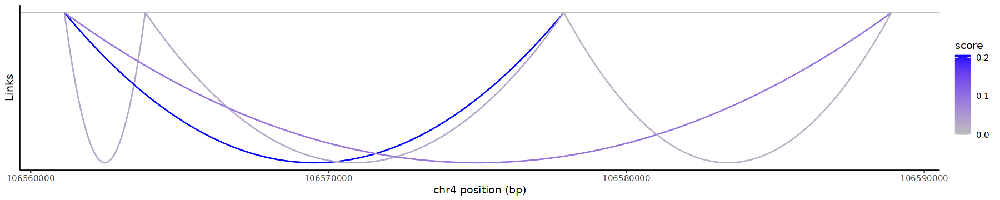

In [44]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Dhcr24",
  extend.upstream = 0,
  extend.downstream = 0
)

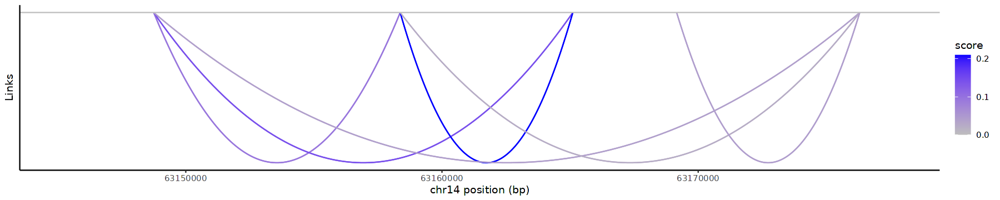

In [45]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Fdft1",
  extend.upstream = 0,
  extend.downstream = 0
)

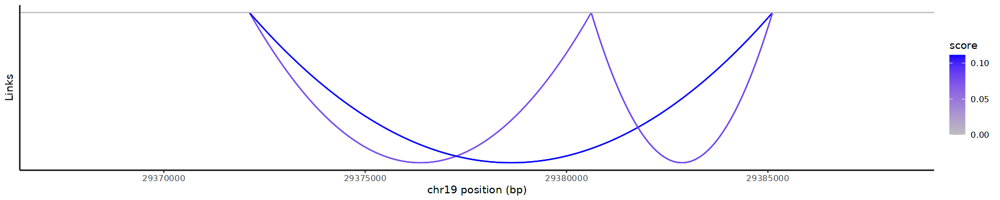

In [46]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Cd274",
  extend.upstream = 0,
  extend.downstream = 0
)

##### 4.2.1.2 Peak

In [47]:
timepoint = "Peak"

In [48]:
tmp <- subset(tmp_cluster, subset = orig.ident_merge == timepoint)

In [49]:
DefaultAssay(tmp) <- 'peaks'

In [50]:
tmp_links <- readRDS(paste0(OS_path_outputs, "coA_",cluster_choice,"_",timepoint,".rds"))

In [51]:
links <- tmp_links[tmp_links$score > 0.01]

In [52]:
Links(tmp) <- links

In [53]:
Idents(tmp) <- "orig.ident_merge"

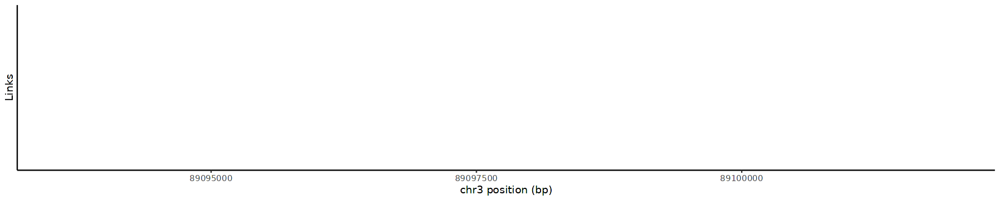

In [54]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Fdps",
  extend.upstream = 0,
  extend.downstream = 0
)

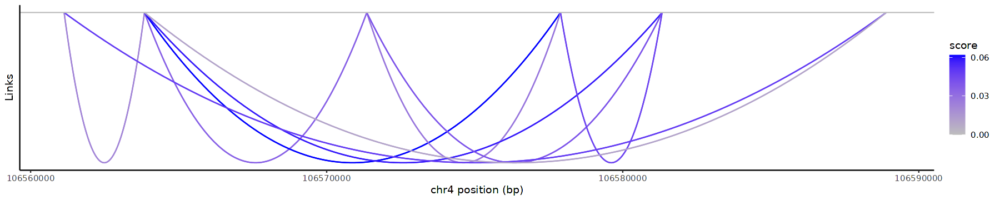

In [55]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Dhcr24",
  extend.upstream = 0,
  extend.downstream = 0
)

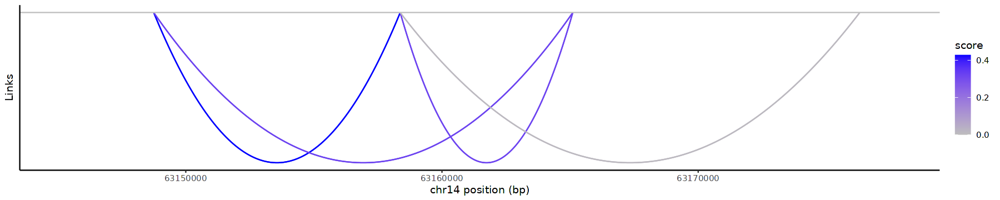

In [56]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Fdft1",
  extend.upstream = 0,
  extend.downstream = 0
)

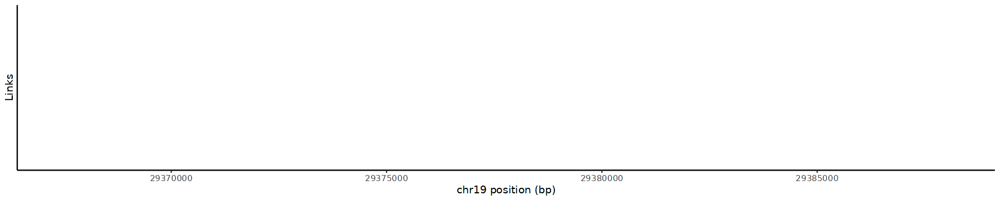

In [57]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Cd274",
  extend.upstream = 0,
  extend.downstream = 0
)

##### 4.2.1.3 Late

In [58]:
timepoint = "Late"

In [59]:
tmp <- subset(tmp_cluster, subset = orig.ident_merge == timepoint)

In [60]:
DefaultAssay(tmp) <- 'peaks'

In [61]:
tmp_links <- readRDS(paste0(OS_path_outputs, "coA_",cluster_choice,"_",timepoint,".rds"))

In [62]:
links <- tmp_links[tmp_links$score > 0.01]

In [63]:
Links(tmp) <- links

In [64]:
Idents(tmp) <- "orig.ident_merge"

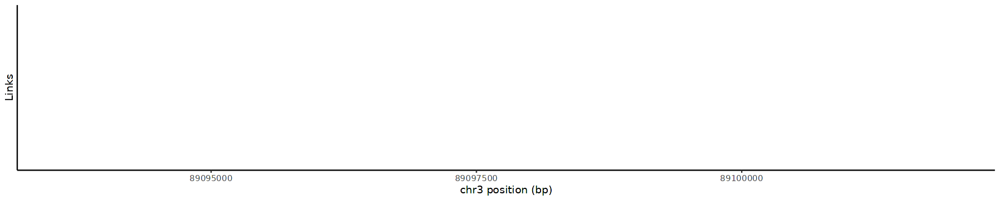

In [65]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Fdps",
  extend.upstream = 0,
  extend.downstream = 0
)

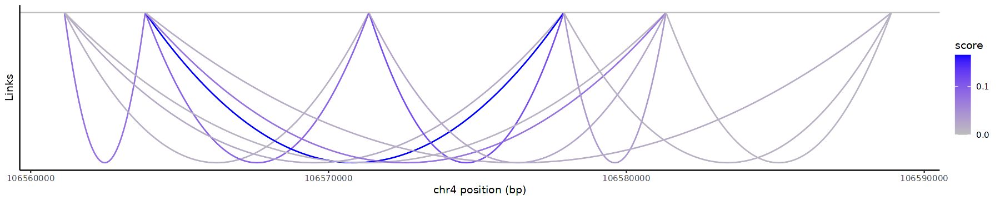

In [66]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Dhcr24",
  extend.upstream = 0,
  extend.downstream = 0
)

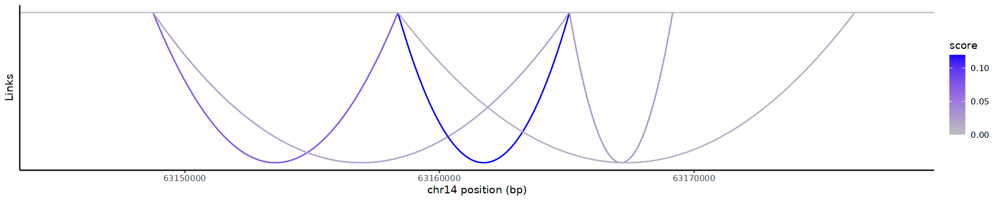

In [67]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Fdft1",
  extend.upstream = 0,
  extend.downstream = 0
)

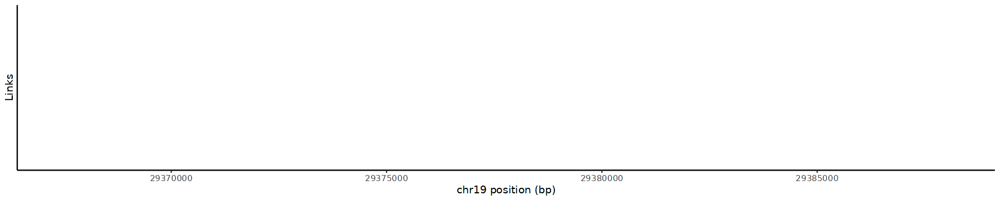

In [70]:
options(repr.plot.width=15, repr.plot.height=3)
LinkPlot(
  object = tmp,
  region = "Cd274",
  extend.upstream = 0,
  extend.downstream = 0
)

### 4.3 Single cell heatmaps

In [9]:
fragments_unsorted <- rtracklayer::import(paste0(OS_path_datasets, "AGGR_ARC2_MORNAATACC/outs/atac_fragments.tsv.gz"),format='bed')
fragments <- sort(fragments_unsorted)

In [10]:
saveRDS(fragments, paste0(OS_path_outputs, "MORNAATACCOL_fragments.rds"))

In [ ]:
fragments <- readRDS(paste0(OS_path_outputs, "MORNAATACCOL_fragments.rds"))

In [18]:
window_bin = 250
number_cells_to_plot = 50

In [19]:
#Fdps
interesting_region <- StringToGRanges("chr3:89093000-89103000",sep=c(":","-"))
seqlevelsStyle(interesting_region) <- "UCSC"
fragments.interesting <- fragments[seqnames(fragments) == as.character(seqnames(interesting_region))]
fragments.interesting <- fragments.interesting[start(fragments.interesting) > as.numeric(start(interesting_region))]
fragments.interesting <- fragments.interesting[end(fragments.interesting) < as.numeric(end(interesting_region))]
fragments.interesting <- fragments.interesting[fragments.interesting$name %in% colnames(tmp_cluster)]
#fraction <- length(unique(fragments.interesting$name)) / dim(tmp_cluster)[2]
#fraction <- 0.1

In [20]:
Idents(tmp_cluster) <- "orig.ident_merge"
cells.to.plot <- filterCells(object = tmp_cluster, fragments = fragments.interesting, nbcells=number_cells_to_plot)
flt <- AnnotationFilterList(TxBiotypeFilter("protein_coding"), GRangesFilter(interesting_region),logicOp = c("&"))

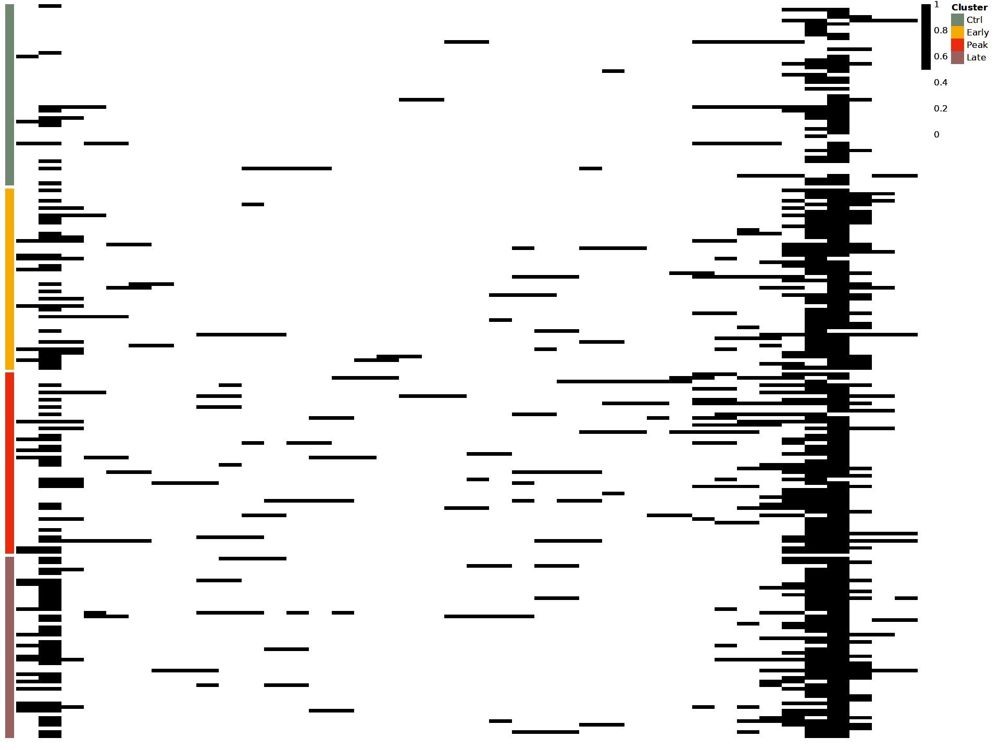

In [21]:
plotHeatmapBW(object = tmp_cluster,
            fragmentsGrange = fragments.interesting,
            cells = cells.to.plot,
            interestingRegion = interesting_region,
            window = window_bin,
            annotFilter = flt,
            nbcells=number_cells_to_plot,
            annotation_colors = list(Cluster = orig.ident_merge_colors))

In [22]:
#Dhcr24
interesting_region <- StringToGRanges("chr4:106560000-106590000",sep=c(":","-"))
seqlevelsStyle(interesting_region) <- "UCSC"
fragments.interesting <- fragments[seqnames(fragments) == as.character(seqnames(interesting_region))]
fragments.interesting <- fragments.interesting[start(fragments.interesting) > as.numeric(start(interesting_region))]
fragments.interesting <- fragments.interesting[end(fragments.interesting) < as.numeric(end(interesting_region))]
fragments.interesting <- fragments.interesting[fragments.interesting$name %in% colnames(tmp_cluster)]
#fraction <- length(unique(fragments.interesting$name)) / dim(tmp_cluster)[2]
#fraction <- 0.1

In [23]:
Idents(tmp_cluster) <- "orig.ident_merge"
cells.to.plot <- filterCells(object = tmp_cluster, fragments = fragments.interesting, nbcells=number_cells_to_plot)
flt <- AnnotationFilterList(TxBiotypeFilter("protein_coding"), GRangesFilter(interesting_region),logicOp = c("&"))

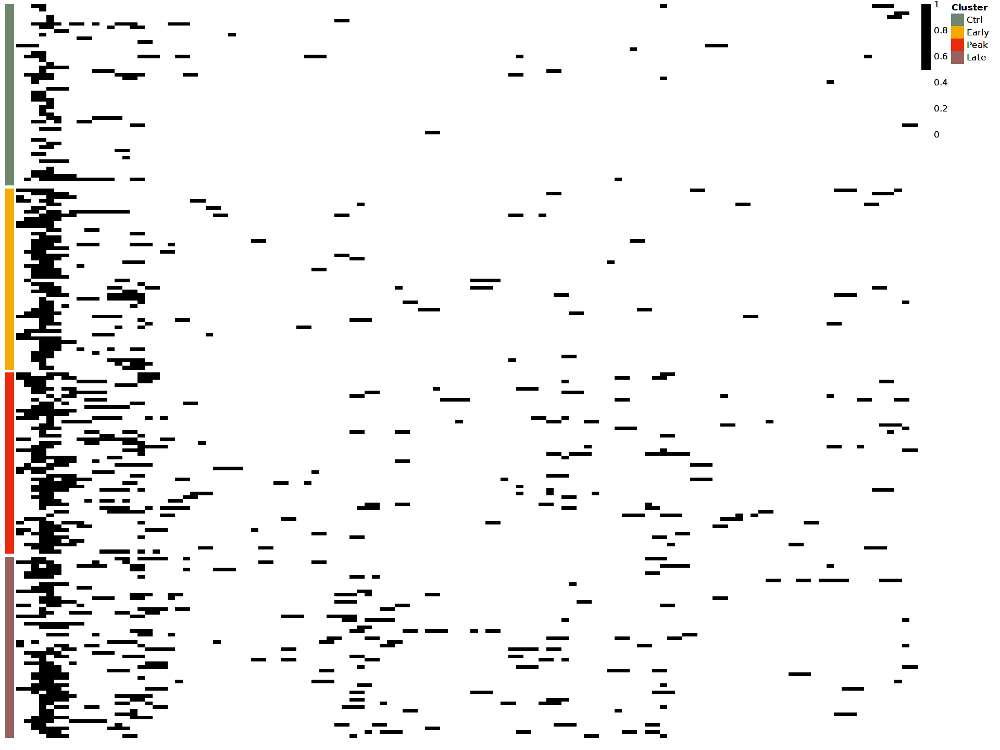

In [24]:
plotHeatmapBW(object = tmp_cluster,
            fragmentsGrange = fragments.interesting,
            cells = cells.to.plot,
            interestingRegion = interesting_region,
            window = window_bin,
            annotFilter = flt,
            nbcells=number_cells_to_plot,
            annotation_colors = list(Cluster = orig.ident_merge_colors))

In [25]:
#Fdft1
interesting_region <- StringToGRanges("chr14:63140000-63180000",sep=c(":","-"))
seqlevelsStyle(interesting_region) <- "UCSC"
fragments.interesting <- fragments[seqnames(fragments) == as.character(seqnames(interesting_region))]
fragments.interesting <- fragments.interesting[start(fragments.interesting) > as.numeric(start(interesting_region))]
fragments.interesting <- fragments.interesting[end(fragments.interesting) < as.numeric(end(interesting_region))]
fragments.interesting <- fragments.interesting[fragments.interesting$name %in% colnames(tmp_cluster)]
#fraction <- length(unique(fragments.interesting$name)) / dim(tmp_cluster)[2]
#fraction <- 0.1

In [26]:
Idents(tmp_cluster) <- "orig.ident_merge"
cells.to.plot <- filterCells(object = tmp_cluster, fragments = fragments.interesting, nbcells=number_cells_to_plot)
flt <- AnnotationFilterList(TxBiotypeFilter("protein_coding"), GRangesFilter(interesting_region),logicOp = c("&"))

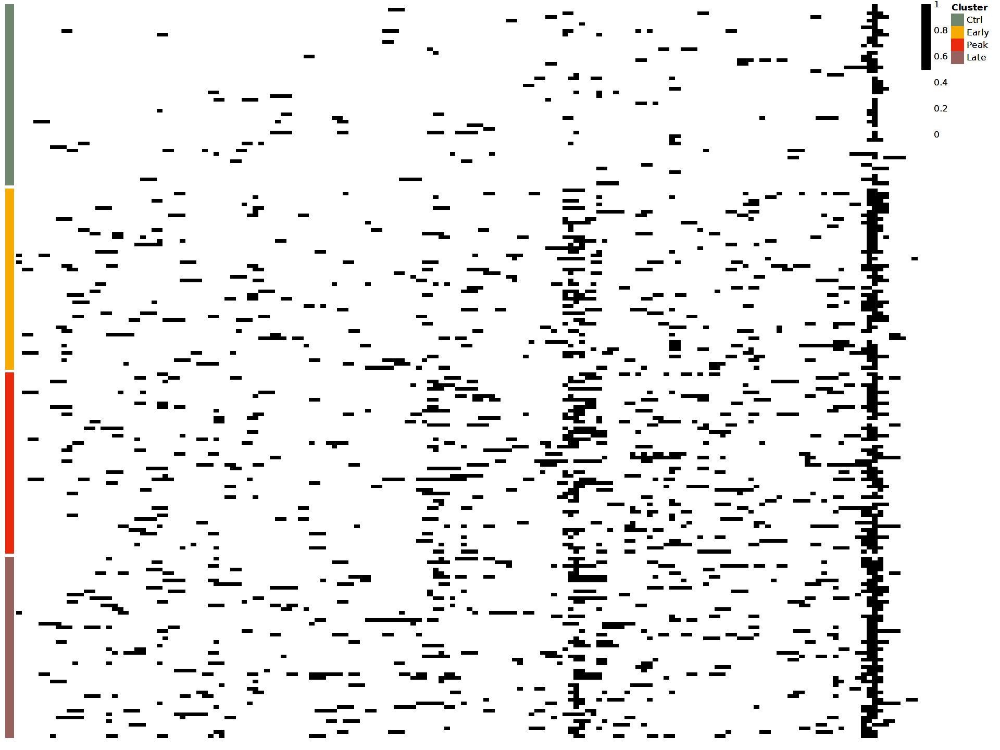

In [27]:
plotHeatmapBW(object = tmp_cluster,
            fragmentsGrange = fragments.interesting,
            cells = cells.to.plot,
            interestingRegion = interesting_region,
            window = window_bin,
            annotFilter = flt,
            nbcells=number_cells_to_plot,
            annotation_colors = list(Cluster = orig.ident_merge_colors))

In [28]:
#Cd274
interesting_region <- StringToGRanges("chr19:29365000-29390000",sep=c(":","-"))
seqlevelsStyle(interesting_region) <- "UCSC"
fragments.interesting <- fragments[seqnames(fragments) == as.character(seqnames(interesting_region))]
fragments.interesting <- fragments.interesting[start(fragments.interesting) > as.numeric(start(interesting_region))]
fragments.interesting <- fragments.interesting[end(fragments.interesting) < as.numeric(end(interesting_region))]
fragments.interesting <- fragments.interesting[fragments.interesting$name %in% colnames(tmp_cluster)]
#fraction <- length(unique(fragments.interesting$name)) / dim(tmp_cluster)[2]
#fraction <- 0.1

In [29]:
Idents(tmp_cluster) <- "orig.ident_merge"
cells.to.plot <- filterCells(object = tmp_cluster, fragments = fragments.interesting, nbcells=number_cells_to_plot)
flt <- AnnotationFilterList(TxBiotypeFilter("protein_coding"), GRangesFilter(interesting_region),logicOp = c("&"))

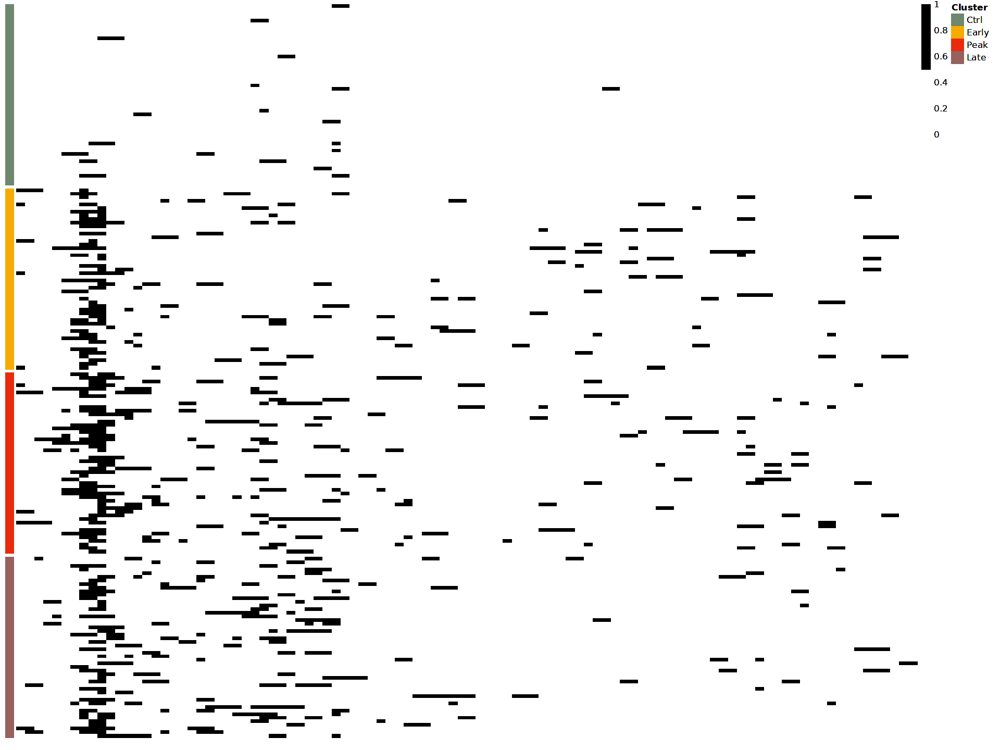

In [30]:
plotHeatmapBW(object = tmp_cluster,
            fragmentsGrange = fragments.interesting,
            cells = cells.to.plot,
            interestingRegion = interesting_region,
            window = window_bin,
            annotFilter = flt,
            nbcells=number_cells_to_plot,
            annotation_colors = list(Cluster = orig.ident_merge_colors))

### 4.4 Expression plots

#### 4.4.1 MOL56

In [46]:
cluster_choice = "MOL56"

In [47]:
tmp <- subset(MORNAATACCOL, subset = cellType_OL_merge == cluster_choice)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ol_ to umappeaksol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ol_ to umapbimodol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_generegchrom_ol_ to pcageneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_generegchrom_ol_ to umapgeneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_dorcs_ol_ to pcadorcsol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_dorcs_ol_ to umapdorcsol_"


In [48]:
DefaultAssay(tmp) <- "RNA"

In [49]:
Idents(tmp) <- "orig.ident_merge"

In [16]:
genelist <- c("Ifit1", "Ddx58", "H2-T22", "Stat2", "Rtp4", "Ifi35", "Igtp", "Rnf213")
expression <- as.data.frame(t(tmp[["RNA"]]@data[genelist,]))

In [17]:
expression <-cbind(expression,Timepoint=tmp$orig.ident_merge)
expression_genelist <- melt(expression,id="Timepoint")
colnames(expression_genelist)[3] <- "Log2.Norm.Expression"

In [18]:
expression_genelist <- expression_genelist %>% mutate(Timepoint=factor(Timepoint,levels=names(orig.ident_merge_colors)))

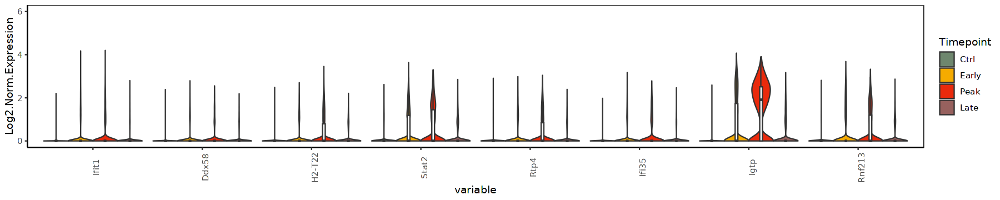

In [22]:
options(repr.plot.width=15, repr.plot.height=3)
p <- ggplot(expression_genelist, aes(x=variable, y=Log2.Norm.Expression))
p + geom_violin(aes(fill = Timepoint), scale="width") +
geom_boxplot(aes(group=interaction(Timepoint,variable)), width=0.1, outlier.shape = NA,position=position_dodge(0.9))+
scale_fill_manual(values=orig.ident_merge_colors) +
  ylim(0,6) + theme_bw()+
theme(axis.line = element_line(colour = "black"),
       panel.grid.major = element_blank(),
       panel.grid.minor = element_blank(),
       panel.background = element_blank()) + theme(axis.text.x = element_text(angle = 90)) + theme(legend.position="right")

In [50]:
genelist <- c("Stat1", "H2-T23", "Psmb8")
expression <- as.data.frame(t(tmp[["RNA"]]@data[genelist,]))

In [51]:
expression <-cbind(expression,Timepoint=tmp$orig.ident_merge)
expression_genelist <- melt(expression,id="Timepoint")
colnames(expression_genelist)[3] <- "Log2.Norm.Expression"

In [52]:
expression_genelist <- expression_genelist %>% mutate(Timepoint=factor(Timepoint,levels=names(orig.ident_merge_colors)))

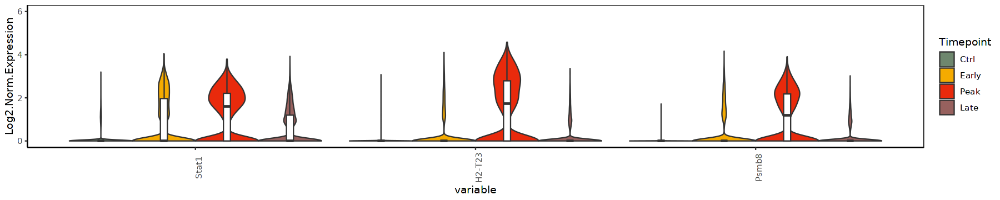

In [53]:
options(repr.plot.width=15, repr.plot.height=3)
p <- ggplot(expression_genelist, aes(x=variable, y=Log2.Norm.Expression))
p + geom_violin(aes(fill = Timepoint), scale="width") +
geom_boxplot(aes(group=interaction(Timepoint,variable)), width=0.1, outlier.shape = NA,position=position_dodge(0.9))+
scale_fill_manual(values=orig.ident_merge_colors) +
  ylim(0,6) + theme_bw()+
theme(axis.line = element_line(colour = "black"),
       panel.grid.major = element_blank(),
       panel.grid.minor = element_blank(),
       panel.background = element_blank()) + theme(axis.text.x = element_text(angle = 90)) + theme(legend.position="right")

In [54]:
genelist <- c("Stat2", "Ifit1", "Irgm1")
expression <- as.data.frame(t(tmp[["RNA"]]@data[genelist,]))

In [55]:
expression <-cbind(expression,Timepoint=tmp$orig.ident_merge)
expression_genelist <- melt(expression,id="Timepoint")
colnames(expression_genelist)[3] <- "Log2.Norm.Expression"

In [56]:
expression_genelist <- expression_genelist %>% mutate(Timepoint=factor(Timepoint,levels=names(orig.ident_merge_colors)))

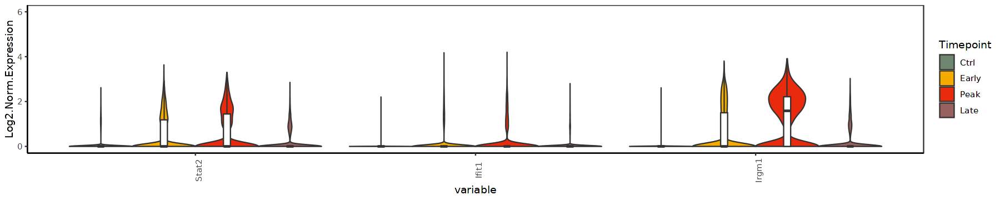

In [57]:
options(repr.plot.width=15, repr.plot.height=3)
p <- ggplot(expression_genelist, aes(x=variable, y=Log2.Norm.Expression))
p + geom_violin(aes(fill = Timepoint), scale="width") +
geom_boxplot(aes(group=interaction(Timepoint,variable)), width=0.1, outlier.shape = NA,position=position_dodge(0.9))+
scale_fill_manual(values=orig.ident_merge_colors) +
  ylim(0,6) + theme_bw()+
theme(axis.line = element_line(colour = "black"),
       panel.grid.major = element_blank(),
       panel.grid.minor = element_blank(),
       panel.background = element_blank()) + theme(axis.text.x = element_text(angle = 90)) + theme(legend.position="right")

In [61]:
genelist <- c("Pou6f1", "Ldha", "Rgs20")
expression <- as.data.frame(t(tmp[["RNA"]]@data[genelist,]))

In [62]:
expression <-cbind(expression,Timepoint=tmp$orig.ident_merge)
expression_genelist <- melt(expression,id="Timepoint")
colnames(expression_genelist)[3] <- "Log2.Norm.Expression"

In [63]:
expression_genelist <- expression_genelist %>% mutate(Timepoint=factor(Timepoint,levels=names(orig.ident_merge_colors)))

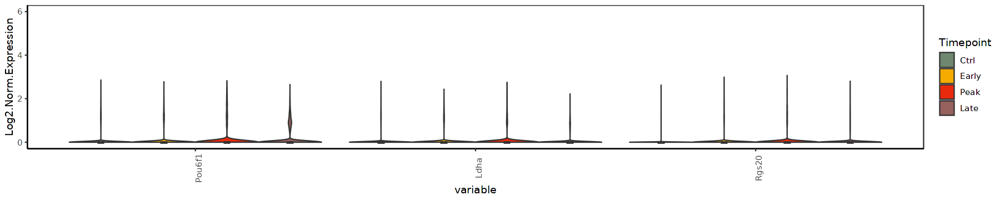

In [64]:
options(repr.plot.width=15, repr.plot.height=3)
p <- ggplot(expression_genelist, aes(x=variable, y=Log2.Norm.Expression))
p + geom_violin(aes(fill = Timepoint), scale="width") +
geom_boxplot(aes(group=interaction(Timepoint,variable)), width=0.1, outlier.shape = NA,position=position_dodge(0.9))+
scale_fill_manual(values=orig.ident_merge_colors) +
  ylim(0,6) + theme_bw()+
theme(axis.line = element_line(colour = "black"),
       panel.grid.major = element_blank(),
       panel.grid.minor = element_blank(),
       panel.background = element_blank()) + theme(axis.text.x = element_text(angle = 90)) + theme(legend.position="right")

#### 4.4.2 MOL2

In [12]:
cluster_choice = "MOL2"

In [13]:
tmp <- subset(MORNAATACCOL, subset = cellType_OL_merge == cluster_choice)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ol_ to umappeaksol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ol_ to umapbimodol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_generegchrom_ol_ to pcageneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_generegchrom_ol_ to umapgeneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_dorcs_ol_ to pcadorcsol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_dorcs_ol_ to umapdorcsol_"


In [14]:
DefaultAssay(tmp) <- "RNA"

In [15]:
Idents(tmp) <- "orig.ident_merge"

In [16]:
genelist <- c("Ifit1", "Ddx58", "H2-T22", "Stat2", "Rtp4", "Ifi35", "Igtp", "Rnf213")
expression <- as.data.frame(t(tmp[["RNA"]]@data[genelist,]))

In [17]:
expression <-cbind(expression,Timepoint=tmp$orig.ident_merge)
expression_genelist <- melt(expression,id="Timepoint")
colnames(expression_genelist)[3] <- "Log2.Norm.Expression"

In [18]:
expression_genelist <- expression_genelist %>% mutate(Timepoint=factor(Timepoint,levels=names(orig.ident_merge_colors)))

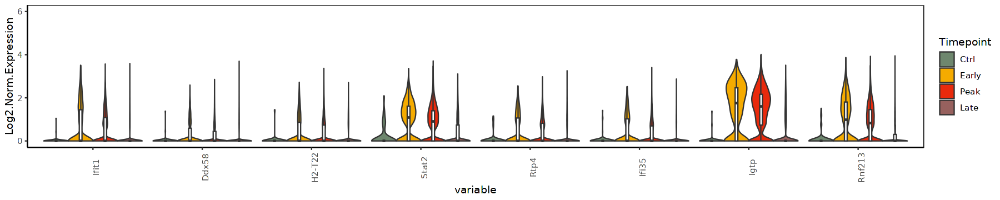

In [19]:
options(repr.plot.width=15, repr.plot.height=3)
p <- ggplot(expression_genelist, aes(x=variable, y=Log2.Norm.Expression))
p + geom_violin(aes(fill = Timepoint), scale="width") +
geom_boxplot(aes(group=interaction(Timepoint,variable)), width=0.1, outlier.shape = NA,position=position_dodge(0.9))+
scale_fill_manual(values=orig.ident_merge_colors) +
  ylim(0,6) + theme_bw()+
theme(axis.line = element_line(colour = "black"),
       panel.grid.major = element_blank(),
       panel.grid.minor = element_blank(),
       panel.background = element_blank()) + theme(axis.text.x = element_text(angle = 90)) + theme(legend.position="right")

In [69]:
genelist <- c("Stat1", "H2-T23", "Psmb8")
expression <- as.data.frame(t(tmp[["RNA"]]@data[genelist,]))

In [70]:
expression <-cbind(expression,Timepoint=tmp$orig.ident_merge)
expression_genelist <- melt(expression,id="Timepoint")
colnames(expression_genelist)[3] <- "Log2.Norm.Expression"

In [71]:
expression_genelist <- expression_genelist %>% mutate(Timepoint=factor(Timepoint,levels=names(orig.ident_merge_colors)))

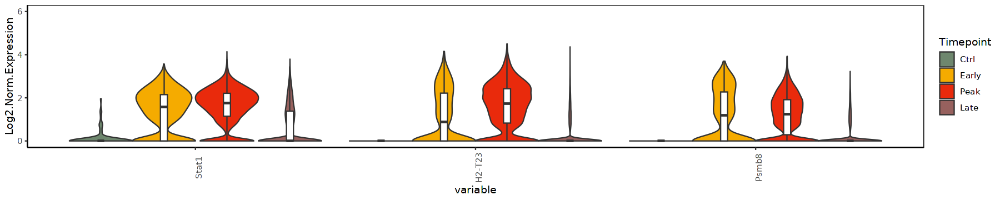

In [72]:
options(repr.plot.width=15, repr.plot.height=3)
p <- ggplot(expression_genelist, aes(x=variable, y=Log2.Norm.Expression))
p + geom_violin(aes(fill = Timepoint), scale="width") +
geom_boxplot(aes(group=interaction(Timepoint,variable)), width=0.1, outlier.shape = NA,position=position_dodge(0.9))+
scale_fill_manual(values=orig.ident_merge_colors) +
  ylim(0,6) + theme_bw()+
theme(axis.line = element_line(colour = "black"),
       panel.grid.major = element_blank(),
       panel.grid.minor = element_blank(),
       panel.background = element_blank()) + theme(axis.text.x = element_text(angle = 90)) + theme(legend.position="right")

In [73]:
genelist <- c("Stat2", "Ifit1", "Irgm1")
expression <- as.data.frame(t(tmp[["RNA"]]@data[genelist,]))

In [74]:
expression <-cbind(expression,Timepoint=tmp$orig.ident_merge)
expression_genelist <- melt(expression,id="Timepoint")
colnames(expression_genelist)[3] <- "Log2.Norm.Expression"

In [75]:
expression_genelist <- expression_genelist %>% mutate(Timepoint=factor(Timepoint,levels=names(orig.ident_merge_colors)))

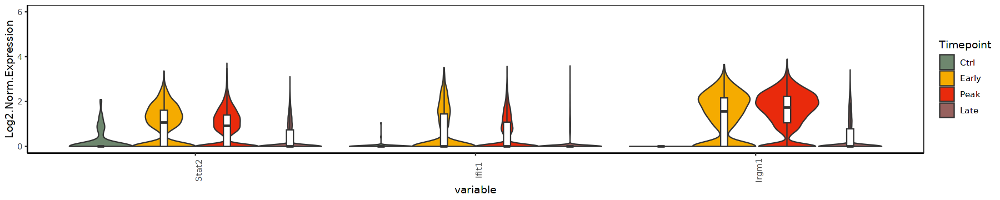

In [76]:
options(repr.plot.width=15, repr.plot.height=3)
p <- ggplot(expression_genelist, aes(x=variable, y=Log2.Norm.Expression))
p + geom_violin(aes(fill = Timepoint), scale="width") +
geom_boxplot(aes(group=interaction(Timepoint,variable)), width=0.1, outlier.shape = NA,position=position_dodge(0.9))+
scale_fill_manual(values=orig.ident_merge_colors) +
  ylim(0,6) + theme_bw()+
theme(axis.line = element_line(colour = "black"),
       panel.grid.major = element_blank(),
       panel.grid.minor = element_blank(),
       panel.background = element_blank()) + theme(axis.text.x = element_text(angle = 90)) + theme(legend.position="right")

In [16]:
genelist <- c("Pou6f1", "Ldha", "Rgs20")
expression <- as.data.frame(t(tmp[["RNA"]]@data[genelist,]))

In [17]:
expression <-cbind(expression,Timepoint=tmp$orig.ident_merge)
expression_genelist <- melt(expression,id="Timepoint")
colnames(expression_genelist)[3] <- "Log2.Norm.Expression"

In [18]:
expression_genelist <- expression_genelist %>% mutate(Timepoint=factor(Timepoint,levels=names(orig.ident_merge_colors)))

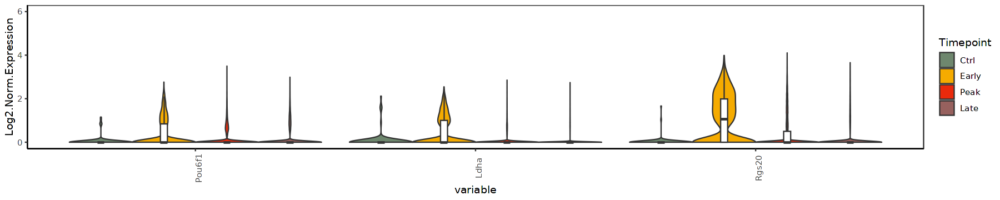

In [19]:
options(repr.plot.width=15, repr.plot.height=3)
p <- ggplot(expression_genelist, aes(x=variable, y=Log2.Norm.Expression))
p + geom_violin(aes(fill = Timepoint), scale="width") +
geom_boxplot(aes(group=interaction(Timepoint,variable)), width=0.1, outlier.shape = NA,position=position_dodge(0.9))+
scale_fill_manual(values=orig.ident_merge_colors) +
  ylim(0,6) + theme_bw()+
theme(axis.line = element_line(colour = "black"),
       panel.grid.major = element_blank(),
       panel.grid.minor = element_blank(),
       panel.background = element_blank()) + theme(axis.text.x = element_text(angle = 90)) + theme(legend.position="right")